In [1]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'DejaVu Sans'

from matplotlib.dates import date2num
import matplotlib.dates as mdates
import matplotlib.patches as mpatches
from datetime import datetime
import xarray as xr
import netCDF4 as nc
import glob
import math
import subprocess
from matplotlib import colormaps
import plotly.graph_objs as go

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import seaborn as sns
import csv
import pandas as pd
from scipy.optimize import curve_fit
from math import prod

import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT
from metpy.units import units
from metpy.calc import dewpoint_from_relative_humidity
#from metpy.io import get_test_data

import sys, os
import requests
import pyart

import warnings
warnings.simplefilter("ignore", RuntimeWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)

#%matplotlib notebook

plt.style.use('default')


#import dask
#from dask.distributed import Client, progress, wait
#dask.config.config.get('distributed').get('dashboard').update({'link':'{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'})
#client = Client()
#client

#dask.config.set(scheduler='threads', num_workers=2)

from dask.distributed import Client
import dask

# Dashboard config for JupyterHub (optional)
dask.config.config.get('distributed').get('dashboard').update({
    'link': '{JUPYTERHUB_SERVICE_PREFIX}/proxy/{port}/status'
})

# Start Dask client with controlled resources
client = Client(n_workers=4, threads_per_worker=2, memory_limit='20GB') # This will use 4*2=8 CPU threads
#client



## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [2]:
import numpy as np
import warnings

np.seterr(divide='ignore', invalid='ignore')
warnings.filterwarnings("ignore", category=RuntimeWarning)

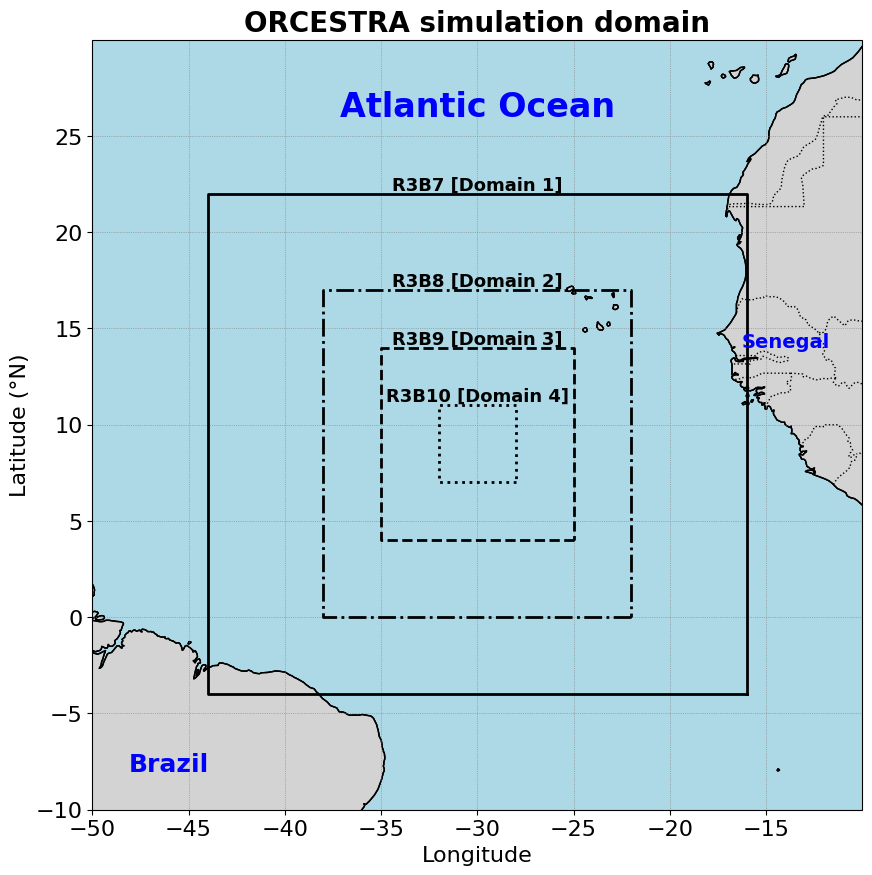

In [3]:
## ORCESTRA 3 Sept 2024 domain

lon1 = [-16., -44.];
lat1 = [-4., 22.];

lon2 = [-22., -38.];
lat2 = [-0., 17.];
#lat2 = [-0.85, 17.];

lon3 = [-25., -35.];
lat3 = [4, 14.];

lon4 = [-28., -32.];
lat4 = [7., 11.];


fig, ax = plt.subplots(figsize=(14, 10), subplot_kw={'projection': ccrs.PlateCarree()})

# Add coastlines and features for context
ax.coastlines(resolution='50m')
ax.add_feature(cfeature.BORDERS, linestyle=':')


ax.plot([lon1[0], lon1[1], lon1[1], lon1[0], lon1[0]], 
        [lat1[0], lat1[0], lat1[1], lat1[1], lat1[0]], 
        color='black', linewidth=2, linestyle='-', transform=ccrs.PlateCarree())

ax.plot([lon2[0], lon2[1], lon2[1], lon2[0], lon2[0]], 
        [lat2[0], lat2[0], lat2[1], lat2[1], lat2[0]], 
        color='black', linewidth=2, linestyle='-.', transform=ccrs.PlateCarree())

ax.plot([lon3[0], lon3[1], lon3[1], lon3[0], lon3[0]], 
        [lat3[0], lat3[0], lat3[1], lat3[1], lat3[0]], 
        color='black', linewidth=2, linestyle='--', transform=ccrs.PlateCarree())

ax.plot([lon4[0], lon4[1], lon4[1], lon4[0], lon4[0]], 
        [lat4[0], lat4[0], lat4[1], lat4[1], lat4[0]], 
        color='black', linewidth=2, linestyle=':', transform=ccrs.PlateCarree())

ax.text(-30., 22.2, "R3B7 [Domain 1]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 17.2, "R3B8 [Domain 2]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 14.2, "R3B9 [Domain 3]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')
ax.text(-30., 11.2, "R3B10 [Domain 4]", transform=ccrs.PlateCarree(), fontsize=13, ha='center', color='k', fontweight='bold')

ax.set_xlim(-50., -10.)
ax.set_ylim(-10., 30.)
ax.set_xticks(range(-50, -10, 5))  
ax.set_yticks(range(-10, 30, 5))
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
ax.set_xlabel("Longitude", fontsize=16)
ax.set_ylabel("Latitude (°N)", fontsize=16)
ax.grid(True, linestyle=':', linewidth=0.5, color='grey')
ax.set_title('ORCESTRA simulation domain', fontsize=20, fontweight='bold')

# Add oceans and continents features
ax.add_feature(cfeature.OCEAN, facecolor='lightblue')
ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgray')

ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgray')
ax.text(-30, 26, "Atlantic Ocean", transform=ccrs.PlateCarree(), fontsize=24, fontweight='bold', ha='center', color='blue')
ax.text(-14, 14, "Senegal", transform=ccrs.PlateCarree(), fontsize=14, fontweight='bold', ha='center', color='blue')
ax.text(-46, -8, "Brazil", transform=ccrs.PlateCarree(), fontsize=18, fontweight='bold', ha='center', color='blue')

plt.show()

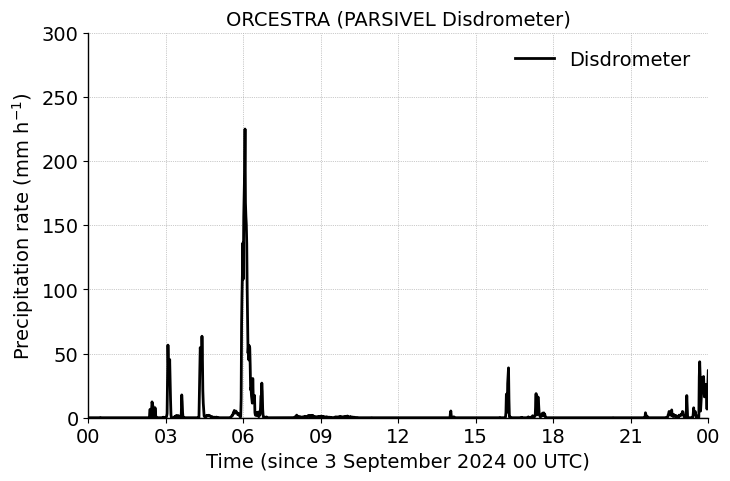

In [2]:

import fsspec

mapper = fsspec.get_mapper('https://ipfs.io/ipfs/bafybeihjcwsecgpmsjxoo5peqafnuqfnalu3ya3vtibwl7qkm76izsnuei');
ds_disdrometer=xr.open_zarr(mapper, consolidated=True)

mask = (
    (ds_disdrometer.lon >= -32) & (ds_disdrometer.lon <= -28) &
    (ds_disdrometer.lat >= 7) & (ds_disdrometer.lat <= 11)
).compute()

ds_disdrometer = ds_disdrometer.where(mask, drop=True)

fnt=14;
ln=2;
plt.figure(figsize=(8, 5))
plt.style.use('default')

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_disdrometer.time, ds_disdrometer.rain_rate_qc, '-', color='k', linewidth=ln, label='Disdrometer')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,300)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Precipitation rate (mm h$^{-1}$)', fontsize=fnt)#, fontweight='bold')
plt.title('ORCESTRA (PARSIVEL Disdrometer)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.show()

In [3]:

file_path='/work/bk1415/b382718/output/orcestra/nested_run/icon_output/marine_ccn/latent_heat/sull_ds'
#ds_4sip_long = xr.open_mfdataset(f'{file_path}/4sip/longer_run/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_4sip = xr.open_mfdataset(f'{file_path}/4sip/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_nosip = xr.open_mfdataset(f'{file_path}/nosip/orcestra_2mom/NWP_LAM_icongrid_DOM04*.nc', chunks={'time': 4, 'height': 10}, parallel=True);
ds_icongrid = xr.open_mfdataset(f'{file_path}/4sip/orcestra_2mom/ICONCONST_icongrid_DOM04_ML_0001.nc', chunks={'time': 4, 'height': 10}, parallel=True)


/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and 'types.GenericAlias'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/home/b/b382718/own_env/lib/python3.9/site-packages/xarray/backends/plugins.py:80: RuntimeWarning: Engine 'earthkit' loading failed:
unsupported operand type(s) for |: 'type' and

In [4]:

ds_nosip['w_vel'] = -1.*ds_nosip.omega/(9.8*ds_nosip.rho)
ds_nosip['tempc'] = ds_nosip.temp-273.16;
ds_nosip['lwc_gperm3']  = ds_nosip.qc*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tqi'] = ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['tq'] = ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh
ds_nosip['ciwc_gperm3'] = ds_nosip.qi*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['tiwc_gperm3'] = (ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['twc_gperm3'] = (ds_nosip.qc+ds_nosip.qi+ds_nosip.qs+ds_nosip.qg+ds_nosip.qh)*ds_nosip.rho*1.e3 # kgperm3 to gperm3
ds_nosip['cdnc_percm3'] = ds_nosip.qnc*ds_nosip.rho*1.e-6  # perkg to percm3
ds_nosip['inc_perl'] = (ds_nosip.qni+ds_nosip.qns+ds_nosip.qng+ds_nosip.qnh)*ds_nosip.rho*1.e-3 # perkg to perl
ds_nosip['inp_perl'] = (ds_nosip.d_qni_het)*ds_nosip.rho*1.e-3 # perkg to perl

ds_4sip['w_vel'] = -1.*ds_4sip.omega/(9.8*ds_4sip.rho)
ds_4sip['tempc'] = ds_4sip.temp-273.16;
ds_4sip['lwc_gperm3']  = ds_4sip.qc*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tqi'] = ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['tq'] = ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh
ds_4sip['ciwc_gperm3'] = ds_4sip.qi*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['tiwc_gperm3'] = (ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['twc_gperm3'] = (ds_4sip.qc+ds_4sip.qi+ds_4sip.qs+ds_4sip.qg+ds_4sip.qh)*ds_4sip.rho*1.e3 # kgperm3 to gperm3
ds_4sip['cdnc_percm3'] = ds_4sip.qnc*ds_4sip.rho*1.e-6  # perkg to percm3
ds_4sip['inc_perl'] = (ds_4sip.qni+ds_4sip.qns+ds_4sip.qng+ds_4sip.qnh)*ds_4sip.rho*1.e-3 # perkg to perl
ds_4sip['inp_perl'] = (ds_4sip.d_qni_het)*ds_4sip.rho*1.e-3 # perkg to perl

#ds_4sip_long['w_vel'] = -1.*ds_4sip_long.omega/(9.8*ds_4sip_long.rho)
#ds_4sip_long['tempc'] = ds_4sip_long.temp-273.16;
#ds_4sip_long['lwc_gperm3']  = ds_4sip_long.qc*ds_4sip_long.rho*1.e3 # kgperm3 to gperm3
#ds_4sip_long['tqi'] = ds_4sip_long.qi+ds_4sip_long.qs+ds_4sip_long.qg+ds_4sip_long.qh
#ds_4sip_long['tq'] = ds_4sip_long.qc+ds_4sip_long.qi+ds_4sip_long.qs+ds_4sip_long.qg+ds_4sip_long.qh
#ds_4sip_long['ciwc_gperm3'] = ds_4sip_long.qi*ds_4sip_long.rho*1.e3 # kgperm3 to gperm3
#ds_4sip_long['tiwc_gperm3'] = (ds_4sip_long.qi+ds_4sip_long.qs+ds_4sip_long.qg+ds_4sip_long.qh)*ds_4sip_long.rho*1.e3 # kgperm3 to gperm3
#ds_4sip_long['twc_gperm3'] = (ds_4sip_long.qc+ds_4sip_long.qi+ds_4sip_long.qs+ds_4sip_long.qg+ds_4sip_long.qh)*ds_4sip_long.rho*1.e3 # kgperm3 to gperm3
#ds_4sip_long['cdnc_percm3'] = ds_4sip_long.qnc*ds_4sip_long.rho*1.e-6  # perkg to percm3
#ds_4sip_long['inc_perl'] = (ds_4sip_long.qni+ds_4sip_long.qns+ds_4sip_long.qng+ds_4sip_long.qnh)*ds_4sip_long.rho*1.e-3 # perkg to perl
#ds_4sip_long['inp_perl'] = (ds_4sip_long.d_qni_het)*ds_4sip_long.rho*1.e-3 # perkg to perl


#==========================================
# Geometric height at half level (z_ifc)
#==========================================

z_ifc_2d = ds_icongrid['z_ifc']
z_ifc_2d = z_ifc_2d.rename({'height':'height_2'})

time = ds_4sip['time']
z_ifc_3d = z_ifc_2d.expand_dims(time=time)
z_ifc_3d = z_ifc_3d.transpose('time', 'height_2', 'ncells')
ds_4sip = ds_4sip.assign(z_ifc=z_ifc_3d)
ds_nosip = ds_nosip.assign(z_ifc=z_ifc_3d)

#plt.plot(ds_4sip.z_ifc.mean(dim=('time','ncells')), 'k-')
#plt.plot(ds_4sip.z_mc.mean(dim=('time','ncells')), 'b-')
#plt.plot(ds_icongrid.z_ifc.mean(dim=('ncells')), 'r-')


In [6]:


dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))


acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')
acc_precip_4sip_long = ds_4sip_long.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_4sip_long = ds_4sip_long.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours #0.5
precip_rate_4sip_long = del_prec_4sip_long/dt_hours



fnt=18
ln = 3
plt.figure(figsize=(24, 6))
plt.style.use('default')
plt.subplot(1,2,1)
#plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='r', label="No SIP", linewidth = ln)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="Control (No spin-up)", linewidth = ln)
plt.plot(ds_4sip_long.time, acc_precip_4sip_long, "k--", label="Control (8 h spin-up)", linewidth = ln)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fnt)
start_date = datetime(2024, 9, 2, 15, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 4, 0, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('Accumulated surface precipitation [CAIPEEX]', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fnt, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=ln, label='Control (No spin-up)')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip_long.mean('ncells'), 'k--', linewidth=ln, label='Control (8 h spin-up)')

plt.ylim(0, 6)
plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fnt)
start_date = datetime(2024, 9, 2, 15, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 4, 0, 0)
plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('Surface precipitation rate [CAIPEEX]', fontsize=fnt)
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)

plt.tight_layout()
plt.show()



NameError: name 'ds_4sip_long' is not defined

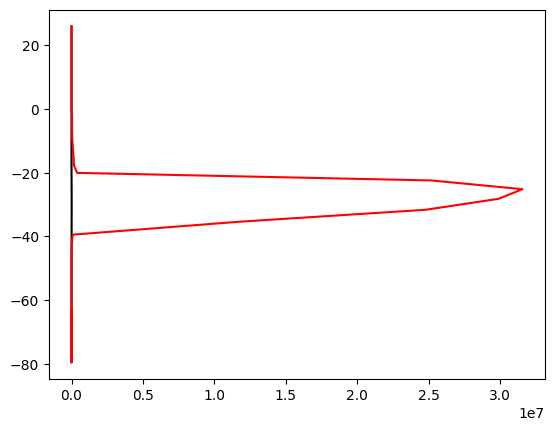

In [15]:
plt.style.use('default')
plt.plot(ds_4sip.inc_perl.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-')
plt.plot(ds_4sip.tice_br_perl.mean(dim=('time','ncells')), mean_tempc_4sip, 'r-')

In [4]:

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()


In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2022-08-02T17:00:00.000000000','2022-08-02T23:00:00.000000000')).mean(dim=('time','ncells')).values
#w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2022-08-02T17:00:00.000000000','2022-08-02T23:00:00.000000000')).mean(dim=('time','ncells')).values

#w_vel_4sip = ds_4sip.w_vel.values.flatten()
#w_vel_nosip = ds_nosip.w_vel.values.flatten()

fnt = 14;
ln = 2;
# CDF Plot
plt.figure(figsize=(8, 5))
plt.style.use('default')

for data, label, color in [
    (w_vel_4sip, 'Control', 'k'),
    (w_vel_nosip, 'No SIP', 'r')
]:
    sorted_data = np.sort(data[~np.isnan(data)])
    cdf = np.arange(1, len(sorted_data)+1) / len(sorted_data)
    plt.plot(sorted_data, cdf, label=label, color=color, linewidth=ln)

#plt.xlim(0, 1.2); 
#plt.ylim(0, 1.2); 
#plt.xticks([0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2], fontsize=fnt)
#plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2], fontsize=fnt)
plt.yscale('log')
plt.xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fnt)
plt.ylabel('Cumulative Probability', fontsize=fnt)
plt.title('Vertical velocity (ORCESTRA)',fontsize=fnt)
#plt.title('CDF Comparison of CLWP Distributions')
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt.grid(True, linestyle=':', color='grey', linewidth=0.5, alpha=0.5)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()

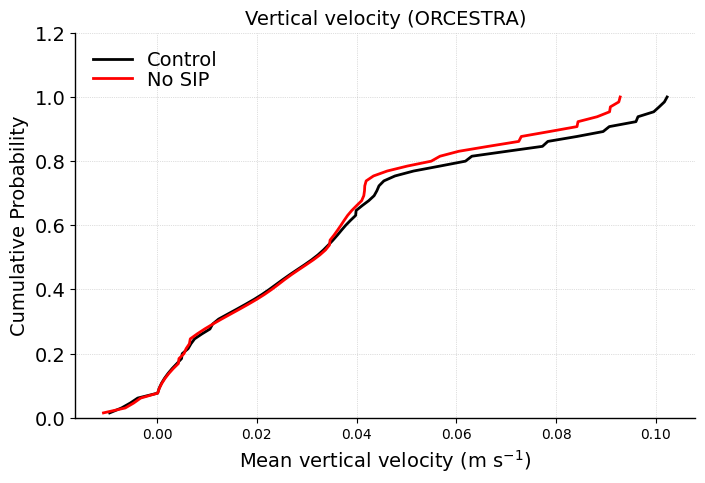

In [9]:

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).mean(dim=('time','ncells')).values
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).mean(dim=('time','ncells')).values

#w_vel_4sip = ds_4sip.w_vel.values.flatten()
#w_vel_nosip = ds_nosip.w_vel.values.flatten()

fnt = 14;
ln = 2;
# CDF Plot
plt.figure(figsize=(8, 5))
plt.style.use('default')

for data, label, color in [
    (w_vel_4sip, 'Control', 'k'),
    (w_vel_nosip, 'No SIP', 'r')
]:
    sorted_data = np.sort(data[~np.isnan(data)])
    cdf = np.arange(1, len(sorted_data)+1) / len(sorted_data)
    plt.plot(sorted_data, cdf, label=label, color=color, linewidth=ln)

#plt.xlim(0, 1.2); 
plt.ylim(0, 1.2); 
#plt.xticks([0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2], fontsize=fnt)
plt.yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2], fontsize=fnt)
plt.xlabel('Mean vertical velocity (m s$^{-1}$)', fontsize=fnt)
plt.ylabel('Cumulative Probability', fontsize=fnt)
plt.title('Vertical velocity (ORCESTRA)',fontsize=fnt)
#plt.title('CDF Comparison of CLWP Distributions')
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt.grid(True, linestyle=':', color='grey', linewidth=0.5, alpha=0.5)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()

In [5]:

grid_orc = xr.open_mfdataset(f'{file_path}/4sip/orcestra_2mom/domain4_DOM04.nc');


clon_deg = np.degrees(grid_orc.clon)
clat_deg = np.degrees(grid_orc.clat)

print(clon_deg.min().values); print(clon_deg.max().values);
print(clat_deg.min().values); print(clat_deg.max().values);

okla_x, okla_y = np.array([-30., 9.])
#print(okla_x), print(okla_y)
dx_deg = 2.; dy_deg = 2.0
left_bound = okla_x - dx_deg
right_bound = okla_x + dx_deg
top_bound = okla_y + dy_deg
bottom_bound = okla_y - dy_deg

print(left_bound), print(right_bound)
print(top_bound), print(bottom_bound)

window_cell = (
    (grid_orc.clat >= np.deg2rad(bottom_bound))
    & (grid_orc.clat <= np.deg2rad(top_bound))
    & (grid_orc.clon >= np.deg2rad(left_bound))
    & (grid_orc.clon <= np.deg2rad(right_bound))
).values

(window_cell_indices,) = np.where(window_cell)


# select cells matching with the area of interest (windows_cell_indices:: matching to that with the area sampled by the aircraft)
window_vertex_indices = (np.unique(grid_orc.vertex_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_vertex_indices ::',window_vertex_indices)

# select edges matching with the area of interest (corresponding to the windows_cell_indices)
window_edge_indices = (np.unique(grid_orc.edge_of_cell.isel(cell=window_cell_indices).values) - 1)
print('window_edge_indices ::',window_edge_indices)

selected_indices = xr.Dataset(
    {
        "cell": ("cell", window_cell_indices),
        "vertex": ("vertex", window_vertex_indices),
        "edge": ("edge", window_edge_indices),
    }
)

vars_to_renumber = {
    "cell": [
        "adjacent_cell_of_edge",
        "cells_of_vertex",
        "neighbor_cell_index",
    ],
    "vertex": ["vertex_of_cell", "edge_vertices", "vertices_of_vertex"],
    "edge": ["edge_of_cell", "edges_of_vertex"],
}


def reindex_grid(grid, indices, vars_to_renumber):
    new_grid = grid.load().isel(
        cell=indices.cell, vertex=indices.vertex, edge=indices.edge
    )
    for dim, idx in indices.coords.items():
        renumbering = np.full(grid.dims[dim], -2, dtype="int")
        renumbering[idx] = np.arange(len(idx))
        for name in vars_to_renumber[dim]:
            new_grid[name].data = renumbering[new_grid[name].data - 1] + 1
    return new_grid

new_grid_orc = reindex_grid(grid_orc, selected_indices, vars_to_renumber)
mask=np.isin(ds_4sip['ncells'], selected_indices.cell)
mask_cells=mask


-32.03759442634206
-27.96236307373933
6.967468001138239
11.031985309167817
-32.0
-28.0
11.0
7.0
window_vertex_indices :: [    4     7    15 ... 37370 37371 37372]
window_edge_indices :: [    63     64     65 ... 111329 111330 111331]


In [6]:

new_grid_orc = reindex_grid(grid_orc, selected_indices, vars_to_renumber)
mask=np.isin(ds_4sip['ncells'], selected_indices.cell)
mask_cells=mask

ds_nosip_new = ds_nosip.sel(ncells=mask)
ds_4sip_new = ds_4sip.sel(ncells=mask)
ds_norf_new = ds_norf.sel(ncells=mask)
ds_nohm_new = ds_nohm.sel(ncells=mask)
ds_nobr_new = ds_nobr.sel(ncells=mask)
ds_nosb_new = ds_nosb.sel(ncells=mask)


NameError: name 'ds_norf' is not defined

In [7]:

mean_ht_nosip = 1.e-3*ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = 1.e-3*ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

variables = [mean_tempc_nosip, mean_tempc_4sip]
numpy_variables = [var.values for var in variables]

mean_tempc_nosip = numpy_variables[0]
mean_tempc_4sip = numpy_variables[1]

variables = [mean_ht_nosip, mean_ht_4sip]
numpy_variables = [var.values for var in variables]

mean_ht_nosip = numpy_variables[0]
mean_ht_4sip = numpy_variables[1]


## Wind shear

In [7]:

du_4sip = ds_4sip.u.diff('height')
dv_4sip = ds_4sip.v.diff('height')
dz_4sip = -1*ds_4sip.z_mc.diff('height')

wind_shear_4sip = np.sqrt(du_4sip**2. + dv_4sip**2.)/dz_4sip

du_nosip = ds_nosip.u.diff('height')
dv_nosip = ds_nosip.v.diff('height')
dz_nosip = -1*ds_nosip.z_mc.diff('height')

wind_shear_nosip = np.sqrt(du_nosip**2. + dv_nosip**2.)/dz_nosip



In [ ]:

mean_wind_shear_4sip = wind_shear_4sip.mean(dim=('time', 'ncells'))
mean_wind_shear_nosip = wind_shear_nosip.mean(dim=('time', 'ncells'))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_wind_shear_4sip, mean_tempc_4sip[:-1], 'k-', linewidth=lnwdth, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_wind_shear_nosip, mean_tempc_nosip[:-1], '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-0.01, 0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Wind shear (s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.tight_layout()
plt.show()


## Freezing and Homogeneous level 

In [8]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.tqi > 1.e-6)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.tqi > 1.e-6)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


## SIP process rate

In [9]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = 1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel > thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_het_4sip = (ds_4sip.d_qni_het.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')
mean_qni_het_4sip = mean_qni_het_4sip/dt_hours.mean('time')


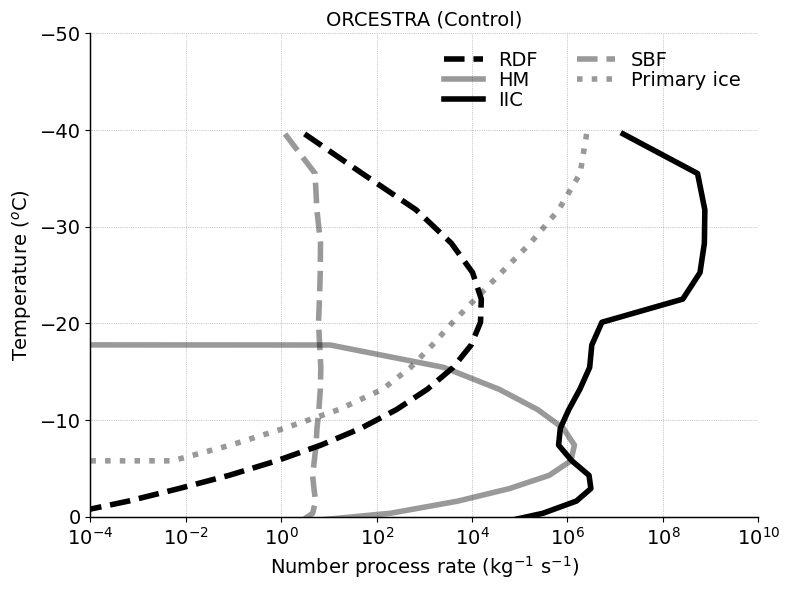

In [16]:

sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

mean_qni_rf_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_hm_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_br_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_sb_4sip[mean_tempc_4sip_sorted < -40.] = np.nan
mean_qni_het_4sip[mean_tempc_4sip_sorted < -40.] = np.nan


fontsize=14;
lnwdth=4;
alpha=0.6;
alp1=1;
alp1=1;
alp2=0.4;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
#plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
#plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
#plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp1, linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp2, linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip_sorted, '-', color='k', alpha=alp1, linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip_sorted, '--', color='k', alpha=alp2, linewidth=lnwdth, label='SBF')

plt1.plot(mean_qni_het_4sip*fact, mean_tempc_4sip_sorted, ':', color='k', alpha=alp2, linewidth=lnwdth, label='Primary ice')

#plt2.plot(mean_qni_tot_sec_4sip/dt_hours*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -50)
#plt2.set_ylim(0.5, 14)
plt2.set_yticks([])

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
#plt1.set_yticks([0, -10, -20, -30, -40, -50, -60])
#plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=2, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Microphysical properties

/home/b/b382718/own_env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/home/b/b382718/own_env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/home/b/b382718/own_env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/home/b/b382718/own_env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in log
  return func(*(_execute_task(a, cache) for a in args))


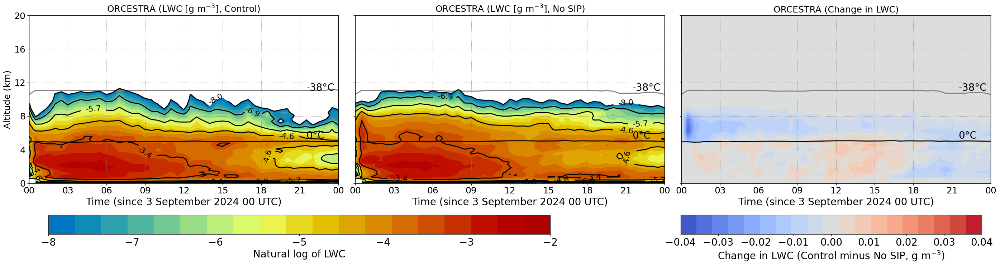

In [29]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

#mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
#mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
#mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.04, 0.04, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.04, -0.03, -0.02, -0.01, 0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


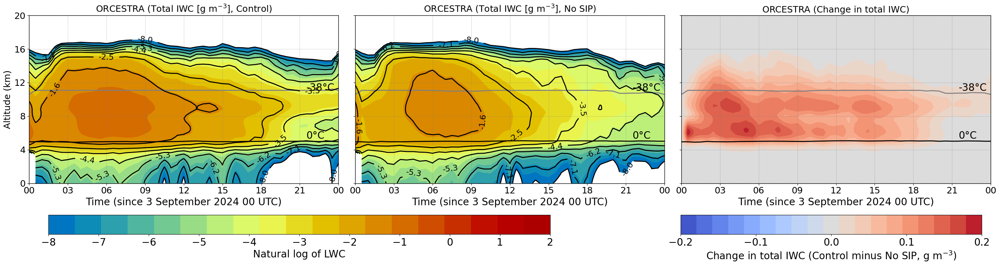

In [30]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip > 0.0001, np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, 2, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.2, -0.1, 0, 0.1, 0.20], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


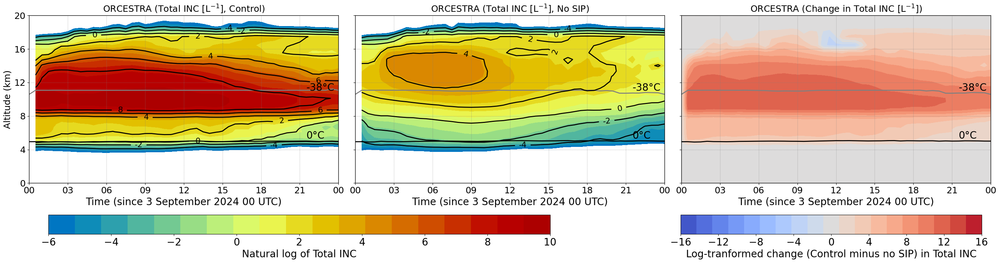

In [35]:

import matplotlib.lines as mlines


## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)


mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-16, 16, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12, 14], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-16, -12, -8, -4, 0, 4, 8, 12, 16], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-tranformed change (Control minus no SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


## Latent heat

In [10]:


r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_4sip = ds_4sip.qv;
cv_m_4sip  = cv_d*(1. + 0.97*q_vap_4sip);

# d_qr_rf == d_qi_rf + d_qs_rf + d_qg_rf + d_qh_rf
# d_qsgh_evap =/ d_qs_evap + d_qg_evap + d_qh_evap

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf) +                     # freezing
                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qs_evap + ds_4sip.d_qg_evap + ds_4sip.d_qh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
                      )

cond_latent_heat_4sip = (lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) 
dep_latent_heat_4sip  = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep)
rime_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + 
                                            ds_4sip.d_qr_rime_s + ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh)
satad_latent_heat_4sip = (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2)
homhet_latent_heat_4sip = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet)
rain_freez_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf)
evap_latent_heat_4sip = (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qs_evap + ds_4sip.d_qg_evap + ds_4sip.d_qh_evap)
melt_latent_heat_4sip = (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_4sip = (1./1800.) * np.gradient(tot_latent_heating_4sip, axis=0) # w.r.t. time
tot_latent_heating_kperd_4sip = tot_latent_heating_kpers_4sip * 86400.
mean_tot_latent_heating_kperd_4sip = np.mean(tot_latent_heating_kperd_4sip, axis=(0,2))
ds_4sip['tot_lhr_kperd'] = (ds_4sip.tempc.dims, tot_latent_heating_kperd_4sip)


## LHR condensation
cond_latent_heat_kpers_4sip = (1./1800.) * np.gradient(cond_latent_heat_4sip, axis=0) # w.r.t. time
cond_latent_heat_kperd_4sip = cond_latent_heat_kpers_4sip * 86400.
mean_cond_latent_heat_kperd_4sip = np.mean(cond_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['cond_lhr_kperd'] = (ds_4sip.tempc.dims, cond_latent_heat_kperd_4sip)

## LHR deposition
dep_latent_heat_kpers_4sip = (1./1800.) * np.gradient(dep_latent_heat_4sip, axis=0) # w.r.t. time
dep_latent_heat_kperd_4sip = dep_latent_heat_kpers_4sip * 86400.
mean_dep_latent_heat_kperd_4sip = np.mean(dep_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['dep_lhr_kperd'] = (ds_4sip.tempc.dims, dep_latent_heat_kperd_4sip)

## LHR riming
rime_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rime_latent_heat_4sip, axis=0) # w.r.t. time
rime_latent_heat_kperd_4sip = rime_latent_heat_kpers_4sip * 86400.
mean_rime_latent_heat_kperd_4sip = np.mean(rime_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rime_lhr_kperd'] = (ds_4sip.tempc.dims, rime_latent_heat_kperd_4sip)

## LHR saturation adjustment
satad_latent_heat_kpers_4sip = (1./1800.) * np.gradient(satad_latent_heat_4sip, axis=0) # w.r.t. time
satad_latent_heat_kperd_4sip = satad_latent_heat_kpers_4sip * 86400.
mean_satad_latent_heat_kperd_4sip = np.mean(satad_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['satad_lhr_kperd'] = (ds_4sip.tempc.dims, satad_latent_heat_kperd_4sip)

## LHR homhet
homhet_latent_heat_kpers_4sip = (1./1800.) * np.gradient(homhet_latent_heat_4sip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_4sip = homhet_latent_heat_kpers_4sip * 86400.
mean_homhet_latent_heat_kperd_4sip = np.mean(homhet_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['homhet_lhr_kperd'] = (ds_4sip.tempc.dims, homhet_latent_heat_kperd_4sip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rain_freez_latent_heat_4sip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_4sip = rain_freez_latent_heat_kpers_4sip * 86400.
mean_rain_freez_latent_heat_kperd_4sip = np.mean(rain_freez_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rainfreez_lhr_kperd'] = (ds_4sip.tempc.dims, rain_freez_latent_heat_kperd_4sip)

## LHR evaporation
evap_latent_heat_kpers_4sip = (1./1800.) * np.gradient(evap_latent_heat_4sip, axis=0) # w.r.t. time
evap_latent_heat_kperd_4sip = evap_latent_heat_kpers_4sip * 86400.
mean_evap_latent_heat_kperd_4sip = np.mean(evap_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['evap_lhr_kperd'] = (ds_4sip.tempc.dims, evap_latent_heat_kperd_4sip)

## LHR melting
melt_latent_heat_kpers_4sip = (1./1800.) * np.gradient(melt_latent_heat_4sip, axis=0) # w.r.t. time
melt_latent_heat_kperd_4sip = melt_latent_heat_kpers_4sip * 86400.
mean_melt_latent_heat_kperd_4sip = np.mean(melt_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['melt_lhr_kperd'] = (ds_4sip.tempc.dims, melt_latent_heat_kperd_4sip)



In [11]:
r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_nosip = ds_nosip.qv;
cv_m_nosip  = cv_d*(1. + 0.97*q_vap_nosip);

# d_qr_rf == d_qi_rf + d_qs_rf + d_qg_rf + d_qh_rf
# d_qsgh_evap =/ d_qs_evap + d_qg_evap + d_qh_evap

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heating_nosip = ((lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep) + # deposition
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s + ds_nosip.d_qr_rime_s +
                                     ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet) +
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf) +                     # freezing
                       (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qs_evap + ds_nosip.d_qg_evap + ds_nosip.d_qh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)      # melting
                      )

cond_latent_heat_nosip = (lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc)
dep_latent_heat_nosip  = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep)
rime_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s +
                                            ds_nosip.d_qr_rime_s + ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh)
satad_latent_heat_nosip = (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2)
homhet_latent_heat_nosip = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet)
rain_freez_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf)
evap_latent_heat_nosip = (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qs_evap + ds_nosip.d_qg_evap + ds_nosip.d_qh_evap)
melt_latent_heat_nosip = (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)

## Total latent heating
tot_latent_heating_kpers_nosip = (1./1800.) * np.gradient(tot_latent_heating_nosip, axis=0) # w.r.t. time
tot_latent_heating_kperd_nosip = tot_latent_heating_kpers_nosip * 86400.
mean_tot_latent_heating_kperd_nosip = np.mean(tot_latent_heating_kperd_nosip, axis=(0,2))
ds_nosip['tot_lhr_kperd'] = (ds_nosip.tempc.dims, tot_latent_heating_kperd_nosip)


## LHR condensation
cond_latent_heat_kpers_nosip = (1./1800.) * np.gradient(cond_latent_heat_nosip, axis=0) # w.r.t. time
cond_latent_heat_kperd_nosip = cond_latent_heat_kpers_nosip * 86400.
mean_cond_latent_heat_kperd_nosip = np.mean(cond_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['cond_lhr_kperd'] = (ds_nosip.tempc.dims, cond_latent_heat_kperd_nosip)

## LHR deposition
dep_latent_heat_kpers_nosip = (1./1800.) * np.gradient(dep_latent_heat_nosip, axis=0) # w.r.t. time
dep_latent_heat_kperd_nosip = dep_latent_heat_kpers_nosip * 86400.
mean_dep_latent_heat_kperd_nosip = np.mean(dep_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['dep_lhr_kperd'] = (ds_nosip.tempc.dims, dep_latent_heat_kperd_nosip)

## LHR riming
rime_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rime_latent_heat_nosip, axis=0) # w.r.t. time
rime_latent_heat_kperd_nosip = rime_latent_heat_kpers_nosip * 86400.
mean_rime_latent_heat_kperd_nosip = np.mean(rime_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rime_lhr_kperd'] = (ds_nosip.tempc.dims, rime_latent_heat_kperd_nosip)

## LHR saturation adjustment
satad_latent_heat_kpers_nosip = (1./1800.) * np.gradient(satad_latent_heat_nosip, axis=0) # w.r.t. time
satad_latent_heat_kperd_nosip = satad_latent_heat_kpers_nosip * 86400.
mean_satad_latent_heat_kperd_nosip = np.mean(satad_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['satad_lhr_kperd'] = (ds_nosip.tempc.dims, satad_latent_heat_kperd_nosip)

## LHR homhet
homhet_latent_heat_kpers_nosip = (1./1800.) * np.gradient(homhet_latent_heat_nosip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_nosip = homhet_latent_heat_kpers_nosip * 86400.
mean_homhet_latent_heat_kperd_nosip = np.mean(homhet_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['homhet_lhr_kperd'] = (ds_nosip.tempc.dims, homhet_latent_heat_kperd_nosip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rain_freez_latent_heat_nosip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_nosip = rain_freez_latent_heat_kpers_nosip * 86400.
mean_rain_freez_latent_heat_kperd_nosip = np.mean(rain_freez_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rainfreez_lhr_kperd'] = (ds_nosip.tempc.dims, rain_freez_latent_heat_kperd_nosip)

## LHR evaporation
evap_latent_heat_kpers_nosip = (1./1800.) * np.gradient(evap_latent_heat_nosip, axis=0) # w.r.t. time
evap_latent_heat_kperd_nosip = evap_latent_heat_kpers_nosip * 86400.
mean_evap_latent_heat_kperd_nosip = np.mean(evap_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['evap_lhr_kperd'] = (ds_nosip.tempc.dims, evap_latent_heat_kperd_nosip)

## LHR melting
melt_latent_heat_kpers_nosip = (1./1800.) * np.gradient(melt_latent_heat_nosip, axis=0) # w.r.t. time
melt_latent_heat_kperd_nosip = melt_latent_heat_kpers_nosip * 86400.
mean_melt_latent_heat_kperd_nosip = np.mean(melt_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['melt_lhr_kperd'] = (ds_nosip.tempc.dims, melt_latent_heat_kperd_nosip)


In [12]:



#==================================================================================================
mean_tot_lhr_kperd_4sip = ds_4sip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_4sip = (ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                 ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values)

mean_tot_lhr_kperd_nosip = ds_nosip.tot_lhr_kperd.mean(dim=('time','ncells')).values
mean_cond_lhr_kperd_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_kperd_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_kperd_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_kperd_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_kperd_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_kperd_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_kperd_nosip = (ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + 
                                  ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values)
#==================================================================================================

del_lhr_kperd_nosip = mean_tot_lhr_kperd_4sip-mean_tot_lhr_kperd_nosip

per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_tot_lhr_kperd_4sip


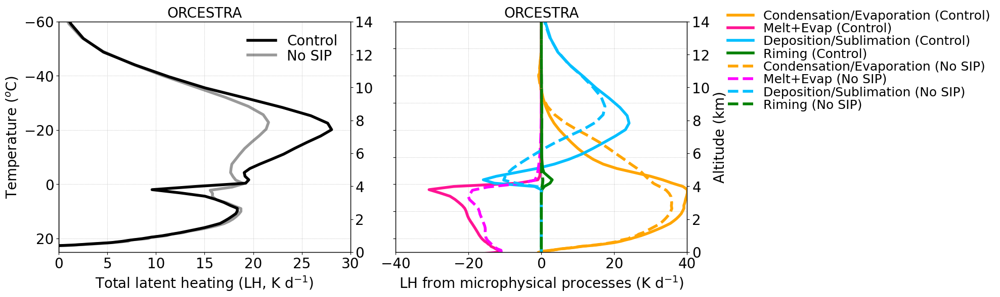

In [13]:



fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0., 14)

plt1.set_xticks([0, 5, 10, 15, 20, 25, 30])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip, '-', color='deeppink', linewidth=lnwdth, label='Melt+Evap (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip, '--', color='magenta', linewidth=lnwdth, label='Melt+Evap (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-40., 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1.1, 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


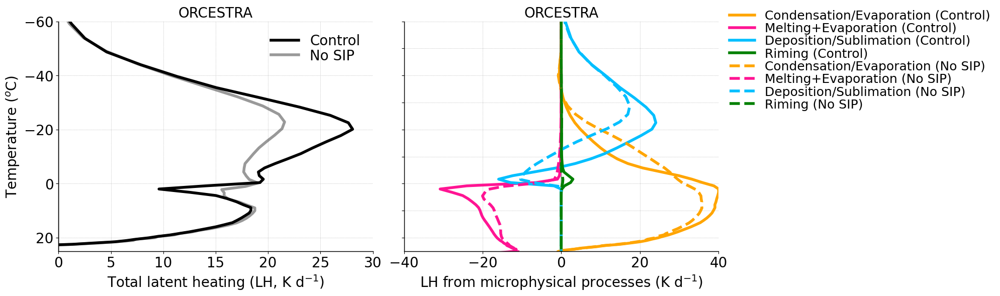

In [14]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]

sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]

fontsize=20;
lnwdth=4;
alpha=0.8;
alp1=1.0;
alp2=0.4; 

plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, alpha=alp1, label='Control')
plt1.plot(mean_tot_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_lhr_kperd_nosip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0., 14)

plt1.set_xticks([0, 5, 10, 15, 20, 25, 30])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_satad_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_melt_evap_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (Control)')
plt1.plot(mean_dep_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_rime_lhr_kperd_4sip, mean_tempc_4sip_sorted, '-', color='green', linewidth=lnwdth, label='Riming (Control)')
#plt1.plot(mean_cond_lhr_kperd_4sip, mean_tempc_4sip_sorted, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_satad_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='orange', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_melt_evap_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deeppink', linewidth=lnwdth, label='Melting+Evaporation (No SIP)')
plt1.plot(mean_dep_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='deepskyblue', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_rime_lhr_kperd_nosip, mean_tempc_nosip_sorted, '--', color='green', linewidth=lnwdth, label='Riming (No SIP)')
#plt1.plot(mean_cond_lhr_kperd_nosip, mean_tempc_nosip_sorted, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_kperd_4sip, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-40., 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, bbox_to_anchor=[1., 1.10], ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


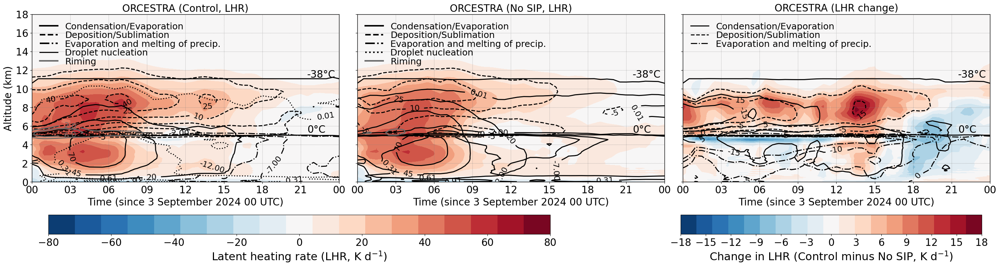

In [15]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.tot_lhr_kperd.mean(dim=('ncells'))-ds_nosip.tot_lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=3.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-18, 18, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=3, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')


contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 4) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln1, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-18, -15, -12, -9, -6, -3, 0, 3, 6, 9, 12, 15, 18])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


## Cloud radiative heating rates (CRH)

In [32]:
#============ CRH calculation

#Source: https://github.com/aikovoigt/nawdex-hackathon/blob/master/postprocessing/calc_heatingrates.py

def calc_heatingrates(ds):
    # expected input: xarray dataset that besides the radiative fluxes contains height at interface levels, air density and specific humidity
    # specific heat at constant volume for dry air and water vapor
    pcd = 1004.64 - 287.04
    pcv = 1869.46 - 461.51

    
    #z_ifc = 
    # geometric thickness of full levels, label='lower' for xr.diff is important for correct result
    dz_full = -1*ds['z_mc'].diff(dim='height', n=1, label='lower').rename('dz_full')#.rename({'height_ifc': 'height'})
    #dz_full = -1*ds['z_ifc'].diff(dim='height_ifc', n=1, label='upper').rename('dz_full').rename({'height_2': 'height'})
    # mass of air
    pmair = ds['rho'] * dz_full
    # conversion factor for flux divergence to heating rate
    zconv = 1.0/(pmair*(pcd+(pcv-pcd)*ds['qv']))
    # calculate radiative heating rates from radiative fluxes, use "\_fromflux" to indicate that these were from fluxes
    ds['ddt_temp_radsw_fromflux'] = ( 
        -1*ds['swflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlw_fromflux'] = ( 
        -1*ds['lwflxall'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radswclr_fromflux'] = ( 
        -1*ds['swflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )
    ds['ddt_temp_radlwclr_fromflux'] = ( 
        -1*ds['lwflxclr'].diff(dim='height_2', n=1, label='lower').rename({'height_2':'height'})*zconv )

    # Total radiative temperature tendency (clr+cld)
    ds['ddt_temp_radtot_fromflux'] = (ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux'])

    # Clear-sky radiative temperature tendency (clr)
    ds['ddt_temp_radtot_clr_fromflux'] = (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux'])

    # Net Cloud-radiative heating
    ds['total_crh'] = ((ds['ddt_temp_radsw_fromflux'] + ds['ddt_temp_radlw_fromflux']) -
                       (ds['ddt_temp_radswclr_fromflux'] + ds['ddt_temp_radlwclr_fromflux']))

    # SW Cloud-radiative heating
    ds['crh_sw'] = ds['ddt_temp_radsw_fromflux'] - ds['ddt_temp_radswclr_fromflux']
    # Net Cloud-radiative heating
    ds['crh_lw'] = ds['ddt_temp_radlw_fromflux'] - ds['ddt_temp_radlwclr_fromflux']
    
    return ds




In [33]:
# Net radiative flux (Net flux) = downward − upward
# Total radiative tendency = SW + LW

#toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)

ds_4sip['swflxall'] = ds_4sip.swflx_dn - ds_4sip.swflx_up
ds_4sip['swflxclr'] = ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr
ds_4sip['lwflxall'] = ds_4sip.lwflx_dn - ds_4sip.lwflx_up
ds_4sip['lwflxclr'] = ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr

ds_4sip['tot_rad_ddt_temp'] = ds_4sip.ddt_temp_radlw + ds_4sip.ddt_temp_radsw

ds_nosip['swflxall'] = ds_nosip.swflx_dn - ds_nosip.swflx_up
ds_nosip['swflxclr'] = ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr
ds_nosip['lwflxall'] = ds_nosip.lwflx_dn - ds_nosip.lwflx_up
ds_nosip['lwflxclr'] = ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr


ds_nosip['tot_rad_ddt_temp'] = ds_nosip.ddt_temp_radlw + ds_nosip.ddt_temp_radsw

ds_4sip = calc_heatingrates(ds_4sip)
ds_nosip = calc_heatingrates(ds_nosip)


mean_tot_crh_kperd_4sip = 86400*ds_4sip.total_crh.mean(dim=('time','ncells')).values # K/s to K/d
mean_tot_crh_kperd_nosip = 86400*ds_nosip.total_crh.mean(dim=('time','ncells')).values

mean_sw_crh_kperd_4sip = 86400*ds_4sip.crh_sw.mean(dim=('time','ncells')).values # K/s to K/d
mean_sw_crh_kperd_nosip = 86400*ds_nosip.crh_sw.mean(dim=('time','ncells')).values

mean_lw_crh_kperd_4sip = 86400*ds_4sip.crh_lw.mean(dim=('time','ncells')).values # K/s to K/d
mean_lw_crh_kperd_nosip = 86400*ds_nosip.crh_lw.mean(dim=('time','ncells')).values

#std_tot_crh_kperd_4sip = 86400 * ds_4sip.total_crh.std(dim=('time', 'ncells')).values
#std_tot_crh_kperd_nosip = 86400 * ds_nosip.total_crh.std(dim=('time', 'ncells')).values

#n_count = ds_4sip.sizes['time'] * ds_4sip.sizes['ncells'] 
#se_tot_crh_kperd_4sip = 86400 * (std_tot_crh_kperd_4sip / np.sqrt(n_count))#.values
#se_tot_crh_kperd_nosip = 86400 * (std_tot_crh_kperd_nosip / np.sqrt(n_count))#.values


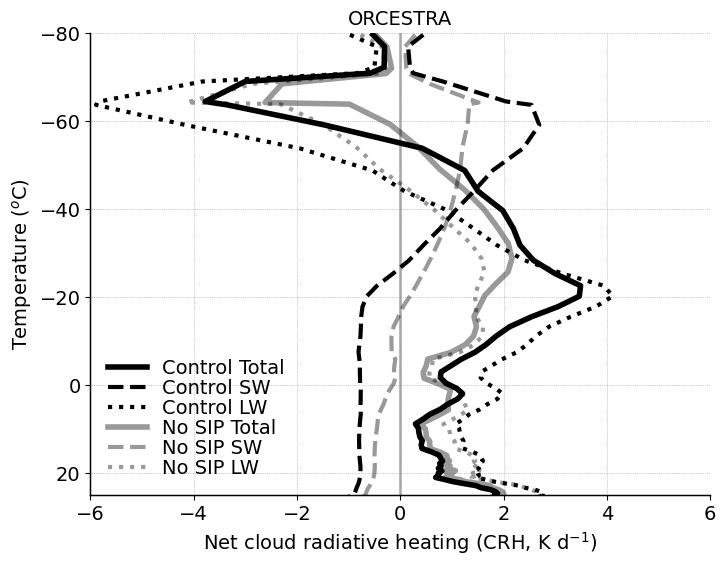

In [36]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

#plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control Total')
plt1.plot(mean_sw_crh_kperd_4sip, mean_tempc_4sip_sorted, '--', color='k', linewidth=lnwdth-1, label='Control SW ')
plt1.plot(mean_lw_crh_kperd_4sip, mean_tempc_4sip_sorted, ':', color='k', linewidth=lnwdth-1, label='Control LW')
plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'k-', linewidth=lnwdth, alpha=0.4, label='No SIP Total')
plt1.plot(mean_sw_crh_kperd_nosip, mean_tempc_nosip_sorted, '--', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP SW')
plt1.plot(mean_lw_crh_kperd_nosip, mean_tempc_nosip_sorted, ':', color='k', linewidth=lnwdth-1, alpha=0.4, label='No SIP LW')

#plt1.errorbar(mean_tot_crh_kperd_4sip, mean_tempc_4sip, yerr=std_tot_crh_kperd_4sip)

#plt1.fill_betweenx(mean_tempc_4sip, (mean_tot_crh_kperd_4sip-std_tot_crh_kperd_4sip),(mean_tot_crh_kperd_4sip+std_tot_crh_kperd_4sip), color='k', alpha=0.2)
#plt1.fill_betweenx(mean_tempc_nosip, (mean_tempc_nosip-std_tot_crh_kperd_nosip), (mean_tempc_nosip+std_tot_crh_kperd_nosip), color='r', alpha=0.2)#, label='ICON $\pm$ 1 STD DEV')
                 
plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_tot_crh_kperd_4sip, mean_ht_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-6, 6)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('Net cloud radiative heating (CRH, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

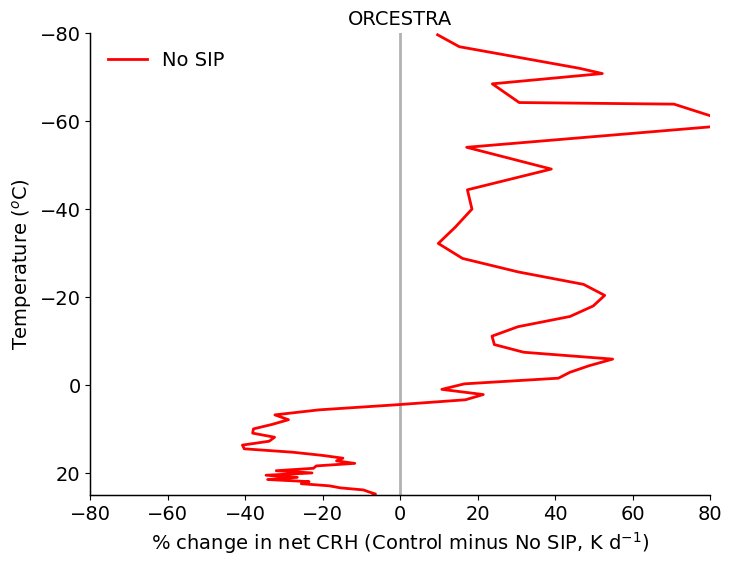

In [39]:
sort_idx = np.argsort(mean_tempc_4sip)
mean_tempc_4sip_sorted = mean_tempc_4sip[sort_idx]
mean_tot_crh_kperd_4sip_sorted = mean_tot_crh_kperd_4sip[sort_idx]

# Sort No SIP by temperature
sort_idx = np.argsort(mean_tempc_nosip)
mean_tempc_nosip_sorted = mean_tempc_nosip[sort_idx]
mean_tot_crh_kperd_nosip_sorted = mean_tot_crh_kperd_nosip[sort_idx]


fnt=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
#plt1.plot(mean_tot_crh_kperd_4sip, mean_tempc_4sip_sorted, 'k-', linewidth=lnwdth, label='Control')
#plt1.plot(mean_tot_crh_kperd_nosip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')
plt1.plot(100*(mean_tot_crh_kperd_4sip-mean_tot_crh_kperd_nosip)/mean_tot_crh_kperd_4sip, mean_tempc_nosip_sorted, 'r-', linewidth=lnwdth, label='No SIP')


plt1.set_xlim(-80, 80)
plt1.set_ylim(25, -80)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3, 4])
#plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])
plt2.set_yticks([])

plt1.tick_params(axis='x', labelsize=fnt)
plt1.tick_params(axis='y', labelsize=fnt)
plt2.tick_params(axis='y', labelsize=fnt)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

plt1.set_xlabel('% change in net CRH (Control minus No SIP, K d$^{-1}$)', fontsize=fnt)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fnt)
#plt2.set_ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA', fontsize=fnt)

plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

## Vertical velocity

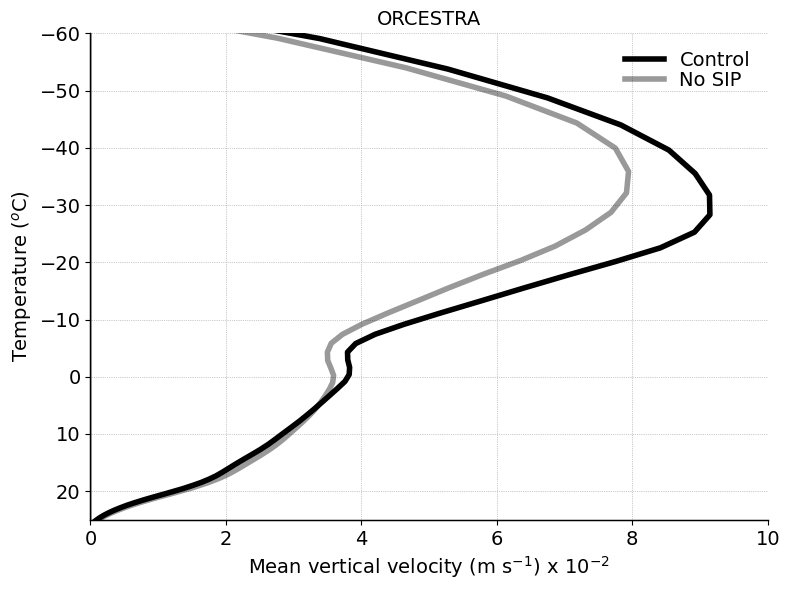

In [18]:

fontsize=14;
lnwdth=4;
alpha=0.8;
alp1=1;
alp2=0.4;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*ds_4sip.w_vel.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-', alpha=alp1, linewidth=lnwdth, label='Control')
plt1.plot(fac*ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, 'k-', alpha=alp2, linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0., 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)
plt2.set_yticks([])

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)
#plt1.yaxis.set_ticklabels([])
plt2.yaxis.set_ticklabels([])
plt2.set_yticks([])

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['top'].set_visible(False)
plt1.spines['right'].set_visible(False)
plt2.spines['top'].set_visible(False)
plt2.spines['right'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Freezing level and cloud top height

In [40]:

## Freezing and cloud top height
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.twc_gperm3 > 1.e-3)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.twc_gperm3 > 1.e-3)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


## Melting level thickness
ds_4sip['tot_q'] = ds_4sip.tq+ds_4sip.qr
mask = (ds_4sip.tempc > -1) & (ds_4sip.tempc < 1.)  & (ds_4sip.twc_gperm3 > 1.e-6) 
mean_melt_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')


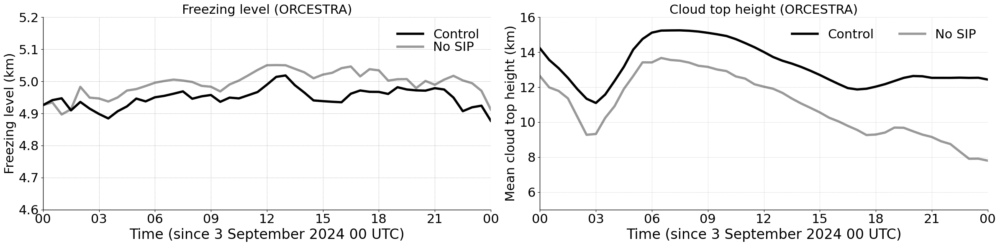

In [44]:

fnt=22;
ln=4;

alp1=1.0;
alp2=0.4;

plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', alpha=alp1, linewidth=ln, label='Control')
plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'k-', alpha=alp2, linewidth=ln, label='No SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(4.6, 5.2)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (ORCESTRA)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', alpha=alp1, linewidth=ln, label='Control')
plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'k-', alpha=alp2, linewidth=ln, label='No SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(6,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (ORCESTRA)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

/home/b/b382718/own_env/lib/python3.9/site-packages/dask/array/reductions.py:654: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)


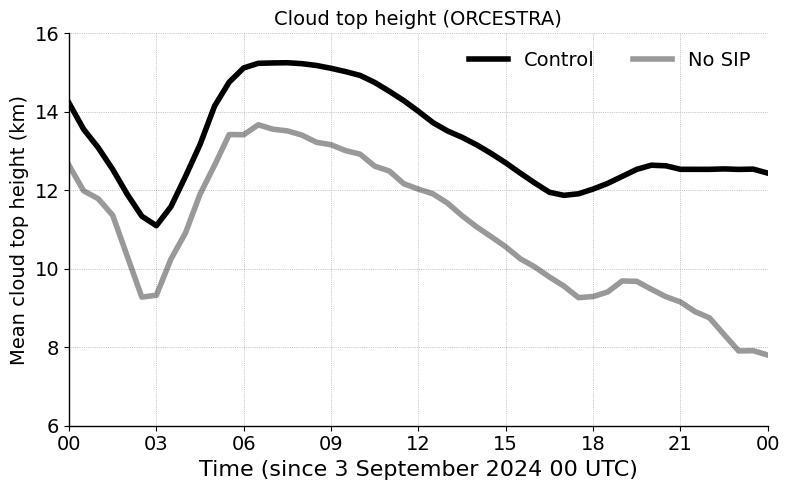

In [45]:

fnt=14;
ln=4;

alp1=1.0;
alp2=0.4;

plt.figure(figsize=(8, 5))
plt.style.use('default')

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', alpha=alp1, linewidth=ln, label='Control')
plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'k-', alpha=alp2, linewidth=ln, label='No SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(6,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (ORCESTRA)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

# Vertical velocity

In [8]:

#w_bin = (-8., -6., -4., -2., 0., 2., 4., 6., 8., 10., 12., 14., 16.)

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

w_bin = (-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35)
hist_counts_wvel_4sip, _ = np.histogram(w_vel_4sip, bins=w_bin)
hist_counts_wvel_nosip, _ = np.histogram(w_vel_nosip, bins=w_bin)


In [9]:


cape_4sip = ds_4sip.cape_ml.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cape_nosip = ds_nosip.cape_ml.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

cape_bin = (0, 400, 800, 1200, 1600, 2000, 2400, 2800)

hist_counts_cape_4sip, _ = np.histogram(cape_4sip, bins=cape_bin)
hist_counts_cape_nosip, _ = np.histogram(cape_nosip, bins=cape_bin)


In [10]:


w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

w_bin = (-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35)
hist_counts_wvel_4sip, _ = np.histogram(w_vel_4sip, bins=w_bin)
hist_counts_wvel_nosip, _ = np.histogram(w_vel_nosip, bins=w_bin)


lhr_4sip = ds_4sip.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nosip = ds_nosip.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

#lhr_bin = (-60, -50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80)

lhr_bin = (-80, -60, -40, -20, 0, 20, 40, 60, 80, 100)

hist_counts_lhr_4sip, _ = np.histogram(lhr_4sip, bins=lhr_bin)
hist_counts_lhr_nosip, _ = np.histogram(lhr_nosip, bins=lhr_bin)

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip


AttributeError: 'Dataset' object has no attribute 'lhr_kperd'

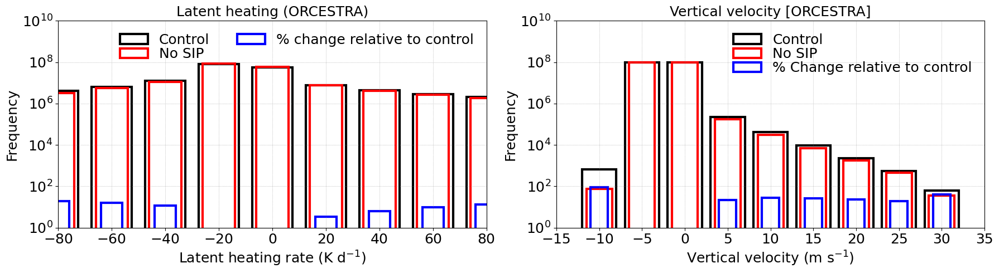

In [15]:



hist_norm_wvel_4sip = hist_counts_wvel_4sip / np.sum(hist_counts_wvel_4sip)
hist_norm_wvel_nosip = hist_counts_wvel_nosip / np.sum(hist_counts_wvel_nosip)
per_hist_count_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip)/hist_counts_wvel_4sip
per_hist_norm_wvel_nosip = 100*(hist_norm_wvel_4sip-hist_norm_wvel_nosip)/hist_norm_wvel_4sip

hist_counts_wvel_4sip_safe = np.where(hist_counts_wvel_4sip == 0, np.nan, hist_counts_wvel_4sip)
hist_ratio_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip) / hist_counts_wvel_4sip#_safe
hist_norm_diff_wvel_nosip = hist_norm_wvel_4sip-hist_norm_wvel_nosip

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_norm_lhr_nosip = 100*(hist_norm_lhr_4sip-hist_norm_lhr_nosip)/hist_norm_lhr_4sip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip

per_change_lhr_freq_nosip = 100.*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip

fnt=18;
ln=3;


plt.figure(figsize=(18, 5)) 
plt.style.use('default')

plt.subplot(1,2,1)
plt.bar(lhr_bin[:-1], hist_counts_lhr_4sip, width=15, align='center', edgecolor='k', facecolor='none', color='blue', linewidth=ln, label='Control')
plt.bar(lhr_bin[:-1], hist_counts_lhr_nosip, width=12., align='center', edgecolor='r', facecolor='none', color='orange', linewidth=ln, label='No SIP')
plt.bar(lhr_bin[:-1], per_hist_count_lhr_nosip, width=8., align='center', edgecolor='b', facecolor='none', color='blue', linewidth=ln, label='% change relative to control')

plt.xlim(-80, 80)
plt.xticks([-80, -60, -40, -20, 0, 20, 40, 60, 80], fontsize=fnt)

plt.ylim(1.e0, 1.e10)
plt.yticks([1.e0, 1.e2, 1.e4, 1.e6, 1.e8, 1.e10], fontsize=fnt)
plt.yscale('log')

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
plt.ylabel('Frequency', fontsize=fnt)
plt.title('Latent heating (ORCESTRA)', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=2, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)


plt.subplot(1,2,2)

plt.bar(w_bin[:-1], hist_counts_wvel_4sip, width=4, align='center', edgecolor='k', facecolor='none', color='blue', linewidth=ln, label='Control')
plt.bar(w_bin[:-1], hist_counts_wvel_nosip, width=3., align='center', edgecolor='r', facecolor='none', color='orange', linewidth=ln, label='No SIP')
plt.bar(w_bin[:-1], per_hist_count_wvel_nosip, width=2., align='center', edgecolor='b', facecolor='none', color='orange', linewidth=ln, label='% Change relative to control')

plt.xlim(-15, 35)
plt.xticks([-15, -10., -5, 0, 5, 10, 15, 20, 25, 30, 35], fontsize=fnt)

plt.yscale('log')
plt.ylim(1.e0, 1.e10)
plt.yticks([1.e0, 1.e2, 1.e4, 1.e6, 1.e8, 1.e10], fontsize=fnt)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
plt.ylabel('Frequency', fontsize=fnt)
plt.title('Vertical velocity [ORCESTRA]', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.tight_layout()
plt.show()


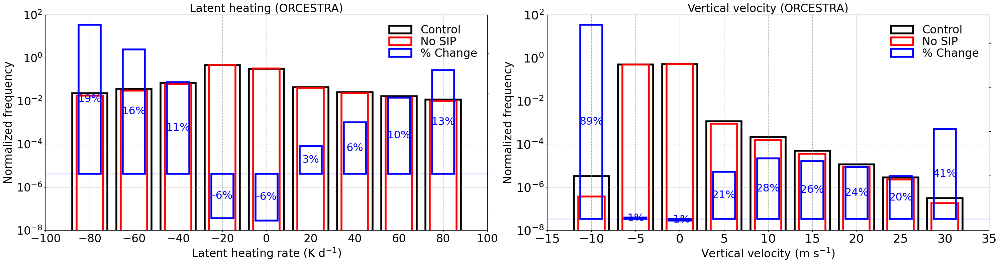

In [16]:

hist_norm_wvel_4sip = hist_counts_wvel_4sip / np.sum(hist_counts_wvel_4sip)
hist_norm_wvel_nosip = hist_counts_wvel_nosip / np.sum(hist_counts_wvel_nosip)
per_hist_count_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip)/hist_counts_wvel_4sip
per_hist_norm_wvel_nosip = 100*(hist_norm_wvel_4sip-hist_norm_wvel_nosip)/hist_norm_wvel_4sip

hist_counts_wvel_4sip_safe = np.where(hist_counts_wvel_4sip == 0, np.nan, hist_counts_wvel_4sip)
hist_ratio_wvel_nosip = 100*(hist_counts_wvel_4sip-hist_counts_wvel_nosip) / hist_counts_wvel_4sip#_safe
hist_norm_diff_wvel_nosip = hist_norm_wvel_4sip-hist_norm_wvel_nosip

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_norm_lhr_nosip = 100*(hist_norm_lhr_4sip-hist_norm_lhr_nosip)/hist_norm_lhr_4sip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip

fnt=24;
ln=4;

fig, axs = plt.subplots(1, 2, figsize=(30, 8), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# ⬅️ Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]
ax1.bar(lhr_bin[:-1], hist_norm_lhr_4sip, width=16, align='center',
        edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax1.bar(lhr_bin[:-1], hist_norm_lhr_nosip, width=12., align='center',
        edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax1b = ax1.twinx()
ax1b.bar(lhr_bin[:-1], per_hist_count_lhr_nosip, width=10., align='center',
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax1b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax1.set_xlim(-100, 100)
ax1.set_yscale('log')
ax1.set_ylim(1e-8, 1e2)
ax1.set_xticks([-100, -80, -60, -40, -20, 0, 20, 40, 60, 80, 100])
ax1.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax1.set_ylabel('Normalized frequency', fontsize=fnt)

#ax1b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax1b.set_ylim(-20, 100)
#ax1b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax1b.set_yticklabels([])

ax1.set_title('Latent heating (ORCESTRA)', fontsize=fnt)


# Grid, ticks
ax1.grid(True, linestyle='--', linewidth=0.6, color='grey', alpha=0.8)
ax1.tick_params(axis='both', labelsize=fnt)
ax1b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax1b.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper right', ncols=1)

for x, y in zip(lhr_bin[:-1], per_hist_count_lhr_nosip):
    if not np.isnan(y):
        #ax1b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt, color='b')
        ax1b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')
        
# ---------------------------------------------
# ➡️ Subplot 2: Vertical velocity (w)
# ---------------------------------------------
ax2 = axs[1]
ax2.bar(w_bin[:-1], hist_norm_wvel_4sip, width=4, align='center', edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax2.bar(w_bin[:-1], hist_norm_wvel_nosip, width=3., align='center', edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax2b = ax2.twinx()
ax2b.bar(w_bin[:-1], per_hist_count_wvel_nosip, width=2.5, align='center', 
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax2b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax2.set_xlim(-15, 35)
ax2.set_xticks([-15, -10., -5, 0, 5, 10, 15, 20, 25, 30, 35])
ax2.set_yscale('log')
ax2.set_ylim(1e-8, 1e2)
ax2.set_xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax2.set_ylabel('Normalized frequency', fontsize=fnt)

#ax2b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax2b.set_ylim(-20, 100)
#ax2b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax2b.set_yticklabels([])

ax2.set_title('Vertical velocity (ORCESTRA)', fontsize=fnt)

# Grid, ticks
ax2.grid(True, linestyle='--', linewidth=0.6, color='grey', alpha=0.8)
ax2.tick_params(axis='both', labelsize=fnt+2)
ax2b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax2.get_legend_handles_labels()
lines2, labels2 = ax2b.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')


for x, y in zip(w_bin[:-1], per_hist_count_wvel_nosip):
    if not np.isnan(y):
        #ax2b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt-2, color='b')
        ax2b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')

        
# Layout
plt.tight_layout()
plt.show()


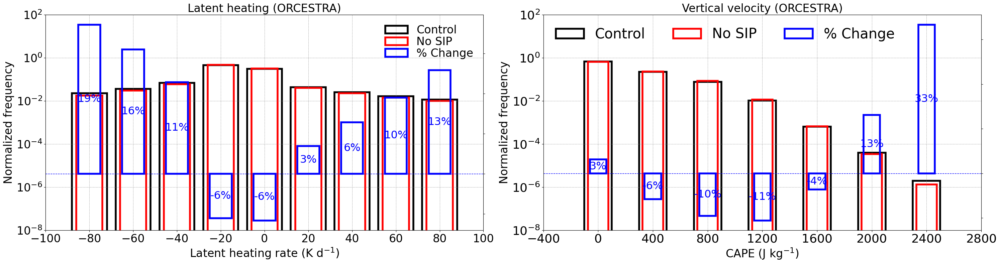

In [17]:

hist_norm_cape_4sip = hist_counts_cape_4sip / np.sum(hist_counts_cape_4sip)
hist_norm_cape_nosip = hist_counts_cape_nosip / np.sum(hist_counts_cape_nosip)
per_hist_count_cape_nosip = 100*(hist_counts_cape_4sip-hist_counts_cape_nosip)/hist_counts_cape_4sip
per_hist_norm_cape_nosip = 100*(hist_norm_cape_4sip-hist_norm_cape_nosip)/hist_norm_cape_4sip

hist_counts_cape_4sip_safe = np.where(hist_counts_cape_4sip == 0, np.nan, hist_counts_cape_4sip)
hist_ratio_cape_nosip = 100*(hist_counts_cape_4sip-hist_counts_cape_nosip) / hist_counts_cape_4sip#_safe
hist_norm_diff_cape_nosip = hist_norm_cape_4sip-hist_norm_cape_nosip

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
per_hist_norm_lhr_nosip = 100*(hist_norm_lhr_4sip-hist_norm_lhr_nosip)/hist_norm_lhr_4sip
per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip

fnt=24;
ln=4;

fig, axs = plt.subplots(1, 2, figsize=(30, 8), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# ⬅️ Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]
ax1.bar(lhr_bin[:-1], hist_norm_lhr_4sip, width=16, align='center',
        edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax1.bar(lhr_bin[:-1], hist_norm_lhr_nosip, width=12., align='center',
        edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax1b = ax1.twinx()
ax1b.bar(lhr_bin[:-1], per_hist_count_lhr_nosip, width=10., align='center',
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax1b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax1.set_xlim(-100, 100)
ax1.set_yscale('log')
ax1.set_ylim(1e-8, 1e2)
ax1.set_xticks([-100, -80, -60, -40, -20, 0, 20, 40, 60, 80, 100])
ax1.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax1.set_ylabel('Normalized frequency', fontsize=fnt)

#ax1b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax1b.set_ylim(-20, 100)
#ax1b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax1b.set_yticklabels([])

ax1.set_title('Latent heating (ORCESTRA)', fontsize=fnt)


# Grid, ticks
ax1.grid(True, linestyle='--', linewidth=0.6, color='grey', alpha=0.8)
ax1.tick_params(axis='both', labelsize=fnt)
ax1b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax1b.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper right', ncols=1)

for x, y in zip(lhr_bin[:-1], per_hist_count_lhr_nosip):
    if not np.isnan(y):
        #ax1b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt, color='b')
        ax1b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')
        
# ---------------------------------------------
# ➡️ Subplot 2: Vertical velocity (w)
# ---------------------------------------------
ax2 = axs[1]
ax2.bar(cape_bin[:-1], hist_norm_cape_4sip, width=200, align='center', edgecolor='k', facecolor='none', linewidth=ln, label='Control')
ax2.bar(cape_bin[:-1], hist_norm_cape_nosip, width=150., align='center', edgecolor='r', facecolor='none', linewidth=ln, label='No SIP')

# Secondary y-axis for % change
ax2b = ax2.twinx()
ax2b.bar(cape_bin[:-1], per_hist_count_cape_nosip, width=120, align='center', 
         edgecolor='b', facecolor='none', linewidth=ln, label='% Change')
ax2b.axhline(0, color='b', linestyle='--', linewidth=1)

# Axis limits/scales
ax2.set_xlim(-400, 2400)
ax2.set_xticks([-400, 0, 400, 800, 1200, 1600, 2000, 2400, 2800])
ax2.set_yscale('log')
ax2.set_ylim(1e-8, 1e2)
ax2.set_xlabel('CAPE (J kg$^{-1}$)', fontsize=fnt)
ax2.set_ylabel('Normalized frequency', fontsize=fnt)

#ax2b.set_ylabel('% Change relative to Control', fontsize=fnt)
#ax2b.set_ylim(-20, 100)
#ax2b.set_yticks([-20, 0, 20, 40, 60, 80, 100])
ax2b.set_yticklabels([])

ax2.set_title('Vertical velocity (ORCESTRA)', fontsize=fnt)

# Grid, ticks
ax2.grid(True, linestyle='--', linewidth=0.6, color='grey', alpha=0.8)
ax2.tick_params(axis='both', labelsize=fnt+2)
ax2b.tick_params(axis='y', labelsize=fnt)

# Combine legends
lines1, labels1 = ax2.get_legend_handles_labels()
lines2, labels2 = ax2b.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, frameon=False,
           handlelength=2, labelspacing=0.05, ncols=3, fontsize=fnt+6, loc='upper left')


for x, y in zip(cape_bin[:-1], per_hist_count_cape_nosip):
    if not np.isnan(y):
        #ax2b.text(x, y + (2 if y >= 0 else -6), f'{y:.0f}%', ha='center', va='bottom' if y >= 0 else 'top', fontsize=fnt-2, color='b')
        ax2b.text(x, y / 2, f'{y:.0f}%', ha='center', va='center', fontsize=fnt-1, color='b')

        
# Layout
plt.tight_layout()
plt.show()


In [16]:

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()


## Ice number concentration

In [ ]:

mean_tinc_perl_4sip = ds_4sip.inc_perl.mean(dim=('time','ncells'))
median_tinc_perl_4sip = ds_4sip.inc_perl.median(dim=('time','ncells'))
mean_tinc_perl_nosip  = ds_nosip.inc_perl.mean(dim=('time','ncells'))
median_tinc_perl_nosip = ds_nosip.inc_perl.median(dim=('time','ncells'))

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tinc_perl_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Mean ()')
plt1.plot(median_tinc_perl_4sip, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='SW Control')

plt1.plot(mean_tinc_perl_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='SW No SIP')
plt1.plot(median_tinc_perl_nosip, mean_tempc_nosip, 'b--', linewidth=lnwdth, label='LW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(median_tinc_perl_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-300., 300)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


# Latent heating rate

In [6]:


w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)

del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip


In [ ]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_lhr_kperd_nosip, mean_lhr_kperd_4sip, mean_lhr_kperd_norf, mean_lhr_kperd_nohm, 
             mean_lhr_kperd_nobr, mean_lhr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lhr_kperd_nosip = numpy_variables[0]
mean_lhr_kperd_4sip = numpy_variables[1]
mean_lhr_kperd_norf = numpy_variables[2]
mean_lhr_kperd_nohm = numpy_variables[3]
mean_lhr_kperd_nobr = numpy_variables[4]
mean_lhr_kperd_nosb = numpy_variables[5]


In [7]:



#mean_lhr_kperd_nosip[mean_tempc_nosip < -60] = np.nan
#mean_lhr_kperd_4sip[mean_tempc_4sip < -60] = np.nan
#mean_lhr_kperd_norf[mean_tempc_norf < -60] = np.nan
#mean_lhr_kperd_nohm[mean_tempc_nohm < -60] = np.nan
#mean_lhr_kperd_nobr[mean_tempc_nobr < -60] = np.nan
#mean_lhr_kperd_nosb[mean_tempc_nosb < -60] = np.nan

del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip
per_del_lhr_kperd_nosip = 100*(del_lhr_kperd_nosip)/mean_lhr_kperd_4sip


#per_del_lhr_kperd_nosip[(mean_tempc_nosip < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan
#per_del_lhr_kperd_norf[(mean_tempc_norf < -50) & (np.abs(per_del_lhr_kperd_norf) > 50)] = np.nan
#per_del_lhr_kperd_nohm[(mean_tempc_nohm < -50) & (np.abs(per_del_lhr_kperd_nohm) > 50)] = np.nan
#per_del_lhr_kperd_nobr[(mean_tempc_nobr < -50) & (np.abs(per_del_lhr_kperd_nobr) > 50)] = np.nan
#per_del_lhr_kperd_nosip[(mean_tempc_nosb < -50) & (np.abs(per_del_lhr_kperd_nosip) > 50)] = np.nan


In [8]:

r_d   = 287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_4sip = ds_4sip.qv;
cv_m_4sip  = cv_d*(1. + 0.97*q_vap_4sip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heat_4sip = ((lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep) + # deposition
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + ds_4sip.d_qr_rime_s +
                                     ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet) +
                       (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)      # melting
                      )

cond_latent_heat_4sip = (lh_v/cv_m_4sip)*(ds_4sip.d_qc_nuc) 
dep_latent_heat_4sip  = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_dep + ds_4sip.d_qs_dep + ds_4sip.d_qg_dep + ds_4sip.d_qh_dep)
rime_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qc_rime_i + ds_4sip.d_qr_rime_i + ds_4sip.d_qc_rime_s + 
                                            ds_4sip.d_qr_rime_s + ds_4sip.d_qc_rime_gh + ds_4sip.d_qr_rime_gh)
satad_latent_heat_4sip = (lh_v/cv_m_4sip) * (ds_4sip.d_satad+ds_4sip.d_satad2)
homhet_latent_heat_4sip = (lh_s/cv_m_4sip) * (ds_4sip.d_qi_homhet)
rain_freez_latent_heat_4sip = (lh_f/cv_m_4sip) * (ds_4sip.d_qi_hom + ds_4sip.d_qr_rf + ds_4sip.d_qi_rf + 
                                      ds_4sip.d_qg_rf + ds_4sip.d_qh_rf)
evap_latent_heat_4sip = (-1.*lh_v/cv_m_4sip) * (ds_4sip.d_qr_evap + ds_4sip.d_qsgh_evap)
melt_latent_heat_4sip = (-1.*lh_f/cv_m_4sip) * (ds_4sip.d_qr_melt + ds_4sip.d_qc_melt)

## Total latent heating
tot_latent_heat_kpers_4sip = (1./1800.) * np.gradient(tot_latent_heat_4sip, axis=0) # w.r.t. time
tot_latent_heat_kperd_4sip = tot_latent_heat_kpers_4sip * 86400.
mean_tot_latent_heat_kperd_4sip = np.mean(tot_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['tot_lhr_kperd'] = (ds_4sip.tempc.dims, tot_latent_heat_kperd_4sip)


## LHR condensation
cond_latent_heat_kpers_4sip = (1./1800.) * np.gradient(cond_latent_heat_4sip, axis=0) # w.r.t. time
cond_latent_heat_kperd_4sip = cond_latent_heat_kpers_4sip * 86400.
mean_cond_latent_heat_kperd_4sip = np.mean(cond_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['cond_lhr_kperd'] = (ds_4sip.tempc.dims, cond_latent_heat_kperd_4sip)

## LHR deposition
dep_latent_heat_kpers_4sip = (1./1800.) * np.gradient(dep_latent_heat_4sip, axis=0) # w.r.t. time
dep_latent_heat_kperd_4sip = dep_latent_heat_kpers_4sip * 86400.
mean_dep_latent_heat_kperd_4sip = np.mean(dep_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['dep_lhr_kperd'] = (ds_4sip.tempc.dims, dep_latent_heat_kperd_4sip)

## LHR riming
rime_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rime_latent_heat_4sip, axis=0) # w.r.t. time
rime_latent_heat_kperd_4sip = rime_latent_heat_kpers_4sip * 86400.
mean_rime_latent_heat_kperd_4sip = np.mean(rime_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rime_lhr_kperd'] = (ds_4sip.tempc.dims, rime_latent_heat_kperd_4sip)

## LHR saturation adjustment
satad_latent_heat_kpers_4sip = (1./1800.) * np.gradient(satad_latent_heat_4sip, axis=0) # w.r.t. time
satad_latent_heat_kperd_4sip = satad_latent_heat_kpers_4sip * 86400.
mean_satad_latent_heat_kperd_4sip = np.mean(satad_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['satad_lhr_kperd'] = (ds_4sip.tempc.dims, satad_latent_heat_kperd_4sip)

## LHR homhet
homhet_latent_heat_kpers_4sip = (1./1800.) * np.gradient(homhet_latent_heat_4sip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_4sip = homhet_latent_heat_kpers_4sip * 86400.
mean_homhet_latent_heat_kperd_4sip = np.mean(homhet_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['homhet_lhr_kperd'] = (ds_4sip.tempc.dims, homhet_latent_heat_kperd_4sip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_4sip = (1./1800.) * np.gradient(rain_freez_latent_heat_4sip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_4sip = rain_freez_latent_heat_kpers_4sip * 86400.
mean_rain_freez_latent_heat_kperd_4sip = np.mean(rain_freez_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['rainfreez_lhr_kperd'] = (ds_4sip.tempc.dims, rain_freez_latent_heat_kperd_4sip)

## LHR evaporation
evap_latent_heat_kpers_4sip = (1./1800.) * np.gradient(evap_latent_heat_4sip, axis=0) # w.r.t. time
evap_latent_heat_kperd_4sip = evap_latent_heat_kpers_4sip * 86400.
mean_evap_latent_heat_kperd_4sip = np.mean(evap_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['evap_lhr_kperd'] = (ds_4sip.tempc.dims, evap_latent_heat_kperd_4sip)

## LHR melting
melt_latent_heat_kpers_4sip = (1./1800.) * np.gradient(melt_latent_heat_4sip, axis=0) # w.r.t. time
melt_latent_heat_kperd_4sip = melt_latent_heat_kpers_4sip * 86400.
mean_melt_latent_heat_kperd_4sip = np.mean(melt_latent_heat_kperd_4sip, axis=(0,2))
ds_4sip['melt_lhr_kperd'] = (ds_4sip.tempc.dims, melt_latent_heat_kperd_4sip)


In [9]:
r_d=287.;
cp_d  = 1004.64;
cv_d  = cp_d-r_d;
lh_v  = 2.5008e6;
lh_s  = 2.8345e6;
lh_f  = lh_s - lh_v;

q_vap_nosip = ds_nosip.qv;
cv_m_nosip  = cv_d*(1. + 0.97*q_vap_nosip);

## Components of latent heating (freezing, condensation, riming, nucleation, saturation adjustment)
tot_latent_heat_nosip = ((lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc) + # condensation
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep) + # deposition
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s + ds_nosip.d_qr_rime_s +
                                     ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh) + # riming
                       (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2) + # saturation adjustment
                       (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet) +
                       (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf) +                     # freezing
                       (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap) +  # evaporation
                       (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)      # melting
                      )

cond_latent_heat_nosip = (lh_v/cv_m_nosip)*(ds_nosip.d_qc_nuc)
dep_latent_heat_nosip  = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_dep + ds_nosip.d_qs_dep + ds_nosip.d_qg_dep + ds_nosip.d_qh_dep)
rime_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qc_rime_i + ds_nosip.d_qr_rime_i + ds_nosip.d_qc_rime_s +
                                            ds_nosip.d_qr_rime_s + ds_nosip.d_qc_rime_gh + ds_nosip.d_qr_rime_gh)
satad_latent_heat_nosip = (lh_v/cv_m_nosip) * (ds_nosip.d_satad+ds_nosip.d_satad2)
homhet_latent_heat_nosip = (lh_s/cv_m_nosip) * (ds_nosip.d_qi_homhet)
rain_freez_latent_heat_nosip = (lh_f/cv_m_nosip) * (ds_nosip.d_qi_hom + ds_nosip.d_qr_rf + ds_nosip.d_qi_rf +
                                      ds_nosip.d_qg_rf + ds_nosip.d_qh_rf)
evap_latent_heat_nosip = (-1.*lh_v/cv_m_nosip) * (ds_nosip.d_qr_evap + ds_nosip.d_qsgh_evap)
melt_latent_heat_nosip = (-1.*lh_f/cv_m_nosip) * (ds_nosip.d_qr_melt + ds_nosip.d_qc_melt)

## Total latent heating
tot_latent_heat_kpers_nosip = (1./1800.) * np.gradient(tot_latent_heat_nosip, axis=0) # w.r.t. time
tot_latent_heat_kperd_nosip = tot_latent_heat_kpers_nosip * 86400.
mean_tot_latent_heat_kperd_nosip = np.mean(tot_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['tot_lhr_kperd'] = (ds_nosip.tempc.dims, tot_latent_heat_kperd_nosip)


## LHR condensation
cond_latent_heat_kpers_nosip = (1./1800.) * np.gradient(cond_latent_heat_nosip, axis=0) # w.r.t. time
cond_latent_heat_kperd_nosip = cond_latent_heat_kpers_nosip * 86400.
mean_cond_latent_heat_kperd_nosip = np.mean(cond_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['cond_lhr_kperd'] = (ds_nosip.tempc.dims, cond_latent_heat_kperd_nosip)

## LHR deposition
dep_latent_heat_kpers_nosip = (1./1800.) * np.gradient(dep_latent_heat_nosip, axis=0) # w.r.t. time
dep_latent_heat_kperd_nosip = dep_latent_heat_kpers_nosip * 86400.
mean_dep_latent_heat_kperd_nosip = np.mean(dep_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['dep_lhr_kperd'] = (ds_nosip.tempc.dims, dep_latent_heat_kperd_nosip)

## LHR riming
rime_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rime_latent_heat_nosip, axis=0) # w.r.t. time
rime_latent_heat_kperd_nosip = rime_latent_heat_kpers_nosip * 86400.
mean_rime_latent_heat_kperd_nosip = np.mean(rime_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rime_lhr_kperd'] = (ds_nosip.tempc.dims, rime_latent_heat_kperd_nosip)

## LHR saturation adjustment
satad_latent_heat_kpers_nosip = (1./1800.) * np.gradient(satad_latent_heat_nosip, axis=0) # w.r.t. time
satad_latent_heat_kperd_nosip = satad_latent_heat_kpers_nosip * 86400.
mean_satad_latent_heat_kperd_nosip = np.mean(satad_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['satad_lhr_kperd'] = (ds_nosip.tempc.dims, satad_latent_heat_kperd_nosip)

## LHR homhet
homhet_latent_heat_kpers_nosip = (1./1800.) * np.gradient(homhet_latent_heat_nosip, axis=0) # w.r.t. time
homhet_latent_heat_kperd_nosip = homhet_latent_heat_kpers_nosip * 86400.
mean_homhet_latent_heat_kperd_nosip = np.mean(homhet_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['homhet_lhr_kperd'] = (ds_nosip.tempc.dims, homhet_latent_heat_kperd_nosip)

## LHR rain freezing (homogeneously, and to snow, graupel, hail)
rain_freez_latent_heat_kpers_nosip = (1./1800.) * np.gradient(rain_freez_latent_heat_nosip, axis=0) # w.r.t. time
rain_freez_latent_heat_kperd_nosip = rain_freez_latent_heat_kpers_nosip * 86400.
mean_rain_freez_latent_heat_kperd_nosip = np.mean(rain_freez_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['rainfreez_lhr_kperd'] = (ds_nosip.tempc.dims, rain_freez_latent_heat_kperd_nosip)

## LHR evaporation
evap_latent_heat_kpers_nosip = (1./1800.) * np.gradient(evap_latent_heat_nosip, axis=0) # w.r.t. time
evap_latent_heat_kperd_nosip = evap_latent_heat_kpers_nosip * 86400.
mean_evap_latent_heat_kperd_nosip = np.mean(evap_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['evap_lhr_kperd'] = (ds_nosip.tempc.dims, evap_latent_heat_kperd_nosip)

## LHR melting
melt_latent_heat_kpers_nosip = (1./1800.) * np.gradient(melt_latent_heat_nosip, axis=0) # w.r.t. time
melt_latent_heat_kperd_nosip = melt_latent_heat_kpers_nosip * 86400.
mean_melt_latent_heat_kperd_nosip = np.mean(melt_latent_heat_kperd_nosip, axis=(0,2))
ds_nosip['melt_lhr_kperd'] = (ds_nosip.tempc.dims, melt_latent_heat_kperd_nosip)


In [ ]:

lhr_4sip = ds_4sip.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nosip = ds_nosip.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_norf = ds_norf.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nohm = ds_nohm.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nobr = ds_nobr.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nosb = ds_nosb.lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

cond_lhr_4sip = ds_4sip.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_nosip = ds_nosip.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_norf = ds_norf.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_nohm = ds_nohm.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_nobr = ds_nobr.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_nosb = ds_nosb.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

satad_lhr_4sip = ds_4sip.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_nosip = ds_nosip.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_norf = ds_norf.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_nohm = ds_nohm.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_nobr = ds_nobr.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_nosb = ds_nosb.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

dep_lhr_4sip = ds_4sip.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_nosip = ds_nosip.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_norf = ds_norf.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_nohm = ds_nohm.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_nobr = ds_nobr.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_nosb = ds_nosb.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

rime_lhr_4sip = ds_4sip.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_nosip = ds_nosip.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_norf = ds_norf.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_nohm = ds_nohm.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_nobr = ds_nobr.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_nosb = ds_nosb.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

melt_lhr_4sip = ds_4sip.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_nosip = ds_nosip.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_norf = ds_norf.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_nohm = ds_nohm.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_nobr = ds_nobr.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_nosb = ds_nosb.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

evap_lhr_4sip = ds_4sip.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_nosip = ds_nosip.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_norf = ds_norf.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_nohm = ds_nohm.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_nobr = ds_nobr.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_nosb = ds_nosb.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

melt_evap_lhr_4sip = melt_lhr_4sip+evap_lhr_4sip
melt_evap_lhr_nosip = melt_lhr_nosip+evap_lhr_nosip
melt_evap_lhr_norf = melt_lhr_norf+evap_lhr_norf
melt_evap_lhr_nohm = melt_lhr_nohm+evap_lhr_nohm
melt_evap_lhr_nobr = melt_lhr_nobr+evap_lhr_nobr
melt_evap_lhr_nosb = melt_lhr_nosb+evap_lhr_nosb

lhr_bin = (-80, -60, -40, -20, 0, 20, 40, 60, 80)

hist_counts_lhr_4sip, _ = np.histogram(lhr_4sip, bins=lhr_bin)
hist_counts_lhr_nosip, _ = np.histogram(lhr_nosip, bins=lhr_bin)
hist_counts_lhr_norf, _ = np.histogram(lhr_norf, bins=lhr_bin)
hist_counts_lhr_nohm, _ = np.histogram(lhr_nohm, bins=lhr_bin)
hist_counts_lhr_nobr, _ = np.histogram(lhr_nobr, bins=lhr_bin)
hist_counts_lhr_nosb, _ = np.histogram(lhr_nosb, bins=lhr_bin)

hist_counts_cond_lhr_4sip, _ = np.histogram(cond_lhr_4sip, bins=lhr_bin)
hist_counts_cond_lhr_nosip, _ = np.histogram(cond_lhr_nosip, bins=lhr_bin)
hist_counts_cond_lhr_norf, _ = np.histogram(cond_lhr_norf, bins=lhr_bin)
hist_counts_cond_lhr_nohm, _ = np.histogram(cond_lhr_nohm, bins=lhr_bin)
hist_counts_cond_lhr_nobr, _ = np.histogram(cond_lhr_nobr, bins=lhr_bin)
hist_counts_cond_lhr_nosb, _ = np.histogram(cond_lhr_nosb, bins=lhr_bin)

hist_counts_satad_lhr_4sip, _ = np.histogram(satad_lhr_4sip, bins=lhr_bin)
hist_counts_satad_lhr_nosip, _ = np.histogram(satad_lhr_nosip, bins=lhr_bin)
hist_counts_satad_lhr_norf, _ = np.histogram(satad_lhr_norf, bins=lhr_bin)
hist_counts_satad_lhr_nohm, _ = np.histogram(satad_lhr_nohm, bins=lhr_bin)
hist_counts_satad_lhr_nobr, _ = np.histogram(satad_lhr_nobr, bins=lhr_bin)
hist_counts_satad_lhr_nosb, _ = np.histogram(satad_lhr_nosb, bins=lhr_bin)

hist_counts_rime_lhr_4sip, _ = np.histogram(rime_lhr_4sip, bins=lhr_bin)
hist_counts_rime_lhr_nosip, _ = np.histogram(rime_lhr_nosip, bins=lhr_bin)
hist_counts_rime_lhr_norf, _ = np.histogram(rime_lhr_norf, bins=lhr_bin)
hist_counts_rime_lhr_nohm, _ = np.histogram(rime_lhr_nohm, bins=lhr_bin)
hist_counts_rime_lhr_nobr, _ = np.histogram(rime_lhr_nobr, bins=lhr_bin)
hist_counts_rime_lhr_nosb, _ = np.histogram(rime_lhr_nosb, bins=lhr_bin)

hist_counts_dep_lhr_4sip, _ = np.histogram(dep_lhr_4sip, bins=lhr_bin)
hist_counts_dep_lhr_nosip, _ = np.histogram(dep_lhr_nosip, bins=lhr_bin)
hist_counts_dep_lhr_norf, _ = np.histogram(dep_lhr_norf, bins=lhr_bin)
hist_counts_dep_lhr_nohm, _ = np.histogram(dep_lhr_nohm, bins=lhr_bin)
hist_counts_dep_lhr_nobr, _ = np.histogram(dep_lhr_nobr, bins=lhr_bin)
hist_counts_dep_lhr_nosb, _ = np.histogram(dep_lhr_nosb, bins=lhr_bin)

hist_counts_melt_evap_lhr_4sip, _ = np.histogram(melt_evap_lhr_4sip, bins=lhr_bin)
hist_counts_melt_evap_lhr_nosip, _ = np.histogram(melt_evap_lhr_nosip, bins=lhr_bin)
hist_counts_melt_evap_lhr_norf, _ = np.histogram(melt_evap_lhr_norf, bins=lhr_bin)
hist_counts_melt_evap_lhr_nohm, _ = np.histogram(melt_evap_lhr_nohm, bins=lhr_bin)
hist_counts_melt_evap_lhr_nobr, _ = np.histogram(melt_evap_lhr_nobr, bins=lhr_bin)
hist_counts_melt_evap_lhr_nosb, _ = np.histogram(melt_evap_lhr_nosb, bins=lhr_bin)

hist_norm_lhr_4sip = hist_counts_lhr_4sip / np.sum(hist_counts_lhr_4sip)
hist_norm_lhr_nosip = hist_counts_lhr_nosip / np.sum(hist_counts_lhr_nosip)
hist_norm_lhr_norf = hist_counts_lhr_norf / np.sum(hist_counts_lhr_norf)
hist_norm_lhr_nohm = hist_counts_lhr_nohm / np.sum(hist_counts_lhr_nohm)
hist_norm_lhr_nobr = hist_counts_lhr_nobr / np.sum(hist_counts_lhr_nobr)
hist_norm_lhr_nosb = hist_counts_lhr_nosb / np.sum(hist_counts_lhr_nosb)

hist_norm_diff_lhr_nosip = hist_norm_lhr_4sip-hist_norm_lhr_nosip
hist_norm_diff_lhr_norf = hist_norm_lhr_4sip-hist_norm_lhr_norf
hist_norm_diff_lhr_nohm = hist_norm_lhr_4sip-hist_norm_lhr_nohm
hist_norm_diff_lhr_nobr = hist_norm_lhr_4sip-hist_norm_lhr_nobr
hist_norm_diff_lhr_nosb = hist_norm_lhr_4sip-hist_norm_lhr_nosb

per_hist_count_lhr_nosip = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosip)/hist_counts_lhr_4sip
per_hist_count_lhr_norf = 100*(hist_counts_lhr_4sip-hist_counts_lhr_norf)/hist_counts_lhr_4sip
per_hist_count_lhr_nohm = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nohm)/hist_counts_lhr_4sip
per_hist_count_lhr_nobr = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nobr)/hist_counts_lhr_4sip
per_hist_count_lhr_nosb = 100*(hist_counts_lhr_4sip-hist_counts_lhr_nosb)/hist_counts_lhr_4sip

per_hist_count_cond_lhr_nosip = 100*(hist_counts_cond_lhr_4sip-hist_counts_cond_lhr_nosip)/hist_counts_cond_lhr_4sip
per_hist_count_cond_lhr_norf = 100*(hist_counts_cond_lhr_4sip-hist_counts_cond_lhr_norf)/hist_counts_cond_lhr_4sip
per_hist_count_cond_lhr_nohm = 100*(hist_counts_cond_lhr_4sip-hist_counts_cond_lhr_nohm)/hist_counts_cond_lhr_4sip
per_hist_count_cond_lhr_nobr = 100*(hist_counts_cond_lhr_4sip-hist_counts_cond_lhr_nobr)/hist_counts_cond_lhr_4sip
per_hist_count_cond_lhr_nosb = 100*(hist_counts_cond_lhr_4sip-hist_counts_cond_lhr_nosb)/hist_counts_cond_lhr_4sip

per_hist_count_dep_lhr_nosip = 100*(hist_counts_dep_lhr_4sip-hist_counts_dep_lhr_nosip)/hist_counts_dep_lhr_4sip
per_hist_count_dep_lhr_norf = 100*(hist_counts_dep_lhr_4sip-hist_counts_dep_lhr_norf)/hist_counts_dep_lhr_4sip
per_hist_count_dep_lhr_nohm = 100*(hist_counts_dep_lhr_4sip-hist_counts_dep_lhr_nohm)/hist_counts_dep_lhr_4sip
per_hist_count_dep_lhr_nobr = 100*(hist_counts_dep_lhr_4sip-hist_counts_dep_lhr_nobr)/hist_counts_dep_lhr_4sip
per_hist_count_dep_lhr_nosb = 100*(hist_counts_dep_lhr_4sip-hist_counts_dep_lhr_nosb)/hist_counts_dep_lhr_4sip

per_hist_count_satad_lhr_nosip = 100*(hist_counts_satad_lhr_4sip-hist_counts_satad_lhr_nosip)/hist_counts_satad_lhr_4sip
per_hist_count_satad_lhr_norf = 100*(hist_counts_satad_lhr_4sip-hist_counts_satad_lhr_norf)/hist_counts_satad_lhr_4sip
per_hist_count_satad_lhr_nohm = 100*(hist_counts_satad_lhr_4sip-hist_counts_satad_lhr_nohm)/hist_counts_satad_lhr_4sip
per_hist_count_satad_lhr_nobr = 100*(hist_counts_satad_lhr_4sip-hist_counts_satad_lhr_nobr)/hist_counts_satad_lhr_4sip
per_hist_count_satad_lhr_nosb = 100*(hist_counts_satad_lhr_4sip-hist_counts_satad_lhr_nosb)/hist_counts_satad_lhr_4sip

per_hist_count_rime_lhr_nosip = 100*(hist_counts_rime_lhr_4sip-hist_counts_rime_lhr_nosip)/hist_counts_rime_lhr_4sip
per_hist_count_rime_lhr_norf = 100*(hist_counts_rime_lhr_4sip-hist_counts_rime_lhr_norf)/hist_counts_rime_lhr_4sip
per_hist_count_rime_lhr_nohm = 100*(hist_counts_rime_lhr_4sip-hist_counts_rime_lhr_nohm)/hist_counts_rime_lhr_4sip
per_hist_count_rime_lhr_nobr = 100*(hist_counts_rime_lhr_4sip-hist_counts_rime_lhr_nobr)/hist_counts_rime_lhr_4sip
per_hist_count_rime_lhr_nosb = 100*(hist_counts_rime_lhr_4sip-hist_counts_rime_lhr_nosb)/hist_counts_rime_lhr_4sip

per_hist_count_melt_evap_lhr_nosip = 100*(hist_counts_melt_evap_lhr_4sip-hist_counts_melt_evap_lhr_nosip)/hist_counts_melt_evap_lhr_4sip
per_hist_count_melt_evap_lhr_norf = 100*(hist_counts_melt_evap_lhr_4sip-hist_counts_melt_evap_lhr_norf)/hist_counts_melt_evap_lhr_4sip
per_hist_count_melt_evap_lhr_nohm = 100*(hist_counts_melt_evap_lhr_4sip-hist_counts_melt_evap_lhr_nohm)/hist_counts_melt_evap_lhr_4sip
per_hist_count_melt_evap_lhr_nobr = 100*(hist_counts_melt_evap_lhr_4sip-hist_counts_melt_evap_lhr_nobr)/hist_counts_melt_evap_lhr_4sip
per_hist_count_melt_evap_lhr_nosb = 100*(hist_counts_melt_evap_lhr_4sip-hist_counts_melt_evap_lhr_nosb)/hist_counts_melt_evap_lhr_4sip


In [130]:

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_norf = ds_norf.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nohm = ds_nohm.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nobr = ds_nobr.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosb = ds_nosb.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

w_bin = (-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35)
hist_counts_wvel_4sip, _ = np.histogram(w_vel_4sip, bins=w_bin)
hist_counts_wvel_nosip, _ = np.histogram(w_vel_nosip, bins=w_bin)
hist_counts_wvel_norf, _ = np.histogram(w_vel_norf, bins=w_bin)
hist_counts_wvel_nohm, _ = np.histogram(w_vel_nohm, bins=w_bin)
hist_counts_wvel_nobr, _ = np.histogram(w_vel_nobr, bins=w_bin)
hist_counts_wvel_nosb, _ = np.histogram(w_vel_nosb, bins=w_bin)


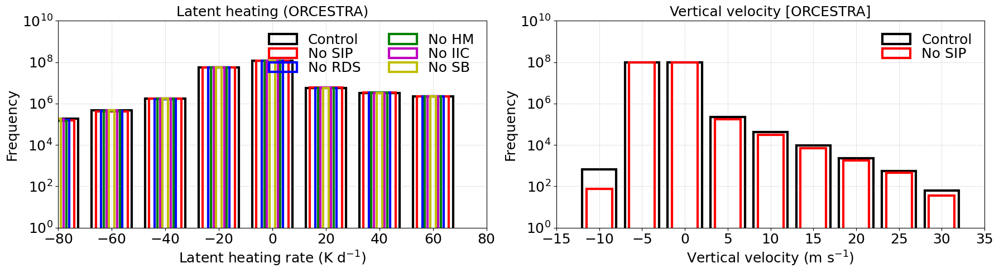

In [136]:
fnt=18;
ln=3;


plt.figure(figsize=(18, 5)) 
plt.style.use('default')

plt.subplot(1,2,1)
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_4sip, width=15, align='center', edgecolor='k', facecolor='none', color='blue', linewidth=ln, label='Control')
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_nosip, width=12., align='center', edgecolor='r', facecolor='none', color='orange', linewidth=ln, label='No SIP')
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_norf, width=8., align='center', edgecolor='b', facecolor='none', color='blue', linewidth=ln, label='No RDS')
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_nohm, width=6., align='center', edgecolor='g', facecolor='none', color='blue', linewidth=ln, label='No HM')
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_nobr, width=4., align='center', edgecolor='m', facecolor='none', color='blue', linewidth=ln, label='No IIC')
plt.bar(lhr_bin[:-1], hist_counts_satad_lhr_nosb, width=2., align='center', edgecolor='y', facecolor='none', color='blue', linewidth=ln, label='No SB')

plt.xlim(-80, 80)
plt.xticks([-80, -60, -40, -20, 0, 20, 40, 60, 80], fontsize=fnt)

plt.ylim(1.e0, 1.e10)
plt.yticks([1.e0, 1.e2, 1.e4, 1.e6, 1.e8, 1.e10], fontsize=fnt)
plt.yscale('log')

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
plt.ylabel('Frequency', fontsize=fnt)
plt.title('Latent heating (ORCESTRA)', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=2, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)



plt.subplot(1,2,2)

plt.bar(w_bin[:-1], hist_counts_wvel_4sip, width=4, align='center', edgecolor='k', facecolor='none', color='blue', linewidth=ln, label='Control')
plt.bar(w_bin[:-1], hist_counts_wvel_nosip, width=3., align='center', edgecolor='r', facecolor='none', color='orange', linewidth=ln, label='No SIP')
#plt.bar(w_bin[:-1], per_hist_count_wvel_nosip, width=2., align='center', edgecolor='b', facecolor='none', color='orange', linewidth=ln, label='% Change relative to control')

plt.xlim(-15, 35)
plt.xticks([-15, -10., -5, 0, 5, 10, 15, 20, 25, 30, 35], fontsize=fnt)

plt.yscale('log')
plt.ylim(1.e0, 1.e10)
plt.yticks([1.e0, 1.e2, 1.e4, 1.e6, 1.e8, 1.e10], fontsize=fnt)


plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
plt.ylabel('Frequency', fontsize=fnt)
plt.title('Vertical velocity [ORCESTRA]', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.tight_layout()
plt.show()


## Time series

In [117]:

# Control
mask = (ds_4sip.tempc >= -38.) & (ds_4sip.tempc <= 0.) & (ds_4sip.lhr_kperd != 0)

masked_lhr_4sip = ds_4sip.lhr_kperd.where(mask.compute(), drop=True)
tot_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.satad_lhr_kperd.where(mask.compute(), drop=True)
satad_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.dep_lhr_kperd.where(mask.compute(), drop=True)
dep_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.rime_lhr_kperd.where(mask.compute(), drop=True)
rime_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

masked_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.where(mask.compute(), drop=True)
rainfreez_lhr_mp_4sip = masked_lhr_4sip.mean(dim=('height', 'ncells'))

# No SIP
mask = (ds_nosip.tempc >= -38.) & (ds_nosip.tempc <= 0.) & (ds_nosip.lhr_kperd != 0)

masked_lhr_nosip = ds_nosip.lhr_kperd.where(mask.compute(), drop=True)
tot_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.satad_lhr_kperd.where(mask.compute(), drop=True)
satad_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.dep_lhr_kperd.where(mask.compute(), drop=True)
dep_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.rime_lhr_kperd.where(mask.compute(), drop=True)
rime_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))

masked_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.where(mask.compute(), drop=True)
rainfreez_lhr_mp_nosip = masked_lhr_nosip.mean(dim=('height', 'ncells'))


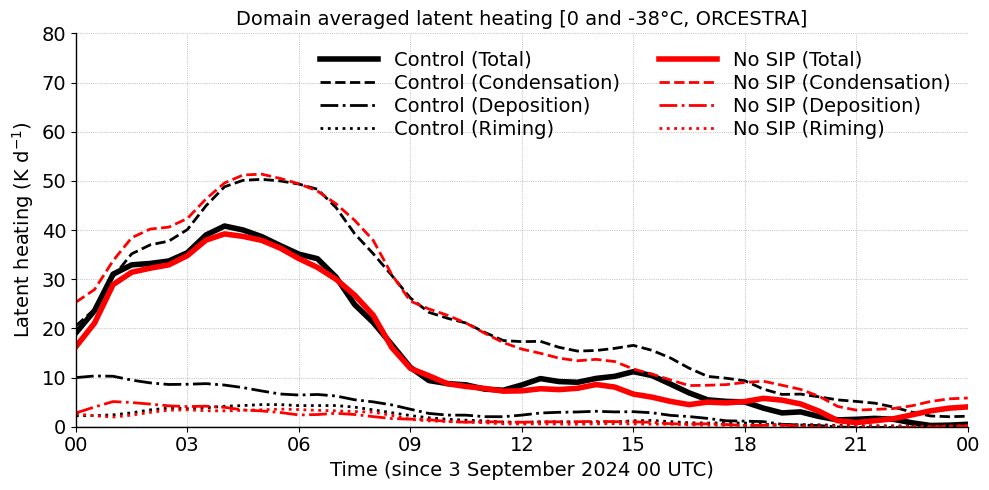

In [116]:

ln=2
fnt=14

plt.figure(figsize=(10, 5))

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

#plt.plot(ds_norf.time, ds_norf.lhr_kperd.mean(dim=('height','ncells')), 'm-')
#plt.plot(ds_nohm.time, ds_nohm.lhr_kperd.mean(dim=('height','ncells')), 'b-')
#plt.plot(ds_nobr.time, ds_nobr.lhr_kperd.mean(dim=('height','ncells')), 'g-')
#plt.plot(ds_nosb.time, ds_nosb.lhr_kperd.mean(dim=('height','ncells')), 'c-')

plt.plot(ds_4sip.time, tot_lhr_mp_4sip, 'k-', linewidth=ln+2, label='Control (Total)')
plt.plot(ds_4sip.time, satad_lhr_mp_4sip, 'k--', linewidth=ln, label='Control (Condensation)')
plt.plot(ds_4sip.time, dep_lhr_mp_4sip, 'k-.', linewidth=ln, label='Control (Deposition)')
plt.plot(ds_4sip.time, rime_lhr_mp_4sip, 'k:', linewidth=ln, label='Control (Riming)')

plt.plot(ds_nosip.time, tot_lhr_mp_nosip, 'r-', linewidth=ln+2, label='No SIP (Total)')
plt.plot(ds_nosip.time, satad_lhr_mp_nosip, 'r--', linewidth=ln, label='No SIP (Condensation)')
plt.plot(ds_nosip.time, dep_lhr_mp_nosip, 'r-.', linewidth=ln, label='No SIP (Deposition)')
plt.plot(ds_nosip.time, rime_lhr_mp_nosip, 'r:', linewidth=ln, label='No SIP (Riming)')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,80)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)#, fontweight='bold')
plt.title('Domain averaged latent heating [0 and -38°C, ORCESTRA]', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=3, labelspacing=0.2, fontsize=fnt, ncols=2, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

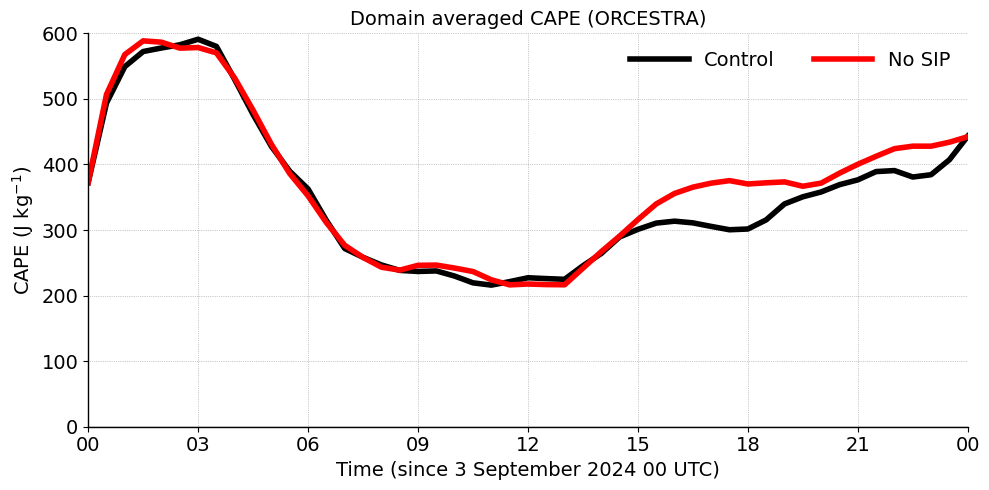

In [97]:

mean_cape_4sip = ds_4sip.cape_ml.where(ds_4sip.cape_ml > 0.).mean(dim=('ncells'))
mean_cape_nosip = ds_nosip.cape_ml.where(ds_nosip.cape_ml > 0.).mean(dim=('ncells'))


ln=2
fnt=14

plt.figure(figsize=(10, 5))

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, mean_cape_4sip, 'k-', linewidth=ln+2, label='Control')
plt.plot(ds_nosip.time, mean_cape_nosip, 'r-', linewidth=ln+2, label='No SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,600)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('CAPE (J kg$^{-1}$)', fontsize=fnt)#, fontweight='bold')
plt.title('Domain averaged CAPE (ORCESTRA)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=3, labelspacing=0.2, fontsize=fnt, ncols=2, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


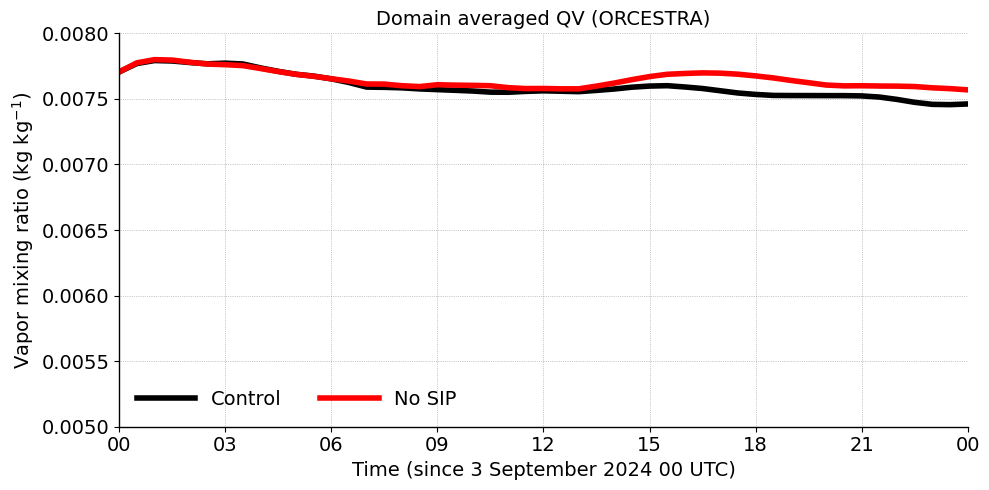

In [100]:

mean_qv_4sip = ds_4sip.qv.mean(dim=('height','ncells'))
mean_qv_nosip = ds_nosip.qv.mean(dim=('height','ncells'))


ln=2
fnt=14

plt.figure(figsize=(10, 5))

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_4sip.time, mean_qv_4sip, 'k-', linewidth=ln+2, label='Control')
plt.plot(ds_nosip.time, mean_qv_nosip, 'r-', linewidth=ln+2, label='No SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0.005,0.008)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Vapor mixing ratio (kg kg$^{-1}$)', fontsize=fnt)#, fontweight='bold')
plt.title('Domain averaged QV (ORCESTRA)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=3, labelspacing=0.2, fontsize=fnt, ncols=2, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [56]:

w_vel_4sip = ds_4sip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
w_vel_nosip = ds_nosip.w_vel.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

lhr_4sip = ds_4sip.tot_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nosip = ds_nosip.tot_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()


In [58]:

lhr_4sip = ds_4sip.tot_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
lhr_nosip = ds_nosip.tot_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

cond_lhr_4sip = ds_4sip.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
cond_lhr_nosip = ds_nosip.cond_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

satad_lhr_4sip = ds_4sip.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
satad_lhr_nosip = ds_nosip.satad_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

dep_lhr_4sip = ds_4sip.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
dep_lhr_nosip = ds_nosip.dep_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

rime_lhr_4sip = ds_4sip.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rime_lhr_nosip = ds_nosip.rime_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

melt_lhr_4sip = ds_4sip.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
melt_lhr_nosip = ds_nosip.melt_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

evap_lhr_4sip = ds_4sip.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()
evap_lhr_nosip = ds_nosip.evap_lhr_kperd.sel(time=slice('2024-09-03T00:00:00.000000000','2024-09-03T20:00:00.000000000')).values.flatten()

melt_evap_lhr_4sip = melt_lhr_4sip+evap_lhr_4sip
melt_evap_lhr_nosip = melt_lhr_nosip+evap_lhr_nosip


In [119]:

mask_nonzero_4sip = (lhr_4sip != 0.)
mask_nonzero_nosip = (lhr_nosip != 0.)

mask_pos_4sip = (lhr_4sip > 0.)
mask_pos_nosip = (lhr_nosip > 0.)

mask_neg_4sip = (lhr_4sip < 0.)
mask_neg_nosip = (lhr_nosip < 0.)

## Total 
mean_tot_lhr_4sip = np.nanmean(lhr_4sip[mask_nonzero_4sip])
mean_tot_lhr_nosip = np.nanmean(lhr_nosip[mask_nonzero_nosip])

pos_lhr = lhr_4sip[mask_pos_4sip]
neg_lhr = lhr_4sip[mask_neg_4sip]
mean_tot_lhr_pos_4sip=np.nanmean(pos_lhr)
mean_tot_lhr_neg_4sip=np.nanmean(neg_lhr)

pos_lhr = lhr_nosip[mask_pos_nosip]
neg_lhr = lhr_nosip[mask_neg_nosip]
mean_tot_lhr_pos_nosip=np.nanmean(pos_lhr)
mean_tot_lhr_neg_nosip=np.nanmean(neg_lhr)

## CCN activation
mean_cond_lhr_4sip = np.nanmean(cond_lhr_4sip[mask_nonzero_4sip])
mean_cond_lhr_nosip = np.nanmean(cond_lhr_nosip[mask_nonzero_nosip])

pos_lhr = cond_lhr_4sip[mask_pos_4sip]
neg_lhr = cond_lhr_4sip[mask_neg_4sip]
mean_cond_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_cond_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = cond_lhr_nosip[mask_pos_nosip]
neg_lhr = cond_lhr_nosip[mask_neg_nosip]
mean_cond_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_cond_neg_lhr_nosip = np.nanmean(neg_lhr)

## Deposition
mean_dep_lhr_4sip = np.nanmean(dep_lhr_4sip[mask_nonzero_4sip])
mean_dep_lhr_nosip = np.nanmean(dep_lhr_nosip[mask_nonzero_nosip])

pos_lhr = dep_lhr_4sip[mask_pos_4sip]
neg_lhr = dep_lhr_4sip[mask_neg_4sip]
mean_dep_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_dep_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = dep_lhr_nosip[mask_pos_nosip]
neg_lhr = dep_lhr_4sip[mask_neg_nosip]
mean_dep_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_dep_neg_lhr_nosip = np.nanmean(neg_lhr)

## Condensation
mean_satad_lhr_4sip = np.nanmean(satad_lhr_4sip[mask_nonzero_4sip])
mean_satad_lhr_nosip = np.nanmean(satad_lhr_nosip[mask_nonzero_nosip])

pos_lhr = satad_lhr_4sip[mask_pos_4sip]
neg_lhr = satad_lhr_4sip[mask_neg_4sip]
mean_satad_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_satad_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = satad_lhr_nosip[mask_pos_nosip]
neg_lhr = satad_lhr_nosip[mask_neg_nosip]
mean_satad_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_satad_neg_lhr_nosip = np.nanmean(neg_lhr)

## Riming
mean_rime_lhr_4sip = np.nanmean(rime_lhr_4sip[mask_nonzero_4sip])
mean_rime_lhr_nosip = np.nanmean(rime_lhr_nosip[mask_nonzero_nosip])

pos_lhr = rime_lhr_4sip[mask_pos_4sip]
neg_lhr = rime_lhr_4sip[mask_neg_4sip]
mean_rime_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_rime_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = rime_lhr_nosip[mask_pos_nosip]
neg_lhr = rime_lhr_nosip[mask_neg_nosip]
mean_rime_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_rime_neg_lhr_nosip = np.nanmean(neg_lhr)

## Rainfreez
mean_rainfreez_lhr_4sip = np.nanmean(rainfreez_lhr_4sip[mask_nonzero_4sip])
mean_rainfreez_lhr_nosip = np.nanmean(rainfreez_lhr_nosip[mask_nonzero_nosip])

pos_lhr = rainfreez_lhr_4sip[mask_pos_4sip]
neg_lhr = rainfreez_lhr_4sip[mask_neg_4sip]
mean_rainfreez_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_rainfreez_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = rainfreez_lhr_nosip[mask_pos_nosip]
neg_lhr = rainfreez_lhr_nosip[mask_neg_nosip]
mean_rainfreez_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_rainfreez_neg_lhr_nosip = np.nanmean(neg_lhr)

## Homhet
mean_homhet_lhr_4sip = np.nanmean(homhet_lhr_4sip[mask_nonzero_4sip])
mean_homhet_lhr_nosip = np.nanmean(homhet_lhr_nosip[mask_nonzero_nosip])

pos_lhr = homhet_lhr_4sip[mask_pos_4sip]
neg_lhr = homhet_lhr_4sip[mask_neg_4sip]
mean_homhet_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_homhet_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = homhet_lhr_nosip[mask_pos_nosip]
neg_lhr = homhet_lhr_nosip[mask_neg_nosip]
mean_homhet_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_homhet_neg_lhr_nosip = np.nanmean(neg_lhr)

## Melting+evaporation
mean_melt_evap_lhr_4sip = np.nanmean(melt_evap_lhr_4sip[mask_nonzero_4sip])
mean_melt_evap_lhr_nosip = np.nanmean(melt_evap_lhr_nosip[mask_nonzero_nosip])

pos_lhr = melt_evap_lhr_4sip[mask_pos_4sip]
neg_lhr = melt_evap_lhr_4sip[mask_neg_4sip]
mean_melt_evap_pos_lhr_4sip = np.nanmean(pos_lhr)
mean_melt_evap_neg_lhr_4sip = np.nanmean(neg_lhr)

pos_lhr = melt_evap_lhr_nosip[mask_pos_nosip]
neg_lhr = melt_evap_lhr_nosip[mask_neg_nosip]
mean_melt_evap_pos_lhr_nosip = np.nanmean(pos_lhr)
mean_melt_evap_neg_lhr_nosip = np.nanmean(neg_lhr)


groups = ['Total', 'Heating', 'Cooling']
values_cond_lhr_4sip = [mean_cond_lhr_4sip, mean_cond_lhr_pos_4sip, mean_cond_lhr_neg_4sip]
values_cond_lhr_nosip = [mean_cond_lhr_nosip, mean_cond_lhr_pos_nosip, mean_cond_lhr_neg_nosip]

values_dep_lhr_4sip = [mean_dep_lhr_4sip, mean_dep_lhr_pos_4sip, mean_dep_lhr_neg_4sip]
values_dep_lhr_nosip = [mean_dep_lhr_nosip, mean_dep_lhr_pos_nosip, mean_dep_lhr_neg_nosip]

values_satad_lhr_4sip = [mean_satad_lhr_4sip, mean_satad_lhr_pos_4sip, mean_satad_lhr_neg_4sip]
values_satad_lhr_nosip = [mean_satad_lhr_nosip, mean_satad_lhr_pos_nosip, mean_satad_lhr_neg_nosip]

values_rime_lhr_4sip = [mean_rime_lhr_4sip, mean_rime_lhr_pos_4sip, mean_rime_lhr_neg_4sip]
values_rime_lhr_nosip = [mean_rime_lhr_nosip, mean_rime_lhr_pos_nosip, mean_rime_lhr_neg_nosip]

values_rainfreez_lhr_4sip = [mean_rainfreez_lhr_4sip, mean_rainfreez_lhr_pos_4sip, mean_rainfreez_lhr_neg_4sip]
values_rainfreez_lhr_nosip = [mean_rainfreez_lhr_nosip, mean_rainfreez_lhr_pos_nosip, mean_rainfreez_lhr_neg_nosip]

values_homhet_lhr_4sip = [mean_homhet_lhr_4sip, mean_homhet_lhr_pos_4sip, mean_homhet_lhr_neg_4sip]
values_homhet_lhr_nosip = [mean_homhet_lhr_nosip, mean_homhet_lhr_pos_nosip, mean_homhet_lhr_neg_nosip]

values_melt_evap_lhr_4sip = [mean_melt_evap_lhr_4sip, mean_melt_evap_lhr_pos_4sip, mean_melt_evap_lhr_neg_4sip]
values_melt_evap_lhr_nosip = [mean_melt_evap_lhr_nosip, mean_melt_evap_lhr_pos_nosip, mean_melt_evap_lhr_neg_nosip]



In [115]:
#print(mean_tot_lhr_4sip, wt_mean_tot_lhr_4sip, wt_mean_tot_lhr_pos_4sip, wt_mean_tot_lhr_neg_4sip)
#print(mean_tot_lhr_4sip, wt_mean_tot_lhr_4sip, mean_tot_lhr_pos_4sip, mean_tot_lhr_neg_4sip)

print(np.nansum(lhr_4sip[lhr_4sip != 0])/len(lhr_4sip[lhr_4sip != 0]))
print(np.nansum(lhr_4sip[lhr_4sip > 0])/len(lhr_4sip[lhr_4sip > 0]))
print(np.nansum(lhr_4sip[lhr_4sip < 0])/len(lhr_4sip[lhr_4sip < 0]))
print(wt_mean_tot_lhr_4sip)

15.206778
80.25707
-21.28782
15.206834


In [125]:

mask_nonzero_4sip = (lhr_4sip != 0.)
mask_nonzero_nosip = (lhr_nosip != 0.)

# Calculate mean total latent heating 
mean_tot_lhr_4sip = np.nanmean(lhr_4sip[mask_nonzero_4sip])

# Calculate mean of each component for 4-SIP
mean_cond_lhr_4sip = np.nanmean(cond_lhr_4sip[mask_nonzero_4sip])
mean_dep_lhr_4sip = np.nanmean(dep_lhr_4sip[mask_nonzero_4sip])
mean_satad_lhr_4sip = np.nanmean(satad_lhr_4sip[mask_nonzero_4sip])
mean_rime_lhr_4sip = np.nanmean(rime_lhr_4sip[mask_nonzero_4sip])
mean_rainfreez_lhr_4sip = np.nanmean(rainfreez_lhr_4sip[mask_nonzero_4sip])
mean_homhet_lhr_4sip = np.nanmean(homhet_lhr_4sip[mask_nonzero_4sip])
mean_melt_evap_lhr_4sip = np.nanmean(melt_evap_lhr_4sip[mask_nonzero_4sip])

mean_tot_lhr_nosip = np.nanmean(lhr_nosip[mask_nonzero_nosip])

# Calculate mean of each component for No SIP 
mean_cond_lhr_nosip = np.nanmean(cond_lhr_nosip[mask_nonzero_nosip])
mean_dep_lhr_nosip = np.nanmean(dep_lhr_nosip[mask_nonzero_nosip])
mean_satad_lhr_nosip = np.nanmean(satad_lhr_nosip[mask_nonzero_nosip])
mean_rime_lhr_nosip = np.nanmean(rime_lhr_nosip[mask_nonzero_nosip])
mean_rainfreez_lhr_nosip = np.nanmean(rainfreez_lhr_nosip[mask_nonzero_nosip])
mean_homhet_lhr_nosip = np.nanmean(homhet_lhr_nosip[mask_nonzero_nosip])
mean_melt_evap_lhr_nosip = np.nanmean(melt_evap_lhr_nosip[mask_nonzero_nosip])


print(mean_tot_lhr_4sip, mean_tot_lhr_nosip)

15.206778 14.458926


In [127]:
print(mean_tot_lhr_4sip, mean_tot_lhr_pos_4sip, mean_tot_lhr_neg_4sip)

15.206778 80.25707 -21.28782


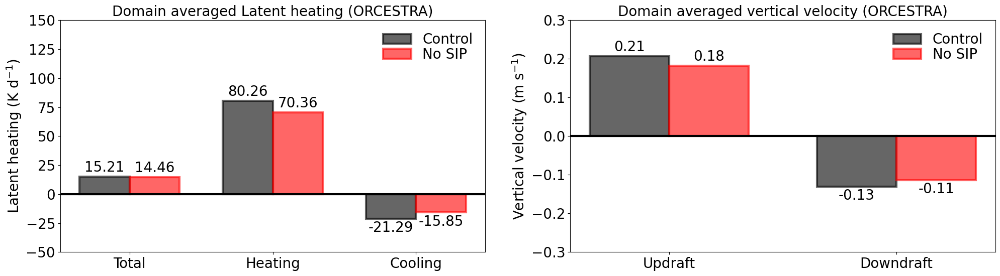

In [134]:



#mean_tot_lhr_4sip = (mean_satad_lhr_4sip+mean_dep_lhr_4sip+mean_rime_lhr_4sip+mean_melt_evap_lhr_4sip+
#                     mean_cond_lhr_4sip+mean_rainfreez_lhr_4sip+mean_homhet_lhr_4sip)
#mean_tot_lhr_nosip = (mean_satad_lhr_nosip+mean_dep_lhr_nosip+mean_rime_lhr_nosip+mean_melt_evap_lhr_nosip+
#                      mean_cond_lhr_nosip+mean_rainfreez_lhr_nosip+mean_homhet_lhr_nosip)

mean_tot_pos_lhr_4sip = (mean_satad_pos_lhr_4sip+mean_dep_pos_lhr_4sip+mean_rime_pos_lhr_4sip+mean_melt_evap_pos_lhr_4sip+
                        mean_cond_pos_lhr_4sip+mean_rainfreez_pos_lhr_4sip+mean_homhet_pos_lhr_4sip)
mean_tot_neg_lhr_4sip = (mean_satad_neg_lhr_4sip+mean_dep_neg_lhr_4sip+mean_rime_neg_lhr_4sip+mean_melt_evap_neg_lhr_4sip+
                        mean_cond_neg_lhr_4sip+mean_rainfreez_neg_lhr_4sip+mean_homhet_neg_lhr_4sip)

mean_tot_pos_lhr_nosip = (mean_satad_pos_lhr_nosip+mean_dep_pos_lhr_nosip+mean_rime_pos_lhr_nosip+mean_melt_evap_pos_lhr_nosip+
                        mean_cond_pos_lhr_nosip+mean_rainfreez_pos_lhr_nosip+mean_homhet_pos_lhr_nosip)
mean_tot_neg_lhr_nosip = (mean_satad_neg_lhr_nosip+mean_dep_neg_lhr_nosip+mean_rime_neg_lhr_nosip+mean_melt_evap_neg_lhr_nosip+
                        mean_cond_neg_lhr_nosip+mean_rainfreez_neg_lhr_nosip+mean_homhet_neg_lhr_nosip)

mean_wvel_4sip = np.nanmean(w_vel_4sip)
mean_wvel_nosip = np.nanmean(w_vel_nosip)

mean_wvel_up_4sip = np.nanmean(w_vel_4sip[w_vel_4sip > 0.])
mean_wvel_dn_4sip = np.nanmean(w_vel_4sip[w_vel_4sip < 0.])
mean_wvel_up_nosip = np.nanmean(w_vel_nosip[w_vel_nosip > 0.])
mean_wvel_dn_nosip = np.nanmean(w_vel_nosip[w_vel_nosip < 0.])

groups = ['Total', 'Heating', 'Cooling']
values_lhr_4sip = [mean_tot_lhr_4sip, mean_tot_pos_lhr_4sip, mean_tot_neg_lhr_4sip]
values_lhr_nosip = [mean_tot_lhr_nosip, mean_tot_pos_lhr_nosip, mean_tot_neg_lhr_nosip]

values_wvel_4sip = [mean_wvel_up_4sip, mean_wvel_dn_4sip]
values_wvel_nosip = [mean_wvel_up_nosip, mean_wvel_dn_nosip]


fnt=20;
ln=3;
alp=0.6

lhr_groups = ['Total', 'Heating', 'Cooling']
wvel_groups = ['Updraft', 'Downdraft']
x_lhr = np.arange(len(lhr_groups))  # the label locations
x_wvel = np.arange(len(wvel_groups))  # the label locations

width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# ⬅️ Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_lhr - width/2, values_lhr_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_lhr + width/2, values_lhr_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=3, fontsize=fnt, fmt='%.2f')
ax1.bar_label(rects2, padding=3, fontsize=fnt, fmt='%.2f')

# Customization
ax1.set_ylim(-50,150)
ax1.set_ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)
ax1.set_xticks(x_lhr)
ax1.set_xticklabels(lhr_groups)
ax1.set_title('Domain averaged Latent heating (ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)
plt.grid(axis='both', linewidth=ln-1.5, linestyle='-', color='k', alpha=0.7)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')
        
# ---------------------------------------------
# ➡️ Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]
ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_wvel - width/2, values_wvel_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_wvel + width/2, values_wvel_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=3, fontsize=fnt, fmt='%.2f')
ax2.bar_label(rects2, padding=3, fontsize=fnt, fmt='%.2f')

# Customization
ax2.set_ylim(-0.3,0.3)
ax2.set_ylabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax2.set_xticks(x_wvel)
ax2.set_xticklabels(wvel_groups)
ax2.set_title('Domain averaged vertical velocity (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)
plt.grid(False)#axis='both', linewidth=ln-1.5, linestyle='-', color='k', alpha=0.7)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')

#plt.tight_layout()
plt.show()

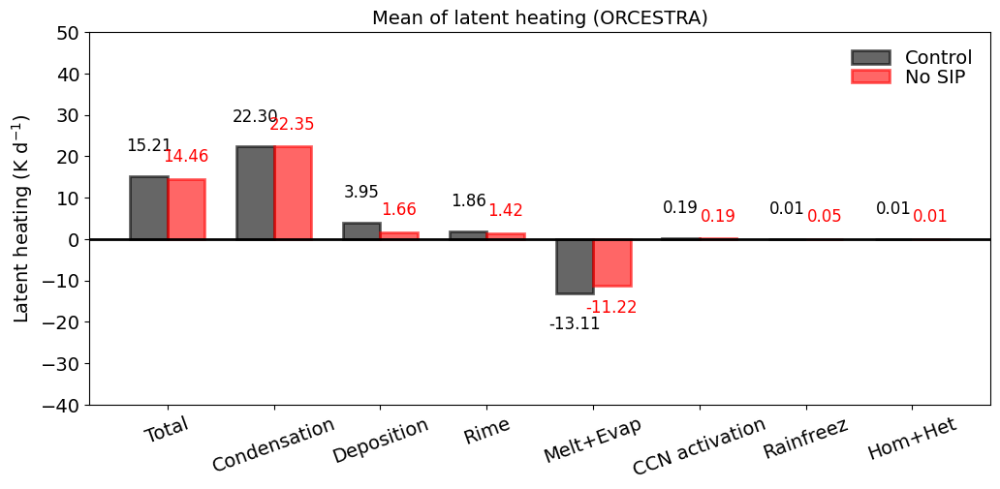

In [126]:

#mean_tot_lhr_4sip = (mean_satad_lhr_4sip+mean_dep_lhr_4sip+mean_rime_lhr_4sip+mean_melt_evap_lhr_4sip+
#                     mean_cond_lhr_4sip+mean_rainfreez_lhr_4sip+mean_homhet_lhr_4sip)
#mean_tot_lhr_nosip = (mean_satad_lhr_nosip+mean_dep_lhr_nosip+mean_rime_lhr_nosip+mean_melt_evap_lhr_nosip+
#                      mean_cond_lhr_nosip+mean_rainfreez_lhr_nosip+mean_homhet_lhr_nosip)

mean_all_lhr_comp_4sip = [mean_tot_lhr_4sip, mean_satad_lhr_4sip, mean_dep_lhr_4sip, mean_rime_lhr_4sip, 
                             mean_melt_evap_lhr_4sip, mean_cond_lhr_4sip, mean_rainfreez_lhr_4sip, mean_homhet_lhr_4sip]
mean_all_lhr_comp_nosip = [mean_tot_lhr_nosip, mean_satad_lhr_nosip, mean_dep_lhr_nosip, mean_rime_lhr_nosip, 
                              mean_melt_evap_lhr_nosip, mean_cond_lhr_nosip, mean_rainfreez_lhr_nosip, mean_homhet_lhr_nosip]



fnt=14;
ln=2;


lhr_groups = ['Total', 'Heating', 'Cooling']
lhr_comp_groups = ['Total', 'Condensation', 'Deposition', 'Rime', 'Melt+Evap', 'CCN activation', 'Rainfreez', 'Hom+Het']
x_lhr = np.arange(len(lhr_comp_groups))  # the label locations

width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(12, 5), sharey=False)
plt.style.use('default')

ax.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax.bar(x_lhr - width/2, mean_all_lhr_comp_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax.bar(x_lhr + width/2, mean_all_lhr_comp_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax.bar_label(rects1, padding=16, color='k', fontsize=fnt-2, fmt='%.2f')
ax.bar_label(rects2, padding=10, color='r', fontsize=fnt-2, fmt='%.2f')

# Customization
ax.set_ylim(-40,50)
ax.set_ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)
ax.set_xticks(x_lhr)
ax.set_xticklabels(lhr_comp_groups, rotation=20)
ax.set_title('Mean of latent heating (ORCESTRA)', fontsize=fnt)
ax.tick_params(axis='both', labelsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')

plt.show()

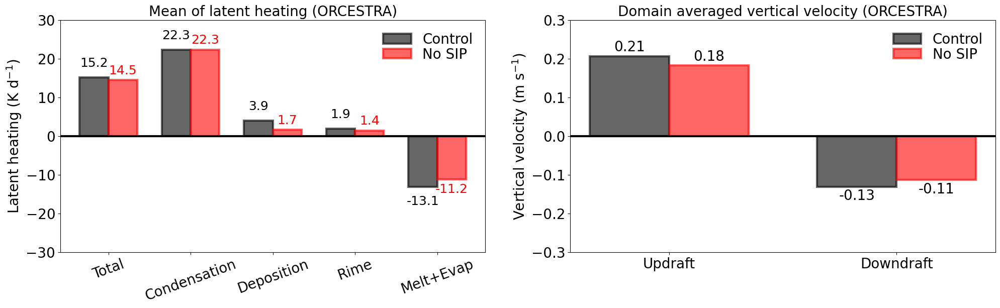

In [161]:

mean_all_lhr_comp_4sip = [mean_tot_lhr_4sip, mean_satad_lhr_4sip, mean_dep_lhr_4sip, mean_rime_lhr_4sip, 
                             mean_melt_evap_lhr_4sip]#, mean_cond_lhr_4sip, mean_rainfreez_lhr_4sip, mean_homhet_lhr_4sip]
mean_all_lhr_comp_nosip = [mean_tot_lhr_nosip, mean_satad_lhr_nosip, mean_dep_lhr_nosip, mean_rime_lhr_nosip, 
                              mean_melt_evap_lhr_nosip]#, mean_cond_lhr_nosip, mean_rainfreez_lhr_nosip, mean_homhet_lhr_nosip]

mean_wvel_4sip = np.nanmean(w_vel_4sip)
mean_wvel_nosip = np.nanmean(w_vel_nosip)

mean_wvel_up_4sip = np.nanmean(w_vel_4sip[w_vel_4sip > 0.])
mean_wvel_dn_4sip = np.nanmean(w_vel_4sip[w_vel_4sip < 0.])
mean_wvel_up_nosip = np.nanmean(w_vel_nosip[w_vel_nosip > 0.])
mean_wvel_dn_nosip = np.nanmean(w_vel_nosip[w_vel_nosip < 0.])

groups = ['Updraft', 'Downdraft']

values_wvel_4sip = [mean_wvel_up_4sip, mean_wvel_dn_4sip]
values_wvel_nosip = [mean_wvel_up_nosip, mean_wvel_dn_nosip]

fnt=20;
ln=3;
alp=0.6


lhr_comp_groups = ['Total', 'Condensation', 'Deposition', 'Rime', 'Melt+Evap']#, 'CCN activation', 'Rainfreez', 'Hom+Het']
wvel_groups = ['Updraft', 'Downdraft']
x_lhr = np.arange(len(lhr_comp_groups))  # the label locations
x_wvel = np.arange(len(wvel_groups))  # the label locations

width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

# ---------------------------------------------
# Subplot 1: Latent heating rate (LHR)
# ---------------------------------------------
ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_lhr - width/2, mean_all_lhr_comp_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_lhr + width/2, mean_all_lhr_comp_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=12, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(-30,30)
ax1.set_ylabel('Latent heating (K d$^{-1}$)', fontsize=fnt)
ax1.set_xticks(x_lhr)
ax1.set_xticklabels(lhr_comp_groups, rotation=20)
ax1.set_title('Mean of latent heating (ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')

        
# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]
ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_wvel - width/2, values_wvel_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_wvel + width/2, values_wvel_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=3, fontsize=fnt, fmt='%.2f')
ax2.bar_label(rects2, padding=3, fontsize=fnt, fmt='%.2f')

# Customization
ax2.set_ylim(-0.3,0.3)
ax2.set_ylabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax2.set_xticks(x_wvel)
ax2.set_xticklabels(wvel_groups)
ax2.set_title('Domain averaged vertical velocity (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)
plt.grid(False)#axis='both', linewidth=ln-1.5, linestyle='-', color='k', alpha=0.7)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')

#plt.tight_layout()
plt.show()


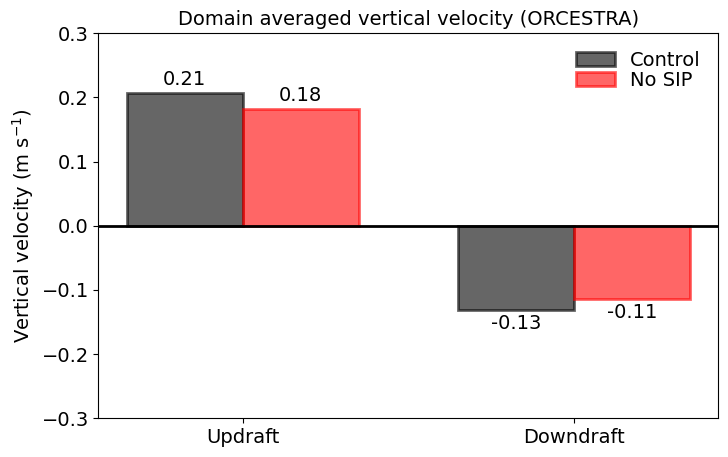

In [138]:

mean_wvel_4sip = np.nanmean(w_vel_4sip)
mean_wvel_nosip = np.nanmean(w_vel_nosip)

mean_wvel_up_4sip = np.nanmean(w_vel_4sip[w_vel_4sip > 0.])
mean_wvel_dn_4sip = np.nanmean(w_vel_4sip[w_vel_4sip < 0.])
mean_wvel_up_nosip = np.nanmean(w_vel_nosip[w_vel_nosip > 0.])
mean_wvel_dn_nosip = np.nanmean(w_vel_nosip[w_vel_nosip < 0.])

groups = ['Total', 'Heating', 'Cooling']
values_lhr_4sip = [mean_tot_lhr_4sip, mean_tot_pos_lhr_4sip, mean_tot_neg_lhr_4sip]
values_lhr_nosip = [mean_tot_lhr_nosip, mean_tot_pos_lhr_nosip, mean_tot_neg_lhr_nosip]

values_wvel_4sip = [mean_wvel_up_4sip, mean_wvel_dn_4sip]
values_wvel_nosip = [mean_wvel_up_nosip, mean_wvel_dn_nosip]


fnt=14;
ln=2;
alp=0.6

lhr_groups = ['Total', 'Heating', 'Cooling']
wvel_groups = ['Updraft', 'Downdraft']
x_lhr = np.arange(len(lhr_groups))  # the label locations
x_wvel = np.arange(len(wvel_groups))  # the label locations

width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(8, 5), sharey=False)
plt.style.use('default')

ax.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax.bar(x_wvel - width/2, values_wvel_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax.bar(x_wvel + width/2, values_wvel_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax.bar_label(rects1, padding=3, fontsize=fnt, fmt='%.2f')
ax.bar_label(rects2, padding=3, fontsize=fnt, fmt='%.2f')

# Customization
ax.set_ylim(-0.3,0.3)
ax.set_ylabel('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_xticks(x_wvel)
ax.set_xticklabels(wvel_groups)
ax.set_title('Domain averaged vertical velocity (ORCESTRA)', fontsize=fnt)
ax.tick_params(axis='both', labelsize=fnt)
plt.grid(False)#axis='both', linewidth=ln-1.5, linestyle='-', color='k', alpha=0.7)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='upper right')

#plt.tight_layout()
plt.show()

## Freezing and homogeneous level

In [14]:
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.tqi > 1.e-6)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.tqi > 1.e-6)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

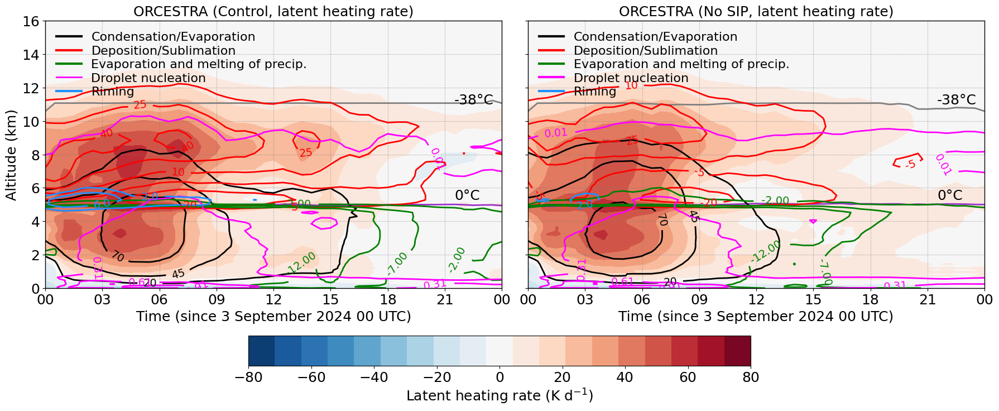

In [11]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=3, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=1, labelspacing=0.2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt+2)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


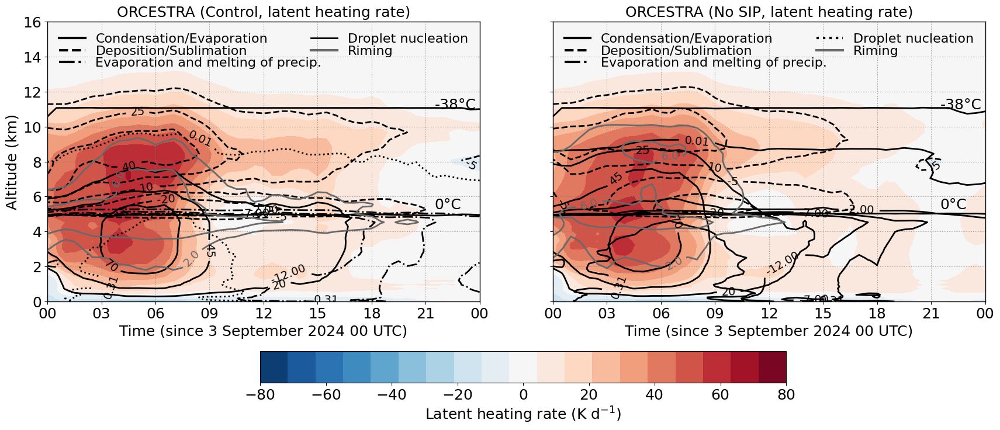

In [44]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=2, labelspacing=0.02, columnspacing=-0.8, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=3, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, 
           ncols=2, labelspacing=0.02, columnspacing=-0.8, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt+2)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


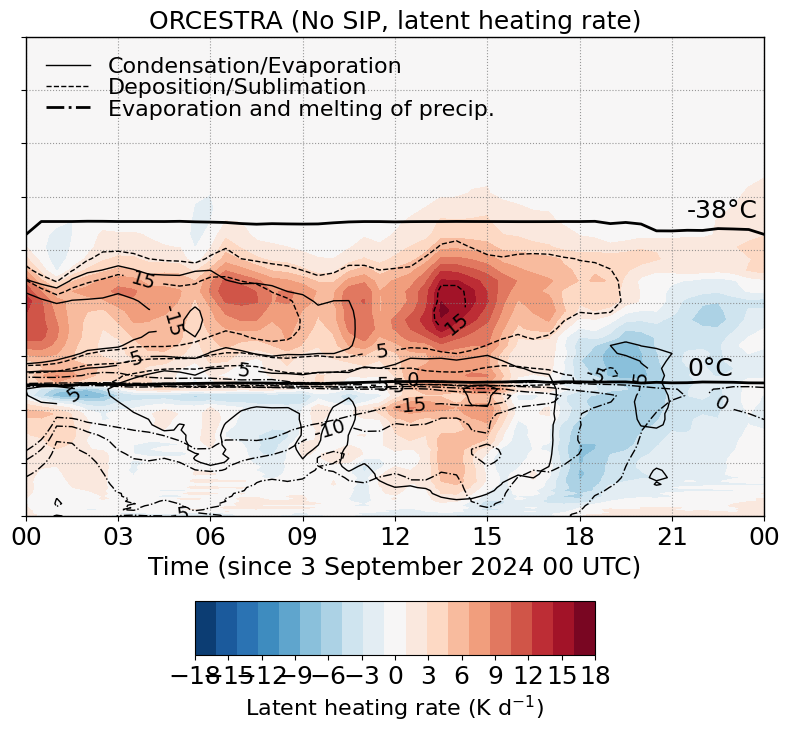

In [15]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec
import colorcet as cc


del_mean_tot_lhr_time_ht = ds_4sip.lhr_kperd.mean(dim=('ncells'))-ds_nosip.lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-10, 10, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-18, 18, 20)

plt.figure(figsize=(8, 6))
plt.style.use('default')

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, latent heating rate)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln2, label='Condensation/Evaporation')


contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln2, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 4) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln2, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln2)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln2, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
           ncols=1, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-18, -15, -12, -9, -6, -3, 0, 3, 6, 9, 12, 15, 18])
cbar3.set_label('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


In [18]:
print(del_mean_tot_lhr_time_ht.min().values, del_mean_tot_lhr_time_ht.max().values)
print(del_mean_satad_lhr_time_ht.min().values, del_mean_satad_lhr_time_ht.max().values)
print(del_mean_dep_lhr_time_ht.min().values, del_mean_dep_lhr_time_ht.max().values)
print(del_mean_evap_melt_lhr_time_ht.min().values, del_mean_evap_melt_lhr_time_ht.max().values)
print(del_mean_rime_lhr_time_ht.min().values, del_mean_rime_lhr_time_ht.max().values)

-7.5276356 11.017957
-35.490623 13.610348
-14.292085 45.944283
-59.602036 2.0589402
-4.3371296 12.353887


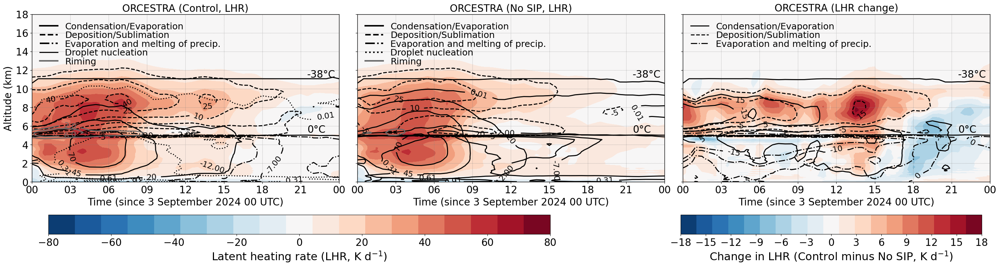

In [11]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.lhr_kperd.mean(dim=('ncells'))-ds_nosip.lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=3.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-18, 18, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=3, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')


contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 4) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln1, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-18, -15, -12, -9, -6, -3, 0, 3, 6, 9, 12, 15, 18])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


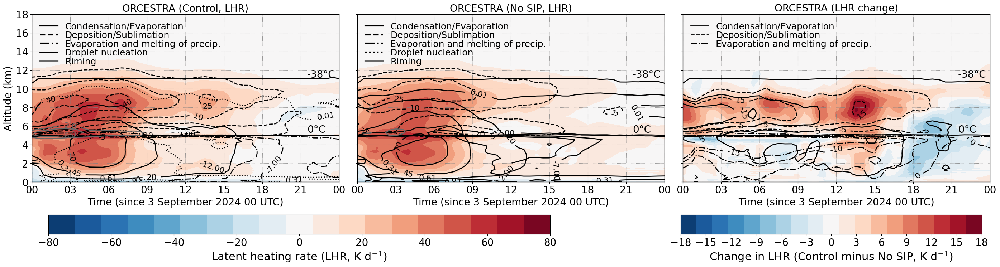

In [16]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec


del_mean_tot_lhr_time_ht = ds_4sip.tot_lhr_kperd.mean(dim=('ncells'))-ds_nosip.tot_lhr_kperd.mean(dim=('ncells'))
del_mean_satad_lhr_time_ht = ds_4sip.satad_lhr_kperd.mean(dim=('ncells'))-ds_nosip.satad_lhr_kperd.mean(dim=('ncells'))
del_mean_cond_lhr_time_ht = ds_4sip.cond_lhr_kperd.mean(dim=('ncells'))-ds_nosip.cond_lhr_kperd.mean(dim=('ncells'))
del_mean_rime_lhr_time_ht = ds_4sip.rime_lhr_kperd.mean(dim=('ncells'))-ds_nosip.rime_lhr_kperd.mean(dim=('ncells'))
del_mean_dep_lhr_time_ht = ds_4sip.dep_lhr_kperd.mean(dim=('ncells'))-ds_nosip.dep_lhr_kperd.mean(dim=('ncells'))
del_mean_evap_melt_lhr_time_ht = ((ds_4sip.evap_lhr_kperd.mean(dim=('ncells'))+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')))-
                              ds_nosip.evap_lhr_kperd.mean(dim=('ncells'))+ds_nosip.melt_lhr_kperd.mean(dim=('ncells')))

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=3.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)
lev3=np.linspace(-18, 18, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='k', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')


plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.tot_lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, LHR)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=3, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=3, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=3, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=3, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=3, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, columnspacing=-2.5, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating rate (LHR, K d$^{-1}$)', fontsize=fnt+4)
cbar1.ax.tick_params(labelsize=fnt+2)


plt.subplot(1,3,3)

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, del_mean_tot_lhr_time_ht.T, levels=lev3, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='k', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.2, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 18)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LHR change)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-6.5, 6.5, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_satad_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')


contour_levels = np.linspace(-15.5, 15.5, 4) #np.arange(-8.5, 8.5, 3.)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_dep_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='k', linestyle='--', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.linspace(-15.5, -0.5, 4) #np.arange(-30, 0., 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_evap_melt_lhr_time_ht.T, 
                       levels=contour_levels, colors='k', linestyles='-.', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy3 = mlines.Line2D([], [], color='k', linestyle='-.', linewidth=ln1, label='Evaporation and melting of precip.')

#contour_levels = np.arange(-0.5, 0.5, 0.4)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_cond_lhr_time_ht.T, levels=contour_levels, colors='k', linestyles=':', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='k', linestyle=':', linewidth=ln1, label='CCN nucleation')

#contour_levels = np.arange(-0.8, 0.8, 0.7)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_mean_rime_lhr_time_ht.T, levels=contour_levels, colors='dimgray', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy5 = mlines.Line2D([], [], color='dimgray', linestyle='-', linewidth=ln1, label='Riming')


#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, handlelength=2, labelspacing=0.05, 
#           ncols=1, loc='upper left')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3], frameon=False, fontsize=fnt, handlelength=2, 
           ncols=1, labelspacing=0.02, loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
#cbar_ax2 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar3 = fig.colorbar(cnt3, cax=cbar_ax2, orientation='horizontal', ticks=[-18, -15, -12, -9, -6, -3, 0, 3, 6, 9, 12, 15, 18])
cbar3.set_label('Change in LHR (Control minus No SIP, K d$^{-1}$)', fontsize=fnt+4)
cbar3.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


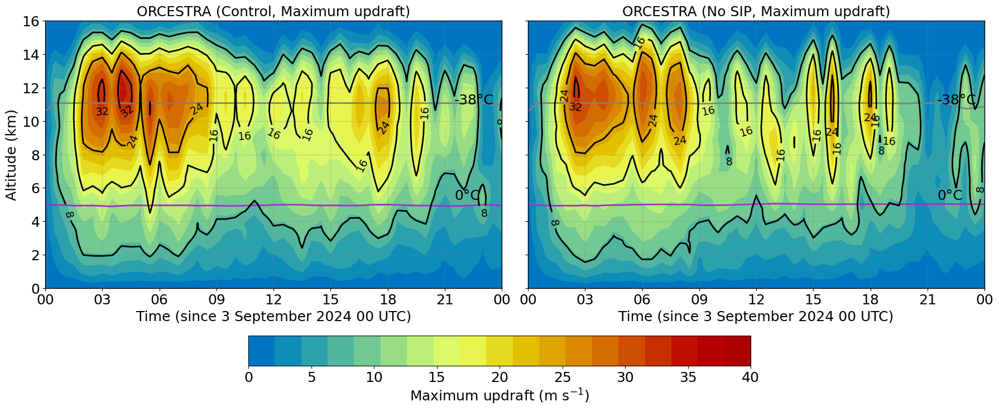

In [9]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

fnt=16;
fnt1=16;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(0, 40, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt+2)
plt.title('ORCESTRA (Control, Maximum updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0, 40., 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP, Maximum updraft)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0, 40., 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.max(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[0, 5, 10, 15, 20, 25, 30, 35, 40])
cbar1.set_label('Maximum updraft (m s$^{-1}$)', fontsize=fnt+2)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


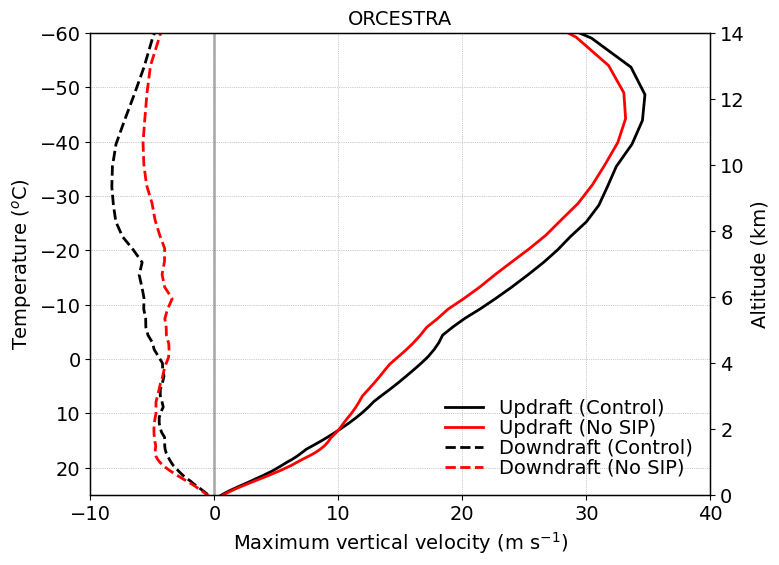

In [12]:

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')


plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.w_vel.max(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Updraft (Control)')
plt1.plot(ds_nosip.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Updraft (No SIP)')


plt1.plot(ds_4sip.w_vel.min(dim=('time','ncells')), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Downdraft (Control)')
plt1.plot(ds_nosip.w_vel.min(dim=('time','ncells')), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Downdraft (No SIP)')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.max(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-10, 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([0, 5, 10, 15, 20, 25, 30])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

In [18]:

mean_cond_lhr_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_4sip = ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values

mean_cond_lhr_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_nosip = ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values


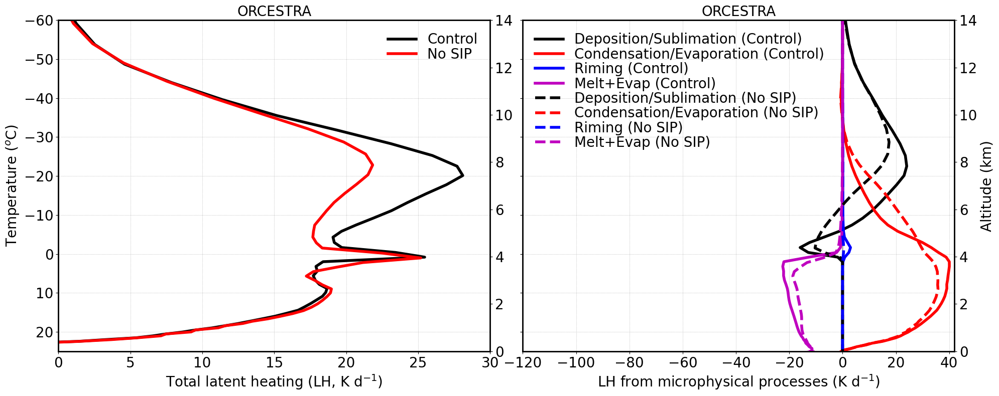

In [19]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 5, 10, 15, 20, 25, 30])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dep_lhr_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Deposition/Sublimation (Control)')
plt1.plot(mean_satad_lhr_4sip, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Condensation/Evaporation (Control)')
plt1.plot(mean_rime_lhr_4sip, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Riming (Control)')
plt1.plot(mean_melt_evap_lhr_4sip, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Melt+Evap (Control)')
#plt1.plot(mean_cond_lhr_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_dep_lhr_nosip, mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Deposition/Sublimation (No SIP)')
plt1.plot(mean_satad_lhr_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Condensation/Evaporation (No SIP)')
plt1.plot(mean_rime_lhr_nosip, mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Riming (No SIP)')
plt1.plot(mean_melt_evap_lhr_nosip, mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Melt+Evap (No SIP)')
#plt1.plot(mean_cond_lhr_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_dep_lhr_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-120., 42)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='best')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


## Microphysical properties

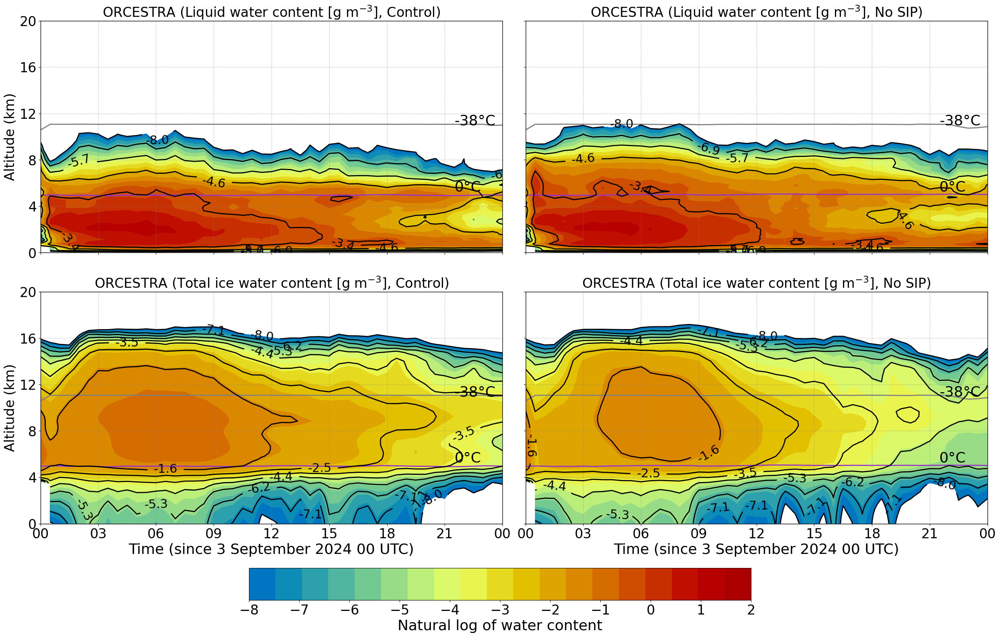

In [29]:

import matplotlib.lines as mlines

fnt=24;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
lev2 = np.linspace(-8, 2, 20)
plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Liquid water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Liquid water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total ice water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total IWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total ice water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar.set_label('Natural log of water content', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


In [56]:
print(np.linspace(-100, 100, 12))

[-100.          -81.81818182  -63.63636364  -45.45454545  -27.27272727
   -9.09090909    9.09090909   27.27272727   45.45454545   63.63636364
   81.81818182  100.        ]


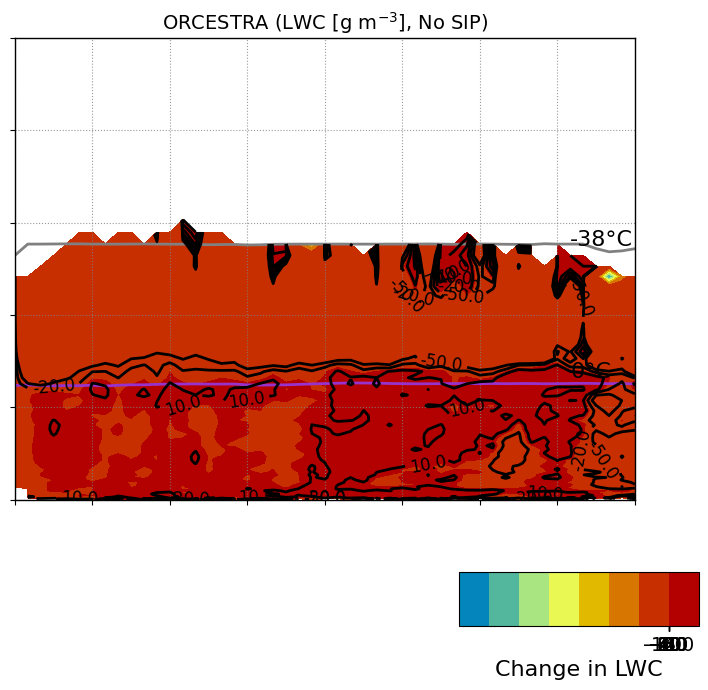

In [60]:
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True).fillna(0)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True).fillna(0)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip
mean_del_iwc_4sip_nosip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'))-ds_nosip.tiwc_gperm3.mean(dim=('ncells'))

percent_change_lwc = 100.*mean_del_lwc_4sip_nosip/mean_lwc_4sip
fnt=14;
fnt1=12;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)
lev1 = np.linspace(-8, -2, 20)
lev2 = np.linspace(-50, 100, 20)
plt.figure(figsize=(8, 6))
plt.style.use('default')
cnt6=plt.contourf(ds_nosip.time, mean_ht_nosip, percent_change_lwc.T, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-50, 100, 6)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, (percent_change_lwc.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax4 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
##cbar = fig.colorbar(cnt6, cax=cbar_ax4, ticks=[-8, -6, -4, -2, 0], orientation='horizontal') #-0.03548255 0.013849111
#cbar = fig.colorbar(cnt6, cax=cbar_ax4, ticks=[-0.04, -0.02, 0, 0.02], orientation='horizontal')
cbar = fig.colorbar(cnt6, cax=cbar_ax4, ticks=[-100, -80, -60, -40, -20, 0, 20, 40, 60, 80, 100], orientation='horizontal')
cbar.set_label('Change in LWC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.show()

In [39]:
print(mean_tiwc_4sip.min().values, mean_tiwc_4sip.max().values)
#print(mean_lwc_4sip.min().values, mean_lwc_4sip.max().values)

2.8239287e-13 0.43308434


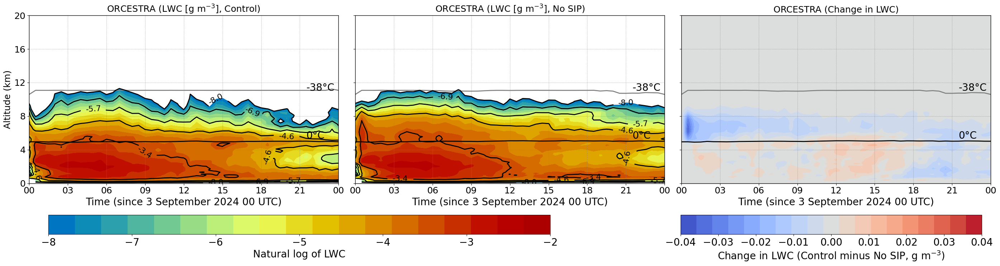

In [25]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

#mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
#mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
#mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip != 0., np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip != 0., np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip != 0., np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, -2, 20)
#lev1 = np.linspace(0, 0.04, 20)
lev2 = np.linspace(-0.04, 0.04, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_lwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (LWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 0, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_lwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('LWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_lwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in LWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.04, -0.03, -0.02, -0.01, 0, 0.01, 0.02, 0.03, 0.04], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in LWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [40]:
print(mean_del_tiwc_4sip_nosip.min().values, mean_del_tiwc_4sip_nosip.max().values)

-0.013853848 0.19971372


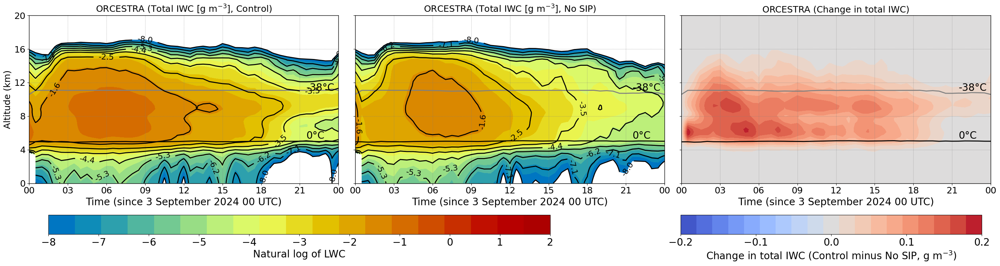

In [26]:

import matplotlib.lines as mlines
mean_lwc_4sip = ds_4sip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_lwc_nosip = ds_nosip.lwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_lwc_4sip_nosip = mean_lwc_4sip-mean_lwc_nosip

mean_lwc_4sip = mean_lwc_4sip.where(mean_lwc_4sip != 0., np.nan)
mean_lwc_nosip = mean_lwc_nosip.where(mean_lwc_nosip != 0., np.nan)
mean_del_lwc_4sip_nosip = mean_del_lwc_4sip_nosip.where(mean_del_lwc_4sip_nosip != 0., np.nan)

mean_tiwc_4sip = ds_4sip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_tiwc_nosip = ds_nosip.tiwc_gperm3.mean(dim=('ncells'), skipna=True)
mean_del_tiwc_4sip_nosip = mean_tiwc_4sip-mean_tiwc_nosip

#mean_tiwc_4sip = mean_tiwc_4sip.where(mean_tiwc_4sip > 0.00001, np.nan)
#mean_tiwc_nosip = mean_tiwc_nosip.where(mean_tiwc_nosip > 0.00001, np.nan)
#mean_del_tiwc_4sip_nosip = mean_del_tiwc_4sip_nosip.where(mean_del_tiwc_4sip_nosip > 0.0001, np.nan)

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-8, 2, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_tiwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total IWC [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tiwc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_tiwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total IWC [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-8, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tiwc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[0, 0.02, 0.04, 0.06, 0.08, 0.1], orientation='horizontal')
cbar.set_label('Natural log of LWC', fontsize=fnt+2)
#cbar.set_label('Total IWC (g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_lwc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tiwc_4sip_nosip.T, levels=lev2, cmap='coolwarm')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in total IWC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-0.2, -0.1, 0, 0.1, 0.20], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Change in total IWC (Control minus No SIP, g m$^{-3}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [27]:
print(np.log(mean_del_lwc_4sip_nosip.min().values), np.log(mean_del_lwc_4sip_nosip.max().values))
print((mean_del_lwc_4sip_nosip.min().values), (mean_del_lwc_4sip_nosip.max().values))

nan -4.2795343
-0.03548255 0.013849111


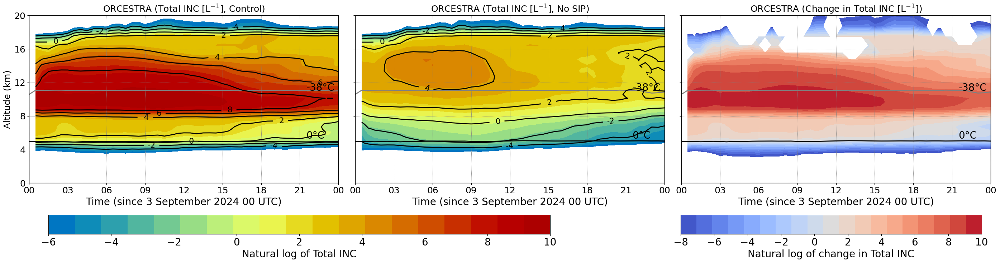

In [54]:

import matplotlib.lines as mlines
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-8, 10, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of change in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


In [46]:
print(np.log(mean_del_tinc_4sip_nosip.min().values), np.log(mean_del_tinc_4sip_nosip.max().values))

nan 9.752691


In [27]:

## Transformed-log-scale to handle negative values
def signed_log(x, scale=0.08):
    return np.sign(x) * np.log1p(np.abs(x) / scale)
    

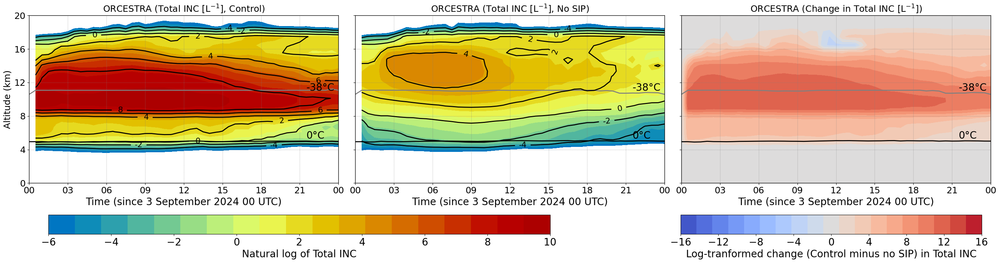

In [30]:

import matplotlib.lines as mlines
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
#mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-16, 16, 20)

plt.figure(figsize=(28, 6))
plt.style.use('default')

plt.subplot(1,3,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, mean_lwc_4sip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='k', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(mean_tinc_4sip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_lwc_nosip.T, levels=lev1, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total INC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_tinc_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax1 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax1 = fig.add_axes([0.05, -0.1, 0.5, 0.09])
#cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-8, -7, -6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar = fig.colorbar(cnt2, cax=cbar_ax1, ticks=[-6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of total INC', fontsize=fnt+2)
cbar.set_label('Natural log of Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)

plt.subplot(1,3,3)
cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, signed_log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='coolwarm')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in Total INC [L$^{-1}$])', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-6, 10, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12, 14], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-16, -12, -8, -4, 0, 4, 8, 12, 16], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Log-tranformed change (Control minus no SIP) in Total INC', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()


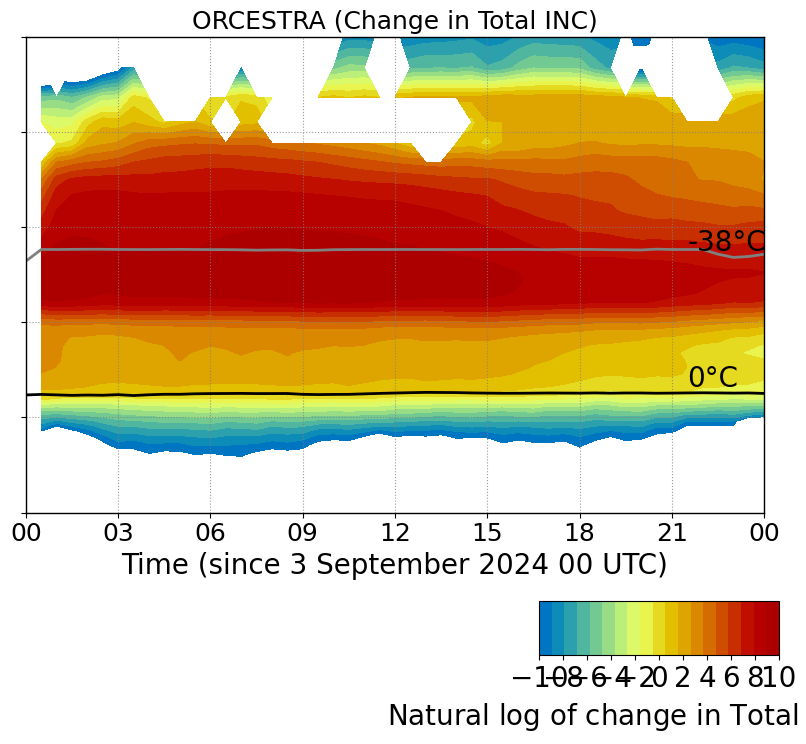

In [47]:
mean_tinc_4sip = ds_4sip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_tinc_nosip = ds_nosip.inc_perl.mean(dim=('ncells'), skipna=True)
mean_del_tinc_4sip_nosip = mean_tinc_4sip-mean_tinc_nosip

mean_tinc_4sip = mean_tinc_4sip.where(mean_tinc_4sip != 0., np.nan)
mean_tinc_nosip = mean_tinc_nosip.where(mean_tinc_nosip != 0., np.nan)
mean_del_tinc_4sip_nosip = mean_del_tinc_4sip_nosip.where(mean_del_tinc_4sip_nosip != 0., np.nan)


fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(0, 0.1, 20)
lev2 = np.linspace(-10, 10, 20)

plt.figure(figsize=(8, 6))
plt.style.use('default')

cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(mean_del_tinc_4sip_nosip.T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#cnt3=plt.contourf(ds_nosip.time, mean_ht_nosip, mean_del_tinc_4sip_nosip.T, levels=lev2, cmap='HomeyerRainbow')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='k', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='gray', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Change in Total INC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-8, 0, 8)
#contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
#cbar_ax2 = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar_ax2 = fig.add_axes([0.68, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-8, -6, -4, -2, 0], orientation='horizontal')
cbar = fig.colorbar(cnt3, cax=cbar_ax2, ticks=[-10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar.set_label('Natural log of change in LWC', fontsize=fnt+2)
cbar.set_label('Natural log of change in Total INC (L$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt+2)


plt.tight_layout()
plt.show()

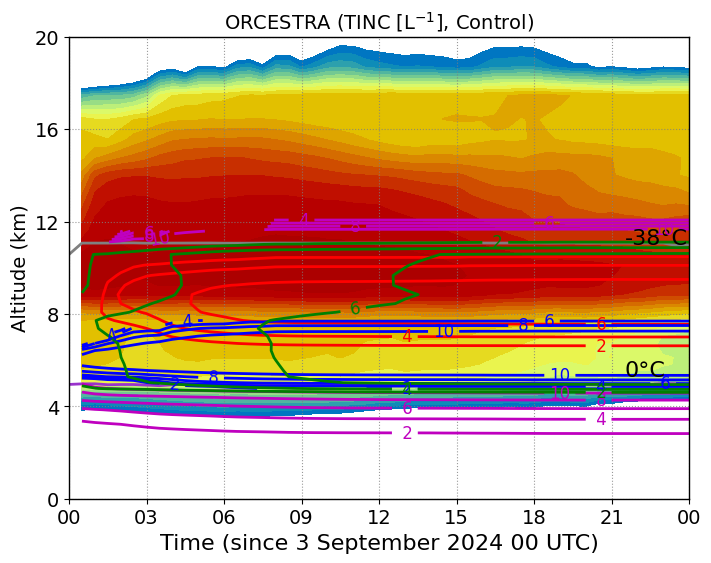

In [23]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, 10, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(8, 6))
plt.style.use('default')

#plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

#plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (TINC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


#contour_levels = np.linspace(-4, 10, 8)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(2, 10, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.dqni_ds.mean(dim=('ncells')).T), levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


contour_levels = np.linspace(2, 10, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.dqni_rs.mean(dim=('ncells')).T), levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


contour_levels = np.linspace(2, 10, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.dqni_br.mean(dim=('ncells')).T), levels=contour_levels, colors='m', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


contour_levels = np.linspace(2, 10, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log((ds_4sip.dqni_snow_sbf.mean(dim=('ncells'))+ds_4sip.dqni_graup_sbf.mean(dim=('ncells'))).T), levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

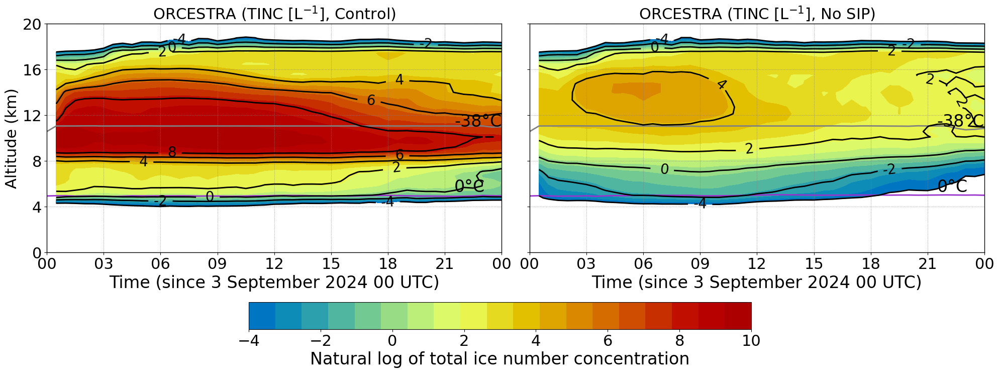

In [24]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-4, 10, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (TINC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (TINC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-4, -2, 0, 2, 4, 6, 8, 10], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Natural log of total ice number concentration', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


In [ ]:
print(np.linspace(2, 10, 5))

In [20]:
ds_4sip

<xarray.Dataset> Size: 102GB
Dimensions:            (time: 49, ncells: 73960, vertices: 3, height: 65,
                        bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time               (time) datetime64[ns] 392B 2024-09-03 ... 2024-09-04
    clon               (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
    clat               (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
  * height             (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2           (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev               (plev) float64 8B 800.0
  * plev_2             (plev_2) float64 8B 400.0
  * plev_3             (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/129)
    clon_bnds          (time, ncells, vertices) float64 87MB dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds          (time, ncells, vertices) float64 87MB dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds        (time, height, bnds) float64 51kB dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds          (time, plev, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds        (time, plev_2, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds        (time, plev_3, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                 ...
    ciwc_gperm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    twc_gperm3         (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl           (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tot_q              (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: f3f9a5624ca4223a7fe2f0c...
    history:              /home/b/b382718/continental_cases/4sip/icon-oct2024...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l20442 (Linux 4.18.0-513....

In [27]:

ds_4sip.d_qc_melt

<xarray.DataArray 'd_qc_melt' (time: 49, height: 65, ncells: 73960)> Size: 942MB
dask.array<concatenate, shape=(49, 65, 73960), dtype=float32, chunksize=(1, 65, 73960), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 392B 2024-09-03 ... 2024-09-04
    clon     (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
    clat     (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
  * height   (height) float64 520B 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
Dimensions without coordinates: ncells
Attributes:
    standard_name:                d_qc_melt
    long_name:                    cloud production by melting of ice/snow
    units:                        kg/kg
    code:                         255
    CDI_grid_type:                unstructured
    number_of_grid_in_reference:  1

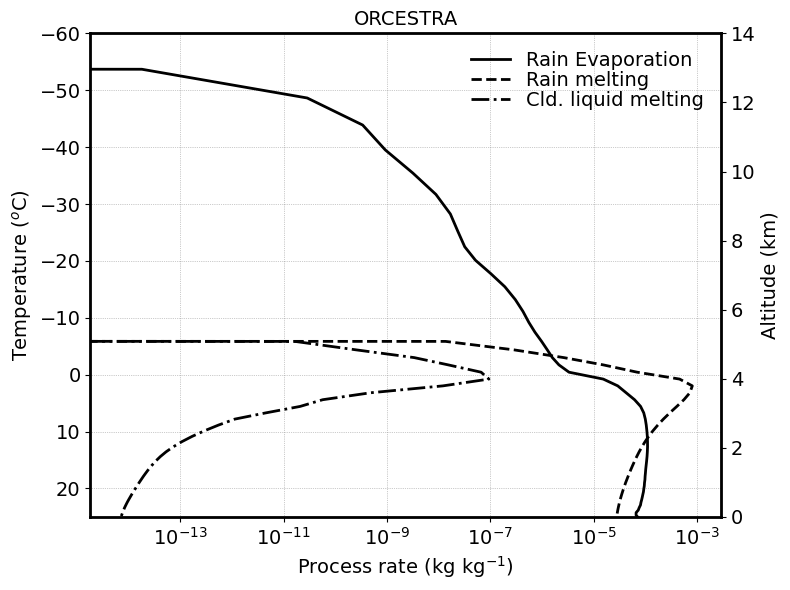

In [32]:

mean_qr_evap_4sip = ds_4sip.d_qr_evap.diff('time')
mean_qr_melt_4sip = ds_4sip.d_qr_melt.diff('time')
mean_qc_melt_4sip = ds_4sip.d_qc_melt.diff('time')
mean_qr_evap_4sip = mean_qr_evap_4sip.mean(dim=('time', 'ncells'))
mean_qr_melt_4sip = mean_qr_melt_4sip.mean(dim=('time', 'ncells'))
mean_qc_melt_4sip = mean_qc_melt_4sip.mean(dim=('time', 'ncells'))

fontsize=14;
lnwdth=2;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qr_evap_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Rain Evaporation')
plt1.plot(mean_qr_melt_4sip, mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Rain melting')
plt1.plot(mean_qc_melt_4sip, mean_tempc_4sip, 'k-.', linewidth=lnwdth, label='Cld. liquid melting')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_qc_melt_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xscale('log')
#plt1.set_xlim(-0.01, 0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.3, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2, 3])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.tight_layout()
plt.show()


## Freezing level and cloud top height

In [34]:

## Freezing and cloud top height
mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)  & (ds_4sip.twc_gperm3 > 1.e-3)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.5) & (ds_4sip.tempc < -37.5)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)  & (ds_nosip.twc_gperm3 > 1.e-3)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.5) & (ds_nosip.tempc < -37.5)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))


## Melting level thickness
ds_4sip['tot_q'] = ds_4sip.tq+ds_4sip.qr
mask = (ds_4sip.tempc > -1) & (ds_4sip.tempc < 1.)  & (ds_4sip.twc_gperm3 > 1.e-6) 
mean_melt_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
## Cloud top height

thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))
#plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'k-', linewidth=ln, label='Control')

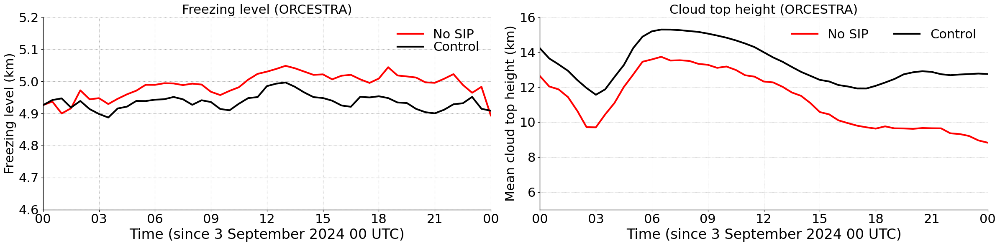

In [35]:



fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
#plt.plot(ds_4sip.time, mean_melt_lev_4sip, 'k--', linewidth=ln, label='Control')
#plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
#plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
#plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
#plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(4.6, 5.2)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (km)', fontsize=fnt)
plt.title('Freezing level (ORCESTRA)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(5,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Mean cloud top height (km)', fontsize=fnt)#, fontweight='bold')
plt.title('Cloud top height (ORCESTRA)', fontsize=fnt)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [36]:
ds_4sip

<xarray.Dataset> Size: 102GB
Dimensions:            (time: 49, ncells: 73960, vertices: 3, height: 65,
                        bnds: 2, plev: 1, plev_2: 1, plev_3: 1, height_2: 66)
Coordinates:
  * time               (time) datetime64[ns] 392B 2024-09-03 ... 2024-09-04
    clon               (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
    clat               (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
  * height             (height) float64 520B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0
  * height_2           (height_2) float64 528B 1.0 2.0 3.0 ... 64.0 65.0 66.0
  * plev               (plev) float64 8B 800.0
  * plev_2             (plev_2) float64 8B 400.0
  * plev_3             (plev_3) float64 8B 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/129)
    clon_bnds          (time, ncells, vertices) float64 87MB dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds          (time, ncells, vertices) float64 87MB dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds        (time, height, bnds) float64 51kB dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds          (time, plev, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds        (time, plev_2, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds        (time, plev_3, bnds) float64 784B dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...                 ...
    ciwc_gperm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    twc_gperm3         (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3        (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl           (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tot_q              (time, height, ncells) float32 942MB dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: f3f9a5624ca4223a7fe2f0c...
    history:              /home/b/b382718/continental_cases/4sip/icon-oct2024...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l20442 (Linux 4.18.0-513....

## TOA Radiative Fluxes
#### Calculating CRE
##### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
##### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
##### Net CRE = SW_CRE + LW_CRE

In [9]:

#### SIP
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0)
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0)
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_lw_dn_4sip-toa_lw_up_4sip) - (toa_lw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip

ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip

surf_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=65)
surf_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=65) 
surf_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=65) 

surf_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=65) 
surf_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=65) 
surf_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=65) 
surf_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=65) 

surf_sw_cre_4sip = (surf_sw_dn_4sip-surf_sw_up_4sip) - (surf_sw_dn_clr_4sip-surf_sw_up_clr_4sip)
surf_lw_cre_4sip = (surf_lw_dn_4sip-surf_lw_up_4sip) - (surf_lw_dn_clr_4sip-surf_lw_up_clr_4sip)
surf_net_cre_4sip = surf_sw_cre_4sip+surf_lw_cre_4sip

ds_4sip['surf_sw_cre'] = surf_sw_cre_4sip
ds_4sip['surf_lw_cre'] = surf_lw_cre_4sip
ds_4sip['surf_net_cre'] = surf_net_cre_4sip


#### No SIP
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0)
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0)
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0)
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0)

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0)
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0)
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0)
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0)

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_lw_dn_nosip-toa_lw_up_nosip) - (toa_lw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip

surf_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=65)
surf_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=65)
surf_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=65)
surf_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=65)

surf_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=65)
surf_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=65)
surf_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=65)
surf_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=65)

surf_sw_cre_nosip = (surf_sw_dn_nosip-surf_sw_up_nosip) - (surf_sw_dn_clr_nosip-surf_sw_up_clr_nosip)
surf_lw_cre_nosip = (surf_lw_dn_nosip-surf_lw_up_nosip) - (surf_lw_dn_clr_nosip-surf_lw_up_clr_nosip)
surf_net_cre_nosip = surf_sw_cre_nosip+surf_lw_cre_nosip

ds_nosip['surf_sw_cre'] = surf_sw_cre_nosip
ds_nosip['surf_lw_cre'] = surf_lw_cre_nosip
ds_nosip['surf_net_cre'] = surf_net_cre_nosip


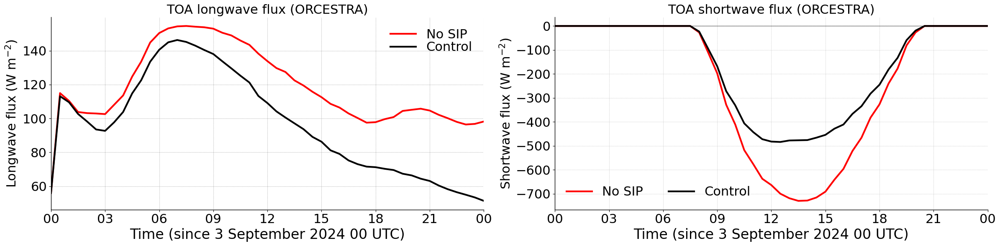

In [9]:



fnt=22;
ln=3;
plt.figure(figsize=(24, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, ds_4sip.toa_lw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_lw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Longwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA longwave flux (ORCESTRA)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, loc='best')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, ds_4sip.toa_sw_cre.mean('ncells'), 'r-', color='r', linewidth=ln, label='No SIP')
plt.plot(ds_4sip.time, ds_nosip.toa_sw_cre.mean('ncells'), 'k-', linewidth=ln, label='Control')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(5,16)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Shortwave flux (W m$^{-2}$)', fontsize=fnt)
plt.title('TOA shortwave flux (ORCESTRA)', fontsize=fnt)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

## Box plot of radiative fluxes, cloud cover and precipitation

In [10]:

dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))

acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours

tot_acc_precip_4sip = np.nanmax(ds_4sip.tot_prec.mean('ncells'))
tot_acc_precip_nosip = np.nanmax(ds_nosip.tot_prec.mean('ncells'))

std_tot_precip_4sip = np.nanstd(ds_4sip.tot_prec.mean('ncells'))
std_tot_precip_nosip = np.nanstd(ds_nosip.tot_prec.mean('ncells'))

n_cells = ds_4sip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_4sip = std_tot_precip_4sip / np.sqrt(n_cells)

n_cells = ds_nosip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_nosip = std_tot_precip_nosip / np.sqrt(n_cells)


In [36]:

start_time='2024-09-03T00:00:00.000000000';
end_time='2024-09-04T00:00:00.000000000';

## 4 SIP

## TOA LW
min_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_4sip = std_toa_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

## TOA SW
min_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_4sip = std_toa_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

## TOA NET
min_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_4sip = std_toa_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## Surface LW
min_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_4sip = std_surf_lw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

## Surface SW
min_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_4sip = std_surf_sw_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

## Surface NET
min_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_4sip = ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_4sip = std_surf_net_cre_4sip / np.sqrt(ds_4sip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

## No SIP
min_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.min(dim=('time','ncells')).values; 
max_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.max(dim=('time','ncells')).values
mean_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.mean(dim=('time','ncells')).values

std_toa_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.std(dim=('time','ncells')).values
stderr_toa_lw_cre_nosip = std_toa_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_lw_cre.count(dim=('time','ncells')).values)

min_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.min(dim=('time','ncells')).values; 
max_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.max(dim=('time','ncells')).values
mean_toa_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.mean(dim=('time','ncells')).values

std_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.std(dim=('time','ncells')).values
stderr_toa_sw_cre_nosip = std_toa_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_sw_cre.count(dim=('time','ncells')).values)

min_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.min(dim=('time','ncells')).values; 
max_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.max(dim=('time','ncells')).values
mean_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.mean(dim=('time','ncells')).values

std_toa_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.std(dim=('time','ncells')).values
stderr_toa_net_cre_nosip = std_toa_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).toa_net_cre.count(dim=('time','ncells')).values)

## surface
min_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.min(dim=('time','ncells')).values; 
max_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.max(dim=('time','ncells')).values
mean_surf_lw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.mean(dim=('time','ncells')).values

std_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.std(dim=('time','ncells')).values
stderr_surf_lw_cre_nosip = std_surf_lw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_lw_cre.count(dim=('time','ncells')).values)

min_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.min(dim=('time','ncells')).values; 
max_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.max(dim=('time','ncells')).values
mean_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.mean(dim=('time','ncells')).values

std_surf_sw_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.std(dim=('time','ncells')).values
stderr_surf_sw_cre_nosip = std_surf_sw_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_sw_cre.count(dim=('time','ncells')).values)

min_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.min(dim=('time','ncells')).values; 
max_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.max(dim=('time','ncells')).values
mean_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.mean(dim=('time','ncells')).values

std_surf_net_cre_nosip = ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.std(dim=('time','ncells')).values
stderr_surf_net_cre_nosip = std_surf_net_cre_nosip / np.sqrt(ds_nosip.sel(time=slice(start_time, end_time)).surf_net_cre.count(dim=('time','ncells')).values)

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 



In [17]:

start_time='2024-09-03T00:00:00.000000000';
end_time='2024-09-04T00:00:00.000000000';

low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_4sip = np.nanstd(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_4sip = std_low_cld_cover_4sip / np.sqrt(n_cells)

low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_nosip = np.nanstd(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_nosip = std_low_cld_cover_nosip / np.sqrt(n_cells)

mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_4sip = np.nanstd(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_4sip = std_mid_cld_cover_4sip / np.sqrt(n_cells)

mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_nosip = np.nanstd(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_nosip = std_mid_cld_cover_nosip / np.sqrt(n_cells)

high_cld_cover_4sip = np.nanmean(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_4sip = np.nanstd(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_4sip = std_high_cld_cover_4sip / np.sqrt(n_cells)

high_cld_cover_nosip = np.nanmean(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_nosip = np.nanstd(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_nosip = std_high_cld_cover_nosip / np.sqrt(n_cells)

tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_4sip = np.nanstd(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_4sip = std_tot_cld_cover_4sip / np.sqrt(n_cells)

tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_nosip = np.nanstd(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_nosip = std_tot_cld_cover_nosip / np.sqrt(n_cells)

#low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.mean('plev'))
#low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.mean('plev'))

#mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.mean('plev_2'))
#mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.mean('plev_2'))

#high_cld_cover_4sip = np.nanmean(ds_4sip.clch.mean('plev_3'))
#high_cld_cover_nosip = np.nanmean(ds_nosip.clch.mean('plev_3'))

#tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.mean('ncells'))
#tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.mean('ncells'))


In [20]:
stderr_tot_precip_4sip = stderr_tot_precip_4sip.values
stderr_tot_precip_nosip = stderr_tot_precip_nosip.values

stderr_low_cld_cover_4sip = stderr_low_cld_cover_4sip.values
stderr_low_cld_cover_nosip = stderr_low_cld_cover_nosip.values
stderr_mid_cld_cover_4sip = stderr_mid_cld_cover_4sip.values
stderr_mid_cld_cover_nosip = stderr_mid_cld_cover_nosip.values
stderr_high_cld_cover_4sip = stderr_high_cld_cover_4sip.values
stderr_high_cld_cover_nosip = stderr_high_cld_cover_nosip.values
stderr_tot_cld_cover_4sip = stderr_tot_cld_cover_4sip.values
stderr_tot_cld_cover_nosip = stderr_tot_cld_cover_nosip.values

AttributeError: 'numpy.ndarray' object has no attribute 'values'

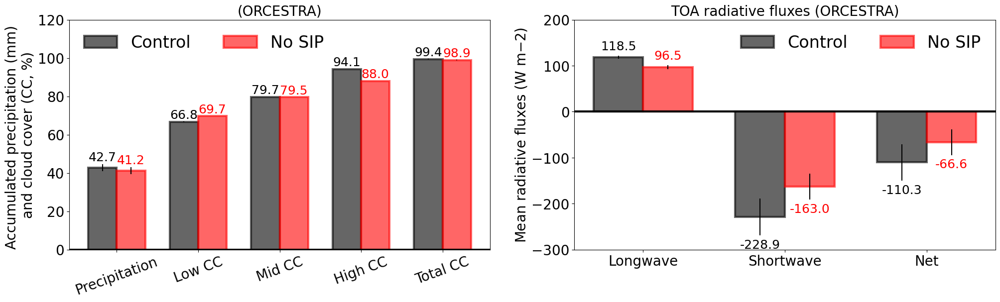

In [21]:


#group_cc_4sip = [tot_acc_precip_4sip, low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
#group_cc_nosip = [tot_acc_precip_nosip, low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

group_cc_4sip = [low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
group_cc_nosip = [low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

#stderr_cc_4sip = [stderr_tot_precip_4sip, stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
#stderr_cc_nosip = [stderr_tot_precip_nosip, stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

stderr_cc_4sip = [stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
stderr_cc_nosip = [stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

#stderr_cc_4sip = [std_tot_precip_4sip, std_low_cld_cover_4sip, std_mid_cld_cover_4sip, std_high_cld_cover_4sip, std_tot_cld_cover_4sip];
#stderr_cc_nosip = [std_tot_precip_nosip, std_low_cld_cover_nosip, std_mid_cld_cover_nosip, std_high_cld_cover_nosip, std_tot_cld_cover_nosip];

group_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

stderr_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
stderr_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
cc_comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_cc - width/2, group_cc_4sip, width, yerr=stderr_cc_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_cc + width/2, group_cc_nosip, width, yerr=stderr_cc_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(0,120)
ax1.set_ylabel('Accumulated precipitation (mm) \nand cloud cover (CC, %)', fontsize=fnt)
ax1.set_xticks(x_cc)
ax1.set_xticklabels(cc_comp_groups, rotation=20)
ax1.set_title('(ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_flux_4sip, width, yerr=stderr_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_flux_nosip, width, yerr=stderr_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-300,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


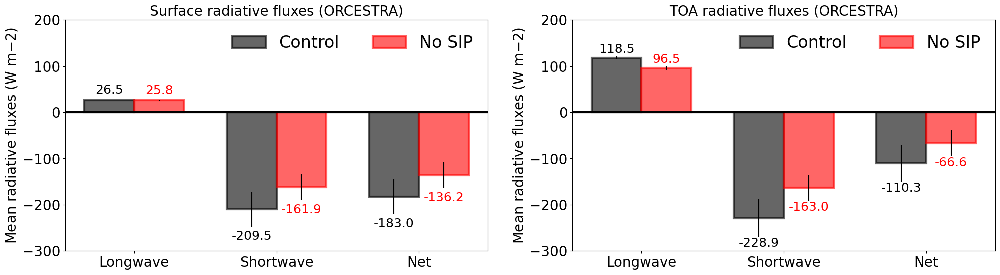

In [44]:

group_surf_flux_4sip = [mean_surf_lw_cre_4sip, mean_surf_sw_cre_4sip, mean_surf_net_cre_4sip]
group_surf_flux_nosip = [mean_surf_lw_cre_nosip, mean_surf_sw_cre_nosip, mean_surf_net_cre_nosip]

err_surf_flux_4sip = [stderr_surf_lw_cre_4sip, stderr_surf_sw_cre_4sip, stderr_surf_net_cre_4sip];
err_surf_flux_nosip = [stderr_surf_lw_cre_nosip, stderr_surf_sw_cre_nosip, stderr_surf_net_cre_nosip];

#err_surf_flux_4sip = [std_surf_lw_cre_4sip, std_surf_sw_cre_4sip, std_surf_net_cre_4sip];
#err_surf_flux_nosip = [std_surf_lw_cre_nosip, std_surf_sw_cre_nosip, std_surf_net_cre_nosip];

group_toa_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_toa_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

err_toa_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
err_toa_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#err_toa_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#err_toa_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_flux - width/2, group_surf_flux_4sip, width, yerr=err_surf_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_flux + width/2, group_surf_flux_nosip, width, yerr=err_surf_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(-300,200)
ax1.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax1.set_xticks(x_flux)
ax1.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax1.set_title('Surface radiative fluxes (ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_toa_flux_4sip, width, yerr=err_toa_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_toa_flux_nosip, width, yerr=err_toa_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-300,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)


ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


In [31]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre


In [36]:

print(ds_4sip.net_sw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_sw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_lw_cre.mean(dim=('ncells')).min().values, ds_4sip.net_lw_cre.mean(dim=('ncells')).max().values)
print(ds_4sip.net_tot_cre.mean(dim=('ncells')).min().values, ds_4sip.net_tot_cre.mean(dim=('ncells')).max().values)

-817.82245 0.0
19.704624 220.37091
-686.64233 220.37091


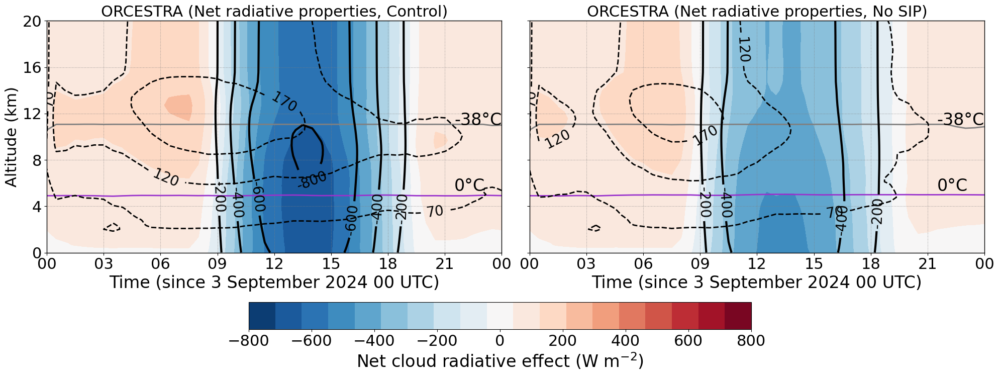

In [44]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-800, 800, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Net radiative properties, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-800, 0, 200)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(20, 220, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.net_tot_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Net radiative properties, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-800, 0, 200)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_sw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1+1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.arange(20, 220, 50)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.net_lw_cre.mean(dim=('ncells')).isel(height_2=slice(0, 65)).T, levels=contour_levels, colors='k', linestyles='--', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-800, -600, -400, -200, 0, 200, 400, 600, 800], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


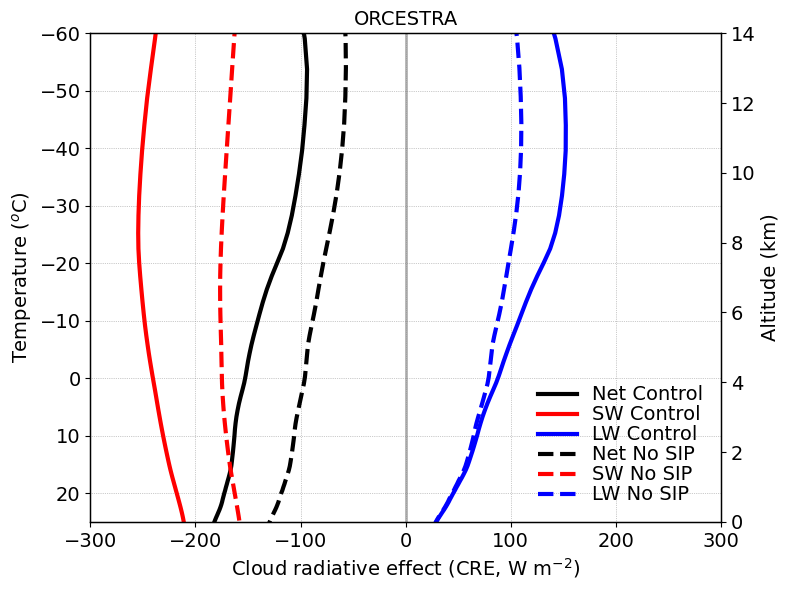

In [32]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Net Control')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='SW Control')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='LW Control')

plt1.plot(ds_nosip.net_tot_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Net No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='SW No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='LW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-300., 300)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [ ]:
(ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)

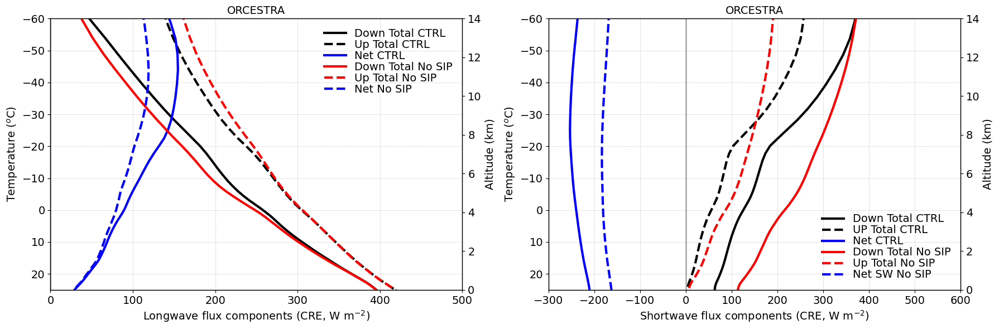

In [48]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(18, 6))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Up Total CTRL')
plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0., 500)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Longwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Down Total CTRL')
plt1.plot(ds_4sip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k--', linewidth=lnwdth, label='UP Total CTRL')
plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net CTRL')

plt1.plot(ds_nosip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Down Total No SIP')
plt1.plot(ds_nosip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Up Total No SIP')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net SW No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-300., 600)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Shortwave flux components (CRE, W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)
plt.tight_layout()
plt.show()


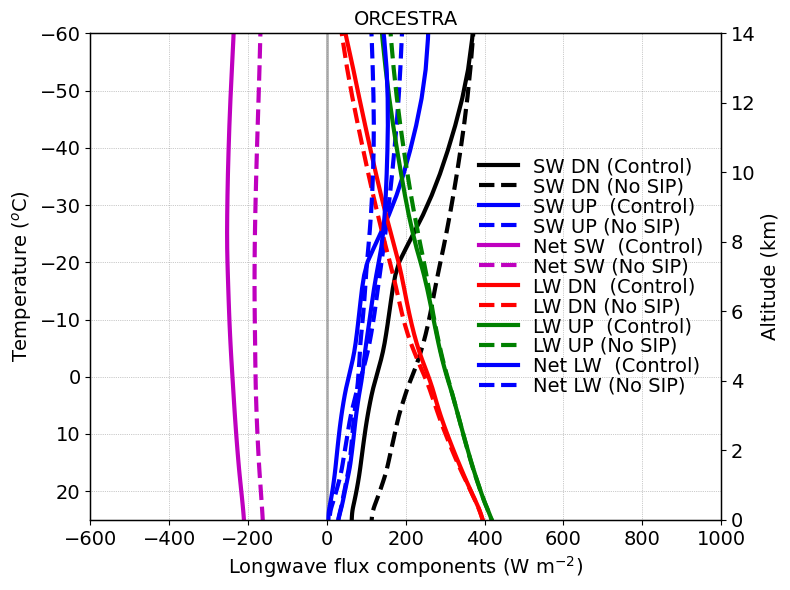

In [45]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(ds_4sip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='SW DN (Control)')
plt1.plot(ds_nosip.swflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'k--', linewidth=lnwdth, label='SW DN (No SIP)')

plt1.plot(ds_4sip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='SW UP  (Control)')
plt1.plot(ds_nosip.swflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='SW UP (No SIP)')

plt1.plot(ds_4sip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Net SW  (Control)')
plt1.plot(ds_nosip.net_sw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Net SW (No SIP)')


plt1.plot(ds_4sip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='LW DN  (Control)')
plt1.plot(ds_nosip.lwflx_dn.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='LW DN (No SIP)')

plt1.plot(ds_4sip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'g-', linewidth=lnwdth, label='LW UP  (Control)')
plt1.plot(ds_nosip.lwflx_up.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'g--', linewidth=lnwdth, label='LW UP (No SIP)')

plt1.plot(ds_4sip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Net LW  (Control)')
plt1.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Net LW (No SIP)')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.net_lw_cre.mean(dim=('time','ncells')).isel(height_2=slice(0, 65)), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-600., 1000)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Longwave flux components (W m$^{-2}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [7]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre


In [10]:

def lwc_netcre_ht_avg(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
    netcre_mean = netcre_interp.mean(dim=height)

    return lwc_mean, netcre_mean

def lwc_swcre_ht_avg(ds, lwc_var='lwc_gperm3', swcre_var='net_sw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average    
    swcre_interp = ds[swcre_var].interp({height2: ds[height]})
    swcre_mean = swcre_interp.mean(dim=height)

    return lwc_mean, swcre_mean

def lwc_lwcre_ht_avg(ds, lwc_var='lwc_gperm3', lwcre_var='net_lw_cre', height='height', height2='height_2'):
    # Average over height for lwc
    lwc_mean = ds[lwc_var].mean(dim=height)

    # Interpolate net CRE to match height, then average
    lwcre_interp = ds[lwcre_var].interp({height2: ds[height]})
    lwcre_mean = lwcre_interp.mean(dim=height)

    return lwc_mean, lwcre_mean




def iwc_ht_avg(ds, iwc_var='tiwc_gperm3', height='height'):
    # Average over height for lwc
    iwc_mean = ds[iwc_var].mean(dim=height)

    return iwc_mean


def cdnc_ht_avg(ds, cdnc_var='cdnc_percm3', height='height'):
    # Average over height for lwc
    cdnc_mean = ds[cdnc_var].mean(dim=height)

    return cdnc_mean

def tinc_ht_avg(ds, tinc_var='inc_perl', height='height'):
    # Average over height for lwc
    tinc_mean = ds[tinc_var].mean(dim=height)

    return tinc_mean


#def average_over_height(ds, lwc_var='lwc_gperm3', netcre_var='net_tot_cre', height='height', height2='height_2'):
#    # Average over height for lwc
#    lwc_mean = ds[lwc_var].mean(dim=height)#
#
#    # Interpolate net CRE to match height, then average
#    netcre_interp = ds[netcre_var].interp({height2: ds[height]})
#    netcre_mean = netcre_interp.mean(dim=height)
#
#    return lwc_mean, netcre_mean



In [11]:

lwc_4sip, netcre_4sip = lwc_netcre_ht_avg(ds_4sip)
lwc_nosip, netcre_nosip = lwc_netcre_ht_avg(ds_nosip)

lwc_4sip, swcre_4sip = lwc_swcre_ht_avg(ds_4sip)
lwc_nosip, swcre_nosip = lwc_swcre_ht_avg(ds_nosip)

lwc_4sip, lwcre_4sip = lwc_lwcre_ht_avg(ds_4sip)
lwc_nosip, lwcre_nosip = lwc_lwcre_ht_avg(ds_nosip)


# Flatten to 1D
lwc_4sip = lwc_4sip.values.flatten()
netcre_4sip = netcre_4sip.values.flatten()
swcre_4sip = swcre_4sip.values.flatten()
lwcre_4sip = lwcre_4sip.values.flatten()

lwc_nosip = lwc_nosip.values.flatten()
netcre_nosip = n
lwc_4sip, netcre_4sip = lwc_netcre_ht_avg(ds_4sip)
lwc_nosip, netcre_nosip = lwc_netcre_ht_avg(ds_nosip)

lwc_4sip, swcre_4sip = lwc_swcre_ht_avg(ds_4sip)
lwc_nosip, swcre_nosip = lwc_swcre_ht_avg(ds_nosip)

lwc_4sip, lwcre_4sip = lwc_lwcre_ht_avg(ds_4sip)
lwc_nosip, lwcre_nosip = lwc_lwcre_ht_avg(ds_nosip)


# Flatten to 1D
lwc_4sip = lwc_4sip.values.flatten()
netcre_4sip = netcre_4sip.values.flatten()
swcre_4sip = swcre_4sip.values.flatten()
lwcre_4sip = lwcre_4sip.values.flatten()

lwc_nosip = lwc_nosip.values.flatten()
netcre_nosip = netcre_nosip.values.flatten()
swcre_nosip = swcre_nosip.values.flatten()
lwcre_nosip = lwcre_nosip.values.flatten()


iwc_4sip= iwc_ht_avg(ds_4sip)
iwc_nosip = iwc_ht_avg(ds_nosip)

iwc_4sip = iwc_4sip.values.flatten()
iwc_nosip = iwc_nosip.values.flatten()


cdnc_4sip= cdnc_ht_avg(ds_4sip)
cdnc_nosip = cdnc_ht_avg(ds_nosip)

cdnc_4sip = cdnc_4sip.values.flatten()
cdnc_nosip = cdnc_nosip.values.flatten()

tinc_4sip= tinc_ht_avg(ds_4sip)
tinc_nosip = tinc_ht_avg(ds_nosip)

tinc_4sip = tinc_4sip.values.flatten()
tinc_nosip = tinc_nosip.values.flatten()
etcre_nosip.values.flatten()
swcre_nosip = swcre_nosip.values.flatten()
lwcre_nosip = lwcre_nosip.values.flatten()


iwc_4sip= iwc_ht_avg(ds_4sip)
iwc_nosip = iwc_ht_avg(ds_nosip)

iwc_4sip = iwc_4sip.values.flatten()
iwc_nosip = iwc_nosip.values.flatten()


cdnc_4sip= cdnc_ht_avg(ds_4sip)
cdnc_nosip = cdnc_ht_avg(ds_nosip)

cdnc_4sip = cdnc_4sip.values.flatten()
cdnc_nosip = cdnc_nosip.values.flatten()

tinc_4sip= tinc_ht_avg(ds_4sip)
tinc_nosip = tinc_ht_avg(ds_nosip)

tinc_4sip = tinc_4sip.values.flatten()
tinc_nosip = tinc_nosip.values.flatten()


In [13]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err


In [14]:
# Filter to reasonable LWC range (e.g., non-zero, realistic values)
mask_lwc_4sip = (lwc_4sip > 1e-3)
mask_lwc_nosip = (lwc_nosip > 1e-3)

mask_iwc_4sip = (iwc_4sip > 1e-3)
mask_iwc_nosip = (iwc_nosip > 1e-3)

mask_cdnc_4sip = (cdnc_4sip > 1e-3)
mask_cdnc_nosip = (cdnc_nosip > 1e-3)

mask_tinc_4sip = (tinc_4sip > 1e-3)
mask_tinc_nosip = (tinc_nosip > 1e-3)

lwc_bins = np.linspace(0, np.nanmax([lwc_4sip, lwc_nosip]), 8)  # ~25 bins
iwc_bins = np.linspace(0, np.nanmax([iwc_4sip, iwc_nosip]), 8)

# CONTROL
binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], netcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], swcre_4sip[mask_lwc_4sip], lwc_bins)
binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], lwcre_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], netcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], swcre_4sip[mask_iwc_4sip], iwc_bins)
binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], lwcre_4sip[mask_iwc_4sip], iwc_bins)

binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip = bin_avg(lwc_4sip[mask_lwc_4sip], cdnc_4sip[mask_lwc_4sip], lwc_bins)

binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip = bin_avg(iwc_4sip[mask_iwc_4sip], tinc_4sip[mask_iwc_4sip], iwc_bins)

# NO SIP
binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], netcre_nosip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], swcre_4sip[mask_lwc_nosip], lwc_bins)
binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], lwcre_4sip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], netcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], swcre_nosip[mask_iwc_nosip], iwc_bins)
binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], lwcre_nosip[mask_iwc_nosip], iwc_bins)

binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip = bin_avg(lwc_nosip[mask_lwc_nosip], cdnc_nosip[mask_lwc_nosip], lwc_bins)

binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip = bin_avg(iwc_nosip[mask_iwc_nosip], tinc_nosip[mask_iwc_nosip], iwc_bins)


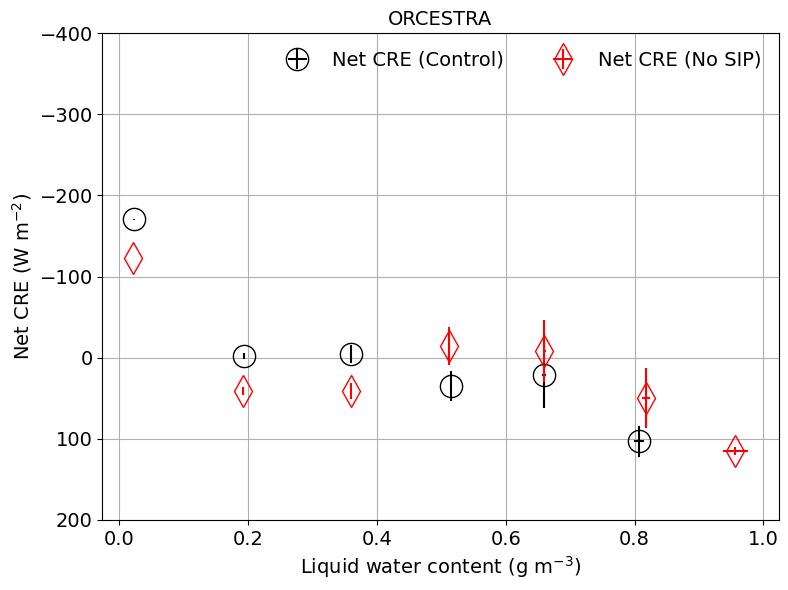

In [17]:

fnt=14;
ms=16
plt.figure(figsize=(8, 6))
plt.style.use('default')

# Plot Control with black error bars
plt.errorbar(binned_lwc_4sip, binned_netcre_4sip, xerr=err_lwc_4sip, yerr=err_netcre_4sip, 
             fmt='o', color='black', markersize=ms, markerfacecolor='none', label='Net CRE (Control)', capsize=0)
plt.errorbar(binned_lwc_nosip, binned_netcre_nosip, xerr=err_lwc_nosip, yerr=err_netcre_nosip, 
             fmt='d', color='red', markersize=ms, markerfacecolor='none', label='Net CRE (No SIP)',capsize=0)

#plt.errorbar(binned_lwc_4sip, binned_swcre_4sip, xerr=err_lwc_4sip, yerr=err_swcre_4sip, 
#             fmt='o', color='b', markersize=ms, markerfacecolor='none', label='SW CRE (Control)', capsize=0)
#plt.errorbar(binned_lwc_nosip, binned_swcre_nosip, xerr=err_lwc_nosip, yerr=err_swcre_nosip, 
#             fmt='d', color='b', markersize=ms, markerfacecolor='none', label='SW CRE (No SIP)', capsize=0)

#plt.errorbar(binned_lwc_4sip, binned_lwcre_4sip, xerr=err_lwc_4sip, yerr=err_lwcre_4sip, 
#             fmt='o', color='g', markersize=ms, markerfacecolor='none', label='LW CRE (Control)', capsize=0)
#plt.errorbar(binned_lwc_nosip, binned_lwcre_nosip, xerr=err_lwc_nosip, yerr=err_lwcre_nosip, 
#             fmt='d', color='g', markersize=ms, markerfacecolor='none', label='LW CRE (No SIP)', capsize=0)


#plt.xlim(0., 0.007)
plt.ylim(200, -400)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.title('ORCESTRA', fontsize=fnt)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fnt)

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.5, ncols=2, fontsize=fnt, loc='best')
plt.grid(True)
plt.tight_layout()
plt.show()


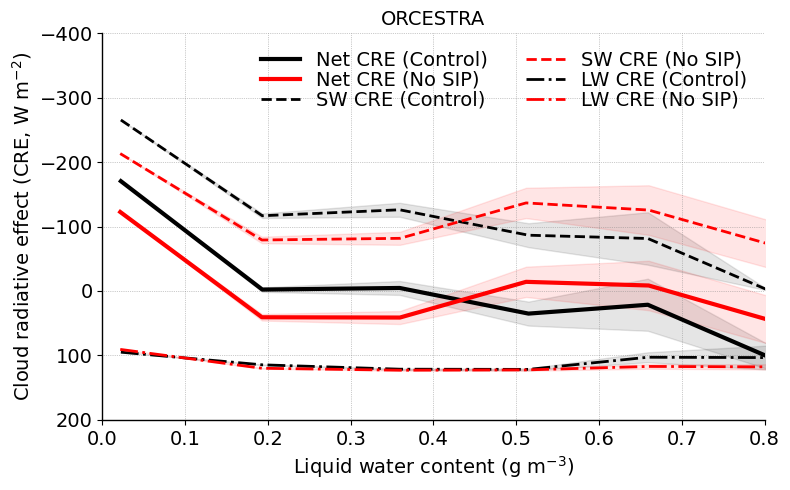

In [26]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')

plot_with_shaded_error_lwc_netcre(ax, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

# Repeat for SW and LW

ax.set_xlim(0, 0.8)
ax.set_ylim(200, -400)

#ax.set_xticks([-1, -0.5, 0, 0.5, 1])
#ax.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax.set_ylabel('Cloud radiative effect (CRE, W m$^{-2}$)', fontsize=fnt)
ax.set_title('ORCESTRA', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=2, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


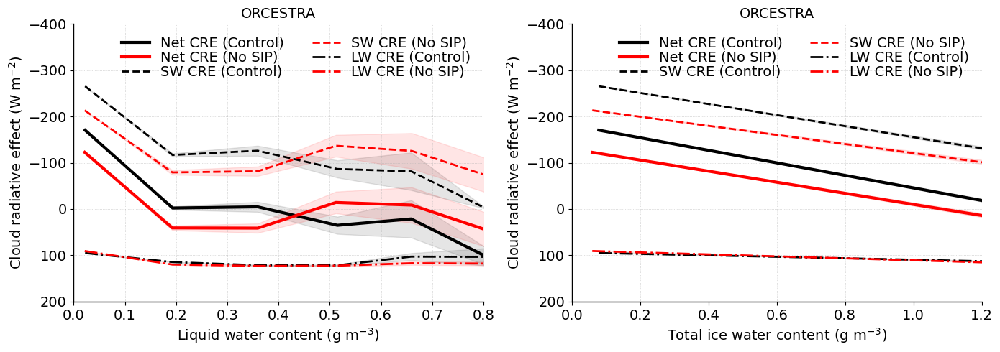

In [22]:

def plot_with_shaded_error_lwc_netcre(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_swcre(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lwc_lwcre(ax, x, y, xerr, yerr, color, label, linestyle='-.', linewidth=ln2):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_4sip, binned_netcre_4sip, err_lwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax1, binned_lwc_nosip, binned_netcre_nosip, err_lwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_4sip, binned_swcre_4sip, err_lwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax1, binned_lwc_nosip, binned_swcre_nosip, err_lwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_4sip, binned_lwcre_4sip, err_lwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax1, binned_lwc_nosip, binned_lwcre_nosip, err_lwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax1.set_xlim(0, 0.8)
ax1.set_ylim(200, -400)
#ax1.set_xticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6])
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax1.set_title('ORCESTRA', fontsize=fnt)
ax1.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_4sip, binned_netcre_4sip, err_iwc_4sip, err_netcre_4sip, 'k', 'Net CRE (Control)')
plot_with_shaded_error_lwc_netcre(ax2, binned_iwc_nosip, binned_netcre_nosip, err_iwc_nosip, err_netcre_nosip, 'r', 'Net CRE (No SIP)')

plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_4sip, binned_swcre_4sip, err_iwc_4sip, err_swcre_4sip, 'k', 'SW CRE (Control)')
plot_with_shaded_error_lwc_swcre(ax2, binned_iwc_nosip, binned_swcre_nosip, err_iwc_nosip, err_swcre_nosip, 'r', 'SW CRE (No SIP)')

plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_4sip, binned_lwcre_4sip, err_iwc_4sip, err_lwcre_4sip, 'k', 'LW CRE (Control)')
plot_with_shaded_error_lwc_lwcre(ax2, binned_iwc_nosip, binned_lwcre_nosip, err_iwc_nosip, err_lwcre_nosip, 'r', 'LW CRE (No SIP)')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(200, -400)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Cloud radiative effect (W m$^{-2}$)', fontsize=fnt)
ax2.set_title('ORCESTRA', fontsize=fnt)
ax2.legend(frameon=False, ncols=2, labelspacing=0.05, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


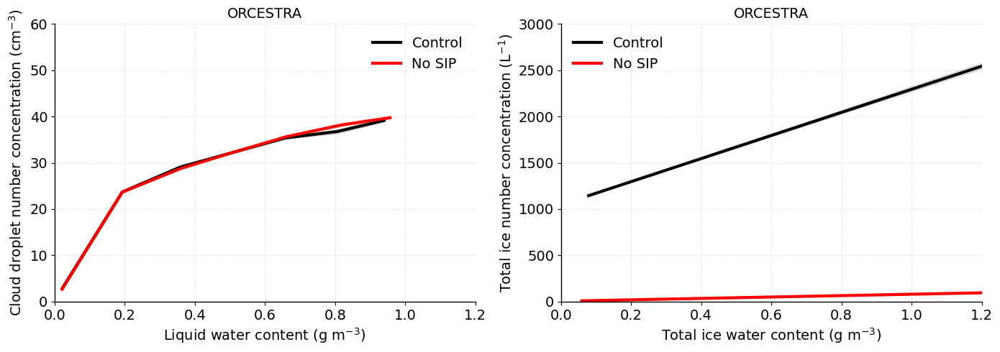

In [25]:

def plot_with_shaded_error_lwc_cdnc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)
    
def plot_with_shaded_error_lwc_tinc(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)


fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 5), sharex=False)
plt.style.use('default')

### ───── TOP PANEL: Absolute CREs ─────
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_4sip, binned_cdnc_4sip, err_lwc_4sip, err_cdnc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_cdnc(ax1, binned_lwc_nosip, binned_cdnc_nosip, err_lwc_nosip, err_cdnc_nosip, 'r', 'No SIP')

ax1.set_xlim(0, 1.2)
ax1.set_ylim(0, 60)
ax1.set_xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt)
ax1.set_ylabel('Cloud droplet number concentration (cm$^{-3}$)', fontsize=fnt)
ax1.set_title('ORCESTRA', fontsize=fnt)
ax1.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax1.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

### ───── BOTTOM PANEL: ΔCRE (Control - No SIP) ─────

plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_4sip, binned_tinc_4sip, err_iwc_4sip, err_tinc_4sip, 'k', 'Control')
plot_with_shaded_error_lwc_tinc(ax2, binned_iwc_nosip, binned_tinc_nosip, err_iwc_nosip, err_tinc_nosip, 'r', 'No SIP')

ax2.set_xlim(0, 1.2)
ax2.set_ylim(0, 3000)
ax2.set_xlabel('Total ice water content (g m$^{-3}$)', fontsize=fnt)
ax2.set_ylabel('Total ice number concentration (L$^{-1}$)', fontsize=fnt)
ax2.set_title('ORCESTRA', fontsize=fnt)
ax2.legend(frameon=False, ncols=1, fontsize=fnt, loc='best')
ax2.grid(True, linestyle=':', linewidth=0.5, alpha=0.8)

for ax in [ax1, ax2]:
    ax.tick_params(labelsize=fnt)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1)
    ax.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [19]:

#SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
#LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)

ds_4sip['net_sw_cre'] = (ds_4sip.swflx_dn - ds_4sip.swflx_up) - (ds_4sip.swflx_dn_clr - ds_4sip.swflx_up_clr)
ds_4sip['net_lw_cre'] = (ds_4sip.lwflx_dn - ds_4sip.lwflx_up) - (ds_4sip.lwflx_dn_clr - ds_4sip.lwflx_up_clr)
ds_4sip['net_tot_cre'] = ds_4sip.net_sw_cre + ds_4sip.net_lw_cre

ds_nosip['net_sw_cre'] = (ds_nosip.swflx_dn - ds_nosip.swflx_up) - (ds_nosip.swflx_dn_clr - ds_nosip.swflx_up_clr)
ds_nosip['net_lw_cre'] = (ds_nosip.lwflx_dn - ds_nosip.lwflx_up) - (ds_nosip.lwflx_dn_clr - ds_nosip.lwflx_up_clr)
ds_nosip['net_tot_cre'] = ds_nosip.net_sw_cre + ds_nosip.net_lw_cre

ds_4sip['tqci'] = ds_4sip.qc+ds_4sip.qi
ds_nosip['tqci'] = ds_nosip.qc+ds_nosip.qi


In [9]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_lwc_4sip = ds_4sip.lwc_gperm3.min().values
max_lwc_4sip = ds_4sip.lwc_gperm3.max().values
#######

n_bin = 30;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
lwc_4sip_bin = np.linspace(min_lwc_4sip, max_lwc_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.values.flatten()
lwc_4sip_flat = ds_4sip.lwc_gperm3.values.flatten()
net_cre_4sip_flat = ds_4sip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_4sip_flat = ds_4sip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_4sip_flat = ds_4sip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_4sip, temp_edges_4sip, lwc_edges_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin))
#######

#######
net_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = net_cre_4sip_flat)[0]
sw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = sw_cre_4sip_flat)[0]
lw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, lwc_4sip_bin), weights = lw_cre_4sip_flat)[0]
#######

#######
net_cre_temp_lwc_4sip = net_cre_sum_4sip/hist_4sip
sw_cre_temp_lwc_4sip = sw_cre_sum_4sip/hist_4sip
lw_cre_temp_lwc_4sip = lw_cre_sum_4sip/hist_4sip
#######

In [10]:
#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lwc_nosip = ds_nosip.lwc_gperm3.min().values
max_lwc_nosip = ds_nosip.lwc_gperm3.max().values
#######

n_bin = 30;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
lwc_nosip_bin = np.linspace(min_lwc_nosip, max_lwc_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
lwc_nosip_flat = ds_nosip.lwc_gperm3.values.flatten()
net_cre_nosip_flat = ds_nosip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_nosip_flat = ds_nosip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_nosip_flat = ds_nosip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_nosip, temp_edges_nosip, lwc_edges_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin))
#######

#######
net_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = net_cre_nosip_flat)[0]
sw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = sw_cre_nosip_flat)[0]
lw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, lwc_nosip_bin), weights = lw_cre_nosip_flat)[0]
#######

#######
net_cre_temp_lwc_nosip = net_cre_sum_nosip/hist_nosip
sw_cre_temp_lwc_nosip = sw_cre_sum_nosip/hist_nosip
lw_cre_temp_lwc_nosip = lw_cre_sum_nosip/hist_nosip


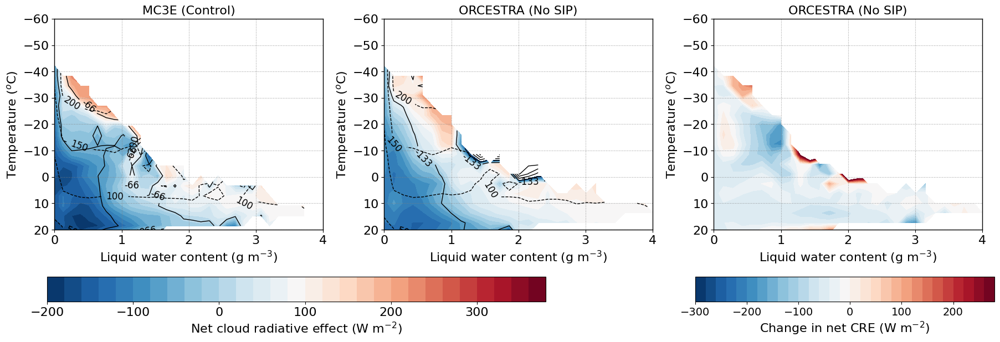

In [18]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.arange(-200, 400, 20)
lev2 = np.arange(-200, 400, 20)
lev3 = np.arange(-300, 200, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

#im = axes[0].imshow(net_cre_temp_lwc_4sip, extent=[lwc_4sip_bin[0], lwc_4sip_bin[-1], temp_4sip_bin[0], temp_4sip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap=cmap)
#axes[0].set_title('Net CRE [Control]', fontsize=fontsize)

#contours = axes[0].contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#axes[0].clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')

#cnt1=plt.imshow(net_cre_temp_lwc_4sip, extent=[lwc_4sip_bin[0], lwc_4sip_bin[-1], temp_4sip_bin[0], temp_4sip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

cnt1=plt.contourf(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-600, 200., 7)
contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], sw_cre_temp_lwc_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], lw_cre_temp_lwc_4sip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

#cnt2=plt.imshow(net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=vmin, vmax=vmax, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')

cnt2=plt.contourf(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_nosip, levels=lev1, cmap='RdBu_r')
#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_nosip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-800, 200., 7)
contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], sw_cre_temp_lwc_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], lw_cre_temp_lwc_nosip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[-200, -100, 0, 100, 200, 300, 400], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.arange(-300, 300, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


plt.xlim(0, 4)
plt.ylim(20, -60)
plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400], orientation='horizontal')
cbar.set_label('Change in net CRE (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [20]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_qci_4sip = ds_4sip.tqci.min().values
max_qci_4sip = ds_4sip.tqci.max().values
#######

n_bin = 30;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
qci_4sip_bin = np.linspace(min_qci_4sip, max_qci_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.values.flatten()
qci_4sip_flat = ds_4sip.tqci.values.flatten()
net_cre_4sip_flat = ds_4sip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_4sip_flat = ds_4sip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_4sip_flat = ds_4sip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_4sip, temp_edges_4sip, qci_edges_4sip = np.histogram2d(tempc_4sip_flat, qci_4sip_flat, bins=(temp_4sip_bin, qci_4sip_bin))
#######

#######
net_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, qci_4sip_bin), weights = net_cre_4sip_flat)[0]
sw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, qci_4sip_bin), weights = sw_cre_4sip_flat)[0]
lw_cre_sum_4sip = np.histogram2d(tempc_4sip_flat, lwc_4sip_flat, bins=(temp_4sip_bin, qci_4sip_bin), weights = lw_cre_4sip_flat)[0]
#######

#######
net_cre_temp_qci_4sip = net_cre_sum_4sip/hist_4sip
sw_cre_temp_qci_4sip = sw_cre_sum_4sip/hist_4sip
lw_cre_temp_qci_4sip = lw_cre_sum_4sip/hist_4sip
#######

In [21]:
#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_qci_nosip = ds_nosip.tqci.min().values
max_qci_nosip = ds_nosip.tqci.max().values
#######

n_bin = 30;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
qci_nosip_bin = np.linspace(min_qci_nosip, max_qci_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
qci_nosip_flat = ds_nosip.tqci.values.flatten()
net_cre_nosip_flat = ds_nosip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_nosip_flat = ds_nosip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_nosip_flat = ds_nosip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_nosip, temp_edges_nosip, qci_edges_nosip = np.histogram2d(tempc_nosip_flat, qci_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin))
#######

#######
net_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = net_cre_nosip_flat)[0]
sw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = sw_cre_nosip_flat)[0]
lw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = lw_cre_nosip_flat)[0]
#######

#######
net_cre_temp_qci_nosip = net_cre_sum_nosip/hist_nosip
sw_cre_temp_qci_nosip = sw_cre_sum_nosip/hist_nosip
lw_cre_temp_qci_nosip = lw_cre_sum_nosip/hist_nosip
#######

In [30]:
np.max(net_cre_temp_qci_4sip)

np.float64(nan)

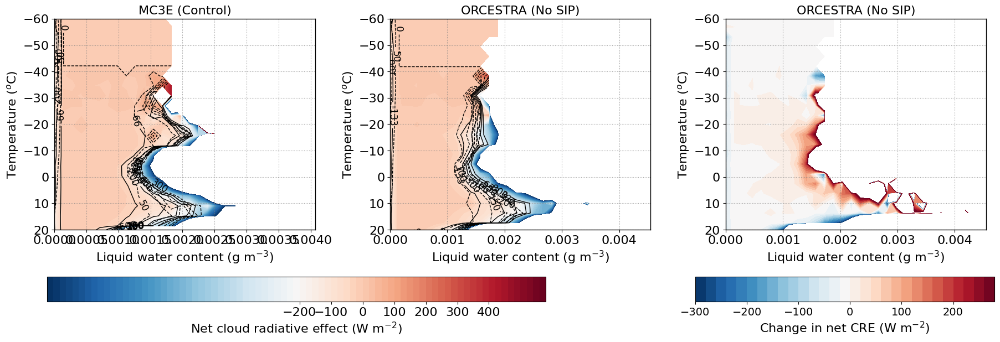

In [33]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.arange(-1000, 600, 20)
lev2 = np.arange(-1000, 600, 20)
lev3 = np.arange(-300, 200, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

cnt1=plt.contourf(qci_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_qci_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



#plt.xlim(0, 4)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('MC3E (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-600, 200., 7)
contours = plt.contour(qci_4sip_bin[:-1], temp_4sip_bin[:-1], sw_cre_temp_qci_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(qci_4sip_bin[:-1], temp_4sip_bin[:-1], lw_cre_temp_qci_4sip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

cnt2=plt.contourf(qci_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_qci_nosip, levels=lev1, cmap='RdBu_r')


#plt.xlim(0, 4)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-800, 200., 7)
contours = plt.contour(qci_nosip_bin[:-1], temp_nosip_bin[:-1], sw_cre_temp_qci_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

contour_levels = np.linspace(0, 300, 7)
contours = plt.contour(qci_nosip_bin[:-1], temp_nosip_bin[:-1], lw_cre_temp_qci_nosip, levels=contour_levels, colors='k', linestyles='--', linewidths=1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[-200, -100, 0, 100, 200, 300, 400], orientation='horizontal')
cbar.set_label('Net cloud radiative effect (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.arange(-300, 300, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(qci_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_qci_4sip-net_cre_temp_qci_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


#plt.xlim(0, 4)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400], orientation='horizontal')
cbar.set_label('Change in net CRE (W m$^{-2}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [40]:
print(min_lhr_nosip, max_lhr_nosip)
ds_nosip.lhr_kperd

-1449.4331 8748.487


<xarray.DataArray 'lhr_kperd' (time: 49, height: 65, ncells: 73960)> Size: 942MB
array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -9.29741049e-08, -8.53783675e-08, -8.73158115e-08],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -8.42342797e-06, -7.88174475e-06, -9.68257882e-06],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.63751751e-01, -1.52493224e-01, -1.20643519e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.79485157e-01, -1.67603523e-01, -1.33992642e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.86540321e-01, -1.74519852e-01, -1.40451521e-01]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.46818920e-07, -1.31782343e-07, -1.33002217e-07],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.38573469e-05, -1.28489737e-05, -1.37963489e-05],
...
         -1.23023987e-01,  5.06744385e-02,  1.13365181e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.26434326e-01,  6.94885254e-02,  1.38931274e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -1.21353157e-01,  9.12551954e-02,  1.56234741e-01]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -2.79396772e-09, -2.79396772e-09,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -6.78019691e-03, -6.63147122e-03, -6.16486184e-03],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          2.15103164e-01,  3.01162720e-01,  2.75070190e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          2.39227310e-01,  3.48770171e-01,  3.17871094e-01],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          2.59735107e-01,  3.88504028e-01,  3.32290649e-01]]],
      dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 392B 2024-09-03 ... 2024-09-04
    clon     (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
    clat     (ncells) float64 592kB dask.array<chunksize=(73960,), meta=np.ndarray>
  * height   (height) float64 520B 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
Dimensions without coordinates: ncells

In [ ]:
#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lhr_nosip = ds_nosip.lhr_kperd.min().values
max_lhr_nosip = ds_nosip.lhr_kperd.max().values
#######

n_bin = 30;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
qci_nosip_bin = np.linspace(min_qci_nosip, max_qci_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
qci_nosip_flat = ds_nosip.tqci.values.flatten()
net_cre_nosip_flat = ds_nosip.net_tot_cre[:,:65,:].values.flatten()
sw_cre_nosip_flat = ds_nosip.net_sw_cre[:,:65,:].values.flatten()
lw_cre_nosip_flat = ds_nosip.net_lw_cre[:,:65,:].values.flatten()


#######
hist_nosip, temp_edges_nosip, qci_edges_nosip = np.histogram2d(tempc_nosip_flat, qci_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin))
#######

#######
net_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = net_cre_nosip_flat)[0]
sw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = sw_cre_nosip_flat)[0]
lw_cre_sum_nosip = np.histogram2d(tempc_nosip_flat, lwc_nosip_flat, bins=(temp_nosip_bin, qci_nosip_bin), weights = lw_cre_nosip_flat)[0]
#######

#######
net_cre_temp_qci_nosip = net_cre_sum_nosip/hist_nosip
sw_cre_temp_qci_nosip = sw_cre_sum_nosip/hist_nosip
lw_cre_temp_qci_nosip = lw_cre_sum_nosip/hist_nosip
#######

In [80]:

#######
min_tempc_4sip = ds_4sip.tempc.min().values
max_tempc_4sip = ds_4sip.tempc.max().values

min_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').min().values
max_lhr_4sip = ds_4sip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 15;

temp_4sip_bin = np.linspace(min_tempc_4sip, max_tempc_4sip, n_bin+1)
lhr_4sip_bin = np.linspace(min_lhr_4sip, max_lhr_4sip, n_bin+1)
#######

#######
tempc_4sip_flat = ds_4sip.tempc.mean('ncells').values.flatten()
lhr_4sip_flat = ds_4sip.lhr_kperd.mean('ncells').values.flatten()
wvel_4sip_flat = ds_4sip.w_vel.max('ncells').values.flatten()


#######
hist_4sip, temp_edges_4sip, wvel_edges_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin))
#######

#######
wvel_sum_4sip = np.histogram2d(tempc_4sip_flat, lhr_4sip_flat, bins=(temp_4sip_bin, lhr_4sip_bin), weights = wvel_4sip_flat)[0]
#######

#######
wvel_temp_lhr_4sip = wvel_sum_4sip/hist_4sip
#######

In [78]:

#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').min().values
max_lhr_nosip = ds_nosip.lhr_kperd.mean('ncells').max().values
#######

n_bin = 15;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, n_bin+1)
lhr_nosip_bin = np.linspace(min_lhr_nosip, max_lhr_nosip, n_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.mean('ncells').values.flatten()
lhr_nosip_flat = ds_nosip.lhr_kperd.mean('ncells').values.flatten()
wvel_nosip_flat = ds_nosip.w_vel.max('ncells').values.flatten()


#######
hist_nosip, temp_edges_nosip, wvel_edges_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin))
#######

#######
wvel_sum_nosip = np.histogram2d(tempc_nosip_flat, lhr_nosip_flat, bins=(temp_nosip_bin, lhr_nosip_bin), weights = wvel_nosip_flat)[0]
#######

#######
wvel_temp_lhr_nosip = wvel_sum_nosip/hist_nosip
#######


In [49]:
print(np.linspace(-4, 4, 20))

[-4.         -3.57894737 -3.15789474 -2.73684211 -2.31578947 -1.89473684
 -1.47368421 -1.05263158 -0.63157895 -0.21052632  0.21052632  0.63157895
  1.05263158  1.47368421  1.89473684  2.31578947  2.73684211  3.15789474
  3.57894737  4.        ]


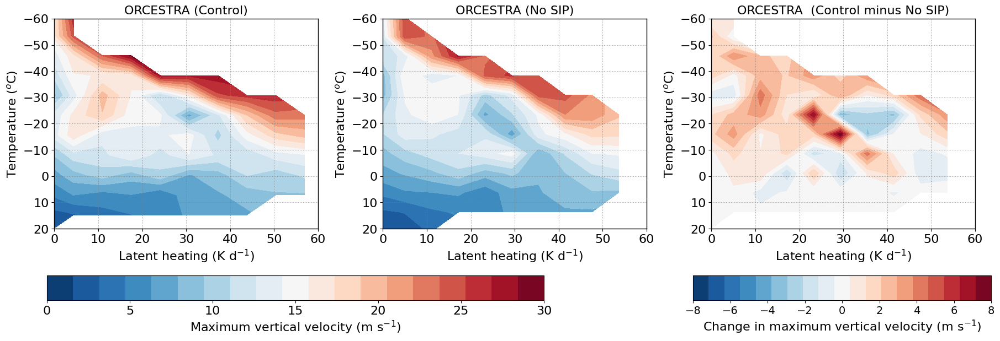

In [89]:

import matplotlib.lines as mlines

fnt=14;
fnt1=14;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;
vmin, vmax = -1000, 200

lev1 = np.linspace(0, 30, 20)
lev2 = np.arange(0, 30, 20)
lev3 = np.arange(-40, 40, 20)

plt.figure(figsize=(18, 5))
plt.style.use('default')

plt.subplot(1,3,1)

cnt1=plt.contourf(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=lev1, cmap='RdBu_r')

#contour_levels=np.arange(-1000, 200, 20)
#contours = plt.contour(lwc_4sip_bin[:-1], temp_4sip_bin[:-1], net_cre_temp_lwc_4sip, levels=contour_levels, colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%.0e')



plt.xlim(0, 60)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (Control)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_4sip_bin[:-1], temp_4sip_bin[:-1], wvel_temp_lhr_4sip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,3,2)

cnt2=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, levels=lev1, cmap='RdBu_r')


plt.xlim(0, 60)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA (No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

#contour_levels = np.linspace(-40, 40., 7)
#contours = plt.contour(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_nosip, levels=contour_levels, colors='k', linestyles='-', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.10, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar_ax = fig.add_axes([0.05, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt1, cax=cbar_ax, ticks=[0, 5, 10, 15, 20, 25, 30], orientation='horizontal')
cbar.set_label('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(1,3,3)

lev3 = np.linspace(-8, 8, 20)
#cnt3=plt.imshow(net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, extent=[lwc_nosip_bin[0], lwc_nosip_bin[-1], temp_nosip_bin[0], temp_nosip_bin[-1]],
#                     vmin=-1000, vmax=200, aspect='auto', origin='lower', cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')


cnt3=plt.contourf(lhr_nosip_bin[:-1], temp_nosip_bin[:-1], wvel_temp_lhr_4sip-wvel_temp_lhr_nosip, levels=lev3, cmap='RdBu_r')

#colorbar = plt.colorbar(cnt3, ticks=[-400, -300, -200, -100, 0, 100, 200, 300, 400])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Change in net CRE (W m$^{-2}$)', size=fnt)

#contours = plt.contour(lwc_nosip_bin[:-1], temp_nosip_bin[:-1], net_cre_temp_lwc_4sip-net_cre_temp_lwc_nosip, levels=np.linspace(0, 300, 7), colors=color, 
#                           linestyles='--', linewidths=1)
#plt.clabel(contours, inline=True, fontsize=fontsize-8, fmt='%2d')


plt.xlim(0, 60)
plt.ylim(20, -60)
#plt.xticks([0, 1, 2, 3, 4])
plt.xticks(fontsize=fnt+2)
plt.yticks(fontsize=fnt+2)
plt.xlabel('Latent heating (K d$^{-1}$)', fontsize=fnt+2)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fnt+2)
#plt.gca().set_yticks([])
#plt.gca().set_xticks([])
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.title('ORCESTRA  (Control minus No SIP)', fontsize=fnt+2)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.70, -0.1, 0.3, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt3, cax=cbar_ax, ticks=[-8, -6, -4, -2, 0, 2, 4, 6, 8], orientation='horizontal')
cbar.set_label('Change in maximum vertical velocity (m s$^{-1}$)', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt1)

plt.tight_layout()
plt.show()


In [7]:

w_thres = 2.
# Latent heating rate with No SIP
dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
#ds_nosip['lhr_kperd'] = xr.where((ds_nosip.lhr_kperd > -10.) & (ds_nosip.lhr_kperd < 20.), ds_nosip.lhr_kperd, np.nan)
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))
ds_nosip['lhr_kperd'] = (dims1, lhr_kperd_nosip)
ds_nosip['mean_lhr_kperd'] = (dims2, mean_lhr_kperd_nosip)

# Latent heating rate with 4-SIP
dims1 = ds_4sip.tempc.dims
dims = ds_4sip.tempc.mean(dim=('time','ncells')).dims
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
#ds_4sip['lhr_kperd'] = (dims, lhr_kperd_4sip)
#ds_4sip['lhr_kperd'] = xr.where((ds_4sip.lhr_kperd > -10.) & (ds_4sip.lhr_kperd < 20.), ds_4sip.lhr_kperd, np.nan)
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))
ds_4sip['lhr_kperd'] = (dims1, lhr_kperd_4sip)
ds_4sip['mean_lhr_kperd'] = (dims, mean_lhr_kperd_4sip)



In [19]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binned_statistic

def wvel_lhr_ncells_avg(ds, w_var='w_vel', lhr_var='lhr_kperd', height='height', ncells='ncells', time='time'):
    w_mean = ds[w_var].mean(dim=ncells)
    w_min = ds[w_var].min(dim=ncells)
    w_max = ds[w_var].max(dim=ncells)
    lhr_mean = ds[lhr_var].mean(dim=ncells)
    lhr_min = ds[lhr_var].min(dim=ncells)
    lhr_max = ds[lhr_var].max(dim=ncells)
    return lhr_mean, lhr_min, lhr_max, w_mean, w_min, w_max 


def bin_avg(x, y, bins):
    # Compute bin means and stds
    bin_means, bin_edges, _ = binned_statistic(x, y, statistic='mean', bins=bins)
    bin_x_means, _, _ = binned_statistic(x, x, statistic='mean', bins=bins)
    bin_x_stds, _, _ = binned_statistic(x, x, statistic='std', bins=bins)
    bin_y_stds, _, _ = binned_statistic(x, y, statistic='std', bins=bins)

    # Count per bin for std error
    bin_counts, _, _ = binned_statistic(x, y, statistic='count', bins=bins)
    bin_x_err = bin_x_stds / np.sqrt(bin_counts)
    bin_y_err = bin_y_stds / np.sqrt(bin_counts)

    return bin_x_means, bin_means, bin_x_err, bin_y_err
    

In [20]:

lhr_mean_4sip, lhr_min_4sip, lhr_max_4sip, wvel_mean_4sip, wvel_min_4sip, wvel_max_4sip = wvel_lhr_ncells_avg(ds_4sip)
lhr_mean_nosip, lhr_min_nosip, lhr_max_nosip, wvel_mean_nosip, wvel_min_nosip, wvel_max_nosip = wvel_lhr_ncells_avg(ds_nosip)

# Flatten to 1D
lhr_mean_4sip = lhr_mean_4sip.values.flatten()
lhr_min_4sip = lhr_min_4sip.values.flatten()
lhr_max_4sip = lhr_max_4sip.values.flatten()
wvel_mean_4sip = wvel_mean_4sip.values.flatten()
wvel_min_4sip = wvel_min_4sip.values.flatten()
wvel_max_4sip = wvel_max_4sip.values.flatten()

lhr_mean_nosip = lhr_mean_nosip.values.flatten()
lhr_min_nosip = lhr_min_nosip.values.flatten()
lhr_max_nosip = lhr_max_nosip.values.flatten()
wvel_mean_nosip = wvel_mean_nosip.values.flatten()
wvel_min_nosip = wvel_min_nosip.values.flatten()
wvel_max_nosip = wvel_max_nosip.values.flatten()


In [21]:
mask_lhr_mean_4sip = (lhr_mean_4sip > -40)
mask_lhr_mean_nosip = (lhr_mean_nosip > -40)

mask_lhr_min_4sip = (lhr_min_4sip > -40)
mask_lhr_min_nosip = (lhr_min_nosip > -40)

lhr_mean_bins = np.linspace(0, np.nanmax([lhr_mean_4sip, lhr_mean_nosip]), 10)  # ~25 bins
lhr_min_bins = np.linspace(0, np.nanmin([lhr_min_4sip, lhr_min_nosip]), 10)

binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_mean_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_mean_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_min_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_min_nosip[mask_lhr_mean_nosip], lhr_mean_bins)

binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip = bin_avg(lhr_mean_4sip[mask_lhr_mean_4sip], wvel_max_4sip[mask_lhr_mean_4sip], lhr_mean_bins)
binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip = bin_avg(lhr_mean_nosip[mask_lhr_mean_nosip], wvel_max_nosip[mask_lhr_mean_nosip], lhr_mean_bins)



In [33]:
print(lhr_min_bins)

[    0.       -191.97955  -383.9591   -575.93866  -767.9182   -959.89777
 -1151.8773  -1343.8569  -1535.8364  -1727.816  ]


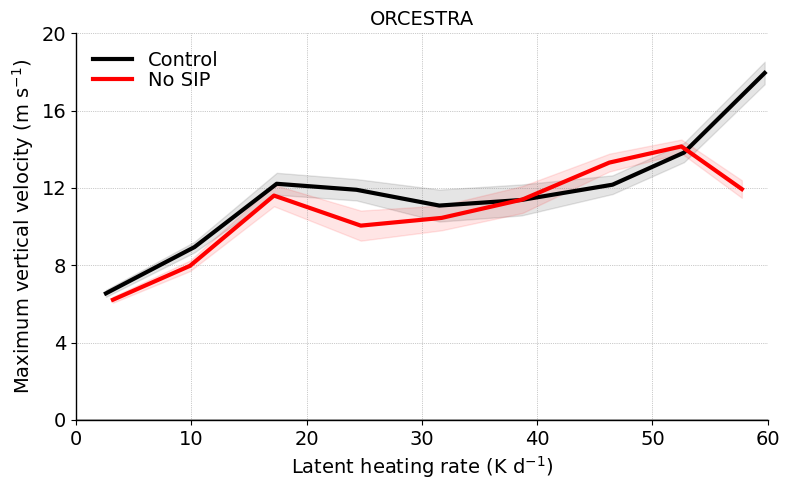

In [38]:


ln1=3;
ln2=2;
fnt=14;

def plot_with_shaded_error_lhr_wvel_mean(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_min(ax, x, y, xerr, yerr, color, label, linestyle='--', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

def plot_with_shaded_error_lhr_wvel_max(ax, x, y, xerr, yerr, color, label, linestyle='-', linewidth=ln1):
    ax.plot(x, y, linestyle=linestyle, linewidth=linewidth, color=color, label=label)
    ax.fill_between(x, y - yerr, y + yerr, color=color, alpha=0.1)

fig, ax = plt.subplots(figsize=(8, 5))
plt.style.use('default')


ax.axhline(y=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_4sip, binned_wvel_max_4sip, err_lhr_mean_4sip, err_wvel_max_4sip, 'k', 'Control')
plot_with_shaded_error_lhr_wvel_max(ax, binned_lhr_mean_nosip, binned_wvel_max_nosip, err_lhr_mean_nosip, err_wvel_max_nosip, 'r', 'No SIP')

#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_4sip, binned_wvel_min_4sip, err_lhr_mean_4sip, err_wvel_min_4sip, 'k', 'W$_{min}$ (Control)')
#plot_with_shaded_error_lhr_wvel_min(ax, binned_lhr_mean_nosip, binned_wvel_min_nosip, err_lhr_mean_nosip, err_wvel_min_nosip, 'r', 'W$_{min}$ (No SIP)')

#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_4sip, binned_wvel_mean_4sip, err_lhr_mean_4sip, err_wvel_mean_4sip, 'k', 'W$_{avg}$ (Control)')
#plot_with_shaded_error_lhr_wvel_mean(ax, binned_lhr_mean_nosip, binned_wvel_mean_nosip, err_lhr_mean_nosip, err_wvel_mean_nosip, 'r', 'W$_{avg}$ (No SIP)')


# Repeat for SW and LW

ax.set_xlim(0, 60)
ax.set_ylim(0, 20)

#ax.set_xticks([0, 4, 8, 12, 16, 20])
ax.set_yticks([0, 4, 8, 12, 16, 20])
#ax.set_yticks([0, 4, 8, 12, 16])

ax.tick_params(axis='x', labelsize=fnt)
ax.tick_params(axis='y', labelsize=fnt)
ax.set_xlabel('Latent heating rate (K d$^{-1}$)', fontsize=fnt)
ax.set_ylabel('Maximum vertical velocity (m s$^{-1}$)', fontsize=fnt)
ax.set_title('ORCESTRA', fontsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.05, ncols=1, fontsize=fnt, loc='best')
ax.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

ax.spines['top'].set_linewidth(1)
ax.spines['right'].set_linewidth(1)
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


In [8]:
import numpy as np
from scipy.stats import pearsonr

def calc_lhr_wvel_correlation(lhr_kperd, w_vel):
    time, height, ncells = lhr_kperd.shape
    corr_profile = np.zeros(height)
    for z in range(height):
        lh_flat = lhr_kperd[:, z, :].flatten()
        w_flat = w_vel[:, z, :].flatten()
        mask = ~np.isnan(lh_flat) & ~np.isnan(w_flat)
        if np.sum(mask) > 0:  # this can be higher, arbitrary threshold
            corr_profile[z], _ = pearsonr(lh_flat[mask], w_flat[mask])
        else:
            corr_profile[z] = np.nan
    return corr_profile

corr_lhr_wvel_4sip = calc_lhr_wvel_correlation(ds_4sip['lhr_kperd'].values, ds_4sip['w_vel'].values)
corr_lhr_wvel_nosip = calc_lhr_wvel_correlation(ds_nosip['lhr_kperd'].values, ds_nosip['w_vel'].values)


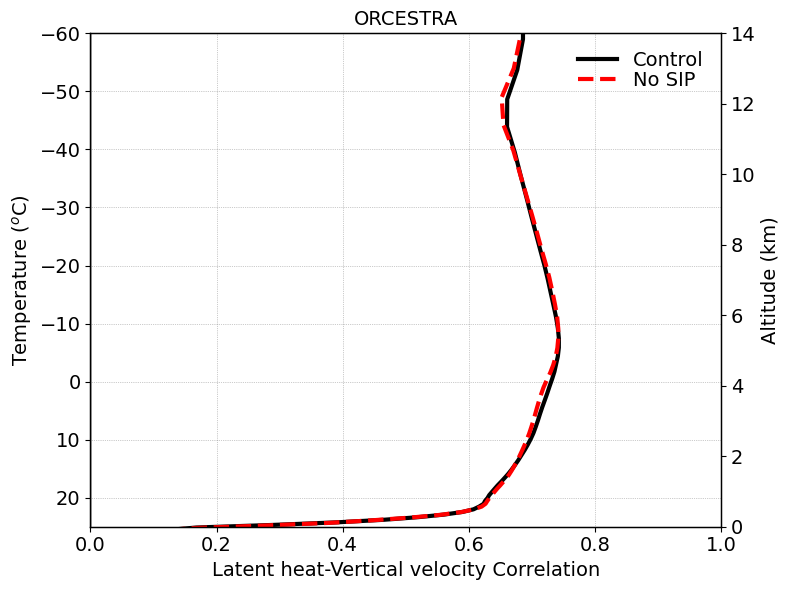

In [11]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)

plt1.plot(corr_lhr_wvel_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(corr_lhr_wvel_nosip, mean_tempc_nosip, '-', color='none', linewidth=lnwdth)

plt1.set_xlim(0., 1)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Latent heat-Vertical velocity Correlation', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


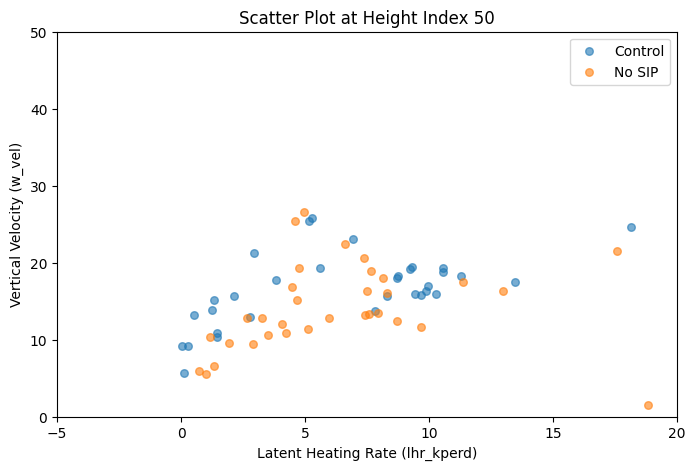

In [13]:
import numpy as np
import matplotlib.pyplot as plt

z_idx = 50  # Example: use height index 10 (choose relevant layer for your case)

# Flatten time and ncells for the selected height
lh_4sip = ds_4sip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_4sip = ds_4sip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()
lh_nosip = ds_nosip['lhr_kperd'][:, :z_idx, :].mean(dim=('height','ncells')).values.flatten()
w_nosip = ds_nosip['w_vel'][:, :z_idx, :].max(dim=('height','ncells')).values.flatten()

# Optional: mask invalid data
mask_4sip = (~np.isnan(lh_4sip)) & (~np.isnan(w_4sip))
mask_nosip = (~np.isnan(lh_nosip)) & (~np.isnan(w_nosip))

plt.figure(figsize=(8, 5))
plt.scatter(lh_4sip[mask_4sip], w_4sip[mask_4sip], s=30, alpha=0.6, label='Control')
plt.scatter(lh_nosip[mask_nosip], w_nosip[mask_nosip], s=30, alpha=0.6, label='No SIP')

plt.xlim(-5,20)
plt.ylim(0,50)
plt.xlabel('Latent Heating Rate (lhr_kperd)')
plt.ylabel('Vertical Velocity (w_vel)')
plt.title('Scatter Plot at Height Index {}'.format(z_idx))
plt.legend()
plt.show()


In [14]:
from sklearn.linear_model import LinearRegression

def fit_slope(x, y):
    mask = (~np.isnan(x)) & (~np.isnan(y))
    x_ = x[mask].reshape(-1, 1)
    y_ = y[mask]
    model = LinearRegression()
    model.fit(x_, y_)
    slope = model.coef_[0]
    intercept = model.intercept_
    r2 = model.score(x_, y_)
    return slope, intercept, r2

slope_4sip, intercept_4sip, r2_4sip = fit_slope(lh_4sip, w_4sip)
slope_nosip, intercept_nosip, r2_nosip = fit_slope(lh_nosip, w_nosip)

print(f"SIP run:    Slope = {slope_4sip:.4f},  Intercept = {intercept_4sip:.4f},  R² = {r2_4sip:.3f}")
print(f"No SIP run: Slope = {slope_nosip:.4f},  Intercept = {intercept_nosip:.4f},  R² = {r2_nosip:.3f}")


SIP run:    Slope = 0.3677,  Intercept = 13.5829,  R² = 0.428
No SIP run: Slope = 0.4109,  Intercept = 11.4918,  R² = 0.470


In [17]:

lhr_4sip = ds_4sip['lhr_kperd'].values 
wvel_4sip = ds_4sip['w_vel'].values
ntime, nheight, ncells = lhr_4sip.shape

corr_lhr_wvel_4sip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_4sip[t, z, :].flatten()
        w_flat = wvel_4sip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_4sip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



lhr_nosip = ds_nosip['lhr_kperd'].values 
wvel_nosip = ds_nosip['w_vel'].values
ntime, nheight, ncells = lhr_nosip.shape

corr_lhr_wvel_nosip = np.full((ntime, nheight), np.nan)

for t in range(ntime):
    for z in range(nheight):
        lh_flat = lhr_nosip[t, z, :].flatten()
        w_flat = wvel_nosip[t, z, :].flatten()
        mask = (~np.isnan(lh_flat)) & (~np.isnan(w_flat))
        if np.sum(mask) > 10:  # at least 10 valid points
            corr_lhr_wvel_nosip[t, z], _ = pearsonr(lh_flat[mask], w_flat[mask])



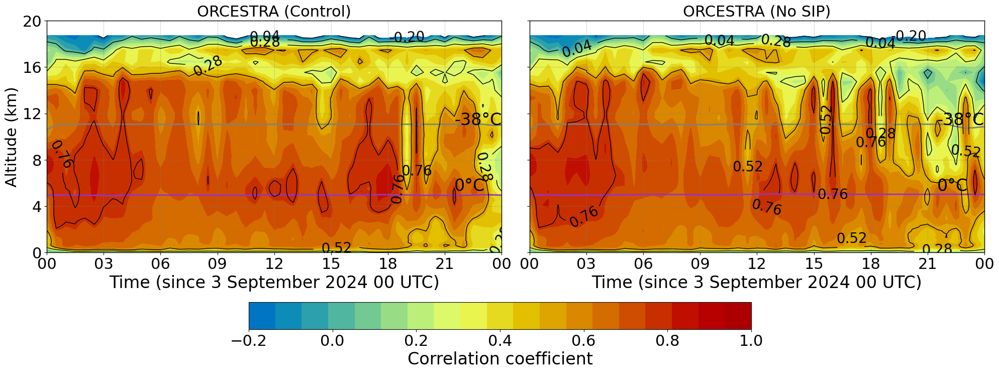

In [18]:

import matplotlib.lines as mlines

fnt=22;
fnt1=22;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-0.2, 1, 20)
#lev1 = np.linspace(1, 1200, 20)
#lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, corr_lhr_wvel_4sip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.0, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt+2)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 20)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks([0, 4, 8, 12, 16, 20], fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 1, 6)
#contour_levels = np.linspace(1, 1200, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, corr_lhr_wvel_nosip.T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-0.2, 0, 0.2, 0.4, 0.6, 0.8, 1], orientation='horizontal')
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[1, 1000, 2000, 3000, 4000], orientation='horizontal')#, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Correlation coefficient', fontsize=fnt+2)
cbar.ax.tick_params(labelsize=fnt)

plt.tight_layout()
plt.show()


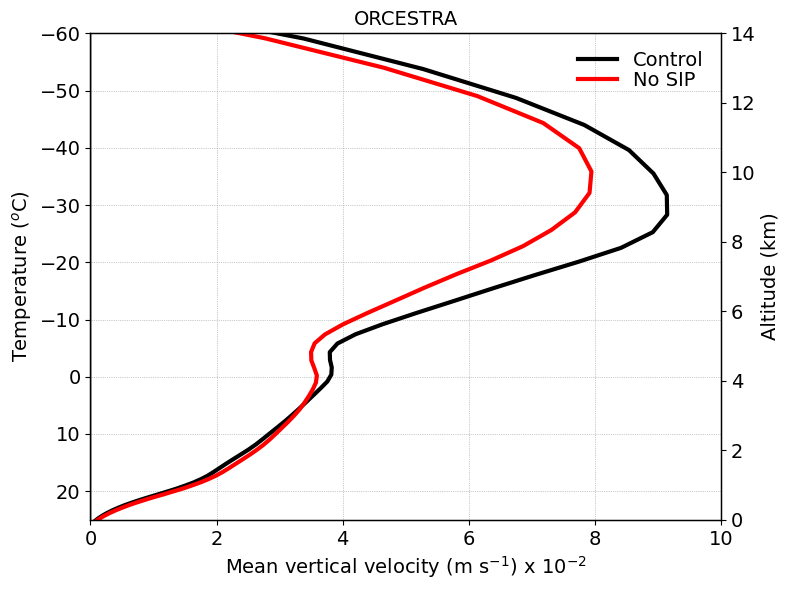

In [33]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

fac=100.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(fac*ds_4sip.w_vel.mean(dim=('time','ncells')), mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(fac*ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.w_vel.mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0., 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Mean vertical velocity (m s$^{-1}$) x 10$^{-2}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Radiative heating rates

In [11]:

# Radiative heating rate with SIP

dims1 = ds_4sip.tempc.dims
dims2 = ds_4sip.tempc.mean(dim=('time','ncells')).dims
temp_radsw_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.ddt_temp_radsw, axis=0) # w.r.t. time
temp_radsw_kperd_4sip = temp_radsw_kpers_4sip * 86400.
mean_temp_radsw_kperd_4sip = np.mean(temp_radsw_kperd_4sip, axis=(0,2))
ds_4sip['temp_radsw_kpers'] = (dims1, temp_radsw_kpers_4sip)
ds_4sip['temp_radsw_kperd'] = (dims1, temp_radsw_kperd_4sip)

dims1 = ds_4sip.tempc.dims
dims2 = ds_4sip.tempc.mean(dim=('time','ncells')).dims
temp_radlw_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.ddt_temp_radlw, axis=0) # w.r.t. time
temp_radlw_kperd_4sip = temp_radlw_kpers_4sip * 86400.
mean_temp_radlw_kperd_4sip = np.mean(temp_radlw_kperd_4sip, axis=(0,2))
ds_4sip['temp_radlw_kpers'] = (dims1, temp_radlw_kpers_4sip)
ds_4sip['temp_radlw_kperd'] = (dims1, temp_radlw_kperd_4sip)

ds_4sip['tot_radhet_kperd'] = ds_4sip.temp_radsw_kperd+ds_4sip.temp_radlw_kperd
ds_4sip['tot_radhet_kpers'] = ds_4sip.temp_radsw_kpers+ds_4sip.temp_radlw_kpers

# Radiative heating rate with No SIP

dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
temp_radsw_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.ddt_temp_radsw, axis=0) # w.r.t. time
temp_radsw_kperd_nosip = temp_radsw_kpers_nosip * 86400.
mean_temp_radsw_kperd_nosip = np.mean(temp_radsw_kperd_nosip, axis=(0,2))
ds_nosip['temp_radsw_kpers'] = (dims1, temp_radsw_kpers_nosip)
ds_nosip['temp_radsw_kperd'] = (dims1, temp_radsw_kperd_nosip)

dims1 = ds_nosip.tempc.dims
dims2 = ds_nosip.tempc.mean(dim=('time','ncells')).dims
temp_radlw_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.ddt_temp_radlw, axis=0) # w.r.t. time
temp_radlw_kperd_nosip = temp_radlw_kpers_nosip * 86400.
mean_temp_radlw_kperd_nosip = np.mean(temp_radlw_kperd_nosip, axis=(0,2))
ds_nosip['temp_radlw_kpers'] = (dims1, temp_radlw_kpers_nosip)
ds_nosip['temp_radlw_kperd'] = (dims1, temp_radlw_kperd_nosip)

ds_nosip['tot_radheat_kperd'] = ds_nosip.temp_radsw_kperd+ds_nosip.temp_radlw_kperd
ds_nosip['tot_radheat_kpers'] = ds_nosip.temp_radsw_kpers+ds_nosip.temp_radlw_kpers


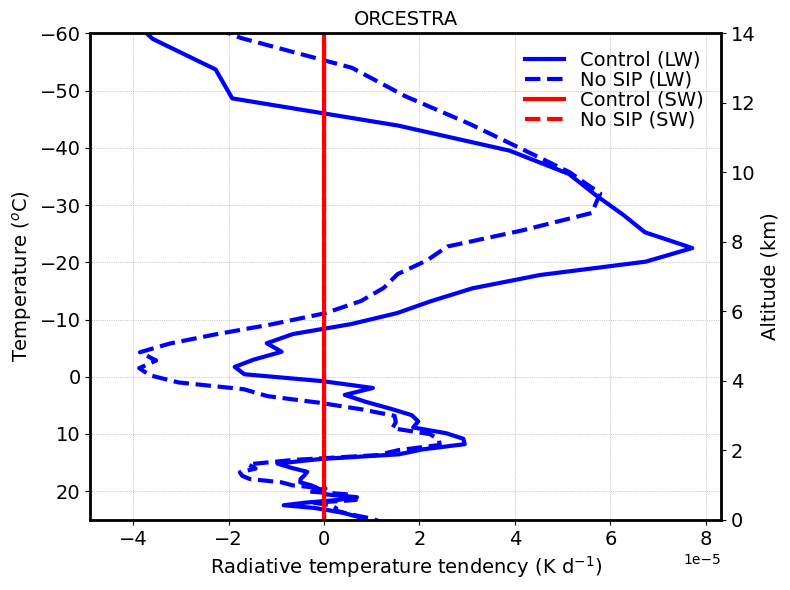

In [46]:

fontsize=14;
lnwdth=3;
alpha=0.8;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(ds_4sip.temp_radlw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Control (LW)')
plt1.plot(ds_nosip.temp_radlw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, 'b--', linewidth=lnwdth, label='No SIP (LW)')
plt1.plot(ds_4sip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Control (SW)')
plt1.plot(ds_nosip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, 'r--', linewidth=lnwdth, label='No SIP (SW)')


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(ds_nosip.temp_radsw_kperd.sel(time=slice(start_time, end_time)).mean(dim=('time','ncells')), mean_tempc_nosip, '-', color='none', linewidth=lnwdth)#, label='No SB')

#plt1.set_xlim(-40., 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Radiative temperature tendency (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [ ]:
ttend_lw_4sip

## Standardised regression coefficient

#### A standardized regression coefficient tells How many standard deviations the target variable (y, here TOA net flux)
#### changes for one standard deviation change in the predictor (x_i), holding other variables constant.

In [23]:
from sklearn.ensemble import RandomForestRegressor  # ✅ Required import
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


start_time='2024-09-03T00:00:00.000000000';
end_time='2024-09-04T00:00:00.000000000';

# Set TOA index
toa_idx = 0

# Extract variables without collapsing time/ncells — preserve data points
clcl_4sip = ds_4sip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_4sip = ds_4sip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_4sip = ds_4sip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_4sip = ds_4sip['clct'].sel(time=slice(start_time, end_time))                                  # (time, ncells)
qc_4sip = ds_4sip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_4sip = ds_4sip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_4sip = ds_4sip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

clcl_nosip = ds_nosip['clcl'].sel(time=slice(start_time, end_time)).squeeze(dim='plev')               # (time, ncells)
clcm_nosip = ds_nosip['clcm'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_2')             # (time, ncells)
clch_nosip = ds_nosip['clch'].sel(time=slice(start_time, end_time)).squeeze(dim='plev_3')             # (time, ncells)
clct_nosip = ds_nosip['clct'].sel(time=slice(start_time, end_time))                                   # (time, ncells)
qc_nosip = ds_nosip['qc'].sel(time=slice(start_time, end_time)).mean('height')#isel(height=0)                        # (time, ncells)
qi_nosip = ds_nosip['qi'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)
qs_nosip = ds_nosip['qs'].sel(time=slice(start_time, end_time)).isel(height=0)                        # (time, ncells)

# Compute TOA net flux
net_flux_4sip = (
    (ds_4sip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_4sip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_4sip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_4sip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

net_flux_nosip = (
    (ds_nosip['swflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['swflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['swflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) +
    (ds_nosip['lwflx_dn'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx)) -
    (ds_nosip['lwflx_dn_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx) - ds_nosip['lwflx_up_clr'].sel(time=slice(start_time, end_time)).isel(height_2=toa_idx))
)

# Build dataframe (flatten all variables)
df_4sip = pd.DataFrame({
    'clcl': clcl_4sip.values.flatten(),
    'clcm': clcm_4sip.values.flatten(),
    'clch': clch_4sip.values.flatten(),
    'clct': clct_4sip.values.flatten(),
    'qc': qc_4sip.values.flatten(),
    'qi': qi_4sip.values.flatten(),
    'qs': qs_4sip.values.flatten(),
    'net_flux': net_flux_4sip.values.flatten()
})

df_nosip = pd.DataFrame({
    'clcl': clcl_nosip.values.flatten(),
    'clcm': clcm_nosip.values.flatten(),
    'clch': clch_nosip.values.flatten(),
    'clct': clct_nosip.values.flatten(),
    'qc': qc_nosip.values.flatten(),
    'qi': qi_nosip.values.flatten(),
    'qs': qs_nosip.values.flatten(),
    'net_flux': net_flux_nosip.values.flatten()
})

# Drop missing values
df_4sip = df_4sip.dropna()
df_nosip = df_nosip.dropna()

# Prepare X and y for regression
X_4sip = df_4sip.drop('net_flux', axis=1).values
y_4sip = df_4sip['net_flux'].values

X_nosip = df_nosip.drop('net_flux', axis=1).values
y_nosip = df_nosip['net_flux'].values

# Standardize predictors
scaler_4sip = StandardScaler()
X_4sip_scaled = scaler_4sip.fit_transform(X_4sip)

scaler_nosip = StandardScaler()
X_nosip_scaled = scaler_nosip.fit_transform(X_nosip)

# Fit regression model
model_4sip = LinearRegression()
model_4sip.fit(X_4sip_scaled, y_4sip)

model_nosip = LinearRegression()
model_nosip.fit(X_nosip_scaled, y_nosip)

# Plot standardized coefficients
coefs_4sip = model_4sip.coef_
features_4sip = df_4sip.drop('net_flux', axis=1).columns

coefs_nosip = model_nosip.coef_
features_nosip = df_nosip.drop('net_flux', axis=1).columns



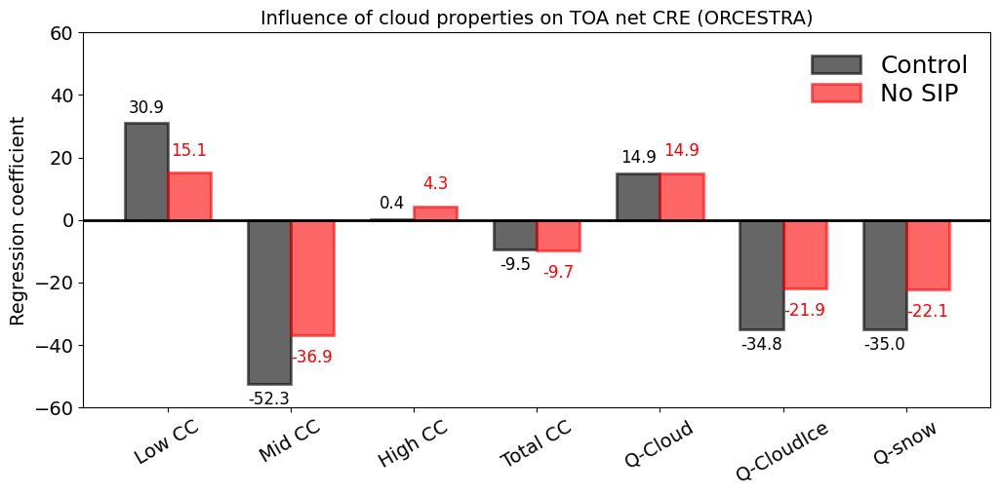

In [24]:

comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-CloudIce', 'Q-snow']

x_feature = np.arange(len(features_4sip))  # base x locations
width = 0.35
alp=0.6;

fnt=14;
ln=2;

fig, ax = plt.subplots(figsize=(12, 5))#, sharey=False)
plt.style.use('default')

#ax1 = axs[0]

ax.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax.bar(x_feature - width/2, coefs_4sip, width, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax.bar(x_feature + width/2, coefs_nosip, width, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax.bar_label(rects2, padding=10, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax.set_ylim(-60, 60)
ax.set_ylabel('Regression coefficient', fontsize=fnt)
ax.set_xticks(x_feature)
ax.set_xticklabels(comp_groups, rotation=30)
ax.set_title('Influence of cloud properties on TOA net CRE (ORCESTRA)', fontsize=fnt)
ax.tick_params(axis='both', labelsize=fnt)

ax.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=1, fontsize=fnt+4, loc='best')

plt.show()

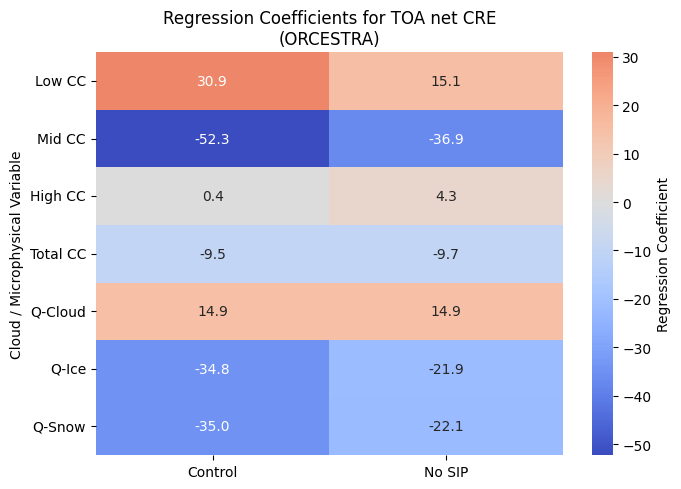

In [25]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Example coefficients
features = ['Low CC', 'Mid CC', 'High CC', 'Total CC', 'Q-Cloud', 'Q-Ice', 'Q-Snow']


# Create DataFrame for heatmap
df_heat = pd.DataFrame({
    'Control': coefs_4sip,
    'No SIP': coefs_nosip
}, index=features)

# Plot heatmap
plt.figure(figsize=(7, 5))
sns.heatmap(df_heat, annot=True, cmap='coolwarm', center=0, fmt='.1f',
            cbar_kws={'label': 'Regression Coefficient'})

plt.title('Regression Coefficients for TOA net CRE\n(ORCESTRA)')
plt.ylabel('Cloud / Microphysical Variable')
plt.tight_layout()
plt.show()


In [32]:

mean_cond_lhr_4sip = ds_4sip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_4sip = ds_4sip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_4sip = ds_4sip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_4sip = ds_4sip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_4sip = ds_4sip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_4sip = ds_4sip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_4sip = ds_4sip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_4sip.evap_lhr_kperd.mean(dim=('time','ncells')).values

mean_cond_lhr_nosip = ds_nosip.cond_lhr_kperd.mean(dim=('time','ncells')).values
mean_satad_lhr_nosip = ds_nosip.satad_lhr_kperd.mean(dim=('time','ncells')).values
mean_dep_lhr_nosip = ds_nosip.dep_lhr_kperd.mean(dim=('time','ncells')).values
mean_rime_lhr_nosip = ds_nosip.rime_lhr_kperd.mean(dim=('time','ncells')).values
mean_rainfreez_lhr_nosip = ds_nosip.rainfreez_lhr_kperd.mean(dim=('time','ncells')).values
mean_homhet_lhr_nosip = ds_nosip.homhet_lhr_kperd.mean(dim=('time','ncells'))
mean_melt_evap_lhr_nosip = ds_nosip.melt_lhr_kperd.mean(dim=('time','ncells')).values + ds_nosip.evap_lhr_kperd.mean(dim=('time','ncells')).values


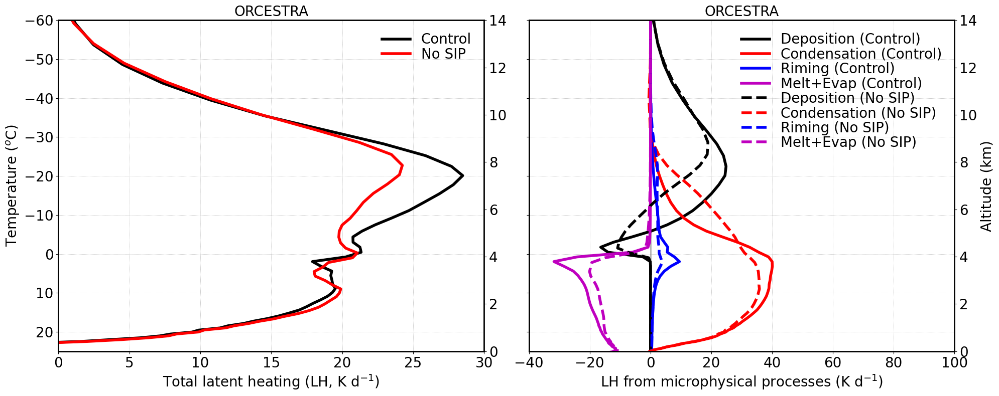

In [60]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Control')
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='No SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 5, 10, 15, 20, 25, 30])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating (LH, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dep_lhr_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Deposition (Control)')
plt1.plot(mean_satad_lhr_4sip, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Condensation (Control)')
plt1.plot(mean_rime_lhr_4sip, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Riming (Control)')
plt1.plot(mean_melt_evap_lhr_4sip, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Melt+Evap (Control)')
#plt1.plot(mean_cond_lhr_4sip, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='CCN activation (Control)')

plt1.plot(mean_dep_lhr_nosip, mean_tempc_nosip, 'k--', linewidth=lnwdth, label='Deposition (No SIP)')
plt1.plot(mean_satad_lhr_nosip, mean_tempc_nosip, 'r--', linewidth=lnwdth, label='Condensation (No SIP)')
plt1.plot(mean_rime_lhr_nosip, mean_tempc_nosip, 'b--', linewidth=lnwdth, label='Riming (No SIP)')
plt1.plot(mean_melt_evap_lhr_nosip, mean_tempc_nosip, 'm--', linewidth=lnwdth, label='Melt+Evap (No SIP)')
#plt1.plot(mean_cond_lhr_nosip, mean_tempc_nosip, 'g--', linewidth=lnwdth, label='CCN activation (No SIP)')

plt2.plot(mean_cond_lhr_4sip, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-40., 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-40, -20, 0, 20, 40, 60, 80, 100])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.set_yticks([])
#plt1.set_gca().axes.xaxis.set_ticklabels([])
plt1.yaxis.set_ticklabels([])

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='upper right')

plt1.set_xlabel('LH from microphysical processes (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


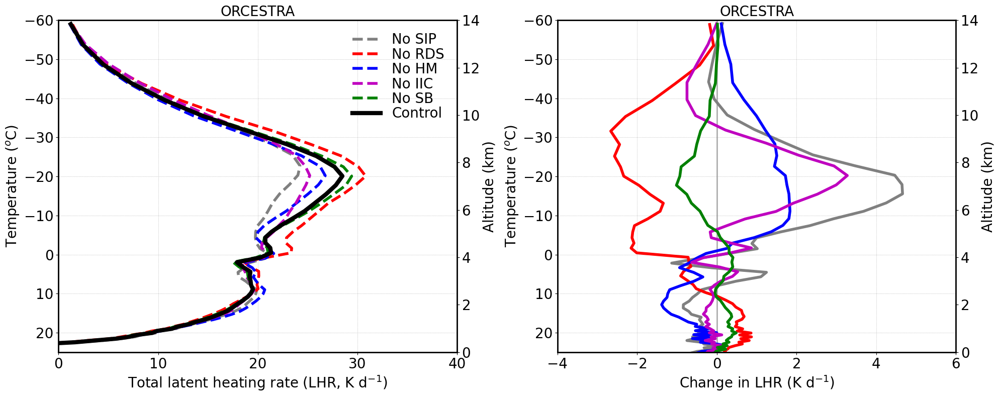

In [16]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.style.use('default')

plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0, 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(del_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4., 6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-4, -2, 0, 2, 4, 6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('Change in LHR (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


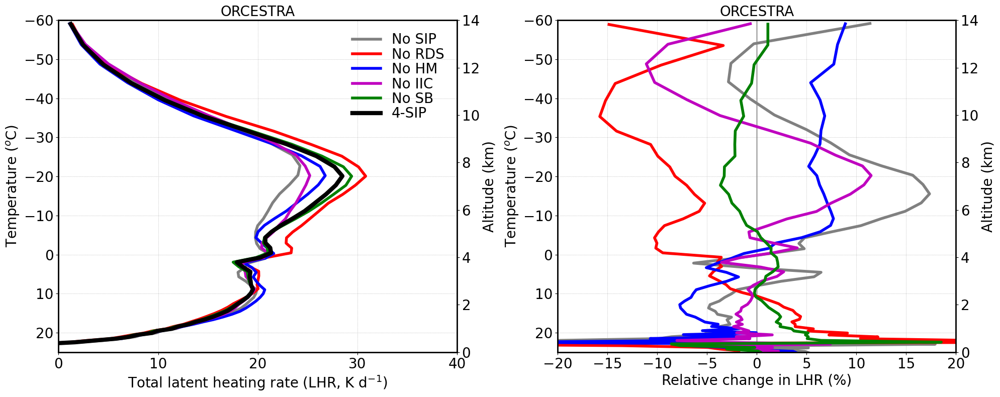

In [39]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(0., 40)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 10, 20, 30, 40])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('Total latent heating rate (LHR, K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_lhr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_lhr_kperd_nosb, mean_tempc_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20., 20)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-3, -2, -1, 0, 1])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('Relative change in LHR (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [ ]:
plt.plot(mean_tempc_nosip, ds_nosip.height, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.grid()
plt.xlim(-70,30);
plt.xticks([-70, -60, -50, -40, -30, -20, -10, 0, 10, 20, 30]);
plt.ylim(10, 30)

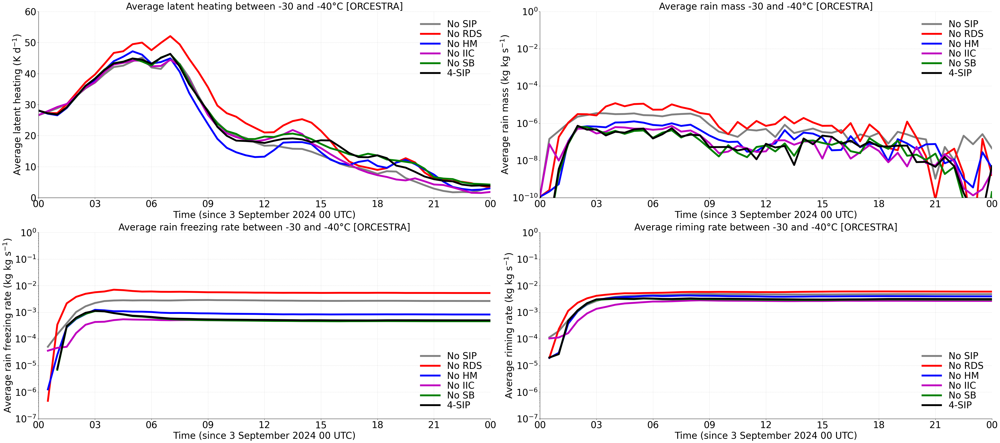

In [23]:

thres_q = 1.e-8;

## Latent heating
mean_lhr_min35_nosip = ds_nosip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_lhr_min35_4sip = ds_4sip.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_norf = ds_norf.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nohm = ds_nohm.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nobr = ds_nobr.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_lhr_min35_nosb = ds_nosb.lhr_kperd.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Rain mass
mean_qr_min35_nosip = ds_nosip.qr.sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_qr_min35_4sip = ds_4sip.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_norf = ds_norf.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nohm = ds_nohm.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nobr = ds_nobr.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))
mean_qr_min35_nosb = ds_nosb.qr.sel(height=slice(14, 16)).mean(dim=('ncells','height'))

## Riming rate
mean_dq_tot_rime_min35_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))
mean_dq_tot_rime_min35_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

## Rain freezing rate
sum_dq = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_min35_4sip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_min35_nosip = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_min35_norf = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_min35_nohm = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_min35_nobr = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))

sum_dq = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf
mean_dq_rainfreez_min35_nosb = xr.where(sum_dq > thres_q, sum_dq, np.nan).sel(height=slice(14, 16)).mean(dim=('height','ncells'))


plt.figure(figsize=(45, 20))

lnwdth=6
fontsize=30

plt.subplot(2,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_lhr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_lhr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_lhr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_lhr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_lhr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_lhr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0,60)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average latent heating (K d$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average latent heating between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_qr_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_qr_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_qr_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_qr_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_qr_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_qr_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-10,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain mass (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain mass -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(2,2,3)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_rainfreez_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_rainfreez_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_rainfreez_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_rainfreez_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_rainfreez_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_rainfreez_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average rain freezing rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average rain freezing rate between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)




plt.subplot(2,2,4)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, mean_dq_tot_rime_min35_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, mean_dq_tot_rime_min35_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, mean_dq_tot_rime_min35_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, mean_dq_tot_rime_min35_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, mean_dq_tot_rime_min35_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, mean_dq_tot_rime_min35_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.yscale('log')
plt.xlim(start_date, end_date)
plt.ylim(1.e-7,1.e0)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Average riming rate (kg kg s$^{-1}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Average riming rate between -30 and -40°C [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()

In [12]:

mask = (ds_4sip.tempc > -0.2) & (ds_4sip.tempc < 0.)
mean_freez_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_4sip.tempc > -38.2) & (ds_4sip.tempc < -38.)
mean_hom_lev_4sip = 1.e-3*(ds_4sip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosip.tempc > -0.2) & (ds_nosip.tempc < 0.)
mean_freez_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosip.tempc > -38.2) & (ds_nosip.tempc < -38.)
mean_hom_lev_nosip = 1.e-3*(ds_nosip.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_norf.tempc > -0.2) & (ds_norf.tempc < 0.)
mean_freez_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_norf.tempc > -38.2) & (ds_norf.tempc < -38.)
mean_hom_lev_norf = 1.e-3*(ds_norf.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nohm.tempc > -0.2) & (ds_nohm.tempc < 0.)
mean_freez_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nohm.tempc > -38.2) & (ds_nohm.tempc < -38.)
mean_hom_lev_nohm = 1.e-3*(ds_nohm.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nobr.tempc > -0.2) & (ds_nobr.tempc < 0.)
mean_freez_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nobr.tempc > -38.2) & (ds_nobr.tempc < -38.)
mean_hom_lev_nobr = 1.e-3*(ds_nobr.z_mc.where(mask)).mean(dim=('height','ncells'))

mask = (ds_nosb.tempc > -0.2) & (ds_nosb.tempc < 0.)
mean_freez_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))
mask = (ds_nosb.tempc > -38.2) & (ds_nosb.tempc < -38.)
mean_hom_lev_nosb = 1.e-3*(ds_nosb.z_mc.where(mask)).mean(dim=('height','ncells'))



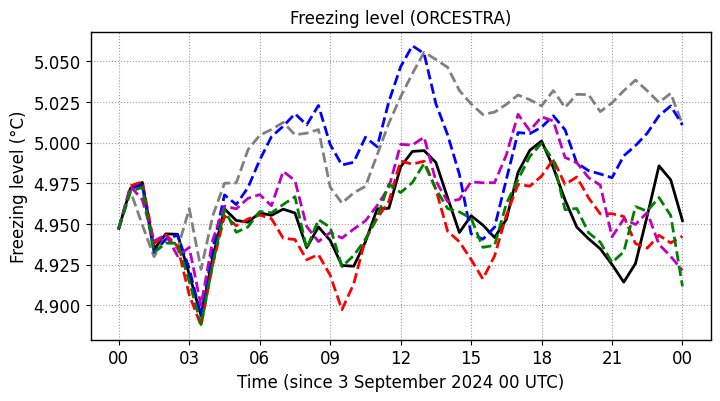

In [12]:
fnt=12;
ln=2;
plt.figure(figsize=(8,4))
plt.style.use('default')

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'k-', linewidth=ln, label='Control')
plt.plot(ds_nosip.time, mean_freez_lev_nosip, '--', color='grey', linewidth=ln, label='No SIP')
plt.plot(ds_norf.time, mean_freez_lev_norf, 'r--', linewidth=ln, label='No RDS')
plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln, label='No HM')
plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'm--', linewidth=ln, label='No IIC')
plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'g--', linewidth=ln, label='No SB')

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
#plt.ylim(3.6, 4.4)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Freezing level (°C)', fontsize=fnt)
plt.title('Freezing level (ORCESTRA)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

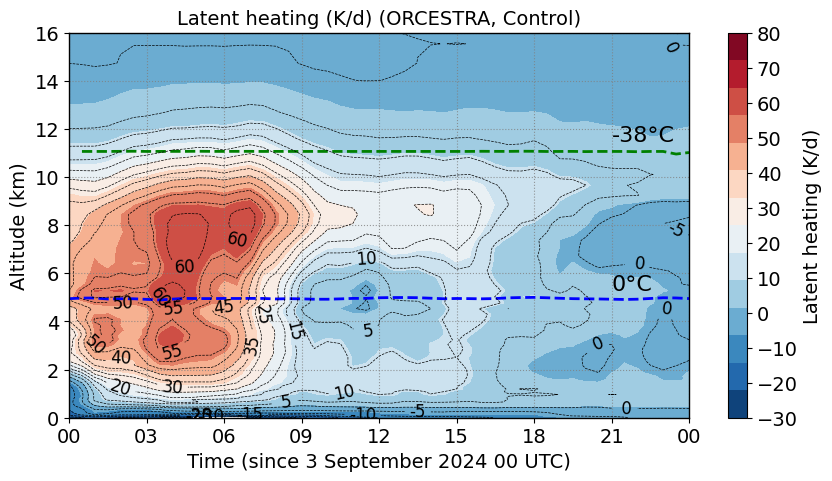

In [26]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, 'b--', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, 'g--', linewidth=ln)

plt.text(ds_4sip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

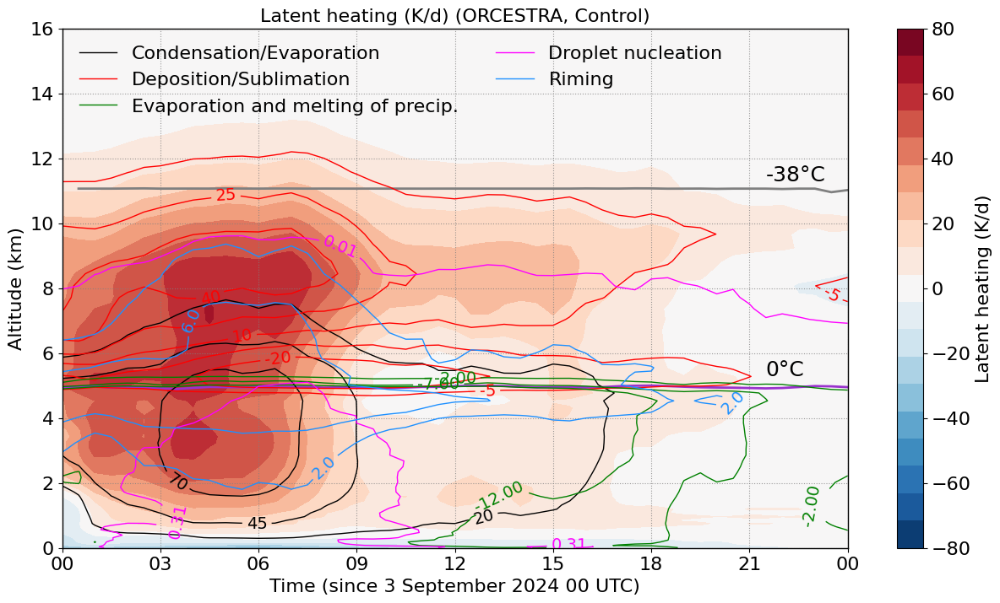

In [14]:

import matplotlib.lines as mlines

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=16;
ln=2;
ln1=1.;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, ncols=2, loc='upper left')



#contour_levels = np.arange(-30, 80.5, 25)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

#legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation')#Saturation adjustment')

#contour_levels = np.arange(-20, 40.5, 15)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

#legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition')

#contour_levels = np.arange(0.01, 1.5, 0.3)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, colors='magenta', levels=contour_levels, linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

#legend_proxy3 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Nucleation')

#contour_levels = np.arange(-6, 6.5, 4)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

#legend_proxy4 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

#contour_levels = np.arange(-12, 0., 5)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
#                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

#legend_proxy5 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation+Melting')

#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt, ncols=2, loc='best')

#contour_levels = np.arange(0.01, 0.5, 0.3)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.homhet_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='m', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

#legend_proxy5 = mlines.Line2D([], [], color='m', linestyle='-', linewidth=ln1, label='Hom+Het')

#contour_levels = np.arange(0.01, 5.02, 1)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rainfreez_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='grey', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

#legend_proxy6 = mlines.Line2D([], [], color='grey', linestyle='-', linewidth=ln1, label='Rain freezing')

#contour_levels = np.arange(-12, 0., 5)
#contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='cyan', linestyles='-', linewidths=ln1)
#plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

#legend_proxy7 = mlines.Line2D([], [], color='cyan', linestyle='-', linewidth=ln1, label='Evaporation')

#plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5, legend_proxy6, legend_proxy7, legend_proxy8], frameon=False, fontsize=fnt, loc='best')



for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


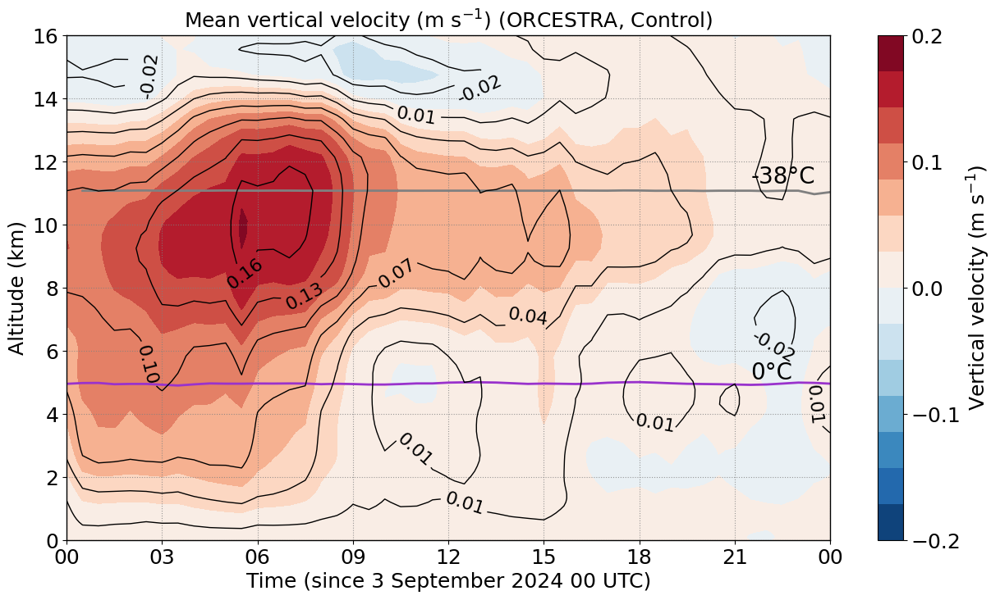

In [18]:

import matplotlib.lines as mlines


fnt=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-0.2, 0.2, 15)

plt.figure(figsize=(15, 8))
plt.style.use('default')

cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Vertical velocity (m s$^{-1}$)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.1, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Mean vertical velocity (m s$^{-1}$) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-0.2, 0.2, 0.03)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln2)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


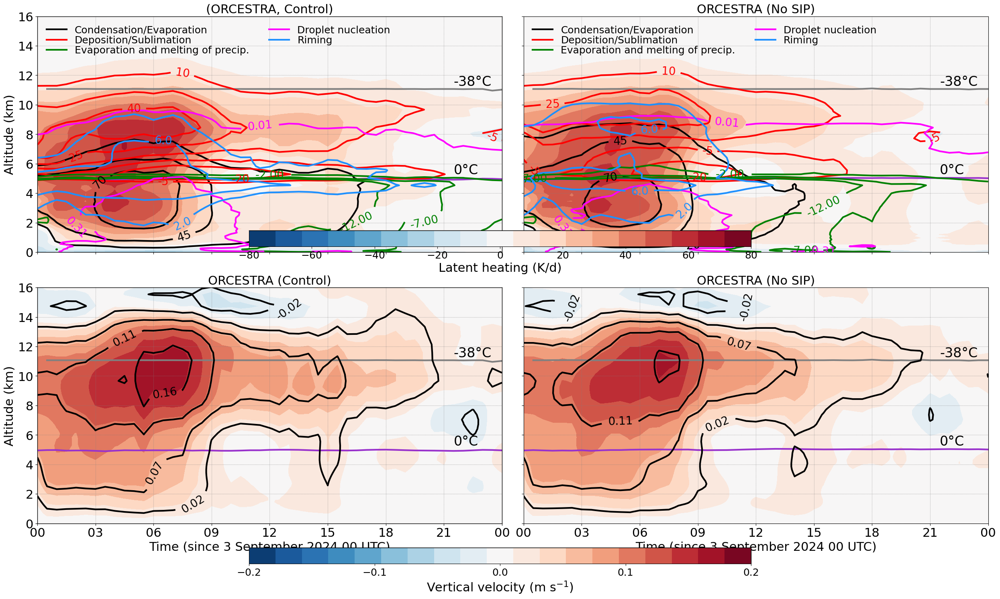

In [15]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=22;
fnt1=18;
ln=3;
ln1=3.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

fig = plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt1=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('(ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt2=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt2, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

cbar_ax1 = fig.add_axes([0.25, 0.69, 0.5, 0.02])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt2, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating (K/d)', fontsize=fnt)
cbar1.ax.tick_params(labelsize=fnt1)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


#fig = plt.gcf()  # Get the current figure
#cbar_ax = fig.add_axes([0.25, -0.05, 0.5, 0.04])  # [left, bottom, width, height]
#cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80], orientation='horizontal')
#cbar.set_label('Latent heating (K/d)', fontsize=fnt)
#cbar.ax.tick_params(labelsize=fnt1+2)

plt.subplot(3,2,3)
cnt3=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-0.2, 0.2, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt4=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt4, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Vertical velocity (m s$^{-1}$)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-0.2, 0.2, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')


cbar_ax2 = fig.add_axes([0.25, 0.295, 0.5, 0.02])  # [left, bottom, width, height]
cbar2 = fig.colorbar(cnt4, cax=cbar_ax2, orientation='horizontal', ticks=[-0.2, -0.1, 0, 0.1, 0.2])
cbar2.set_label('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
cbar2.ax.tick_params(labelsize=fnt1)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.tight_layout()
plt.show()


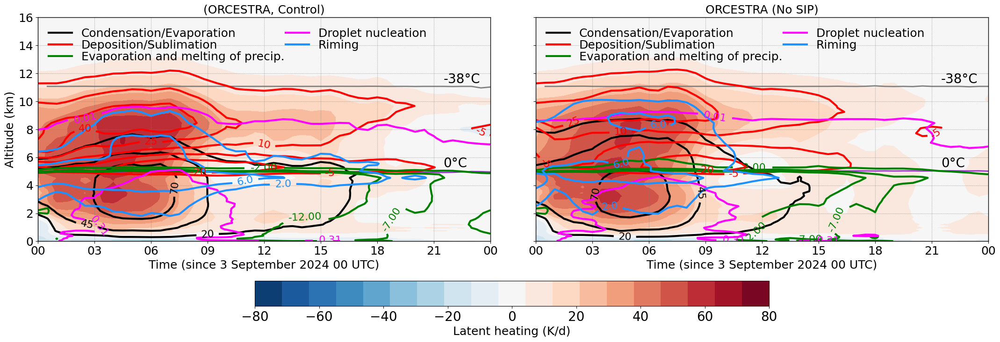

In [42]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=18;
fnt1=18;
ln=2;
ln1=3.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-80, 80, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(22, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('(ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, columnspacing=0.1,  loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt2, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, columnspacing=0.1,  loc='upper left')


for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
cbar1.set_label('Latent heating (K/d)', fontsize=fnt)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


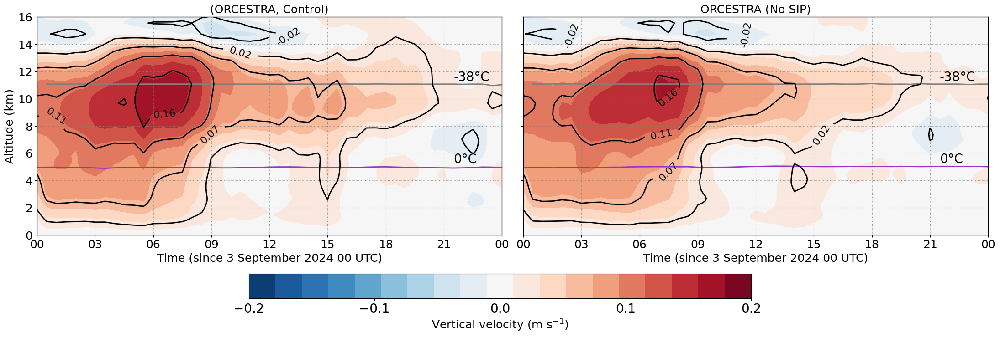

In [37]:

import matplotlib.lines as mlines
import matplotlib.gridspec as gridspec

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-0.2, 0.2, 20)
lev2 = np.linspace(-0.2, 0.2, 20)

plt.figure(figsize=(22, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('(ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-0.2, 0.2, 10)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.mean(dim=('ncells')).T, levels=lev1, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt2, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-0.2, 0.2, 10)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.w_vel.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()
cbar_ax1 = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar1 = fig.colorbar(cnt, cax=cbar_ax1, orientation='horizontal', ticks=[-0.2, -0.1, 0, 0.1, 0.2])
cbar1.set_label('Vertical velocity (m s$^{-1}$)', fontsize=fnt)
cbar1.ax.tick_params(labelsize=fnt+2)

plt.tight_layout()
plt.show()


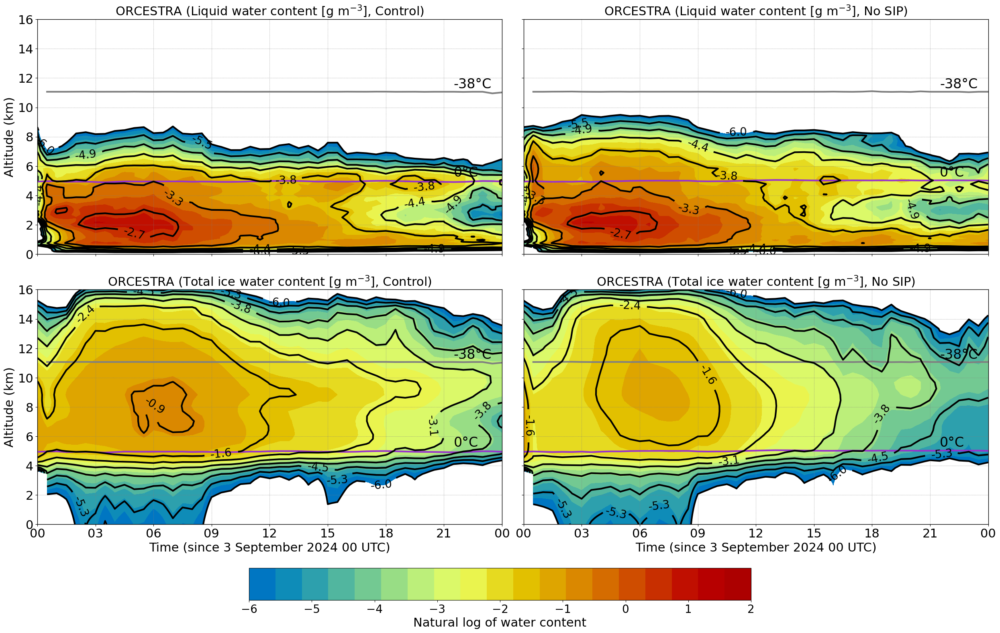

In [18]:

import matplotlib.lines as mlines

fnt=22;
fnt1=18;
ln=3;
ln1=3.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-6, -2, 20)
lev2 = np.linspace(-6, 2, 20)
plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Liquid water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-6, 0, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of LWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Liquid water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-6, 0, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.lwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-0.2, -0.1, 0, 0.1, 0.2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total ice water content [g m$^{-3}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-6, 2, 12)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=lev2, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-6, -4, -2, 0, 2])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total IWC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
#plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (Total ice water content [g m$^{-3}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-6, 2, 12)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.tiwc_gperm3.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, 0.25, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-6, -5, -4, -3, -2, -1, 0, 1, 2], orientation='horizontal')
cbar.set_label('Natural log of water content', fontsize=fnt)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()


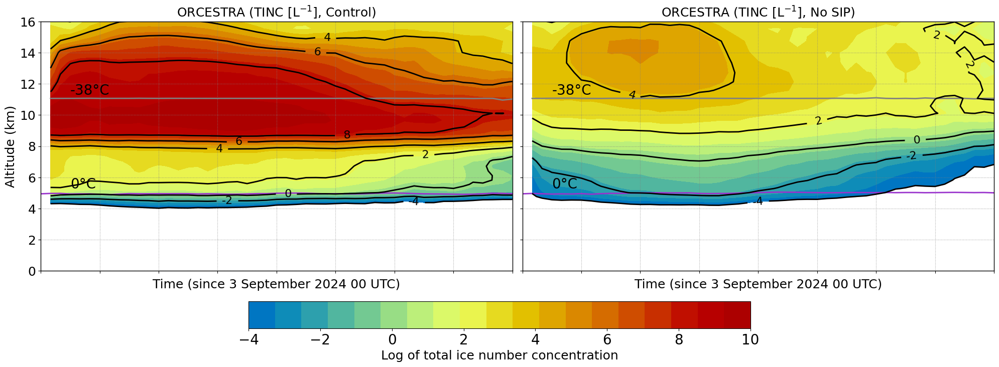

In [26]:

import matplotlib.lines as mlines

fnt=18;
fnt1=18;
ln=2;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev1 = np.linspace(-4, 10, 20)
lev2 = np.linspace(-4, 10, 20)
plt.figure(figsize=(20, 6))
plt.style.use('default')

plt.subplot(1,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (TINC [L$^{-1}$], Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, np.log(ds_4sip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(1,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=lev1, cmap='HomeyerRainbow')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Natural log of Total INC', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[3], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[3], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (TINC [L$^{-1}$], No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.linspace(-4, 10, 8)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, np.log(ds_nosip.inc_perl.mean(dim=('ncells')).T), levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.1, 0.5, 0.09])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-4, -2, 0, 2, 4, 6, 8, 10, 12], orientation='horizontal')
cbar.set_label('Log of total ice number concentration', fontsize=fnt)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()


In [213]:
print(np.linspace(-4, 10, 9))

[-4.   -2.25 -0.5   1.25  3.    4.75  6.5   8.25 10.  ]


In [ ]:

import matplotlib.lines as mlines

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=22;
fnt1=18;
ln=3;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-80, 80, 20)

plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, '-', color='grey', linewidth=ln)

plt.text(ds_norf.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
#plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, '-', color='grey', linewidth=ln)

plt.text(ds_nohm.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,5)
cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, '-', color='grey', linewidth=ln)

plt.text(ds_nobr.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,6)
cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, '-', color='grey', linewidth=ln)

plt.text(ds_nosb.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)


contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.05, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80], orientation='horizontal')
cbar.set_label('Latent heating (K/d)', fontsize=fnt)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()


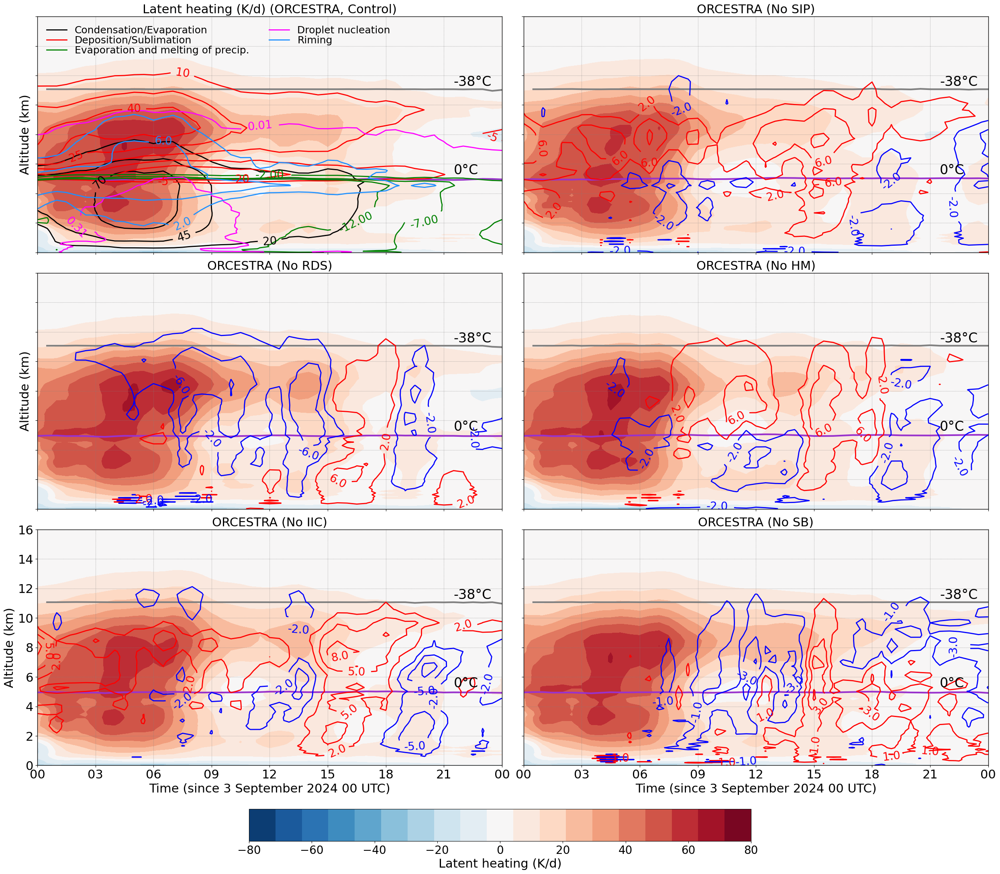

In [84]:

import matplotlib.lines as mlines

del_tot_lhr_nosip = ds_4sip.lhr_kperd-ds_nosip.lhr_kperd
del_tot_lhr_norf = ds_4sip.lhr_kperd-ds_norf.lhr_kperd
del_tot_lhr_nohm = ds_4sip.lhr_kperd-ds_nohm.lhr_kperd
del_tot_lhr_nobr = ds_4sip.lhr_kperd-ds_nobr.lhr_kperd
del_tot_lhr_nosb = ds_4sip.lhr_kperd-ds_nosb.lhr_kperd



import matplotlib.lines as mlines

mean_tot_lhr_kperd_4sip = xr.where(ds_4sip.lhr_kperd != 0., ds_4sip.lhr_kperd, np.nan).mean(dim=('ncells'))
fnt=22;
fnt1=18;
ln=3;
ln1=2.0;
ln2=1.0;
alp1=0.3;

lev = np.linspace(-80, 80, 20)

plt.figure(figsize=(25, 20))
plt.style.use('default')

plt.subplot(3,2,1)
cnt=plt.contourf(ds_4sip.time, mean_ht_4sip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_4sip.time, mean_freez_lev_4sip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_4sip.time, mean_hom_lev_4sip, '-', color='grey', linewidth=ln)

plt.text(ds_4sip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_4sip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 25)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.satad_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='k', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy1 = mlines.Line2D([], [], color='k', linestyle='-', linewidth=ln1, label='Condensation/Evaporation')#Saturation adjustment')


contour_levels = np.arange(-20, 40.5, 15)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.dep_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

legend_proxy2 = mlines.Line2D([], [], color='r', linestyle='-', linewidth=ln1, label='Deposition/Sublimation')

contour_levels = np.arange(-12, 0., 5)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.evap_lhr_kperd.mean(dim=('ncells')).T+ds_4sip.melt_lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='g', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy3 = mlines.Line2D([], [], color='g', linestyle='-', linewidth=ln1, label='Evaporation and melting of precip.')

contour_levels = np.arange(0.01, 1.5, 0.3)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.cond_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='magenta', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

legend_proxy4 = mlines.Line2D([], [], color='magenta', linestyle='-', linewidth=ln1, label='Droplet nucleation')

contour_levels = np.arange(-6, 6.5, 4)
contours = plt.contour(ds_4sip.time, mean_ht_4sip, ds_4sip.rime_lhr_kperd.mean(dim=('ncells')).T, levels=contour_levels, colors='dodgerblue', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

legend_proxy5 = mlines.Line2D([], [], color='dodgerblue', linestyle='-', linewidth=ln1, label='Riming')

plt.legend(handles=[legend_proxy1, legend_proxy2, legend_proxy3, legend_proxy4, legend_proxy5], frameon=False, fontsize=fnt1, handlelength=2, labelspacing=0.05, 
           ncols=2, loc='upper left')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,2)
cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(2, 10, 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-10, -2, 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,3)
cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, '-', color='grey', linewidth=ln)

plt.text(ds_norf.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(2, 10, 3)
contours = plt.contour(ds_norf.time, mean_ht_norf, del_tot_lhr_norf.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-10, -2, 3)
contours = plt.contour(ds_norf.time, mean_ht_norf, del_tot_lhr_norf.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,4)
cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, '-', color='grey', linewidth=ln)

plt.text(ds_nohm.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[43], 11.3, '-38°C', fontsize=fnt+2)

#plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
#start_date = datetime(2024, 9, 3, 0, 0) 
#end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_xticklabels([])
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(2, 10, 3)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, del_tot_lhr_nohm.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-10, -2, 3)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, del_tot_lhr_nohm.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,5)
cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, '-', color='grey', linewidth=ln)

plt.text(ds_nobr.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(2, 8, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, del_tot_lhr_nobr.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-8, -2, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, del_tot_lhr_nobr.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')


plt.subplot(3,2,6)
cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30])#, 25, 30])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, '-', color='grey', linewidth=ln)

plt.text(ds_nosb.time[43], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[43], 11.3, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.gca().set_yticklabels([])
#plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('ORCESTRA (No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(1, 5, 3)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, del_tot_lhr_nosb.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-5, -1, 3)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, del_tot_lhr_nosb.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

fig = plt.gcf()  # Get the current figure
cbar_ax = fig.add_axes([0.25, -0.05, 0.5, 0.04])  # [left, bottom, width, height]
cbar = fig.colorbar(cnt, cax=cbar_ax, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80], orientation='horizontal')
cbar.set_label('Latent heating (K/d)', fontsize=fnt)
cbar.ax.tick_params(labelsize=fnt1+2)

plt.tight_layout()
plt.show()




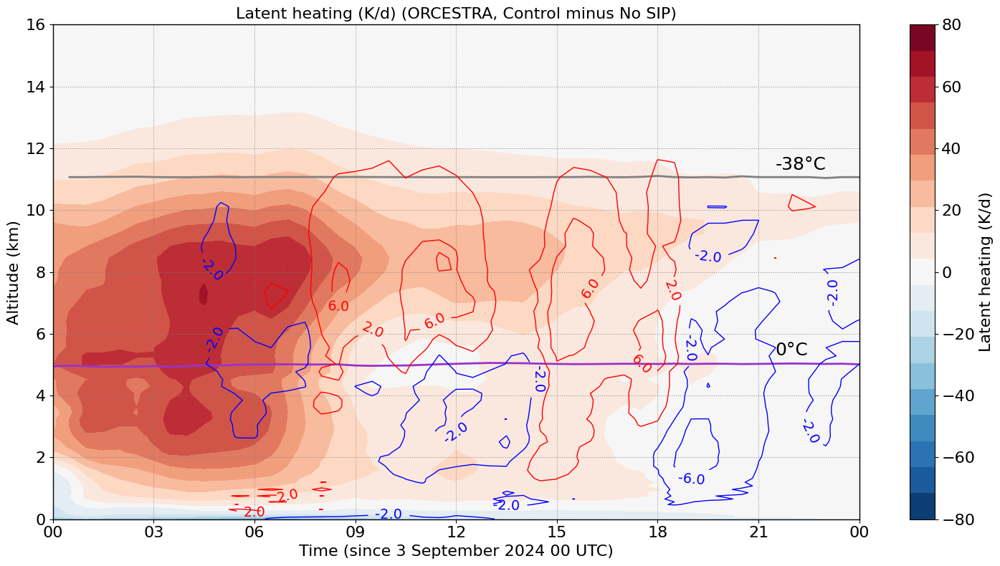

In [82]:

import matplotlib.lines as mlines

del_tot_lhr_nosip = ds_4sip.lhr_kperd-ds_nosip.lhr_kperd
del_tot_lhr_norf = ds_4sip.lhr_kperd-ds_norf.lhr_kperd
del_tot_lhr_nohm = ds_4sip.lhr_kperd-ds_nohm.lhr_kperd
del_tot_lhr_nobr = ds_4sip.lhr_kperd-ds_nobr.lhr_kperd
del_tot_lhr_nosb = ds_4sip.lhr_kperd-ds_nosb.lhr_kperd

fnt=16;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev2 = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', color='k', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', color='k', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.linspace(2, 10, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, del_tot_lhr_nohm.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.linspace(-10, -2, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, del_tot_lhr_nohm.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()


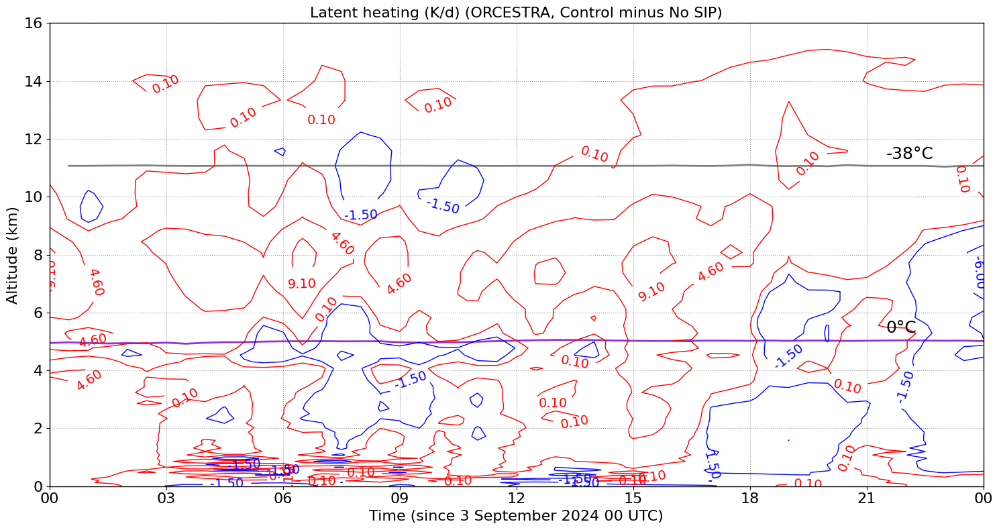

In [29]:
from sklearn.decomposition import PCA

del_tot_lhr_nosip = ds_4sip.lhr_kperd-ds_nosip.lhr_kperd
del_tot_lhr_norf = ds_4sip.lhr_kperd-ds_norf.lhr_kperd
del_tot_lhr_nohm = ds_4sip.lhr_kperd-ds_nohm.lhr_kperd
del_tot_lhr_nobr = ds_4sip.lhr_kperd-ds_nobr.lhr_kperd
del_tot_lhr_nosb = ds_4sip.lhr_kperd-ds_nosb.lhr_kperd

##############
# Flatten data to 2D [time * height, features=1]
fld = del_tot_lhr_nosip.mean(dim='ncells').T.values
n_time, n_height = fld.shape
fld_flat = fld.reshape(-1, 1)

# Apply PCA
pca = PCA(n_components=0.99)  # Retain 95% variance
fld_reduced = pca.fit_transform(fld_flat)
fld_reconstructed = pca.inverse_transform(fld_reduced)

# Reshape back to original grid
fld_pca_smooth = fld_reconstructed.reshape(n_time, n_height).T
##############

fnt=16;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev2 = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

#cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', color='k', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', color='k', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0.1, 15.1, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, fld_pca_smooth.T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.arange(-15, 0, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, fld_pca_smooth.T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()


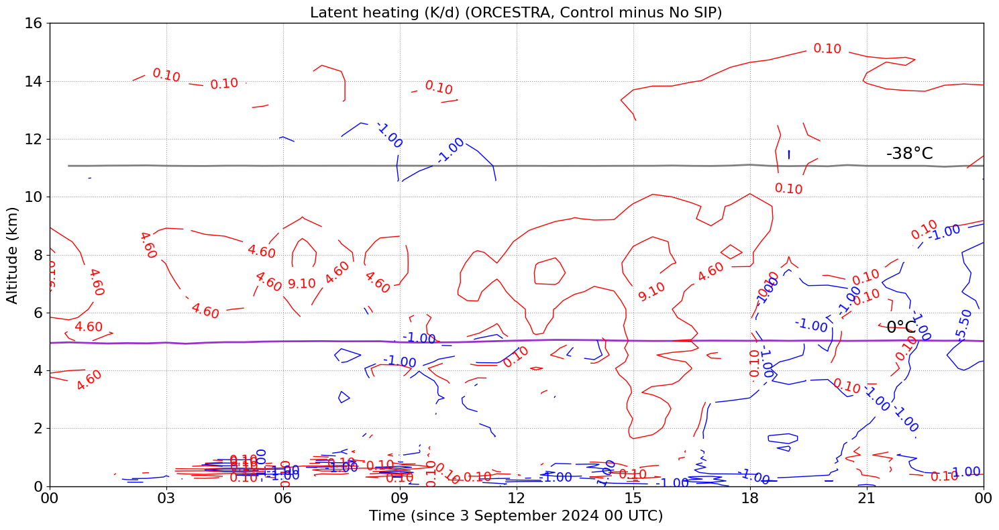

In [47]:

del_tot_lhr_nosip = ds_4sip.lhr_kperd-ds_nosip.lhr_kperd
del_tot_lhr_norf = ds_4sip.lhr_kperd-ds_norf.lhr_kperd
del_tot_lhr_nohm = ds_4sip.lhr_kperd-ds_nohm.lhr_kperd
del_tot_lhr_nobr = ds_4sip.lhr_kperd-ds_nobr.lhr_kperd
del_tot_lhr_nosb = ds_4sip.lhr_kperd-ds_nosb.lhr_kperd

mean_tot_lhr_4sip=ds_4sip.lhr_kperd.mean(dim=('ncells'))
mean_tot_lhr_nosip=ds_nosip.lhr_kperd.mean(dim=('ncells'))

del_tot_lhr_nosip = mean_tot_lhr_4sip-mean_tot_lhr_nosip
per_del_tot_lhr_nosip = 100.*del_tot_lhr_nosip/mean_tot_lhr_4sip

mask = np.abs(per_del_tot_lhr_nosip) >= 5.
del_tot_lhr_nosip = del_tot_lhr_nosip.where(mask)

fnt=16;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev2 = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

#cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', color='k', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', color='k', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0.1, 10.1, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip.T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

contour_levels = np.arange(-10, 0, 4.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip.T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.2f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()

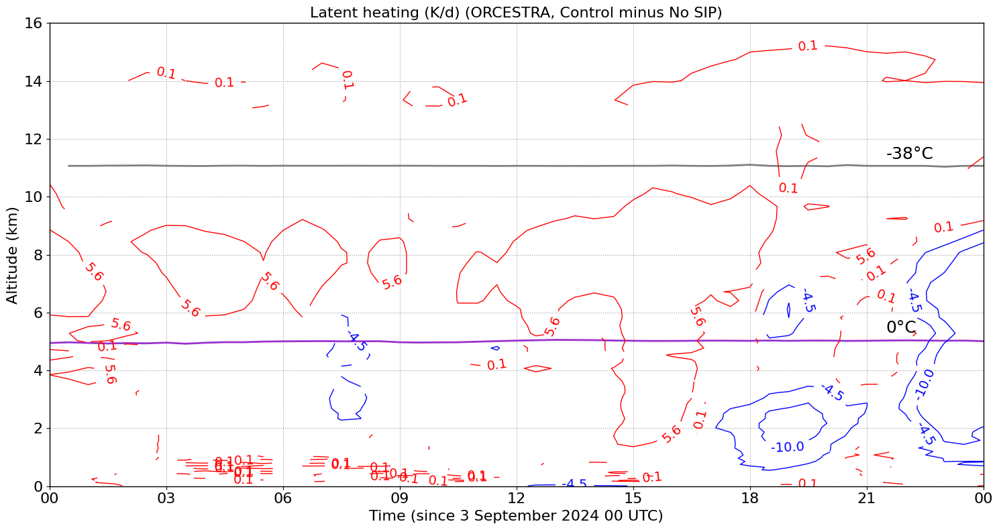

In [41]:
# ------------------------------------------------------------
# 1.  Z‑score test against zero (H0: mean == 0)
#     dims: (time, height, ncells)  ← adjust if yours differ
# ------------------------------------------------------------
# Mean and std along 'ncells'
mu    = del_tot_lhr_nosip.mean(dim='ncells')
sigma = del_tot_lhr_nosip.std(dim='ncells')

# Standard error of the mean
n     = del_tot_lhr_nosip.sizes['ncells']
sem   = sigma / np.sqrt(n)

# Z‑score at every (time, height)
z     = mu / sem

# Two‑sided p < 0.05  ⇒  |z| ≥ 1.96
sig_mask = np.abs(z) >= 1.96          # True where significant

# ------------------------------------------------------------
# 2.  Apply mask to the *original* field
# ------------------------------------------------------------
del_tot_lhr_nosip_sig = del_tot_lhr_nosip.where(sig_mask)

fnt=16;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev2 = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

#cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', color='k', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', color='k', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0.1, 10.1, 5.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip_sig.mean(dim=('ncells')).T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.arange(-10, 0, 5.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, del_tot_lhr_nosip_sig.mean(dim=('ncells')).T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()

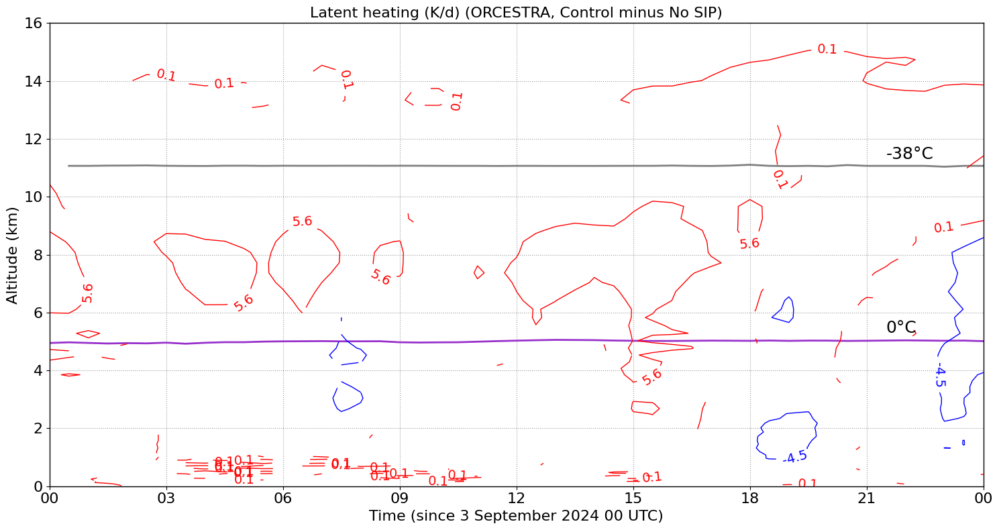

In [43]:


from scipy.stats import ttest_1samp
import xarray as xr


del_tot_lhr_nosip = ds_4sip.lhr_kperd-ds_nosip.lhr_kperd
del_tot_lhr_norf = ds_4sip.lhr_kperd-ds_norf.lhr_kperd
del_tot_lhr_nohm = ds_4sip.lhr_kperd-ds_nohm.lhr_kperd
del_tot_lhr_nobr = ds_4sip.lhr_kperd-ds_nobr.lhr_kperd
del_tot_lhr_nosb = ds_4sip.lhr_kperd-ds_nosb.lhr_kperd

# --- 1. average over cells ---
mu    = del_tot_lhr_nosip.mean(dim='ncells')     # mean anomaly
sigma = del_tot_lhr_nosip.std(dim='ncells')      # std dev
n     = del_tot_lhr_nosip.sizes['ncells']        # sample size
sem   = sigma / np.sqrt(n)                       # standard error
z     = mu / sem                                 # z‑score

# --- 2. mask by 95 % significance ---
sig_mask = np.abs(z) >= 1.96
mu_sig   = mu.where(sig_mask)                    # NaN where not sig.


fnt=16;
ln=2;
ln1=1.0;
ln2=1.0;
alp1=0.3;

lev2 = np.linspace(-80, 80, 20)

plt.figure(figsize=(15, 8))
plt.style.use('default')

#cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev2, cmap='RdBu_r')#'HomeyerRainbow')#'RdBu_r')#'coolwarm')#pyart_NWSRef')
#colorbar = plt.colorbar(cnt, ticks=[-80, -60, -40, -20, 0, 20, 40, 60, 80])
#colorbar.ax.tick_params(labelsize=fnt)
#colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, '-', color='darkorchid', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, '-', color='grey', linewidth=ln)

plt.text(ds_nosip.time[43], 5.3, '0°C', color='k', fontsize=fnt+2)
plt.text(ds_nosip.time[43], 11.3, '-38°C', color='k', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(0.1, 10.1, 5.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, mu_sig.T, levels=contour_levels, colors='r', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

contour_levels = np.arange(-10, 0, 5.5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, mu_sig.T, levels=contour_levels, colors='b', linestyles='-', linewidths=ln1)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%.1f')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.tight_layout()
plt.show()

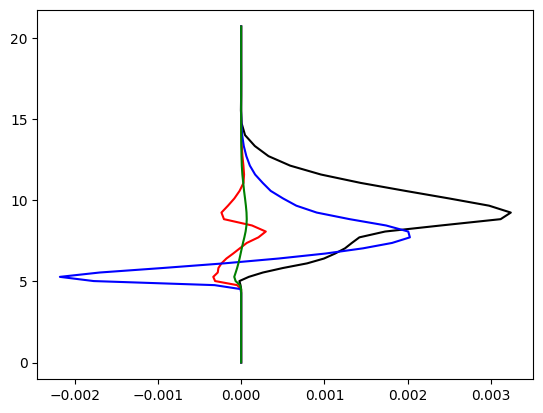

In [16]:
plt.plot(ds_4sip.d_qi_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'k-')
plt.plot(ds_4sip.d_qs_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'r-')
plt.plot(ds_4sip.d_qg_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'b-')
plt.plot(ds_4sip.d_qh_dep.mean(dim=('time','ncells')), mean_ht_4sip, 'g-')

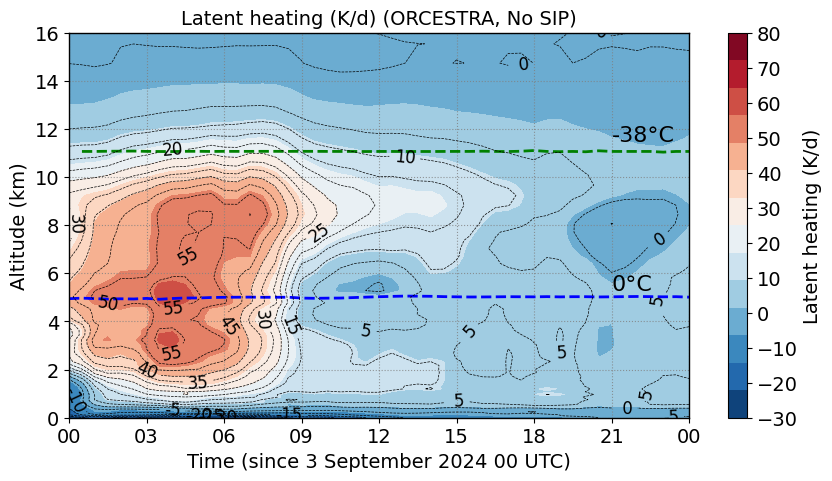

In [25]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'b--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

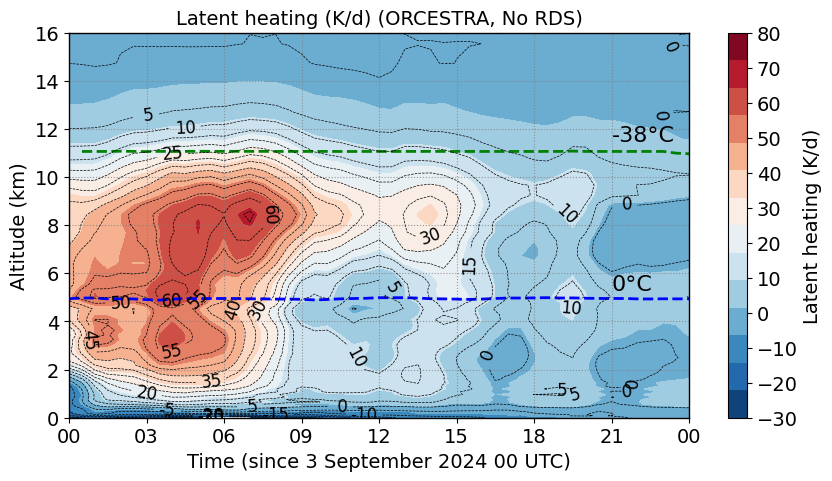

In [27]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'b--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

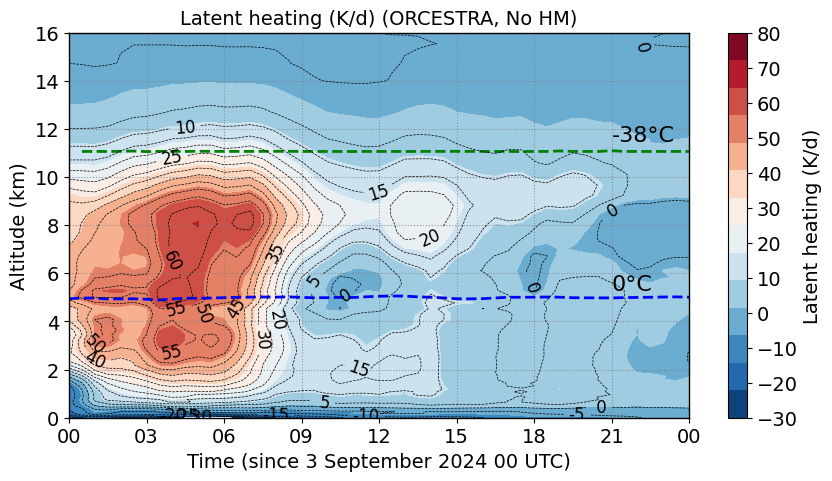

In [28]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

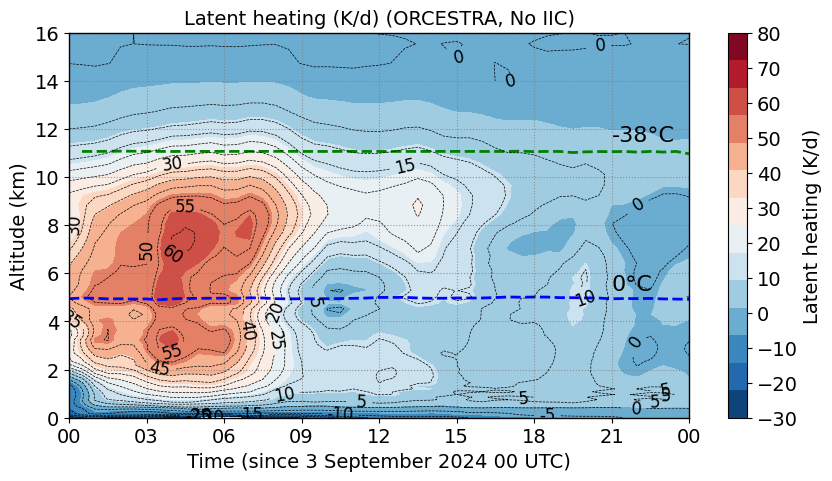

In [29]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nobr.time, mean_freez_lev_nobr, 'b--', linewidth=ln)
plt.plot(ds_nobr.time, mean_hom_lev_nobr, 'g--', linewidth=ln)

plt.text(ds_nobr.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nobr.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

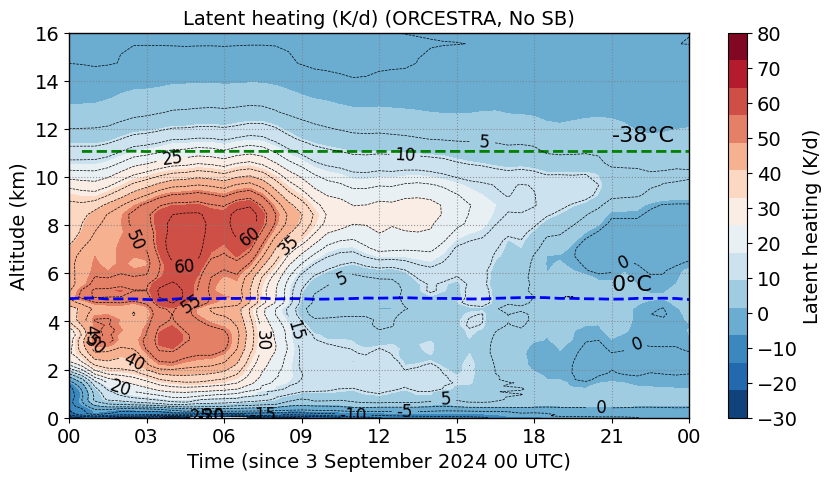

In [30]:
fnt=14;
ln=2;
lev = np.linspace(-30, 80, 15)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70, 80])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'b--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-30, 80.5, 5)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

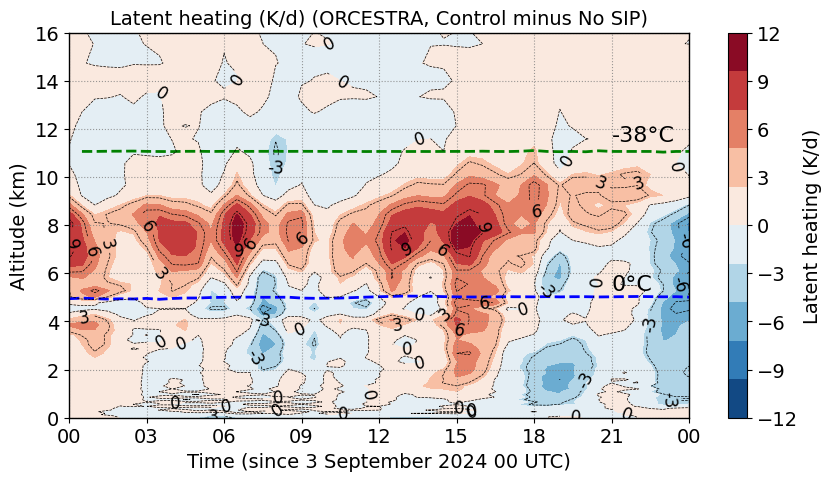

In [63]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosip.time, mean_freez_lev_nosip, 'b--', linewidth=ln)
plt.plot(ds_nosip.time, mean_hom_lev_nosip, 'g--', linewidth=ln)

plt.text(ds_nosip.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosip.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SIP)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nosip.time, mean_ht_nosip, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosip.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

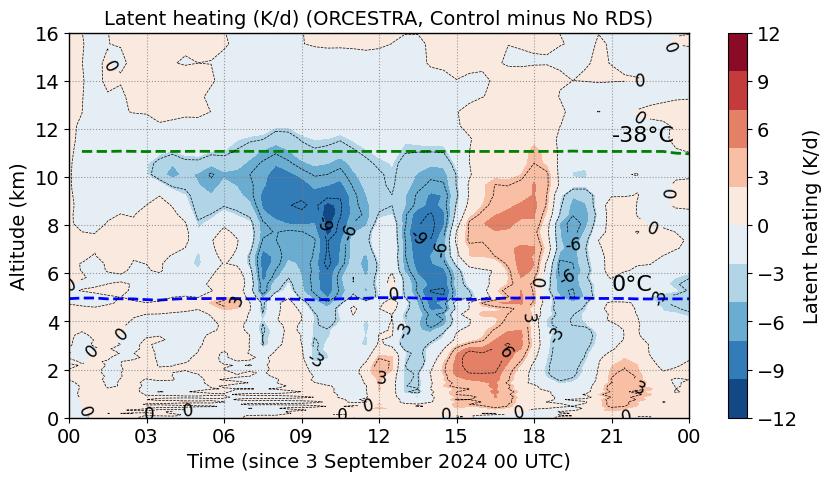

In [64]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_norf.time, mean_freez_lev_norf, 'b--', linewidth=ln)
plt.plot(ds_norf.time, mean_hom_lev_norf, 'g--', linewidth=ln)

plt.text(ds_norf.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_norf.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No RDS)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_norf.time, mean_ht_norf, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_norf.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

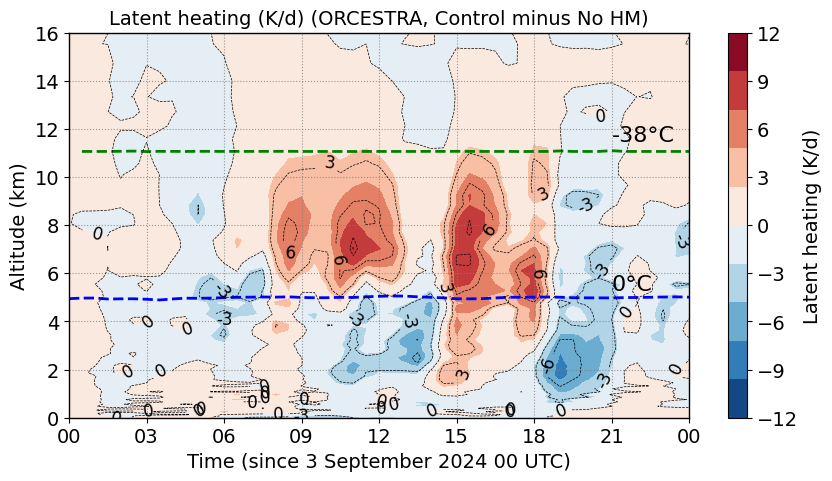

In [60]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No HM)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nohm.time, mean_ht_nohm, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nohm.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

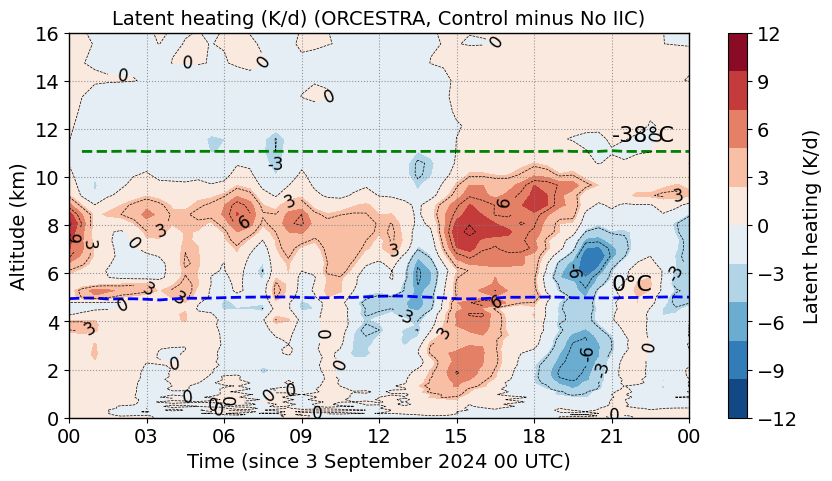

In [61]:
fnt=14;
ln=2;
lev = np.linspace(-12, 12, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-12, -9, -6, -3, 0, 3, 6, 9, 12])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nohm.time, mean_freez_lev_nohm, 'b--', linewidth=ln)
plt.plot(ds_nohm.time, mean_hom_lev_nohm, 'g--', linewidth=ln)

plt.text(ds_nohm.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nohm.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No IIC)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-12, 12.5, 3)
contours = plt.contour(ds_nobr.time, mean_ht_nobr, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nobr.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

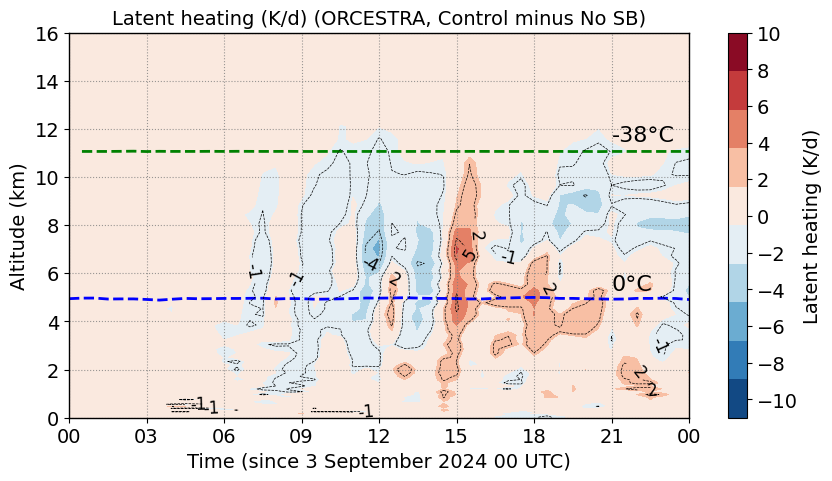

In [62]:
fnt=14;
ln=2;
lev = np.linspace(-11, 10, 11)

plt.figure(figsize=(10,5))
plt.style.use('default')

cnt=plt.contourf(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, levels=lev, cmap='RdBu_r')#'coolwarm')#pyart_NWSRef')
colorbar = plt.colorbar(cnt, ticks=[-10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10])
colorbar.ax.tick_params(labelsize=fnt)
colorbar.set_label(label='Latent heating (K/d)', size=fnt)

plt.plot(ds_nosb.time, mean_freez_lev_nosb, 'b--', linewidth=ln)
plt.plot(ds_nosb.time, mean_hom_lev_nosb, 'g--', linewidth=ln)

plt.text(ds_nosb.time[42], 5.3, '0°C', fontsize=fnt+2)
plt.text(ds_nosb.time[42], 11.5, '-38°C', fontsize=fnt+2)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fnt)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 0, 0)

#plt.ylim(20, -60)
plt.ylim(0, 16)

plt.xticks(fontsize=fnt)
plt.yticks(fontsize=fnt)
plt.ylabel('Altitude (km)', fontsize=fnt)
plt.title('Latent heating (K/d) (ORCESTRA, Control minus No SB)', fontsize=fnt)
plt.grid(True, linestyle=':', linewidth=0.8, color='grey', alpha=0.8)

contour_levels = np.arange(-10, 10.5, 3)
contours = plt.contour(ds_nosb.time, mean_ht_nosb, ds_4sip.lhr_kperd.mean(dim=('ncells')).T-ds_nosb.lhr_kperd.mean(dim=('ncells')).T, 
                       levels=contour_levels, colors='black', linestyles='--', linewidths=0.5)
plt.clabel(contours, inline=True, fontsize=fnt-2, fmt='%2d')

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines['top'].set_visible(True)
    plt.gca().spines['right'].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

## Cloud top height

In [10]:
thres_q = 1.e-3
cld_mask = ds_4sip.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_4sip.z_mc.where(cld_mask)
mean_cld_top_ht_4sip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = (ds_nosip.twc_gperm3 > thres_q) & (ds_nosip.w_vel > 0.);
mean_cld_top_ht = ds_nosip.z_mc.where(cld_mask)
mean_cld_top_ht_nosip = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_norf.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_norf.z_mc.where(cld_mask)
mean_cld_top_ht_norf = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nohm.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nohm.z_mc.where(cld_mask)
mean_cld_top_ht_nohm = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nobr.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nobr.z_mc.where(cld_mask)
mean_cld_top_ht_nobr = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

cld_mask = ds_nosb.twc_gperm3 > thres_q;
mean_cld_top_ht = ds_nosb.z_mc.where(cld_mask)
mean_cld_top_ht_nosb = (mean_cld_top_ht.max(dim='height')).mean(dim=('ncells'))

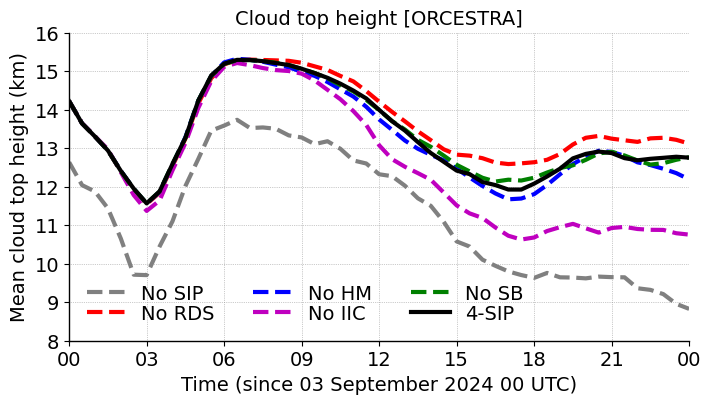

In [8]:




plt.figure(figsize=(8, 4))
plt.style.use('default')

lnwdth=3
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, 1.e-3*mean_cld_top_ht_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, 1.e-3*mean_cld_top_ht_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, 1.e-3*mean_cld_top_ht_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, 1.e-3*mean_cld_top_ht_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, 1.e-3*mean_cld_top_ht_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, 1.e-3*mean_cld_top_ht_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(8,16)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Mean cloud top height (km)', fontsize=fontsize)#, fontweight='bold')
plt.title('Cloud top height [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=3, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


## TOA Radiative Fluxes
#### Calculating CRE
##### SW CRE = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)
##### LW CRE = (Qcld_lw_dn - Qcld_lw_up) - (Qclear_lw_dn - Qclear_lw_up)
##### Net CRE = SW_CRE + LW_CRE

In [44]:
ds_4sip.height_2

<xarray.DataArray 'height_2' (height_2: 66)> Size: 528B
array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13., 14.,
       15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25., 26., 27., 28.,
       29., 30., 31., 32., 33., 34., 35., 36., 37., 38., 39., 40., 41., 42.,
       43., 44., 45., 46., 47., 48., 49., 50., 51., 52., 53., 54., 55., 56.,
       57., 58., 59., 60., 61., 62., 63., 64., 65., 66.])
Coordinates:
  * height_2  (height_2) float64 528B 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
Attributes:
    standard_name:  height
    long_name:      generalized_height
    axis:           Z

In [51]:

print('============ SURFACE ============')
print('surf_sw_dn_4sip     :: ', surf_sw_dn_4sip.mean().values)
print('surf_sw_up_4sip     :: ', surf_sw_up_4sip.mean().values)
print('surf_sw_dn_clr_4sip :: ', surf_sw_dn_clr_4sip.mean().values)
print('surf_sw_up_clr_4sip :: ', surf_sw_up_clr_4sip.mean().values)
print('surf_sw_cre_4sip    :: ', surf_sw_cre_4sip.mean().values)

print()

print('surf_sw_dn_nosip     :: ', surf_sw_dn_nosip.mean().values)
print('surf_sw_up_nosip     :: ', surf_sw_up_nosip.mean().values)
print('surf_sw_dn_clr_nosip :: ', surf_sw_dn_clr_nosip.mean().values)
print('surf_sw_up_clr_nosip :: ', surf_sw_up_clr_nosip.mean().values)
print('surf_sw_cre_nosip    :: ', surf_sw_cre_nosip.mean().values)

print()

print('============ TOA ============')
print('toa_sw_dn_4sip     :: ', toa_sw_dn_4sip.mean().values)
print('toa_sw_up_4sip     :: ', toa_sw_up_4sip.mean().values)
print('toa_sw_dn_clr_4sip :: ', toa_sw_dn_clr_4sip.mean().values)
print('toa_sw_up_clr_4sip :: ', toa_sw_up_clr_4sip.mean().values)
print('toa_sw_cre_4sip    :: ', toa_sw_cre_4sip.mean().values)

print()

print('toa_sw_dn_nosip     :: ', toa_sw_dn_nosip.mean().values)
print('toa_sw_up_nosip     :: ', toa_sw_up_nosip.mean().values)
print('toa_sw_dn_clr_nosip :: ', toa_sw_dn_clr_nosip.mean().values)
print('toa_sw_up_clr_nosip :: ', toa_sw_up_clr_nosip.mean().values)
print('toa_sw_cre_nosip    :: ', toa_sw_cre_nosip.mean().values)

============ SURFACE ============
surf_sw_dn_4sip     ::  62.63135
surf_sw_up_4sip     ::  3.6933117
surf_sw_dn_clr_4sip ::  281.38257
surf_sw_up_clr_4sip ::  12.93166
surf_sw_cre_4sip    ::  -209.51288

surf_sw_dn_nosip     ::  112.81479
surf_sw_up_nosip     ::  6.4412065
surf_sw_dn_clr_nosip ::  281.2298
surf_sw_up_clr_nosip ::  12.921852
surf_sw_cre_nosip    ::  -161.93439

============ TOA ============
toa_sw_dn_4sip     ::  394.6152
toa_sw_up_4sip     ::  264.99222
toa_sw_dn_clr_4sip ::  394.6152
toa_sw_up_clr_4sip ::  36.14215
toa_sw_cre_4sip    ::  -228.85007

toa_sw_dn_nosip     ::  394.6152
toa_sw_up_nosip     ::  199.15321
toa_sw_dn_clr_nosip ::  394.6152
toa_sw_up_clr_nosip ::  36.115654
toa_sw_cre_nosip    ::  -163.03757


In [52]:

print('============ SURFACE ============')
print('surf_lw_dn_4sip     :: ', surf_lw_dn_4sip.mean().values)
print('surf_lw_up_4sip     :: ', surf_lw_up_4sip.mean().values)
print('surf_lw_dn_clr_4sip :: ', surf_lw_dn_clr_4sip.mean().values)
print('surf_lw_up_clr_4sip :: ', surf_lw_up_clr_4sip.mean().values)
print('surf_lw_cre_4sip    :: ', surf_lw_cre_4sip.mean().values)

print()

print('surf_lw_dn_nosip     :: ', surf_lw_dn_nosip.mean().values)
print('surf_lw_up_nosip     :: ', surf_lw_up_nosip.mean().values)
print('surf_lw_dn_clr_nosip :: ', surf_lw_dn_clr_nosip.mean().values)
print('surf_lw_up_clr_nosip :: ', surf_lw_up_clr_nosip.mean().values)
print('surf_lw_cre_nosip    :: ', surf_lw_cre_nosip.mean().values)

print()

print('============ TOA ============')
print('toa_lw_dn_4sip     :: ', toa_lw_dn_4sip.mean().values)
print('toa_lw_up_4sip     :: ', toa_lw_up_4sip.mean().values)
print('toa_lw_dn_clr_4sip :: ', toa_lw_dn_clr_4sip.mean().values)
print('toa_lw_up_clr_4sip :: ', toa_lw_up_clr_4sip.mean().values)
print('toa_lw_cre_4sip    :: ', toa_lw_cre_4sip.mean().values)

print()

print('toa_lw_dn_nosip     :: ', toa_lw_dn_nosip.mean().values)
print('toa_lw_up_nosip     :: ', toa_lw_up_nosip.mean().values)
print('toa_lw_dn_clr_nosip :: ', toa_lw_dn_clr_nosip.mean().values)
print('toa_lw_up_clr_nosip :: ', toa_lw_up_clr_nosip.mean().values)
print('toa_lw_cre_nosip    :: ', toa_lw_cre_nosip.mean().values)

============ SURFACE ============
surf_lw_dn_4sip     ::  400.41345
surf_lw_up_4sip     ::  430.01358
surf_lw_dn_clr_4sip ::  373.64572
surf_lw_up_clr_4sip ::  429.77267
surf_lw_cre_4sip    ::  26.5268

surf_lw_dn_nosip     ::  400.72073
surf_lw_up_nosip     ::  430.01636
surf_lw_dn_clr_nosip ::  374.72855
surf_lw_up_clr_nosip ::  429.7824
surf_lw_cre_nosip    ::  25.758255

============ TOA ============
toa_lw_dn_4sip     ::  0.0
toa_lw_up_4sip     ::  127.822525
toa_lw_dn_clr_4sip ::  0.0
toa_lw_up_clr_4sip ::  246.33038
toa_lw_cre_4sip    ::  118.507835

toa_lw_dn_nosip     ::  0.0
toa_lw_up_nosip     ::  150.29224
toa_lw_dn_clr_nosip ::  0.0
toa_lw_up_clr_nosip ::  246.77003
toa_lw_cre_nosip    ::  96.47779


In [11]:

#### SIP 
toa_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=0).mean('ncells') 
toa_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=0).mean('ncells') 
toa_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=0).mean('ncells') 
toa_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=0).mean('ncells') 

toa_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=0).mean('ncells') 
toa_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=0).mean('ncells') 
toa_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=0).mean('ncells') 
toa_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=0).mean('ncells') 

toa_sw_cre_4sip = (toa_sw_dn_4sip-toa_sw_up_4sip) - (toa_sw_dn_clr_4sip-toa_sw_up_clr_4sip)
toa_lw_cre_4sip = (toa_lw_dn_4sip-toa_lw_up_4sip) - (toa_lw_dn_clr_4sip-toa_lw_up_clr_4sip)
toa_net_cre_4sip = toa_sw_cre_4sip+toa_lw_cre_4sip


ds_4sip['toa_sw_cre'] = toa_sw_cre_4sip
ds_4sip['toa_lw_cre'] = toa_lw_cre_4sip
ds_4sip['toa_net_cre'] = toa_net_cre_4sip

surf_sw_up_4sip = ds_4sip.swflx_up.isel(height_2=65).mean('ncells') 
surf_sw_up_clr_4sip = ds_4sip.swflx_up_clr.isel(height_2=65).mean('ncells') 
surf_lw_up_4sip = ds_4sip.lwflx_up.isel(height_2=65).mean('ncells') 
surf_lw_up_clr_4sip = ds_4sip.lwflx_up_clr.isel(height_2=65).mean('ncells') 

surf_sw_dn_4sip = ds_4sip.swflx_dn.isel(height_2=65).mean('ncells') 
surf_sw_dn_clr_4sip = ds_4sip.swflx_dn_clr.isel(height_2=65).mean('ncells') 
surf_lw_dn_4sip = ds_4sip.lwflx_dn.isel(height_2=65).mean('ncells') 
surf_lw_dn_clr_4sip = ds_4sip.lwflx_dn_clr.isel(height_2=65).mean('ncells') 

surf_sw_cre_4sip = (surf_sw_dn_4sip-surf_sw_up_4sip) - (surf_sw_dn_clr_4sip-surf_sw_up_clr_4sip)
surf_lw_cre_4sip = (surf_lw_dn_4sip-surf_lw_up_4sip) - (surf_lw_dn_clr_4sip-surf_lw_up_clr_4sip)
surf_net_cre_4sip = surf_sw_cre_4sip+surf_lw_cre_4sip

ds_4sip['surf_sw_cre'] = surf_sw_cre_4sip
ds_4sip['surf_lw_cre'] = surf_lw_cre_4sip
ds_4sip['surf_net_cre'] = surf_net_cre_4sip

#### No SIP 
toa_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=0).mean('ncells') #ds_nosip.lwflx_dn_clr[:,0,:]

toa_sw_cre_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_lw_cre_nosip = (toa_lw_dn_nosip-toa_lw_up_nosip) - (toa_lw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_net_cre_nosip = toa_sw_cre_nosip+toa_lw_cre_nosip

ds_nosip['toa_sw_cre'] = toa_sw_cre_nosip
ds_nosip['toa_lw_cre'] = toa_lw_cre_nosip
ds_nosip['toa_net_cre'] = toa_net_cre_nosip
ds_nosip['del_toa_sw_cre'] = toa_sw_cre_4sip-toa_sw_cre_nosip
ds_nosip['del_toa_lw_cre'] = toa_lw_cre_4sip-toa_lw_cre_nosip
ds_nosip['del_toa_net_cre'] = toa_net_cre_4sip-toa_net_cre_nosip

surf_sw_up_nosip = ds_nosip.swflx_up.isel(height_2=65).mean('ncells') 
surf_sw_up_clr_nosip = ds_nosip.swflx_up_clr.isel(height_2=65).mean('ncells') 
surf_lw_up_nosip = ds_nosip.lwflx_up.isel(height_2=65).mean('ncells') 
surf_lw_up_clr_nosip = ds_nosip.lwflx_up_clr.isel(height_2=65).mean('ncells') 

surf_sw_dn_nosip = ds_nosip.swflx_dn.isel(height_2=65).mean('ncells') 
surf_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr.isel(height_2=65).mean('ncells') 
surf_lw_dn_nosip = ds_nosip.lwflx_dn.isel(height_2=65).mean('ncells') 
surf_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr.isel(height_2=65).mean('ncells') 

surf_sw_cre_nosip = (surf_sw_dn_nosip-surf_sw_up_nosip) - (surf_sw_dn_clr_nosip-surf_sw_up_clr_nosip)
surf_lw_cre_nosip = (surf_lw_dn_nosip-surf_lw_up_nosip) - (surf_lw_dn_clr_nosip-surf_lw_up_clr_nosip)
surf_net_cre_nosip = surf_sw_cre_nosip+surf_lw_cre_nosip

ds_nosip['surf_sw_cre'] = surf_sw_cre_nosip
ds_nosip['surf_lw_cre'] = surf_lw_cre_nosip
ds_nosip['surf_net_cre'] = surf_net_cre_nosip



## Box plot of radiative fluxes, cloud cover and precipitation

In [4]:

dt_hours = (ds_nosip.time.diff('time') / np.timedelta64(1, 'h'))

acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')

del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/dt_hours #0.5    # output is over 30 min
precip_rate_4sip = del_prec_4sip/dt_hours

tot_acc_precip_4sip = np.nanmax(ds_4sip.tot_prec.mean('ncells'))
tot_acc_precip_nosip = np.nanmax(ds_nosip.tot_prec.mean('ncells'))

std_tot_precip_4sip = np.nanstd(ds_4sip.tot_prec.mean('ncells'))
std_tot_precip_nosip = np.nanstd(ds_nosip.tot_prec.mean('ncells'))

n_cells = ds_4sip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_4sip = std_tot_precip_4sip / np.sqrt(n_cells)

n_cells = ds_nosip.tot_prec.mean('ncells').count()  # count valid 'ncells'
stderr_tot_precip_nosip = std_tot_precip_nosip / np.sqrt(n_cells)


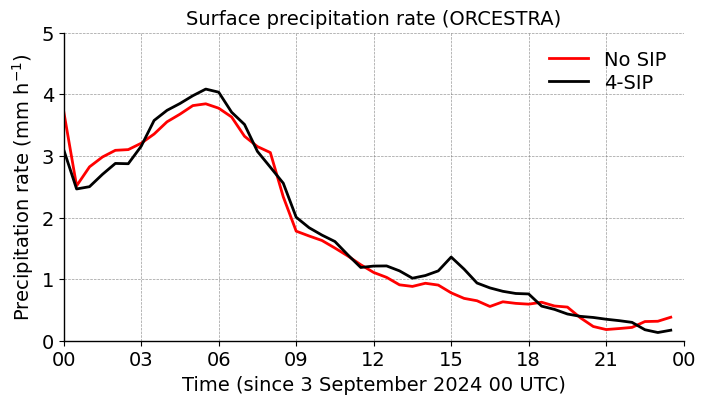

In [9]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))
plt.style.use('default')

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), 'r-', linewidth=lnwdth, label='No SIP')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)

plt.ylabel('Precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 3 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(0, 5)

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation rate (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='best')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))


plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


In [12]:

## 4 SIP

## TOA LW
min_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.min().values; max_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.max().values
mean_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.mean().values

std_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.std().values
stderr_toa_lw_cre_4sip = std_toa_lw_cre_4sip / np.sqrt(ds_4sip.toa_lw_cre.count().values)

## TOA SW
min_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.min().values; max_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.max().values
mean_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.mean().values

std_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.std().values
stderr_toa_sw_cre_4sip = std_toa_sw_cre_4sip / np.sqrt(ds_4sip.toa_sw_cre.count().values)

## TOA NET
min_toa_net_cre_4sip = ds_4sip.toa_net_cre.min().values; max_toa_net_cre_4sip = ds_4sip.toa_net_cre.max().values
mean_toa_net_cre_4sip = ds_4sip.toa_net_cre.mean().values

std_toa_net_cre_4sip = ds_4sip.toa_net_cre.std().values
stderr_toa_net_cre_4sip = std_toa_net_cre_4sip / np.sqrt(ds_4sip.toa_net_cre.count().values)

## Surface LW
min_surf_lw_cre_4sip = ds_4sip.surf_lw_cre.min().values; max_surf_lw_cre_4sip = ds_4sip.surf_lw_cre.max().values
mean_surf_lw_cre_4sip = ds_4sip.surf_lw_cre.mean().values

std_surf_lw_cre_4sip = ds_4sip.surf_lw_cre.std().values
stderr_surf_lw_cre_4sip = std_surf_lw_cre_4sip / np.sqrt(ds_4sip.surf_lw_cre.count().values)

## Surface SW
min_surf_sw_cre_4sip = ds_4sip.surf_sw_cre.min().values; max_surf_sw_cre_4sip = ds_4sip.surf_sw_cre.max().values
mean_surf_sw_cre_4sip = ds_4sip.surf_sw_cre.mean().values

std_surf_sw_cre_4sip = ds_4sip.surf_sw_cre.std().values
stderr_surf_sw_cre_4sip = std_surf_sw_cre_4sip / np.sqrt(ds_4sip.surf_sw_cre.count().values)

## Surface NET
min_surf_net_cre_4sip = ds_4sip.surf_net_cre.min().values; max_surf_net_cre_4sip = ds_4sip.surf_net_cre.max().values
mean_surf_net_cre_4sip = ds_4sip.surf_net_cre.mean().values

std_surf_net_cre_4sip = ds_4sip.surf_net_cre.std().values
stderr_surf_net_cre_4sip = std_surf_net_cre_4sip / np.sqrt(ds_4sip.surf_net_cre.count().values)

## No SIP
min_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.min().values; max_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.max().values
mean_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.mean().values

std_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.std().values
stderr_toa_lw_cre_nosip = std_toa_lw_cre_nosip / np.sqrt(ds_nosip.toa_lw_cre.count().values)

min_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.min().values; max_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.max().values
mean_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.mean().values

std_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.std().values
stderr_toa_sw_cre_nosip = std_toa_sw_cre_nosip / np.sqrt(ds_nosip.toa_sw_cre.count().values)

min_toa_net_cre_nosip = ds_nosip.toa_net_cre.min().values; max_toa_net_cre_nosip = ds_nosip.toa_net_cre.max().values
mean_toa_net_cre_nosip = ds_nosip.toa_net_cre.mean().values

std_toa_net_cre_nosip = ds_nosip.toa_net_cre.std().values
stderr_toa_net_cre_nosip = std_toa_net_cre_nosip / np.sqrt(ds_nosip.toa_net_cre.count().values)

## surface
min_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.min().values; max_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.max().values
mean_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.mean().values

std_surf_lw_cre_nosip = ds_nosip.surf_lw_cre.std().values
stderr_surf_lw_cre_nosip = std_surf_lw_cre_nosip / np.sqrt(ds_nosip.surf_lw_cre.count().values)

min_surf_sw_cre_nosip = ds_nosip.surf_sw_cre.min().values; max_surf_sw_cre_nosip = ds_nosip.surf_sw_cre.max().values
mean_surf_sw_cre_nosip = ds_nosip.surf_sw_cre.mean().values

std_surf_sw_cre_nosip = ds_nosip.surf_sw_cre.std().values
stderr_surf_sw_cre_nosip = std_surf_sw_cre_nosip / np.sqrt(ds_nosip.surf_sw_cre.count().values)

min_surf_net_cre_nosip = ds_nosip.surf_net_cre.min().values; max_surf_net_cre_nosip = ds_nosip.surf_net_cre.max().values
mean_surf_net_cre_nosip = ds_nosip.surf_net_cre.mean().values

std_surf_net_cre_nosip = ds_nosip.surf_net_cre.std().values
stderr_surf_net_cre_nosip = std_surf_net_cre_nosip / np.sqrt(ds_nosip.surf_net_cre.count().values)

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 



In [13]:

start_time='2024-09-03T00:00:00.000000000';
end_time='2024-09-04T00:00:00.000000000'

low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_4sip = np.nanstd(ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_4sip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_4sip = std_low_cld_cover_4sip / np.sqrt(n_cells)

low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
std_low_cld_cover_nosip = np.nanstd(ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev'))
n_cells = ds_nosip.clcl.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev').count()
stderr_low_cld_cover_nosip = std_low_cld_cover_nosip / np.sqrt(n_cells)

mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_4sip = np.nanstd(ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_4sip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_4sip = std_mid_cld_cover_4sip / np.sqrt(n_cells)

mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
std_mid_cld_cover_nosip = np.nanstd(ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2'))
n_cells = ds_nosip.clcm.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_2').count()
stderr_mid_cld_cover_nosip = std_mid_cld_cover_nosip / np.sqrt(n_cells)

high_cld_cover_4sip = np.nanmean(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_4sip = np.nanstd(ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_4sip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_4sip = std_high_cld_cover_4sip / np.sqrt(n_cells)

high_cld_cover_nosip = np.nanmean(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
std_high_cld_cover_nosip = np.nanstd(ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3'))
n_cells = ds_nosip.clch.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('plev_3').count()
stderr_high_cld_cover_nosip = std_high_cld_cover_nosip / np.sqrt(n_cells)

tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_4sip = np.nanstd(ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_4sip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_4sip = std_tot_cld_cover_4sip / np.sqrt(n_cells)

tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
std_tot_cld_cover_nosip = np.nanstd(ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells'))
n_cells = ds_nosip.clct.sel(time=slice(start_time, end_time), ncells=mask_cells).mean('ncells').count()
stderr_tot_cld_cover_nosip = std_tot_cld_cover_nosip / np.sqrt(n_cells)

#low_cld_cover_4sip = np.nanmean(ds_4sip.clcl.mean('plev'))
#low_cld_cover_nosip = np.nanmean(ds_nosip.clcl.mean('plev'))

#mid_cld_cover_4sip = np.nanmean(ds_4sip.clcm.mean('plev_2'))
#mid_cld_cover_nosip = np.nanmean(ds_nosip.clcm.mean('plev_2'))

#high_cld_cover_4sip = np.nanmean(ds_4sip.clch.mean('plev_3'))
#high_cld_cover_nosip = np.nanmean(ds_nosip.clch.mean('plev_3'))

#tot_cld_cover_4sip = np.nanmean(ds_4sip.clct.mean('ncells'))
#tot_cld_cover_nosip = np.nanmean(ds_nosip.clct.mean('ncells'))


NameError: name 'mask_cells' is not defined

In [ ]:

stderr_tot_precip_4sip = stderr_tot_precip_4sip.values
stderr_tot_precip_nosip = stderr_tot_precip_nosip.values

stderr_low_cld_cover_4sip = stderr_low_cld_cover_4sip.values
stderr_low_cld_cover_nosip = stderr_low_cld_cover_nosip.values
stderr_mid_cld_cover_4sip = stderr_mid_cld_cover_4sip.values
stderr_mid_cld_cover_nosip = stderr_mid_cld_cover_nosip.values
stderr_high_cld_cover_4sip = stderr_high_cld_cover_4sip.values
stderr_high_cld_cover_nosip = stderr_high_cld_cover_nosip.values
stderr_tot_cld_cover_4sip = stderr_tot_cld_cover_4sip.values
stderr_tot_cld_cover_nosip = stderr_tot_cld_cover_nosip.values


In [59]:
stderr_mid_cld_cover_4sip

array(0.01382978)

In [14]:

#group_cc_4sip = [tot_acc_precip_4sip, low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
#group_cc_nosip = [tot_acc_precip_nosip, low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

group_cc_4sip = [low_cld_cover_4sip, mid_cld_cover_4sip, high_cld_cover_4sip, tot_cld_cover_4sip]
group_cc_nosip = [low_cld_cover_nosip, mid_cld_cover_nosip, high_cld_cover_nosip, tot_cld_cover_nosip]

#stderr_cc_4sip = [stderr_tot_precip_4sip, stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
#stderr_cc_nosip = [stderr_tot_precip_nosip, stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

stderr_cc_4sip = [stderr_low_cld_cover_4sip, stderr_mid_cld_cover_4sip, stderr_high_cld_cover_4sip, stderr_tot_cld_cover_4sip];
stderr_cc_nosip = [stderr_low_cld_cover_nosip, stderr_mid_cld_cover_nosip, stderr_high_cld_cover_nosip, stderr_tot_cld_cover_nosip];

#stderr_cc_4sip = [std_tot_precip_4sip, std_low_cld_cover_4sip, std_mid_cld_cover_4sip, std_high_cld_cover_4sip, std_tot_cld_cover_4sip];
#stderr_cc_nosip = [std_tot_precip_nosip, std_low_cld_cover_nosip, std_mid_cld_cover_nosip, std_high_cld_cover_nosip, std_tot_cld_cover_nosip];

group_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

stderr_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
stderr_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

#cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
cc_comp_groups = ['Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_cc - width/2, group_cc_4sip, width, yerr=stderr_cc_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_cc + width/2, group_cc_nosip, width, yerr=stderr_cc_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(0,120)
#ax1.set_ylabel('Accumulated precipitation (mm) \nand cloud cover (CC, %)', fontsize=fnt)
ax1.set_ylabel('Cloud cover (CC, %)', fontsize=fnt)
ax1.set_xticks(x_cc)
ax1.set_xticklabels(cc_comp_groups, rotation=20)
ax1.set_title('(ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_flux_4sip, width, yerr=stderr_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_flux_nosip, width, yerr=stderr_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-800,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax2.set_title('TOA radiative fluxes (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)

ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


NameError: name 'low_cld_cover_4sip' is not defined

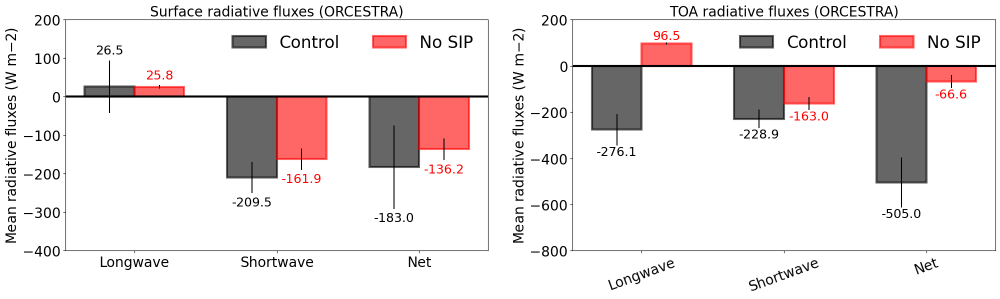

In [67]:

group_surf_flux_4sip = [mean_surf_lw_cre_4sip, mean_surf_sw_cre_4sip, mean_surf_net_cre_4sip]
group_surf_flux_nosip = [mean_surf_lw_cre_nosip, mean_surf_sw_cre_nosip, mean_surf_net_cre_nosip]

stderr_surf_flux_4sip = [stderr_surf_lw_cre_4sip, stderr_surf_sw_cre_4sip, stderr_surf_net_cre_4sip];
stderr_surf_flux_nosip = [stderr_surf_lw_cre_nosip, stderr_surf_sw_cre_nosip, stderr_surf_net_cre_nosip];

group_toa_flux_4sip = [mean_toa_lw_cre_4sip, mean_toa_sw_cre_4sip, mean_toa_net_cre_4sip]
group_toa_flux_nosip = [mean_toa_lw_cre_nosip, mean_toa_sw_cre_nosip, mean_toa_net_cre_nosip]

stderr_toa_flux_4sip = [stderr_toa_lw_cre_4sip, stderr_toa_sw_cre_4sip, stderr_toa_net_cre_4sip];
stderr_toa_flux_nosip = [stderr_toa_lw_cre_nosip, stderr_toa_sw_cre_nosip, stderr_toa_net_cre_nosip];

#stderr_flux_4sip = [std_toa_lw_cre_4sip, std_toa_sw_cre_4sip, std_toa_net_cre_4sip];
#stderr_flux_nosip = [std_toa_lw_cre_nosip, std_toa_sw_cre_nosip, std_toa_net_cre_nosip];

cc_comp_groups = ['Precipitation', 'Low CC', 'Mid CC', 'High CC', 'Total CC']
rad_flux_comp_groups = ['Longwave', 'Shortwave', 'Net']

x_cc = np.arange(len(cc_comp_groups))
x_flux = np.arange(len(rad_flux_comp_groups))

fnt=20;
ln=3;
alp=0.6
width = 0.35  # width of the bars

fig, axs = plt.subplots(1, 2, figsize=(24, 6), sharey=False)
plt.style.use('default')

ax1 = axs[0]

ax1.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax1.bar(x_flux - width/2, group_surf_flux_4sip, width, yerr=stderr_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax1.bar(x_flux + width/2, group_surf_flux_nosip, width, yerr=stderr_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax1.bar_label(rects1, padding=5, color='k', fontsize=fnt-2, fmt='%.1f')
ax1.bar_label(rects2, padding=5, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax1.set_ylim(-400,200)
ax1.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax1.set_xticks(x_flux)
ax1.set_xticklabels(rad_flux_comp_groups, rotation=0)
ax1.set_title('Surface radiative fluxes (ORCESTRA)', fontsize=fnt)
ax1.tick_params(axis='both', labelsize=fnt)

ax1.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

# ---------------------------------------------
# Subplot 2: Vertical velocity (w)
# ---------------------------------------------

ax2 = axs[1]

ax2.axhline(y=0, color='k', linewidth=ln, linestyle='-')

rects1 = ax2.bar(x_flux - width/2, group_toa_flux_4sip, width, yerr=stderr_toa_flux_4sip, color='black', facecolor='k', edgecolor='k', linewidth=ln, alpha=alp, label='Control')
rects2 = ax2.bar(x_flux + width/2, group_toa_flux_nosip, width, yerr=stderr_toa_flux_nosip, color='red', facecolor='r', edgecolor='r', linewidth=ln, alpha=alp, label='No SIP')

ax2.bar_label(rects1, padding=1, color='k', fontsize=fnt-2, fmt='%.1f')
ax2.bar_label(rects2, padding=1, color='r', fontsize=fnt-2, fmt='%.1f')

# For the left bars (rects1)
#for rect in rects1:
#    # Shift left by a small amount (e.g., -0.1)
#    x = rect.get_x() + rect.get_width() / 2 - 0.1  # Shift left for left bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='k', fontsize=fnt-2)

# For the right bars (rects2)
#for rect in rects2:
#    # Shift right by a small amount (e.g., +0.1)
#    x = rect.get_x() + rect.get_width() / 2 + 0.1  # Shift right for right bars
#    y = rect.get_height()
#    ax1.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='r', fontsize=fnt-2)
    
# Customization
ax2.set_ylim(-800,200)
ax2.set_ylabel('Mean radiative fluxes (W m${-2}$)', fontsize=fnt)
ax2.set_xticks(x_flux)
ax2.set_xticklabels(rad_flux_comp_groups, rotation=20)
ax2.set_title('TOA radiative fluxes (ORCESTRA)', fontsize=fnt)
ax2.tick_params(axis='both', labelsize=fnt)


ax2.legend(frameon=False, handlelength=2, labelspacing=0.2, ncols=2, fontsize=fnt+4, loc='best')

#plt.tight_layout()
plt.show()


In [ ]:

mean_tot_cld_cover = ds_4sip.clct.mean(dim=('ncells'))

In [ ]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')  
plt1.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4, 2) 
plt1.set_ylim(25, -60) 
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()


## Box plot of TOA radiative fluxes

In [201]:

## 4 SIP
min_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.min().values; max_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.max().values
mean_toa_lw_cre_4sip = ds_4sip.toa_lw_cre.mean().values

min_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.min().values; max_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.max().values
mean_toa_sw_cre_4sip = ds_4sip.toa_sw_cre.mean().values

min_toa_net_cre_4sip = ds_4sip.toa_net_cre.min().values; max_toa_net_cre_4sip = ds_4sip.toa_net_cre.max().values
mean_toa_net_cre_4sip = ds_4sip.toa_net_cre.mean().values


## No SIP
min_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.min().values; max_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.max().values
mean_toa_lw_cre_nosip = ds_nosip.toa_lw_cre.mean().values

min_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.min().values; max_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.max().values
mean_toa_sw_cre_nosip = ds_nosip.toa_sw_cre.mean().values

min_toa_net_cre_nosip = ds_nosip.toa_net_cre.min().values; max_toa_net_cre_nosip = ds_nosip.toa_net_cre.max().values
mean_toa_net_cre_nosip = ds_nosip.toa_net_cre.mean().values

del_min_toa_lw_cre_nosip = min_toa_lw_cre_4sip-min_toa_lw_cre_nosip; del_max_toa_lw_cre_nosip = max_toa_lw_cre_4sip-max_toa_lw_cre_nosip;
del_mean_toa_lw_cre_nosip = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosip; 
del_min_toa_sw_cre_nosip = min_toa_sw_cre_4sip-min_toa_sw_cre_nosip; del_max_toa_sw_cre_nosip = max_toa_sw_cre_4sip-max_toa_sw_cre_nosip;
del_mean_toa_sw_cre_nosip = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosip; 
del_min_toa_net_cre_nosip = min_toa_net_cre_4sip-min_toa_net_cre_nosip; del_max_toa_net_cre_nosip = max_toa_net_cre_4sip-max_toa_net_cre_nosip;
del_mean_toa_net_cre_nosip = mean_toa_net_cre_4sip-mean_toa_net_cre_nosip; 

## No RDS
min_toa_lw_cre_norf = ds_norf.toa_lw_cre.min().values; max_toa_lw_cre_norf = ds_norf.toa_lw_cre.max().values
mean_toa_lw_cre_norf = ds_norf.toa_lw_cre.mean().values

min_toa_sw_cre_norf = ds_norf.toa_sw_cre.min().values; max_toa_sw_cre_norf = ds_norf.toa_sw_cre.max().values
mean_toa_sw_cre_norf = ds_norf.toa_sw_cre.mean().values

min_toa_net_cre_norf = ds_norf.toa_net_cre.min().values; max_toa_net_cre_norf = ds_norf.toa_net_cre.max().values
mean_toa_net_cre_norf = ds_norf.toa_net_cre.mean().values

del_min_toa_lw_cre_norf = min_toa_lw_cre_4sip-min_toa_lw_cre_norf; del_max_toa_lw_cre_norf = max_toa_lw_cre_4sip-max_toa_lw_cre_norf;
del_mean_toa_lw_cre_norf = mean_toa_lw_cre_4sip-mean_toa_lw_cre_norf; 
del_min_toa_sw_cre_norf = min_toa_sw_cre_4sip-min_toa_sw_cre_norf; del_max_toa_sw_cre_norf = max_toa_sw_cre_4sip-max_toa_sw_cre_norf;
del_mean_toa_sw_cre_norf = mean_toa_sw_cre_4sip-mean_toa_sw_cre_norf; 
del_min_toa_net_cre_norf = min_toa_net_cre_4sip-min_toa_net_cre_norf; del_max_toa_net_cre_norf = max_toa_net_cre_4sip-max_toa_net_cre_norf;
del_mean_toa_net_cre_norf = mean_toa_net_cre_4sip-mean_toa_net_cre_norf;

## No HM
min_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.min().values; max_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.max().values
mean_toa_lw_cre_nohm = ds_nohm.toa_lw_cre.mean().values

min_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.min().values; max_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.max().values
mean_toa_sw_cre_nohm = ds_nohm.toa_sw_cre.mean().values

min_toa_net_cre_nohm = ds_nohm.toa_net_cre.min().values; max_toa_net_cre_nohm = ds_nohm.toa_net_cre.max().values
mean_toa_net_cre_nohm = ds_nohm.toa_net_cre.mean().values

del_min_toa_lw_cre_nohm = min_toa_lw_cre_4sip-min_toa_lw_cre_nohm; del_max_toa_lw_cre_nohm = max_toa_lw_cre_4sip-max_toa_lw_cre_nohm;
del_mean_toa_lw_cre_nohm = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nohm; 
del_min_toa_sw_cre_nohm = min_toa_sw_cre_4sip-min_toa_sw_cre_nohm; del_max_toa_sw_cre_nohm = max_toa_sw_cre_4sip-max_toa_sw_cre_nohm;
del_mean_toa_sw_cre_nohm = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nohm; 
del_min_toa_net_cre_nohm = min_toa_net_cre_4sip-min_toa_net_cre_nohm; del_max_toa_net_cre_nohm = max_toa_net_cre_4sip-max_toa_net_cre_nohm;
del_mean_toa_net_cre_nohm = mean_toa_net_cre_4sip-mean_toa_net_cre_nohm;

## No BR
min_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.min().values; max_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.max().values
mean_toa_lw_cre_nobr = ds_nobr.toa_lw_cre.mean().values

min_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.min().values; max_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.max().values
mean_toa_sw_cre_nobr = ds_nobr.toa_sw_cre.mean().values

min_toa_net_cre_nobr = ds_nobr.toa_net_cre.min().values; max_toa_net_cre_nobr = ds_nobr.toa_net_cre.max().values
mean_toa_net_cre_nobr = ds_nobr.toa_net_cre.mean().values

del_min_toa_lw_cre_nobr = min_toa_lw_cre_4sip-min_toa_lw_cre_nobr; del_max_toa_lw_cre_nobr = max_toa_lw_cre_4sip-max_toa_lw_cre_nobr;
del_mean_toa_lw_cre_nobr = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nobr; 
del_min_toa_sw_cre_nobr = min_toa_sw_cre_4sip-min_toa_sw_cre_nobr; del_max_toa_sw_cre_nobr = max_toa_sw_cre_4sip-max_toa_sw_cre_nobr;
del_mean_toa_sw_cre_nobr = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nobr; 
del_min_toa_net_cre_nobr = min_toa_net_cre_4sip-min_toa_net_cre_nobr; del_max_toa_net_cre_nobr = max_toa_net_cre_4sip-max_toa_net_cre_nobr;
del_mean_toa_net_cre_nobr = mean_toa_net_cre_4sip-mean_toa_net_cre_nobr;

## No SB
min_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.min().values; max_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.max().values
mean_toa_lw_cre_nosb = ds_nosb.toa_lw_cre.mean().values

min_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.min().values; max_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.max().values
mean_toa_sw_cre_nosb = ds_nosb.toa_sw_cre.mean().values

min_toa_net_cre_nosb = ds_nosb.toa_net_cre.min().values; max_toa_net_cre_nosb = ds_nosb.toa_net_cre.max().values
mean_toa_net_cre_nosb = ds_nosb.toa_net_cre.mean().values

del_min_toa_lw_cre_nosb = min_toa_lw_cre_4sip-min_toa_lw_cre_nosb; del_max_toa_lw_cre_nosb = max_toa_lw_cre_4sip-max_toa_lw_cre_nosb;
del_mean_toa_lw_cre_nosb = mean_toa_lw_cre_4sip-mean_toa_lw_cre_nosb; 
del_min_toa_sw_cre_nosb = min_toa_sw_cre_4sip-min_toa_sw_cre_nosb; del_max_toa_sw_cre_nosb = max_toa_sw_cre_4sip-max_toa_sw_cre_nosb;
del_mean_toa_sw_cre_nosb = mean_toa_sw_cre_4sip-mean_toa_sw_cre_nosb; 
del_min_toa_net_cre_nosb = min_toa_net_cre_4sip-min_toa_net_cre_nosb; del_max_toa_net_cre_nosb = max_toa_net_cre_4sip-max_toa_net_cre_nosb;
del_mean_toa_net_cre_nosb = mean_toa_net_cre_4sip-mean_toa_net_cre_nosb;


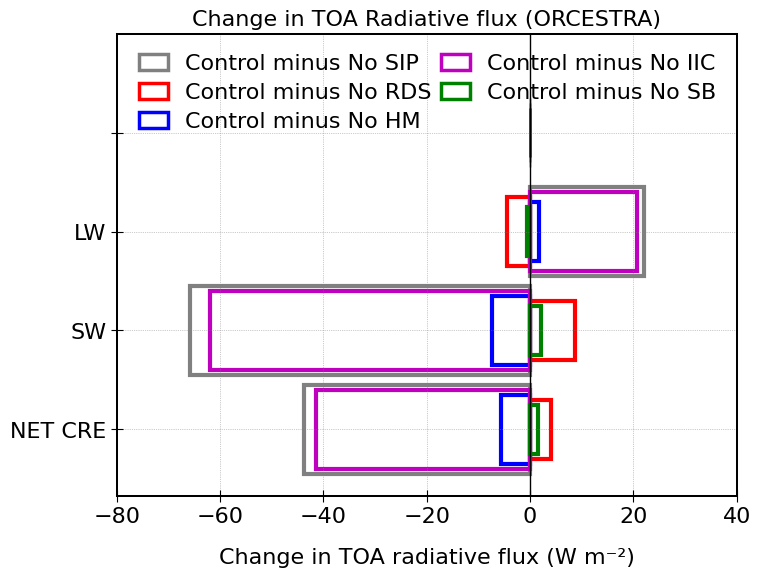

In [20]:
import matplotlib.pyplot as plt
import numpy as np

fnt = 16.0
ln=3;
x = np.array([1, 2, 3, 4])
#w1, w2, w3, w4, w5 = 0.9, 0.6, 0.7, 0.6, 0.5
w1, w2, w3, w4, w5 = 0.9, 0.8, 0.7, 0.6, 0.5

# Data for bars (assuming they are defined elsewhere in your code)
# Q_glc_lif_acm, Q_mix_lif_acm, Q_ice_lif_acm, etc.

#plt.figure('AIE CLOUDS', figsize=(12, 12))

# Plotting
#plt.figure('AIE CLOUDS')
plt.figure(figsize=(8,6))
plt.style.use('default')

plt.gca().tick_params(axis='both', which='major', labelsize=fnt)
plt.gca().tick_params(axis='both', which='minor', labelsize=fnt)
plt.gca().tick_params(axis='both', direction='inout')
plt.gca().tick_params(axis='both', length=8)


plt.barh(x[0], 0., height=w3, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w4, color='b', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='m', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='g', edgecolor='black')
plt.barh(x[0], 0., height=w5, color='c', edgecolor='black')

# Total CLOUD AIE

plt.barh(x[1], del_mean_toa_lw_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[1], del_mean_toa_lw_cre_norf, height=w3, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[1], del_mean_toa_lw_cre_nohm, height=w4, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[1], del_mean_toa_lw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[1], del_mean_toa_lw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[2], del_mean_toa_sw_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[2], del_mean_toa_sw_cre_norf, height=w4, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[2], del_mean_toa_sw_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[2], del_mean_toa_sw_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[2], del_mean_toa_sw_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')


plt.barh(x[3], del_mean_toa_net_cre_nosip, height=w1, color='k', linewidth=ln, facecolor='none', edgecolor='grey')
plt.barh(x[3], del_mean_toa_net_cre_norf, height=w4, color='r', linewidth=ln, facecolor='none', edgecolor='r')
plt.barh(x[3], del_mean_toa_net_cre_nohm, height=w3, color='b', linewidth=ln, facecolor='none', edgecolor='b')
plt.barh(x[3], del_mean_toa_net_cre_nobr, height=w2, color='m', linewidth=ln, facecolor='none', edgecolor='m')
plt.barh(x[3], del_mean_toa_net_cre_nosb, height=w5, color='g', linewidth=ln, facecolor='none', edgecolor='g')

plt.axvline(x=0, color='k', linewidth=ln-2, linestyle='-')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.xlim(-80.0, 40.0)
#plt.xticks([-12, -8, -4, 0, 4, 8, 12])
plt.yticks(x,['', 'LW', 'SW', 'NET CRE'], fontsize=fnt, rotation=0.)
plt.xlabel('Change in TOA radiative flux (W m⁻²)', fontsize=fnt, labelpad=15)
plt.gca().invert_yaxis()

colors = ['grey', 'r', 'b', 'm', 'g']
labels = ['Control minus No SIP', 'Control minus No RDS', 'Control minus No HM', 'Control minus No IIC', 'Control minus No SB']
hBLG = [plt.bar([0, 0], [0, 0], color=colors[i]) for i in range(len(colors))]
legend=plt.legend(hBLG, labels, loc='best', fontsize=fnt, ncol=2, frameon=False, facecolor='none', 
                  handlelength=1.3, labelspacing=0.4, columnspacing=0.4)
for patch, color in zip(legend.get_patches(), colors):
    patch.set_facecolor('none')      # Transparent fill
    patch.set_edgecolor(color)       # Colored edge
    patch.set_linewidth(ln-0.5) 
    
#plt.tight_layout(pad=-1.0)

plt.title('Change in TOA Radiative flux (ORCESTRA)', fontsize=fnt)
#plt.grid(False)
plt.gca().spines['top'].set_linewidth(1.45)
plt.gca().spines['right'].set_linewidth(1.45)
plt.gca().spines['bottom'].set_linewidth(1.45)
plt.gca().spines['left'].set_linewidth(1.45)

plt.show()


## Web plot of TOA radiative fluxes

In [8]:
import xarray as xr
import numpy as np
import pandas as pd

# List of storm datasets and a standard prefix map
storm_datasets = {
    #'Control': ds_4sip,
    'No SIP': ds_nosip,
    'No RDS': ds_norf,
    'No HM': ds_nohm,
    'No IIC': ds_nobr,
    'No SB': ds_nosb
}

def extract_features(ds, prefix):
    def safe_stat(var, func):
        return func(ds[var].values[np.isfinite(ds[var].values)])
    
    return {
        'SW$_{min}$': safe_stat(f'del_toa_sw_cre', np.min),
        'SW$_{max}$': safe_stat(f'del_toa_sw_cre', np.max),
        'SW$_{mean}$': safe_stat(f'del_toa_sw_cre', np.mean),
        'LW$_{min}$': safe_stat(f'del_toa_lw_cre', np.min),
        'LW$_{max}$': safe_stat(f'del_toa_lw_cre', np.max),
        'LW$_{mean}$': safe_stat(f'del_toa_lw_cre', np.mean),
        'NET CRE$_{min}$': safe_stat(f'del_toa_net_cre', np.min),
        'NET CRE$_{mean}$': safe_stat(f'del_toa_net_cre', np.mean)#,
        #'PEAK_SW_time': np.nanargmin(ds[f'toa_sw_cre_4sip'].values),
        #'PEAK_LW_time': np.nanargmax(ds[f'toa_lw_cre_4sip'].values)
    }

features = []
labels = []

for name, ds in storm_datasets.items():
    feats = extract_features(ds, name)
    features.append(feats)
    labels.append(name.upper())

df = pd.DataFrame(features, index=labels)


In [9]:
df

,SW$_{min}$,SW$_{max}$,SW$_{mean}$,LW$_{min}$,LW$_{max}$,LW$_{mean}$,NET CRE$_{min}$,NET CRE$_{mean}$
NO SIP,-252.759705,0.000000,-65.812500,0.000000,46.847336,22.030037,-227.401550,-43.782459
NO RDS,0.000000,48.987549,8.656152,-11.147705,0.180191,-4.526851,-11.147705,4.129301
NO HM,-46.499146,2.456192,-7.343190,-2.610046,11.167007,1.825561,-40.527649,-5.517629
NO IIC,-229.241821,0.000000,-62.000050,0.000000,42.098816,20.620346,-203.421753,-41.379704
NO SB,-3.564880,15.765015,2.193976,-4.246613,1.363846,-0.628029,-4.246613,1.565947


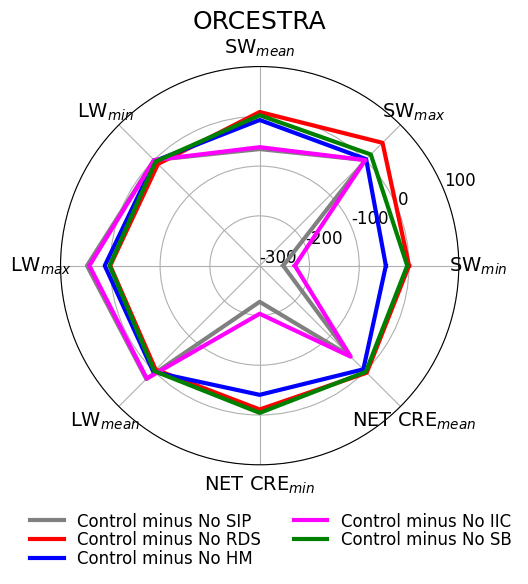

In [11]:
import matplotlib.pyplot as plt
import numpy as np
from math import pi

label_map = {
    "NO SIP": "Control minus No SIP",
    "NO RDS": "Control minus No RDS",
    "NO HM": "Control minus No HM",
    "NO IIC": "Control minus No IIC",
    "NO SB": "Control minus No SB"
}

fnt=14;
ln=3;
def multi_radar_plot(df):#, title="Storm Radiative properties"):
    labels = df.columns
    num_vars = len(labels)

    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += [angles[0]]  # to close the loop

    fig, ax = plt.subplots(figsize=(8, 6), subplot_kw=dict(polar=True))
    plt.style.use('default')
    # Plot each storm
    #colors = plt.cm.tab10.colors  # 10 distinct colors
    custom_colors = {
    #"CONTROL": "black",
    "NO SIP": "grey",
    "NO RDS": "red",
    "NO HM": "blue",
    "NO IIC": "magenta",
    "NO SB": "green"
    }
    for i, (storm_name, row) in enumerate(df.iterrows()):
        values = row.values
        values = np.concatenate([values, [values[0]]])
        color = custom_colors.get(storm_name, "gray")
        #ax.plot(angles, values, label=storm_name, color=colors[i % len(colors)], linewidth=ln)
        #ax.fill(angles, values, alpha=0.0, color=colors[i % len(colors)])
        label = label_map.get(storm_name, storm_name)
        ax.plot(angles, values, label=label, color=color, linewidth=ln)
        ax.fill(angles, values, alpha=0.0, color=color)

    # Axis settings
    ax.set_xticks(angles[:-1])
    ax.tick_params(axis='y', labelsize=fnt)
    #ax.set_rgrids(fontsize=fnt)
    ax.set_xticklabels(labels, fontsize=fnt)
    ax.set_ylim(-300, 100)
    ax.set_yticks([-300, -200, -100, 0, 100])
    ax.set_yticklabels(['-300', '-200', '-100', '0', '100'], fontsize=fnt-2)
    #ax.set_ylim(200, -800)
    #ax.set_yticks([200, 0, -200, -400, -600, -800])
    #ax.set_yticklabels(['-600', '-400', '-200', '0'], fontsize=fnt)
    ax.set_title('ORCESTRA', fontsize=fnt+4)
    ax.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fnt-2, bbox_to_anchor=(1.17, -0.08), ncols=2, loc='best')#frameon=False, loc='best', ncols=1, fontsize=fnt, bbox_to_anchor=(1.2, 1.05))
    plt.tight_layout()
    plt.show()


multi_radar_plot(df)

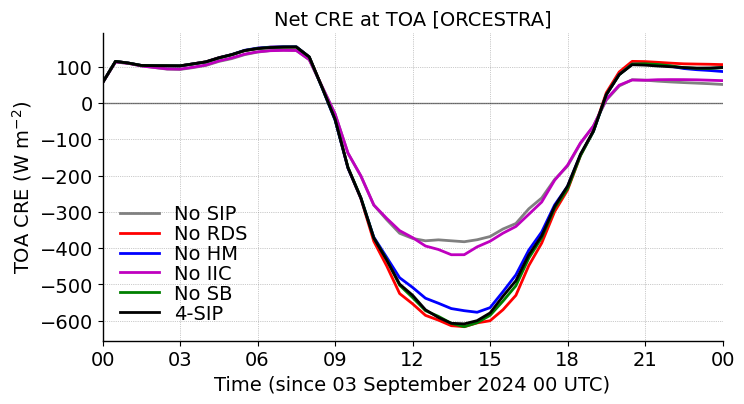

In [46]:
plt.figure(figsize=(8, 4))

lnwdth=2
fontsize=14

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_net_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
#plt.ylim(-700,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('TOA CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)
plt.show()


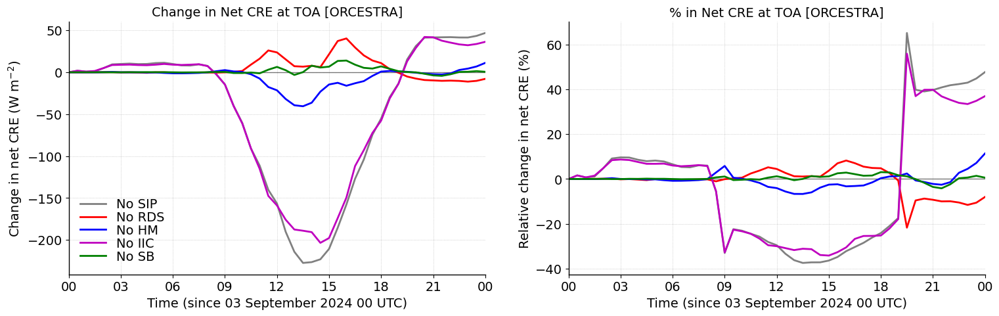

In [47]:
plt.figure(figsize=(18, 5))

lnwdth=2
fontsize=14

plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-50,200)
#plt.yticks([-50, 0, 50, 100, 150, 200], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in net CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_net_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_net_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_net_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_net_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_net_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-20,30)
#plt.yticks([-20, -10, 0, 10, 20, 30], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in net CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% in Net CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(1)
plt.gca().spines['bottom'].set_linewidth(1)

plt.show()


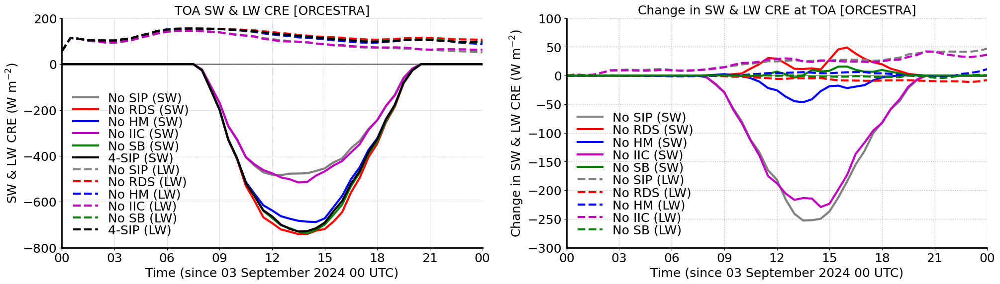

In [17]:


plt.figure(figsize=(24, 6))
plt.style.use('default')

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP (SW)')

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k--', linewidth=lnwdth, label='4-SIP (LW)')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-800,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW & LW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.01, ncols=1, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP (SW)')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS (SW)')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM (SW)')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC (SW)')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB (SW)')

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP (LW)')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r--', linewidth=lnwdth, label='No RDS (LW)')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b--', linewidth=lnwdth, label='No HM (LW)')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm--', linewidth=lnwdth, label='No IIC (LW)')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g--', linewidth=lnwdth, label='No SB (LW)')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.ylim(-300, 100)
#plt.yticks([-8, -6, -4, -2, 0, 2, 4, 6, 8], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW & LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW & LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


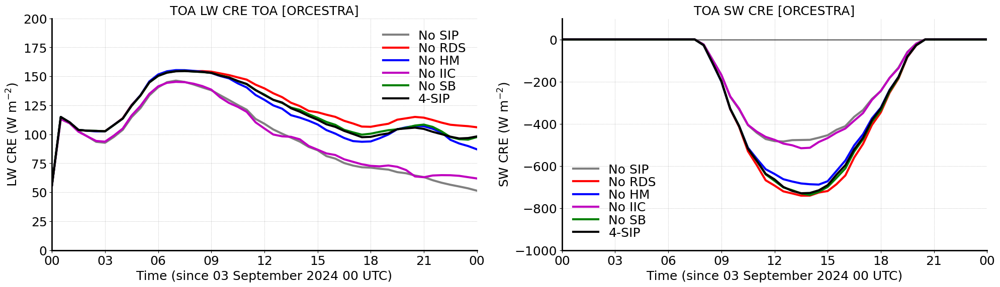

In [49]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-1000,100)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


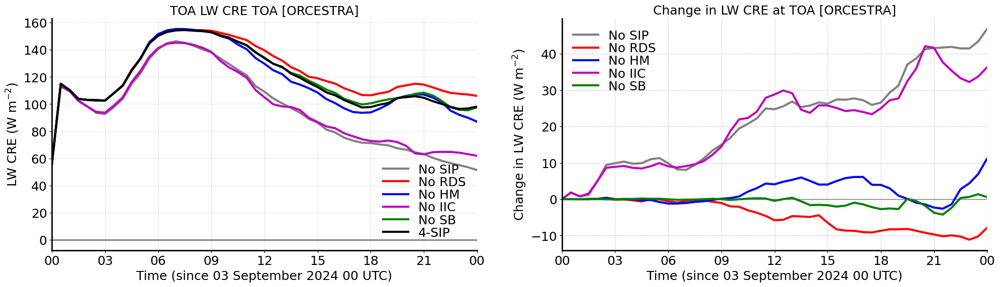

In [50]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_lw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


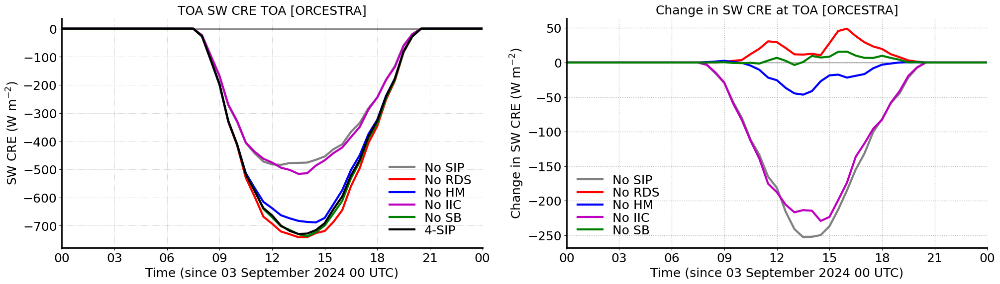

In [51]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time, toa_sw_cre_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(0,200)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.show()


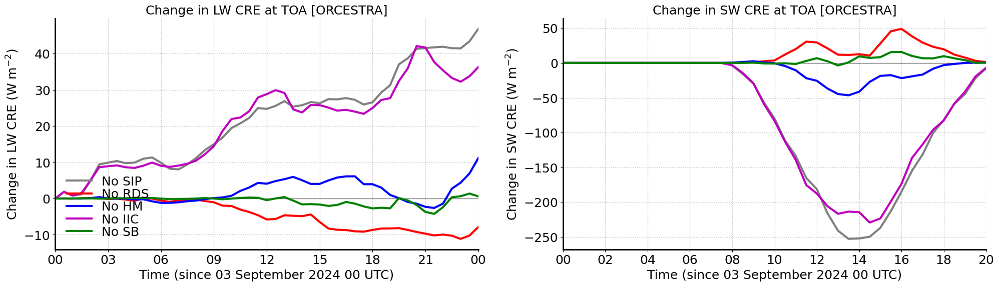

In [52]:

plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-30, 5)
#plt.yticks([-30, -25, -20, -15, -10, -5, 0, 5], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in LW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
#plt.ylim(-50,300)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('Change in SW CRE at TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')

#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')

plt.grid(True, linestyle=':', linewidth=1, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


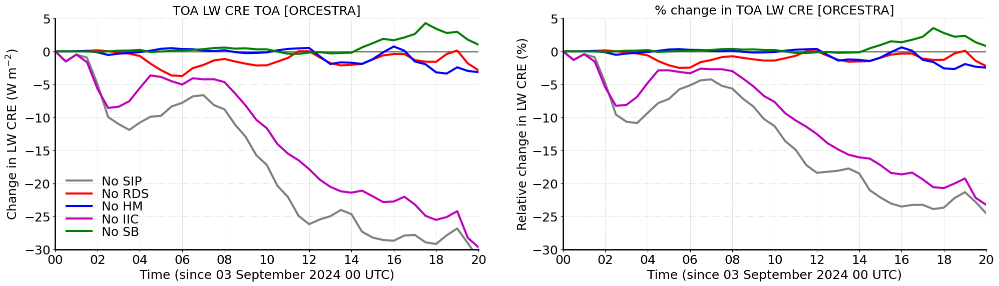

In [33]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-30, 5)
#plt.yticks([-14, -12, -10, -8, -6, -4, -2, 0, 2], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in LW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA LW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_lw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_lw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_lw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_lw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_lw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-30,5)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in LW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA LW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


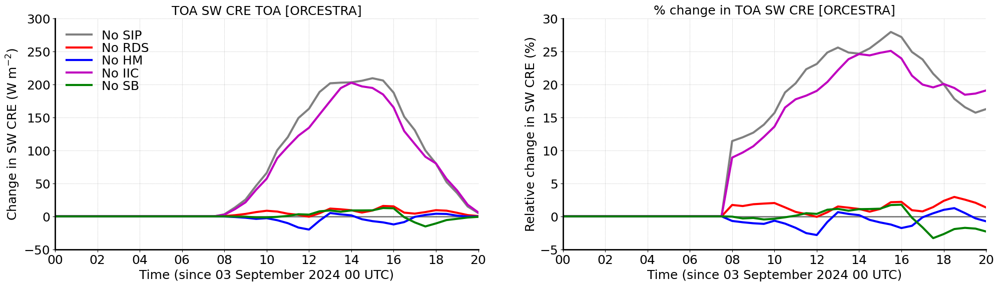

In [36]:


plt.figure(figsize=(24, 6))

lnwdth=3
fontsize=18

plt.subplot(1,2,1)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-50, 300)
plt.yticks(fontsize=fontsize)
#plt.yticks([-8, -4, 0, 4, 8, 12, 16, 20], fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in SW CRE (W m$^{-2}$)', fontsize=fontsize)#, fontweight='bold')
plt.title('TOA SW CRE TOA [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axhline(y=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

plt.plot(ds_nosip.time, per_del_toa_sw_cre_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, per_del_toa_sw_cre_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(ds_nohm.time, per_del_toa_sw_cre_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, per_del_toa_sw_cre_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, per_del_toa_sw_cre_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)

plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-5,30)
plt.yticks(fontsize=fontsize)
plt.ylabel('Relative change in SW CRE (%)', fontsize=fontsize)#, fontweight='bold')
plt.title('% change in TOA SW CRE [ORCESTRA]', fontsize=fontsize)#, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey',alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


## Radiative Heating Rates

In [53]:
# LW/SW heating rate with No SIP
mean_lwr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosip = 86400.*ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosip = mean_lwr_kperd_nosip + mean_swr_kperd_nosip

# LW/SW heating rate with 4 SIP
mean_lwr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_4sip = 86400.*ds_4sip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_4sip = mean_lwr_kperd_4sip + mean_swr_kperd_4sip

# LW/SW heating rate with No RF
mean_lwr_kperd_norf = 86400.*ds_norf.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_norf = 86400.*ds_norf.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_norf = mean_lwr_kperd_norf + mean_swr_kperd_norf

# LW/SW heating rate with No HM
mean_lwr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nohm = 86400.*ds_nohm.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nohm = mean_lwr_kperd_nohm + mean_swr_kperd_nohm

# LW/SW heating rate with No IIC
mean_lwr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nobr = 86400.*ds_nobr.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nobr = mean_lwr_kperd_nobr + mean_swr_kperd_nobr

# LW/SW heating rate with No SB
mean_lwr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_swr_kperd_nosb = 86400.*ds_nosb.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_tot_rad_kperd_nosb = mean_lwr_kperd_nosb + mean_swr_kperd_nosb

# Change in tot rad. heating w.r.t. control
del_tot_rad_kperd_norf = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_norf
del_tot_rad_kperd_nohm = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nohm
del_tot_rad_kperd_nobr = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nobr
del_tot_rad_kperd_nosb = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosb
del_tot_rad_kperd_nosip = mean_tot_rad_kperd_4sip-mean_tot_rad_kperd_nosip

# Change in LW rad. heating w.r.t. control
del_lwr_kperd_norf = mean_lwr_kperd_4sip-mean_lwr_kperd_norf
del_lwr_kperd_nohm = mean_lwr_kperd_4sip-mean_lwr_kperd_nohm
del_lwr_kperd_nobr = mean_lwr_kperd_4sip-mean_lwr_kperd_nobr
del_lwr_kperd_nosb = mean_lwr_kperd_4sip-mean_lwr_kperd_nosb
del_lwr_kperd_nosip = mean_lwr_kperd_4sip-mean_lwr_kperd_nosip

# Change in SW rad. heating w.r.t. control
del_swr_kperd_norf = mean_swr_kperd_4sip-mean_swr_kperd_norf
del_swr_kperd_nohm = mean_swr_kperd_4sip-mean_swr_kperd_nohm
del_swr_kperd_nobr = mean_swr_kperd_4sip-mean_swr_kperd_nobr
del_swr_kperd_nosb = mean_swr_kperd_4sip-mean_swr_kperd_nosb
del_swr_kperd_nosip = mean_swr_kperd_4sip-mean_swr_kperd_nosip

mean_tot_rad_kperd_nosip = mean_tot_rad_kperd_nosip.where(mean_tempc_nosip > -70)
mean_tot_rad_kperd_4sip = mean_tot_rad_kperd_4sip.where(mean_tempc_4sip > -70)
mean_tot_rad_kperd_norf = mean_tot_rad_kperd_norf.where(mean_tempc_norf > -70)
mean_tot_rad_kperd_nohm = mean_tot_rad_kperd_nohm.where(mean_tempc_nohm > -70)
mean_tot_rad_kperd_nobr = mean_tot_rad_kperd_nobr.where(mean_tempc_nobr > -70)
mean_tot_rad_kperd_nosb = mean_tot_rad_kperd_nosb.where(mean_tempc_nosb > -70)

In [54]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_rad_kperd_nosip, mean_tot_rad_kperd_4sip, mean_tot_rad_kperd_norf, mean_tot_rad_kperd_nohm, 
             mean_tot_rad_kperd_nobr, mean_tot_rad_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_rad_kperd_nosip = numpy_variables[0]
mean_tot_rad_kperd_4sip = numpy_variables[1]
mean_tot_rad_kperd_norf = numpy_variables[2]
mean_tot_rad_kperd_nohm = numpy_variables[3]
mean_tot_rad_kperd_nobr = numpy_variables[4]
mean_tot_rad_kperd_nosb = numpy_variables[5]


In [55]:

variables = [mean_lwr_kperd_nosip, mean_lwr_kperd_4sip, mean_lwr_kperd_norf, mean_lwr_kperd_nohm, 
             mean_lwr_kperd_nobr, mean_lwr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_lwr_kperd_nosip = numpy_variables[0]
mean_lwr_kperd_4sip = numpy_variables[1]
mean_lwr_kperd_norf = numpy_variables[2]
mean_lwr_kperd_nohm = numpy_variables[3]
mean_lwr_kperd_nobr = numpy_variables[4]
mean_lwr_kperd_nosb = numpy_variables[5]

variables = [mean_swr_kperd_nosip, mean_swr_kperd_4sip, mean_swr_kperd_norf, mean_swr_kperd_nohm, 
             mean_swr_kperd_nobr, mean_swr_kperd_nosb]
numpy_variables = [var.values for var in variables]

mean_swr_kperd_nosip = numpy_variables[0]
mean_swr_kperd_4sip = numpy_variables[1]
mean_swr_kperd_norf = numpy_variables[2]
mean_swr_kperd_nohm = numpy_variables[3]
mean_swr_kperd_nobr = numpy_variables[4]
mean_swr_kperd_nosb = numpy_variables[5]


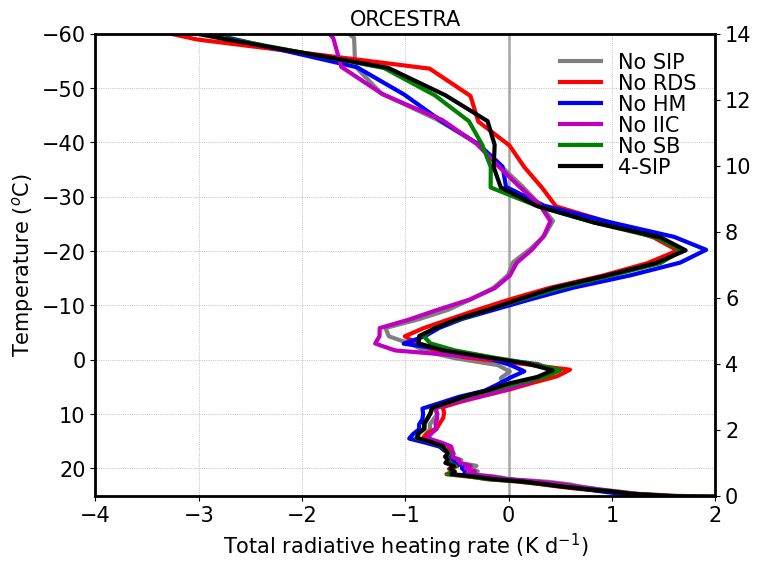

In [58]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_rad_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')  
plt1.plot(mean_tot_rad_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_rad_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_rad_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_rad_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_rad_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-4, 2) 
plt1.set_ylim(25, -60) 
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total radiative heating rate (K d$^{-1}$)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()


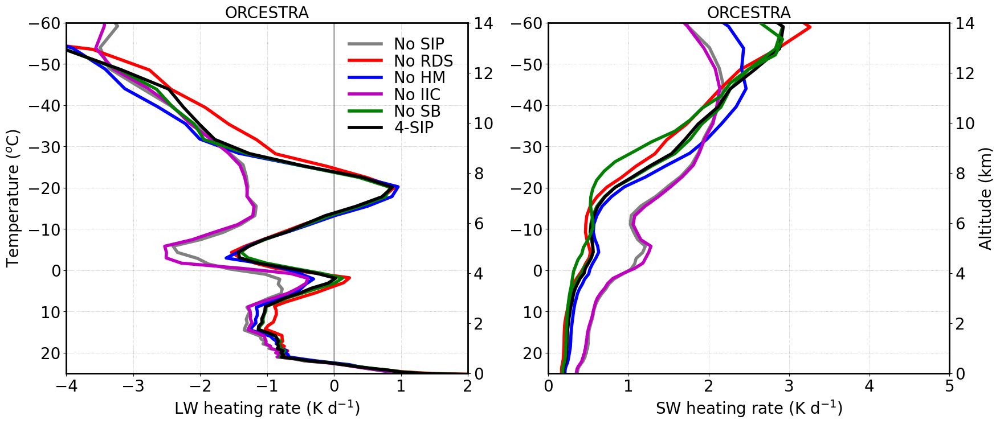

In [59]:

fontsize=20;
lnwdth=4;
alpha=0.8;

plt.figure(figsize=(20, 8))
plt.subplot(1,2,1)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_lwr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_lwr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_lwr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_lwr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_lwr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_lwr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt2.plot(mean_lwr_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.set_xlim(-4., 2)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([-4, -3, -2, -1, 0])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt1.set_xlabel('LW heating rate (K d$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_visible(False)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.subplot(1,2,2)
plt1 = plt.gca()
plt2 = plt1.twinx()

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_swr_kperd_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_swr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_swr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_swr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_swr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_swr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_swr_kperd_nosb, mean_ht_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 5)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 1, 2, 3, 4, 5])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')

plt1.set_xlabel('SW heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)
plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
#plt2.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


# Vertical velocity

In [17]:

thres_q = 0.;

#mean_tot_w_nosip = ds_nosip.w_vel.where(abs(ds_nosip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.where(abs(ds_4sip.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.where(abs(ds_norf.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.where(abs(ds_nohm.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.where(abs(ds_nobr.w_vel) > 0.).mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.where(abs(ds_nosb.w_vel) > 0.).mean(dim=('time','ncells'))

#mean_tot_w_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
#mean_tot_w_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tot_w_nosip = xr.where(ds_nosip.tqi > thres_q, ds_nosip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_4sip = xr.where(ds_4sip.tqi > thres_q, ds_4sip.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_norf = xr.where(ds_norf.tqi > thres_q, ds_norf.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nohm = xr.where(ds_nohm.tqi > thres_q, ds_nohm.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nobr = xr.where(ds_nobr.tqi > thres_q, ds_nobr.w_vel, np.nan).mean(dim=('time','ncells'))
mean_tot_w_nosb = xr.where(ds_nosb.tqi > thres_q, ds_nosb.w_vel, np.nan).mean(dim=('time','ncells'))

del_tot_w_nosip = mean_tot_w_4sip - mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip - mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip - mean_tot_w_nohm
del_tot_w_nobr = mean_tot_w_4sip - mean_tot_w_nobr
del_tot_w_nosb = mean_tot_w_4sip - mean_tot_w_nosb

#mean_tot_w_nosip = mean_tot_w_nosip.where(mean_tempc_nosip > -70)
#mean_tot_w_4sip = mean_tot_w_4sip.where(mean_tempc_4sip > -70)
#mean_tot_w_norf = mean_tot_w_norf.where(mean_tempc_norf > -70)
#mean_tot_w_nohm = mean_tot_w_nohm.where(mean_tempc_nohm > -70)
#mean_tot_w_nobr = mean_tot_w_nobr.where(mean_tempc_nobr > -70)
#mean_tot_w_nosb = mean_tot_w_nosb.where(mean_tempc_nosb > -70)

#del_tot_w_nosip = del_tot_w_nosip.where(mean_tempc_nosip > -70)
#del_tot_w_norf = del_tot_w_norf.where(mean_tempc_norf > -70)
#del_tot_w_nohm = del_tot_w_nohm.where(mean_tempc_nohm > -70)
#del_tot_w_nobr = del_tot_w_nobr.where(mean_tempc_nobr > -70)
#del_tot_w_nosb = del_tot_w_nosb.where(mean_tempc_nosb > -70)

In [18]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_w_nosip, mean_tot_w_4sip, mean_tot_w_norf, mean_tot_w_nohm, mean_tot_w_nobr, mean_tot_w_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_w_nosip = numpy_variables[0]
mean_tot_w_4sip = numpy_variables[1]
mean_tot_w_norf = numpy_variables[2]
mean_tot_w_nohm = numpy_variables[3]
mean_tot_w_nobr = numpy_variables[4]
mean_tot_w_nosb = numpy_variables[5]

In [19]:

del_tot_w_nosip = mean_tot_w_4sip-mean_tot_w_nosip
del_tot_w_norf = mean_tot_w_4sip-mean_tot_w_norf
del_tot_w_nohm = mean_tot_w_4sip-mean_tot_w_nohm 
del_tot_w_nobr = mean_tot_w_4sip-mean_tot_w_nobr 
del_tot_w_nosb = mean_tot_w_4sip-mean_tot_w_nosb 

per_del_tot_w_nosip = 100*del_tot_w_nosip/mean_tot_w_4sip
per_del_tot_w_norf = 100*del_tot_w_norf/mean_tot_w_4sip
per_del_tot_w_nohm = 100*del_tot_w_nohm/mean_tot_w_4sip
per_del_tot_w_nobr = 100*del_tot_w_nobr/mean_tot_w_4sip
per_del_tot_w_nosb = 100*del_tot_w_nosb/mean_tot_w_4sip


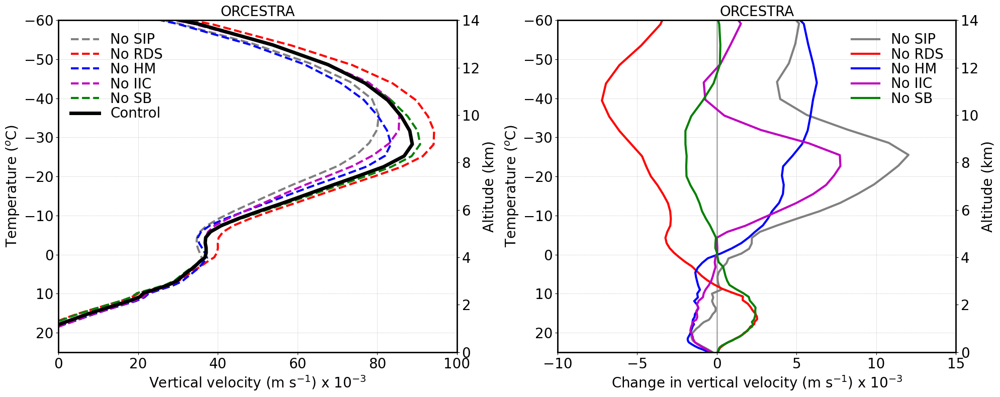

In [21]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r--', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b--', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm--', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g--', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='Control')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 100)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([0, 20, 40, 60, 80, 100, 120, 140])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-10, 15)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-10, -5, 0, 5, 10, 15])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Change in vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


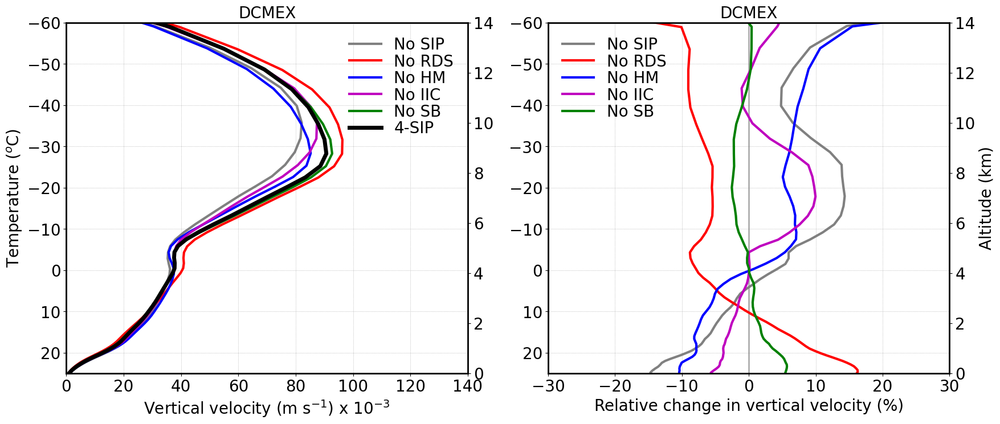

In [72]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.e3
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_w_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 140)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([0, 20, 40, 60, 80, 100, 120, 140])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Vertical velocity (m s$^{-1}$) x 10$^{-3}$', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_w_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_w_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_w_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_w_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_w_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-30, 30)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-30, -20, -10, 0, 10, 20, 30])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in vertical velocity (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('DCMEX', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Cloud cover

In [67]:

mean_tot_cld_cover_nosip = ds_nosip.clc.where(ds_nosip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_4sip = ds_4sip.clc.where(ds_4sip.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_norf = ds_norf.clc.where(ds_norf.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nohm = ds_nohm.clc.where(ds_nohm.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nobr = ds_nobr.clc.where(ds_nobr.tq > 0.).mean(dim=('time','ncells'))
mean_tot_cld_cover_nosb = ds_nosb.clc.where(ds_nosb.tq > 0.).mean(dim=('time','ncells'))


In [68]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_cld_cover_nosip, mean_tot_cld_cover_4sip, mean_tot_cld_cover_norf, mean_tot_cld_cover_nohm, 
             mean_tot_cld_cover_nobr, mean_tot_cld_cover_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_cld_cover_nosip = numpy_variables[0]
mean_tot_cld_cover_4sip = numpy_variables[1]
mean_tot_cld_cover_norf = numpy_variables[2]
mean_tot_cld_cover_nohm = numpy_variables[3]
mean_tot_cld_cover_nobr = numpy_variables[4]
mean_tot_cld_cover_nosb = numpy_variables[5]


In [69]:

del_tot_cld_cover_nosip = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosip 
del_tot_cld_cover_norf = mean_tot_cld_cover_4sip-mean_tot_cld_cover_norf
del_tot_cld_cover_nohm = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nohm 
del_tot_cld_cover_nobr = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nobr 
del_tot_cld_cover_nosb = mean_tot_cld_cover_4sip-mean_tot_cld_cover_nosb 

per_del_tot_cld_cover_nosip = 100*del_tot_cld_cover_nosip/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_norf = 100*del_tot_cld_cover_norf/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nohm = 100*del_tot_cld_cover_nohm/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nobr = 100*del_tot_cld_cover_nobr/mean_tot_cld_cover_4sip
per_del_tot_cld_cover_nosb = 100*del_tot_cld_cover_nosb/mean_tot_cld_cover_4sip


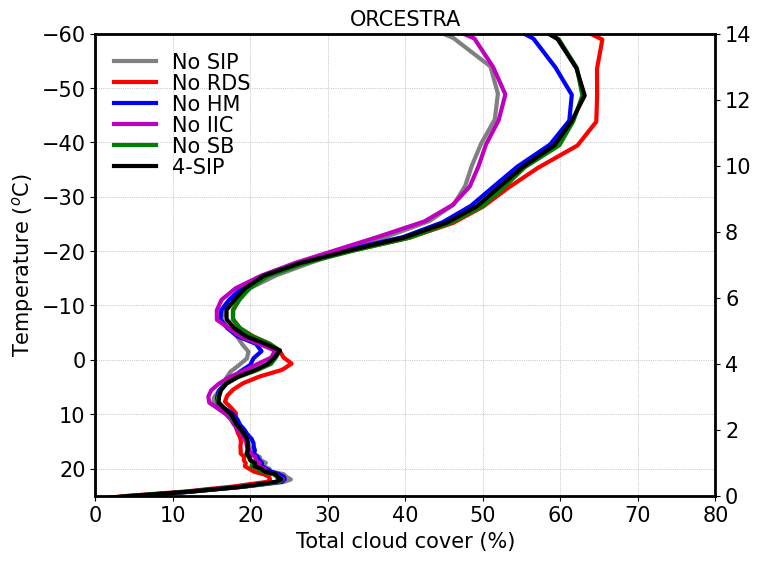

In [70]:
fontsize=15; lnwdth=3; alpha=0.6;

plt.figure(figsize=(8, 6)) 

plt1=plt.gca() 
plt2=plt1.twinx() 

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6) 

plt1.plot(mean_tot_cld_cover_nosip, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP') 
plt1.plot(mean_tot_cld_cover_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS') 
plt1.plot(mean_tot_cld_cover_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM') 
plt1.plot(mean_tot_cld_cover_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC') 
plt1.plot(mean_tot_cld_cover_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP') 

plt2.plot(mean_tot_rad_kperd_nosb, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 80) 
plt1.set_ylim(25, -60) 
plt2.set_ylim(0, 14)

#plt1.set_xticks([-2, -1, 0, 1, 2]) 
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60]) 
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize) 
plt1.tick_params(axis='y', labelsize=fontsize) 
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize) 
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend() 
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2) 
plt1.spines['right'].set_linewidth(2) 
plt1.spines['left'].set_linewidth(2) 
plt1.spines['bottom'].set_linewidth(2) 
plt.show()

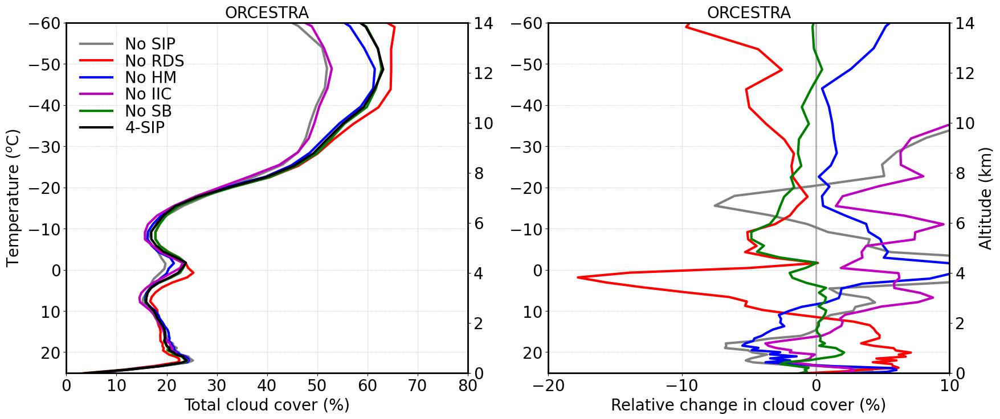

In [74]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_cld_cover_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_w_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(0, 80)
plt1.set_ylim(25, -60)
plt2.set_ylim(0., 14)

plt1.set_xticks([0, 10, 20, 30, 40, 50 ,60, 70, 80])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total cloud cover (%)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_del_tot_cld_cover_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(per_del_tot_cld_cover_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(per_del_tot_cld_cover_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(per_del_tot_cld_cover_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(per_del_tot_cld_cover_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(per_del_tot_w_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xlim(-20, 10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([-20, -10, 0, 10])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Relative change in cloud cover (%)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Surface rainfall

In [18]:
acc_precip_nosip = ds_nosip.tot_prec.mean('ncells')
acc_precip_4sip = ds_4sip.tot_prec.mean('ncells')
acc_precip_nohm = ds_nohm.tot_prec.mean('ncells')
acc_precip_nobr = ds_nobr.tot_prec.mean('ncells')
acc_precip_norf = ds_norf.tot_prec.mean('ncells')
acc_precip_nosb = ds_nosb.tot_prec.mean('ncells')

In [19]:
del_prec_nosip = ds_nosip.tot_prec.diff('time')
del_prec_4sip = ds_4sip.tot_prec.diff('time')
del_prec_norf = ds_norf.tot_prec.diff('time')
del_prec_nohm = ds_nohm.tot_prec.diff('time')
del_prec_nobr = ds_nobr.tot_prec.diff('time')
del_prec_nosb = ds_nosb.tot_prec.diff('time')

precip_rate_nosip = del_prec_nosip/0.5
precip_rate_4sip = del_prec_4sip/0.5
precip_rate_norf = del_prec_norf/0.5            # output is over 30 min
precip_rate_nohm = del_prec_nohm/0.5
precip_rate_nobr = del_prec_nobr/0.5
precip_rate_nosb = del_prec_nosb/0.5

# Change in surface precipitation
del_acc_prec_nosip = acc_precip_4sip-acc_precip_nosip  
del_acc_prec_norf = acc_precip_4sip-acc_precip_norf 
del_acc_prec_nohm = acc_precip_4sip-acc_precip_nohm 
del_acc_prec_nobr = acc_precip_4sip-acc_precip_nobr 
del_acc_prec_nosb = acc_precip_4sip-acc_precip_nosb 


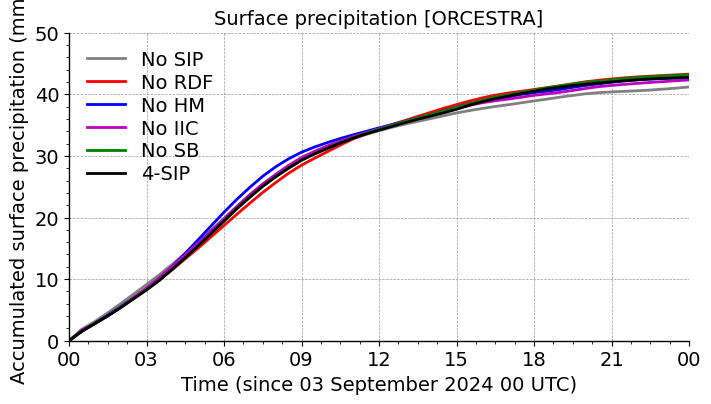

In [20]:


fontsize=14
linwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


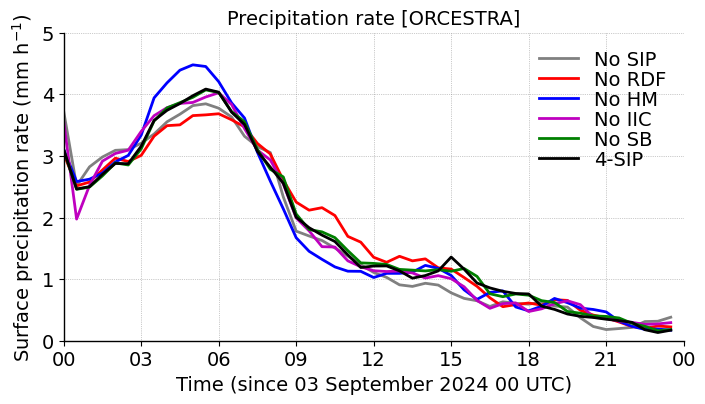

In [22]:


fontsize=14
lnwdth = 2
plt.figure(figsize=(8, 4))

plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 5)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [ORCESTRA]', fontsize=fontsize)
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(1)
plt.gca().spines['left'].set_linewidth(1)

plt.show()


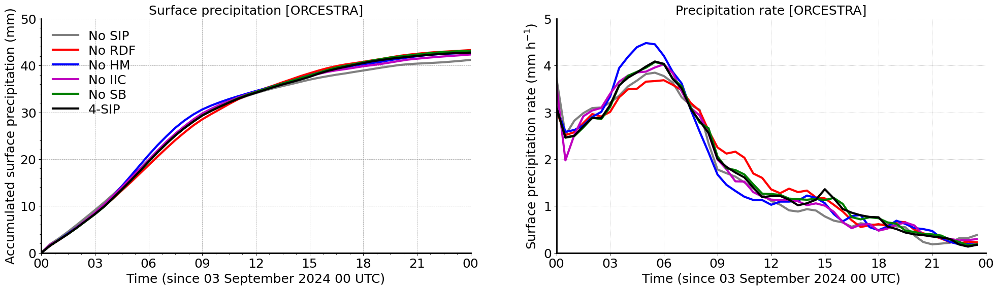

In [77]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time[:-1], precip_rate_nosip.mean('ncells'), '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time[:-1], precip_rate_norf.mean('ncells'), 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time[:-1], precip_rate_nohm.mean('ncells'), 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time[:-1], precip_rate_nobr.mean('ncells'), 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time[:-1], precip_rate_nosb.mean('ncells'), 'g-', linewidth=lnwdth, label='No SB')
plt.plot(ds_4sip.time[:-1], precip_rate_4sip.mean('ncells'), 'k-', linewidth=lnwdth, label='4-SIP')

plt.ylim(0, 5)
plt.ylabel('Surface precipitation rate (mm h$^{-1}$)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate [ORCESTRA]', fontsize=fontsize)
#plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)
plt.show()


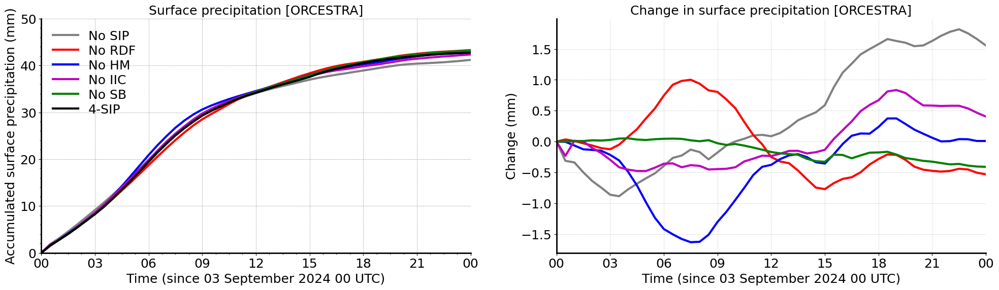

In [78]:


fontsize=18
linwdth = 3
plt.figure(figsize=(24, 6))

plt.subplot(1,2,1)
plt.plot(ds_nosip.time, acc_precip_nosip, "-", color='grey', label="No SIP", linewidth = linwdth)
plt.plot(ds_norf.time, acc_precip_norf, "r-", label="No RDF", linewidth = linwdth)
plt.plot(ds_nohm.time, acc_precip_nohm, "b-", label="No HM", linewidth = linwdth)
plt.plot(ds_nobr.time, acc_precip_nobr, "m-", label="No IIC", linewidth = linwdth)
plt.plot(ds_nosb.time, acc_precip_nosb, "g-", label="No SB", linewidth = linwdth)
plt.plot(ds_4sip.time, acc_precip_4sip, "k-", label="4-SIP", linewidth = linwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=0.5, alpha=0.8)
plt.minorticks_on()
plt.ylim(0, 50)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation [ORCESTRA]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)

plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(ds_nosip.time, del_acc_prec_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(ds_norf.time, del_acc_prec_norf, 'r-', linewidth=lnwdth, label='No RDF')
plt.plot(ds_nohm.time, del_acc_prec_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(ds_nobr.time, del_acc_prec_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(ds_nosb.time, del_acc_prec_nosb, 'g-', linewidth=lnwdth, label='No SB')

#plt.ylim(-5, 5)
plt.ylabel('Change (mm)', fontsize=fontsize)

plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)#+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 4, 0, 0)

plt.xlim(start_date, end_date)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))

plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Change in surface precipitation [ORCESTRA]', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_linewidth(2)
plt.gca().spines['left'].set_linewidth(2)
plt.show()


# Ice number concentrations

In [79]:


thres_w = 2.
mean_tot_inc_up_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_norf = ds_norf.inc_perl.where(ds_norf.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel > thres_w).mean(dim=('time','ncells'))
mean_tot_inc_up_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel > thres_w).mean(dim=('time','ncells'))

mean_tot_inc_dn_nosip = ds_nosip.inc_perl.where(ds_nosip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_4sip = ds_4sip.inc_perl.where(ds_4sip.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_norf = ds_norf.inc_perl.where(ds_norf.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nohm = ds_nohm.inc_perl.where(ds_nohm.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nobr = ds_nobr.inc_perl.where(ds_nobr.w_vel < -1*thres_w).mean(dim=('time','ncells'))
mean_tot_inc_dn_nosb = ds_nosb.inc_perl.where(ds_nosb.w_vel < -1*thres_w).mean(dim=('time','ncells'))



In [80]:
# xarrays takes longer time to plot, convert them to numpy instead

variables = [mean_tot_inc_up_nosip, mean_tot_inc_up_4sip, mean_tot_inc_up_norf, mean_tot_inc_up_nohm, 
             mean_tot_inc_up_nobr, mean_tot_inc_up_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_up_nosip = numpy_variables[0]
mean_tot_inc_up_4sip = numpy_variables[1]
mean_tot_inc_up_norf = numpy_variables[2]
mean_tot_inc_up_nohm = numpy_variables[3]
mean_tot_inc_up_nobr = numpy_variables[4]
mean_tot_inc_up_nosb = numpy_variables[5]


variables = [mean_tot_inc_dn_nosip, mean_tot_inc_dn_4sip, mean_tot_inc_dn_norf, mean_tot_inc_dn_nohm, 
             mean_tot_inc_dn_nobr, mean_tot_inc_dn_nosb]
numpy_variables = [var.values for var in variables]

mean_tot_inc_dn_nosip = numpy_variables[0]
mean_tot_inc_dn_4sip = numpy_variables[1]
mean_tot_inc_dn_norf = numpy_variables[2]
mean_tot_inc_dn_nohm = numpy_variables[3]
mean_tot_inc_dn_nobr = numpy_variables[4]
mean_tot_inc_dn_nosb = numpy_variables[5]


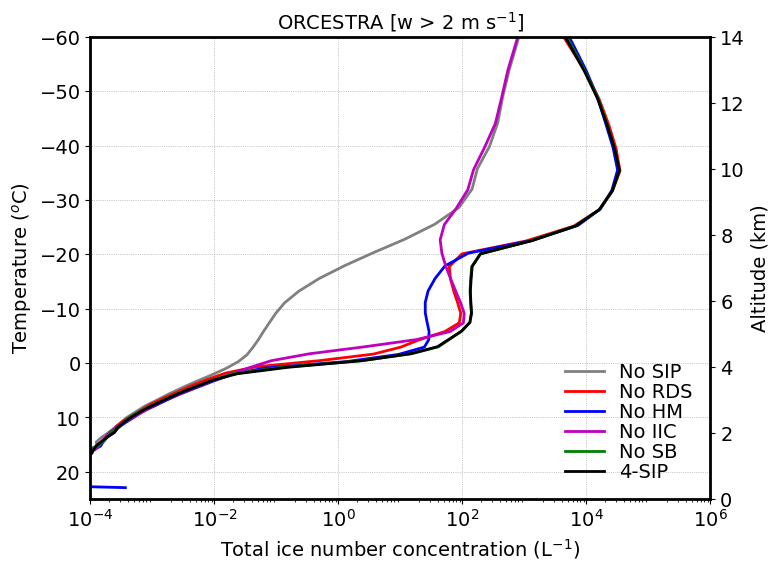

In [88]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.show()


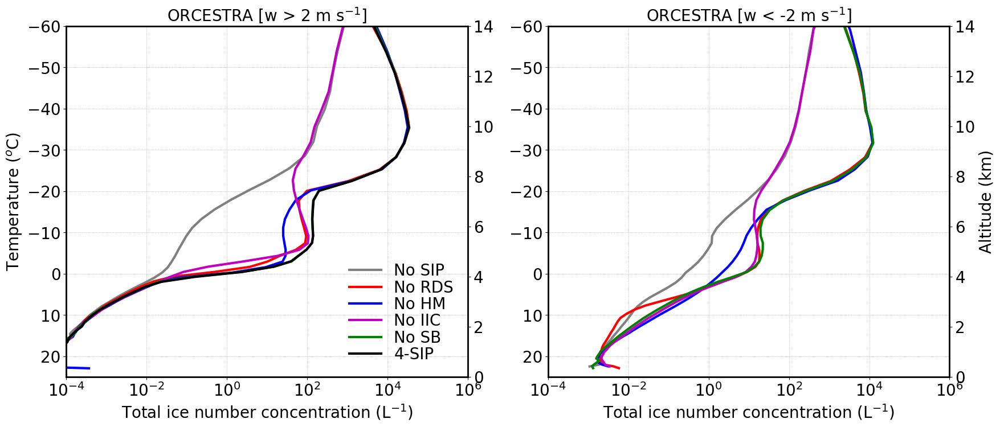

In [86]:


fontsize=20;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_up_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_up_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_up_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_up_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_up_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')
plt1.plot(mean_tot_inc_up_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_tot_inc_up_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA [w > 2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_tot_inc_dn_nosip*fact, mean_tempc_nosip, '-', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_tot_inc_dn_norf*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_tot_inc_dn_nohm*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt1.plot(mean_tot_inc_dn_nobr*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_tot_inc_dn_nosb*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt2.plot(mean_tot_inc_dn_nosb*fact, mean_ht_nobr, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e6)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [w < -2 m s$^{-1}$]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


### Mass and number mixing ratios of hydrometeors

In [12]:

thres_q = 1.e-12

mean_qc_4sip = ds_4sip.qc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_4sip = ds_4sip.qr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_4sip = ds_4sip.qi.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_4sip = ds_4sip.qs.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_4sip = ds_4sip.qg.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_4sip = ds_4sip.qh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_4sip, mean_qr_4sip, mean_qi_4sip, mean_qs_4sip, mean_qg_4sip, mean_qh_4sip]
numpy_variables = [var.values for var in variables]

mean_qc_4sip = numpy_variables[0]
mean_qr_4sip = numpy_variables[1]
mean_qi_4sip = numpy_variables[2]
mean_qs_4sip = numpy_variables[3]
mean_qg_4sip = numpy_variables[4]
mean_qh_4sip = numpy_variables[5]

mean_qnc_4sip = ds_4sip.qnc.where(ds_4sip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_4sip = ds_4sip.qnr.where(ds_4sip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_4sip = ds_4sip.qni.where(ds_4sip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_4sip = ds_4sip.qns.where(ds_4sip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_4sip = ds_4sip.qng.where(ds_4sip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_4sip = ds_4sip.qnh.where(ds_4sip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_4sip, mean_qnr_4sip, mean_qni_4sip, mean_qns_4sip, mean_qng_4sip, mean_qnh_4sip]
numpy_variables = [var.values for var in variables]

mean_qnc_4sip = numpy_variables[0]
mean_qnr_4sip = numpy_variables[1]
mean_qni_4sip = numpy_variables[2]
mean_qns_4sip = numpy_variables[3]
mean_qng_4sip = numpy_variables[4]
mean_qnh_4sip = numpy_variables[5]


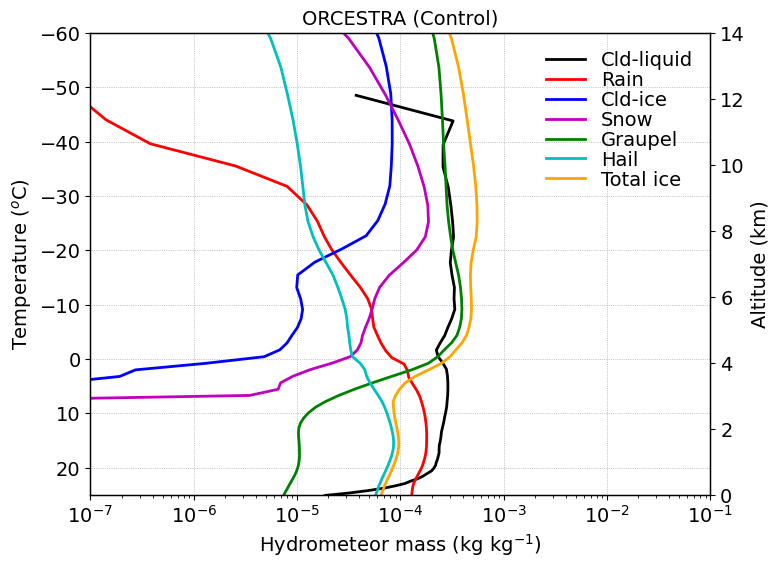

In [39]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)

fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-7, 1.e-1)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()


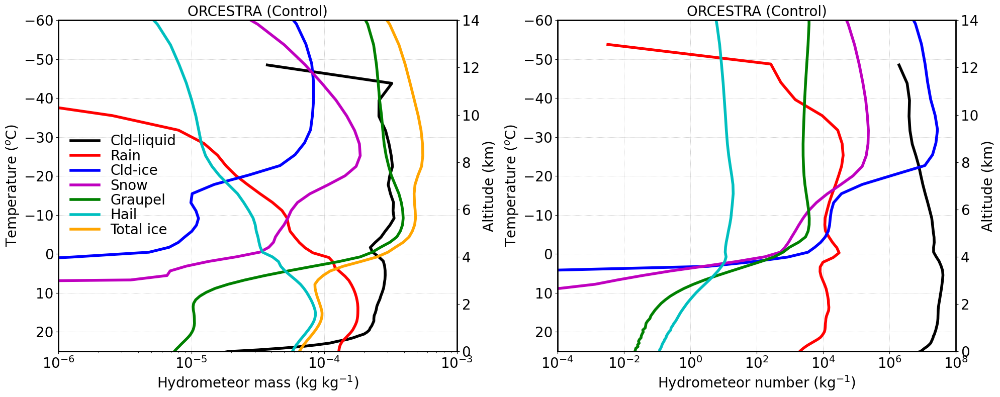

In [27]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-6, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_4sip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_4sip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_4sip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_4sip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e8)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)

plt.tight_layout()
plt.show()


In [12]:

thres_q = 1.e-12

mean_qc_nosip = ds_nosip.qc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosip = ds_nosip.qr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosip = ds_nosip.qi.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosip = ds_nosip.qs.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosip = ds_nosip.qg.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosip = ds_nosip.qh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosip, mean_qr_nosip, mean_qi_nosip, mean_qs_nosip, mean_qg_nosip, mean_qh_nosip]
numpy_variables = [var.values for var in variables]

mean_qc_nosip = numpy_variables[0]
mean_qr_nosip = numpy_variables[1]
mean_qi_nosip = numpy_variables[2]
mean_qs_nosip = numpy_variables[3]
mean_qg_nosip = numpy_variables[4]
mean_qh_nosip = numpy_variables[5]

mean_qnc_nosip = ds_nosip.qnc.where(ds_nosip.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosip = ds_nosip.qnr.where(ds_nosip.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosip = ds_nosip.qni.where(ds_nosip.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosip = ds_nosip.qns.where(ds_nosip.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosip = ds_nosip.qng.where(ds_nosip.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosip = ds_nosip.qnh.where(ds_nosip.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosip, mean_qnr_nosip, mean_qni_nosip, mean_qns_nosip, mean_qng_nosip, mean_qnh_nosip]
numpy_variables = [var.values for var in variables]

mean_qnc_nosip = numpy_variables[0]
mean_qnr_nosip = numpy_variables[1]
mean_qni_nosip = numpy_variables[2]
mean_qns_nosip = numpy_variables[3]
mean_qng_nosip = numpy_variables[4]
mean_qnh_nosip = numpy_variables[5]


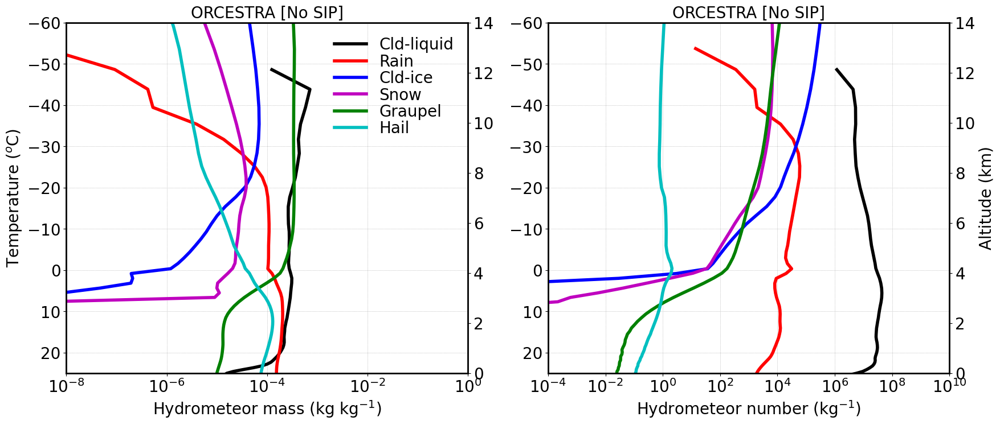

In [13]:


mean_tqi_nosip = np.nansum([mean_qi_nosip,mean_qs_nosip,mean_qg_nosip,mean_qh_nosip], axis=0)

fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_nosip*fact, mean_tempc_nosip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosip*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosip*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosip*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosip*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


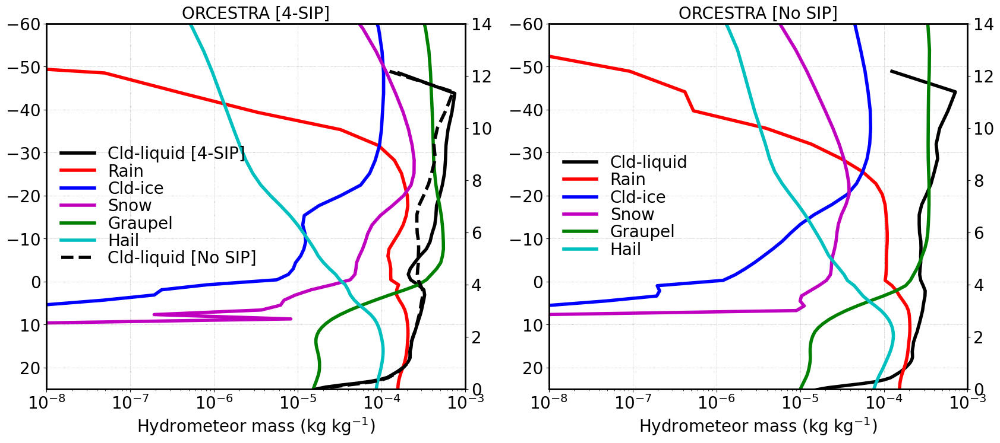

In [26]:

mean_tqi_4sip = np.nansum([mean_qi_4sip,mean_qs_4sip,mean_qg_4sip,mean_qh_4sip], axis=0)
mean_tqi_nosip = np.nansum([mean_qi_nosip,mean_qs_nosip,mean_qg_nosip,mean_qh_nosip], axis=0)

fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='Cld-liquid [4-SIP]')
plt1.plot(mean_qr_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt1.plot(mean_qc_4sip*fact, mean_tempc_4sip, 'k--', linewidth=lnwdth, label='Cld-liquid [No SIP]')

plt2.plot(mean_qh_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [4-SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)



plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosip*fact, mean_tempc_nosip, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosip*fact, mean_tempc_nosip, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosip*fact, mean_tempc_nosip, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosip*fact, mean_tempc_nosip, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosip*fact, mean_tempc_nosip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosip*fact, mean_tempc_nosip, 'c-', linewidth=lnwdth, label='Hail')
plt1.plot(mean_tqi_nosip*fact, mean_tempc_nosip, '-', color='orange', linewidth=lnwdth, label='Total ice')

plt2.plot(mean_qh_4sip*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e-3)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SIP]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [30]:
print(mean_tempc_4sip)
print(mean_qc_nosip-mean_qc_4sip)
print()
print(100*(mean_qc_nosip-mean_qc_4sip)/mean_qc_4sip)

[-64.11463    -71.0595     -79.17266    -76.77152    -72.620636
 -68.711105   -64.192184   -58.8995     -53.580677   -48.532993
 -43.778416   -39.382874   -35.339413   -31.642221   -28.245401
 -25.187431   -22.452347   -19.996225   -17.65675    -15.365664
 -13.184917   -11.161037    -9.274622    -7.5398364   -5.9204917
  -4.3918433   -2.9827352   -1.66251     -0.40766516   0.74917555
   1.9210182    3.1262739    4.341495     5.5112567    6.62047
   7.685756     8.7003975    9.67859     10.628353    11.552832
  12.435058    13.263919    14.050942    14.816273    15.542435
  16.222034    16.879282    17.523832    18.146746    18.75318
  19.331327    19.88926     20.413582    20.91575     21.390892
  21.853464    22.300392    22.751839    23.197172    23.640087
  24.088024    24.53992     24.98477     25.388887    25.748495  ]
[            nan             nan             nan             nan
             nan             nan             nan             nan
             nan -3.61723796e-05 -

In [89]:
thres_q = 1.e-12

mean_qc_norf = ds_norf.qc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_norf = ds_norf.qr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_norf = ds_norf.qi.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_norf = ds_norf.qs.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_norf = ds_norf.qg.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_norf = ds_norf.qh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_norf, mean_qr_norf, mean_qi_norf, mean_qs_norf, mean_qg_norf, mean_qh_norf]
numpy_variables = [var.values for var in variables]

mean_qc_norf = numpy_variables[0]
mean_qr_norf = numpy_variables[1]
mean_qi_norf = numpy_variables[2]
mean_qs_norf = numpy_variables[3]
mean_qg_norf = numpy_variables[4]
mean_qh_norf = numpy_variables[5]

mean_qnc_norf = ds_norf.qnc.where(ds_norf.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_norf = ds_norf.qnr.where(ds_norf.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_norf = ds_norf.qni.where(ds_norf.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_norf = ds_norf.qns.where(ds_norf.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_norf = ds_norf.qng.where(ds_norf.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_norf = ds_norf.qnh.where(ds_norf.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_norf, mean_qnr_norf, mean_qni_norf, mean_qns_norf, mean_qng_norf, mean_qnh_norf]
numpy_variables = [var.values for var in variables]

mean_qnc_norf = numpy_variables[0]
mean_qnr_norf = numpy_variables[1]
mean_qni_norf = numpy_variables[2]
mean_qns_norf = numpy_variables[3]
mean_qng_norf = numpy_variables[4]
mean_qnh_norf = numpy_variables[5]

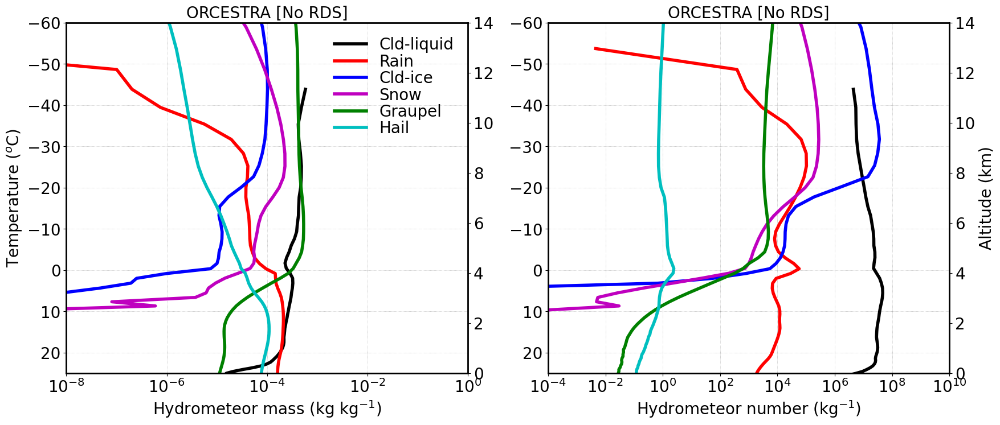

In [90]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_norf*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_norf*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_norf*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_norf*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_norf*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_norf*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_norf*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No RDS]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [91]:
thres_q = 1.e-12

mean_qc_nohm = ds_nohm.qc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nohm = ds_nohm.qr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nohm = ds_nohm.qi.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nohm = ds_nohm.qs.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nohm = ds_nohm.qg.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nohm = ds_nohm.qh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nohm, mean_qr_nohm, mean_qi_nohm, mean_qs_nohm, mean_qg_nohm, mean_qh_nohm]
numpy_variables = [var.values for var in variables]

mean_qc_nohm = numpy_variables[0]
mean_qr_nohm = numpy_variables[1]
mean_qi_nohm = numpy_variables[2]
mean_qs_nohm = numpy_variables[3]
mean_qg_nohm = numpy_variables[4]
mean_qh_nohm = numpy_variables[5]

mean_qnc_nohm = ds_nohm.qnc.where(ds_nohm.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nohm = ds_nohm.qnr.where(ds_nohm.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nohm = ds_nohm.qni.where(ds_nohm.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nohm = ds_nohm.qns.where(ds_nohm.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nohm = ds_nohm.qng.where(ds_nohm.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nohm = ds_nohm.qnh.where(ds_nohm.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nohm, mean_qnr_nohm, mean_qni_nohm, mean_qns_nohm, mean_qng_nohm, mean_qnh_nohm]
numpy_variables = [var.values for var in variables]

mean_qnc_nohm = numpy_variables[0]
mean_qnr_nohm = numpy_variables[1]
mean_qni_nohm = numpy_variables[2]
mean_qns_nohm = numpy_variables[3]
mean_qng_nohm = numpy_variables[4]
mean_qnh_nohm = numpy_variables[5]

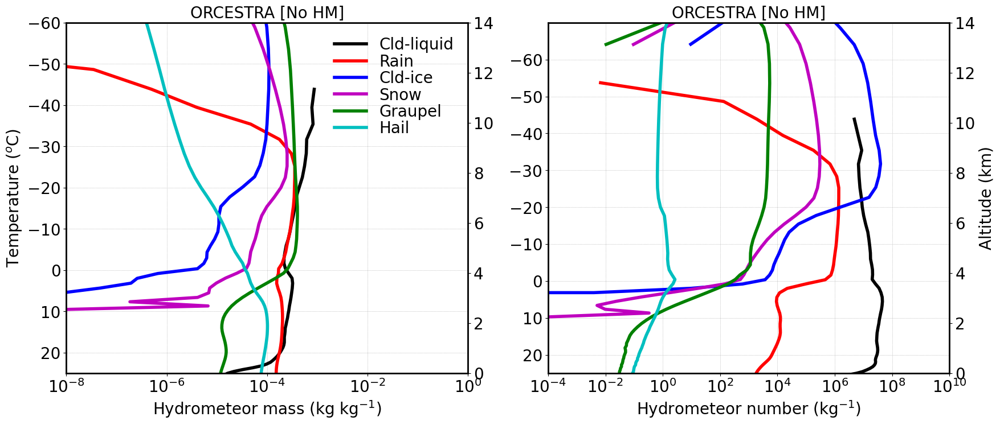

In [92]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nohm*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nohm*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nohm*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nohm*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nohm*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nohm*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nohm*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No HM]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [93]:
thres_q = 1.e-12

mean_qc_nobr = ds_nobr.qc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nobr = ds_nobr.qr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nobr = ds_nobr.qi.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nobr = ds_nobr.qs.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nobr = ds_nobr.qg.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nobr = ds_nobr.qh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nobr, mean_qr_nobr, mean_qi_nobr, mean_qs_nobr, mean_qg_nobr, mean_qh_nobr]
numpy_variables = [var.values for var in variables]

mean_qc_nobr = numpy_variables[0]
mean_qr_nobr = numpy_variables[1]
mean_qi_nobr = numpy_variables[2]
mean_qs_nobr = numpy_variables[3]
mean_qg_nobr = numpy_variables[4]
mean_qh_nobr = numpy_variables[5]

mean_qnc_nobr = ds_nobr.qnc.where(ds_nobr.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nobr = ds_nobr.qnr.where(ds_nobr.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nobr = ds_nobr.qni.where(ds_nobr.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nobr = ds_nobr.qns.where(ds_nobr.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nobr = ds_nobr.qng.where(ds_nobr.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nobr = ds_nobr.qnh.where(ds_nobr.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nobr, mean_qnr_nobr, mean_qni_nobr, mean_qns_nobr, mean_qng_nobr, mean_qnh_nobr]
numpy_variables = [var.values for var in variables]

mean_qnc_nobr = numpy_variables[0]
mean_qnr_nobr = numpy_variables[1]
mean_qni_nobr = numpy_variables[2]
mean_qns_nobr = numpy_variables[3]
mean_qng_nobr = numpy_variables[4]
mean_qnh_nobr = numpy_variables[5]


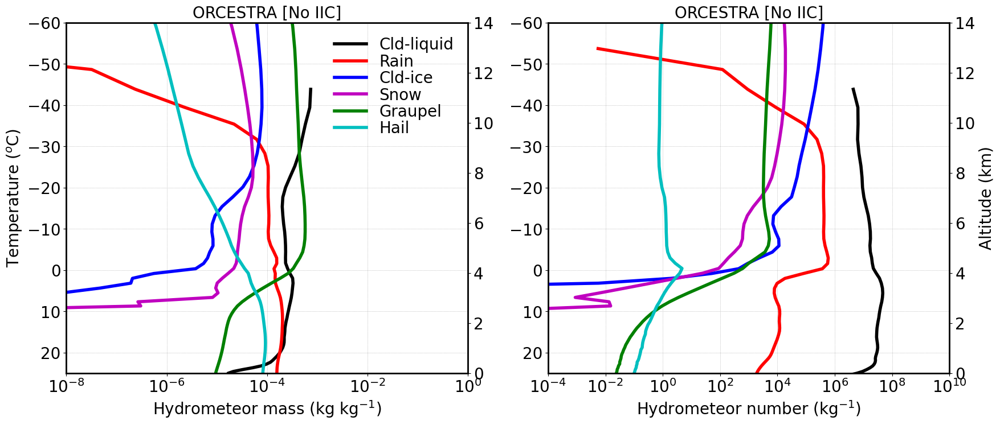

In [94]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nobr*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nobr*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nobr*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nobr*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nobr*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nobr*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nobr*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No IIC]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


In [95]:
thres_q = 1.e-12

mean_qc_nosb = ds_nosb.qc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qr_nosb = ds_nosb.qr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qi_nosb = ds_nosb.qi.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qs_nosb = ds_nosb.qs.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qg_nosb = ds_nosb.qg.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qh_nosb = ds_nosb.qh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qc_nosb, mean_qr_nosb, mean_qi_nosb, mean_qs_nosb, mean_qg_nosb, mean_qh_nosb]
numpy_variables = [var.values for var in variables]

mean_qc_nosb = numpy_variables[0]
mean_qr_nosb = numpy_variables[1]
mean_qi_nosb = numpy_variables[2]
mean_qs_nosb = numpy_variables[3]
mean_qg_nosb = numpy_variables[4]
mean_qh_nosb = numpy_variables[5]

mean_qnc_nosb = ds_nosb.qnc.where(ds_nosb.qc > thres_q).mean(dim=('time','ncells'))
mean_qnr_nosb = ds_nosb.qnr.where(ds_nosb.qr > thres_q).mean(dim=('time','ncells'))
mean_qni_nosb = ds_nosb.qni.where(ds_nosb.qi > thres_q).mean(dim=('time','ncells'))
mean_qns_nosb = ds_nosb.qns.where(ds_nosb.qs > thres_q).mean(dim=('time','ncells'))
mean_qng_nosb = ds_nosb.qng.where(ds_nosb.qg > thres_q).mean(dim=('time','ncells'))
mean_qnh_nosb = ds_nosb.qnh.where(ds_nosb.qh > thres_q).mean(dim=('time','ncells'))

variables = [mean_qnc_nosb, mean_qnr_nosb, mean_qni_nosb, mean_qns_nosb, mean_qng_nosb, mean_qnh_nosb]
numpy_variables = [var.values for var in variables]

mean_qnc_nosb = numpy_variables[0]
mean_qnr_nosb = numpy_variables[1]
mean_qni_nosb = numpy_variables[2]
mean_qns_nosb = numpy_variables[3]
mean_qng_nosb = numpy_variables[4]
mean_qnh_nosb = numpy_variables[5]

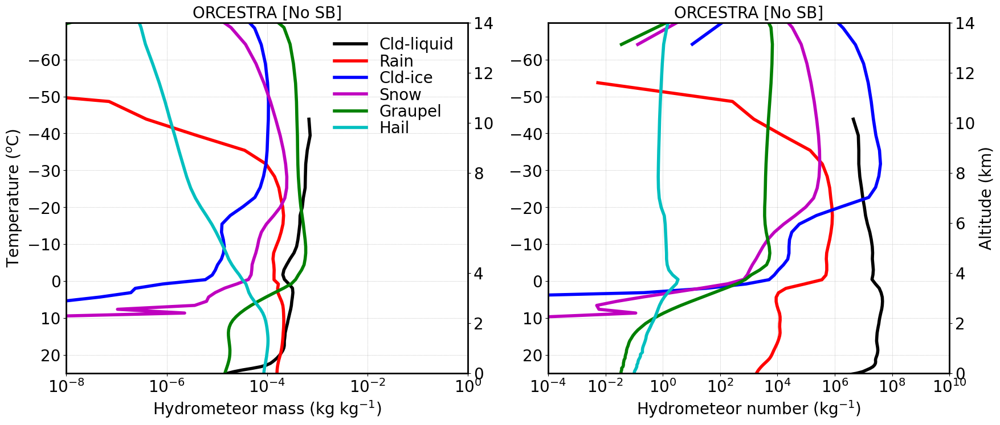

In [96]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qi_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qs_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qg_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-8, 1.e0)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor mass (kg kg$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qnc_nosb*fact, mean_tempc_norf, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt1.plot(mean_qnr_nosb*fact, mean_tempc_nohm, 'r-', linewidth=lnwdth, label='Rain')
plt1.plot(mean_qni_nosb*fact, mean_tempc_nobr, 'b-', linewidth=lnwdth, label='Cld-ice')
plt1.plot(mean_qns_nosb*fact, mean_tempc_nosb, 'm-', linewidth=lnwdth, label='Snow')
plt1.plot(mean_qng_nosb*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='Graupel')
plt1.plot(mean_qnh_nosb*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hail')

plt2.plot(mean_qnh_nosb*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Hydrometeor number (kg$^{-1}$)', fontsize=fontsize)
#plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA [No SB]', fontsize=fontsize)

plt1.spines['top'].set_linewidth(2)
plt1.spines['right'].set_linewidth(2)
plt1.spines['left'].set_linewidth(2)
plt1.spines['bottom'].set_linewidth(2)
plt.show()


# Process rates
### 1. Process rates of SIPs
#### mass and number mixing ratio 

In [6]:


dt_hours = (ds_4sip.time.diff('time') / np.timedelta64(1, 'h'))

thres_q = 1.e-14;
thres_w = 1.;
thres_cond = (ds_4sip.dqi_sec > thres_q) & (ds_4sip.w_vel > thres_w)
mean_qni_tot_sec_4sip = (ds_4sip.dqni_sec.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_rf_4sip = (ds_4sip.dqni_ds.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_hm_4sip = (ds_4sip.dqni_rs.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_br_4sip = (ds_4sip.dqni_br.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = (ds_4sip.dqni_snow_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = (ds_4sip.dqni_graup_sbf.where(thres_cond).diff('time')).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

mean_qni_tot_sec_4sip = mean_qni_tot_sec_4sip/dt_hours.mean('time')
mean_qni_rf_4sip = mean_qni_rf_4sip/dt_hours.mean('time')
mean_qni_hm_4sip = mean_qni_hm_4sip/dt_hours.mean('time')
mean_qni_br_4sip = mean_qni_br_4sip/dt_hours.mean('time')
mean_qni_sb_snow_4sip = mean_qni_sb_snow_4sip/dt_hours.mean('time')
mean_qni_sb_graup_4sip = mean_qni_sb_graup_4sip/dt_hours.mean('time')
mean_qni_sb_4sip = mean_qni_sb_4sip/dt_hours.mean('time')
 


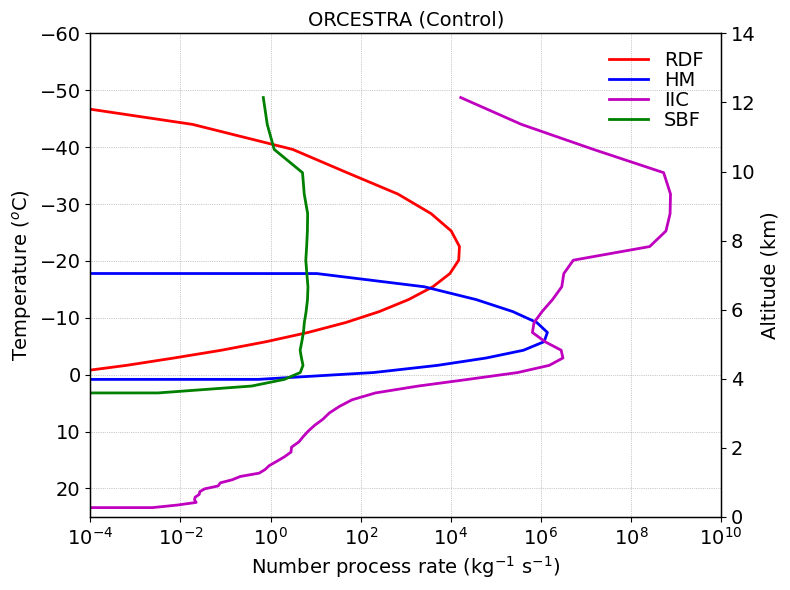

In [16]:


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip/dt_hours*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0.5, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


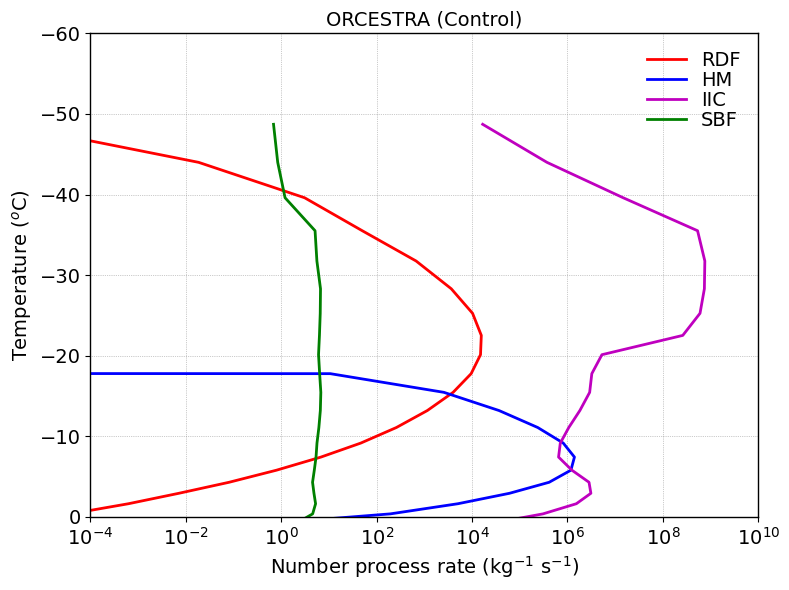

In [7]:

 


fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
#plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_4sip, 'r-', linewidth=lnwdth, label='RDF')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_4sip, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_4sip, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_4sip, 'g-', linewidth=lnwdth, label='SBF')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

#plt2.plot(mean_qni_tot_sec_4sip/dt_hours*fact, mean_tempc_4sip, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(0, -60)
#plt2.set_ylim(0.5, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([0, -10, -20, -30, -40, -50, -60])
#plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
#plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Number process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
#plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('ORCESTRA (Control)', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


In [29]:

thres_q = 1.e-14

mean_qi_homhet_4sip = ds_4sip.d_qi_homhet.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_hom_4sip = ds_4sip.d_qi_hom.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))
mean_qi_het_4sip = ds_4sip.d_qi_het.where(ds_4sip.tqi > thres_q).mean(dim=('time','ncells'))

variables = [mean_qi_homhet_4sip, mean_qi_hom_4sip, mean_qi_het_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_homhet_4sip = numpy_variables[0]
mean_qi_hom_4sip = numpy_variables[1]
mean_qi_het_4sip = numpy_variables[2]

mean_qi_tot_sec_4sip = ds_4sip.dqi_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_rf_4sip = ds_4sip.dqi_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_hm_4sip = ds_4sip.dqi_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_br_4sip = ds_4sip.dqi_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_snow_4sip = ds_4sip.dqi_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_graup_4sip = ds_4sip.dqi_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qi_sb_4sip = mean_qi_sb_snow_4sip + mean_qi_sb_graup_4sip

mean_qni_tot_sec_4sip = ds_4sip.dqni_sec.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_rf_4sip = ds_4sip.dqni_ds.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_hm_4sip = ds_4sip.dqni_rs.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_br_4sip = ds_4sip.dqni_br.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_snow_4sip = ds_4sip.dqni_snow_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_graup_4sip = ds_4sip.dqni_graup_sbf.where(ds_4sip.dqi_sec > thres_q).mean(dim=('time','ncells'))
mean_qni_sb_4sip = mean_qni_sb_snow_4sip + mean_qni_sb_graup_4sip

variables = [mean_qi_tot_sec_4sip, mean_qi_rf_4sip, mean_qi_hm_4sip, mean_qi_br_4sip, mean_qi_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qi_tot_sec_4sip = numpy_variables[0]
mean_qi_rf_4sip = numpy_variables[1]
mean_qi_hm_4sip = numpy_variables[2]
mean_qi_br_4sip = numpy_variables[3]
mean_qi_sb_4sip = numpy_variables[4]

variables = [mean_qni_tot_sec_4sip, mean_qni_rf_4sip, mean_qni_hm_4sip, mean_qni_br_4sip, mean_qni_sb_4sip]
numpy_variables = [var.values for var in variables]

mean_qni_tot_sec_4sip = numpy_variables[0]
mean_qni_rf_4sip = numpy_variables[1]
mean_qni_hm_4sip = numpy_variables[2]
mean_qni_br_4sip = numpy_variables[3]
mean_qni_sb_4sip = numpy_variables[4]

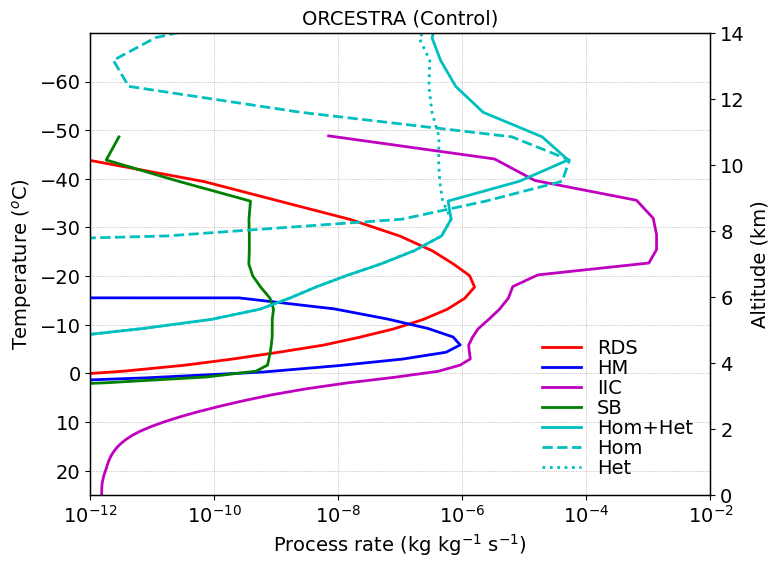

In [30]:
fontsize=14;
lnwdth=2;
alpha=0.6;

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

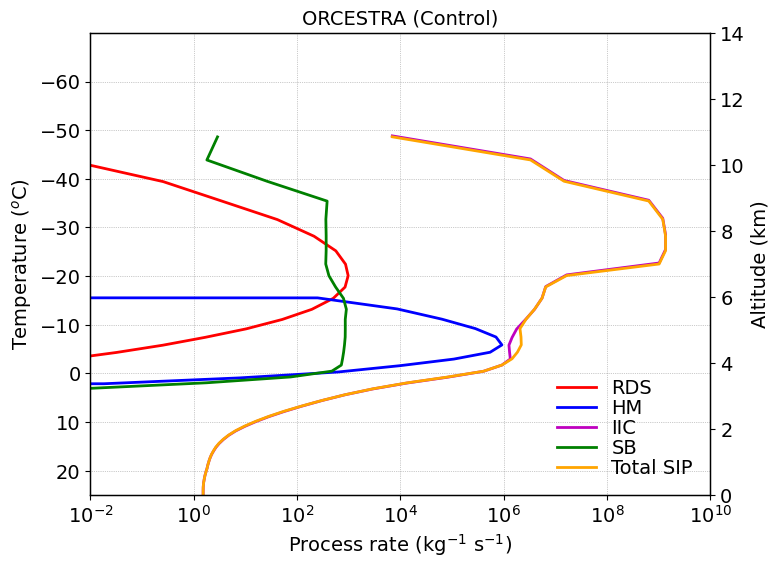

In [33]:
fontsize=14;
lnwdth=2;
alpha=0.6;

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, '-', color='orange', linewidth=lnwdth, label='Total SIP')


#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-2, 1.e10)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

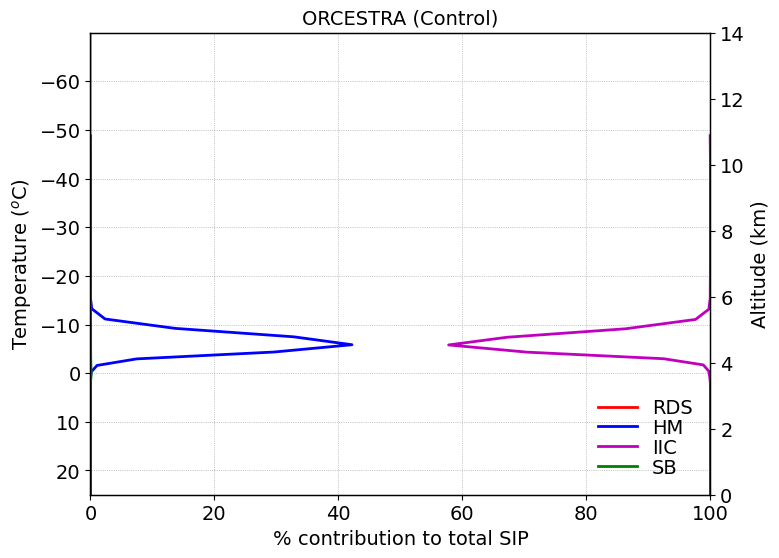

In [38]:
fontsize=14;
lnwdth=2;
alpha=0.6;

mean_qni_tot_sec_4sip = mean_qni_rf_4sip+mean_qni_hm_4sip+mean_qni_br_4sip+mean_qni_sb_4sip

per_qni_rf_4sip = 100*mean_qni_rf_4sip/mean_qni_tot_sec_4sip
per_qni_hm_4sip = 100*mean_qni_hm_4sip/mean_qni_tot_sec_4sip
per_qni_br_4sip = 100*mean_qni_br_4sip/mean_qni_tot_sec_4sip
per_qni_sb_4sip = 100*mean_qni_sb_4sip/mean_qni_tot_sec_4sip

plt.figure(figsize=(8, 6))


plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(per_qni_rf_4sip, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(per_qni_hm_4sip, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(per_qni_br_4sip, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(per_qni_sb_4sip, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')


#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(per_qni_sb_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

#plt1.set_xscale('log')
plt1.set_xlim(0, 1.e2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('% contribution to total SIP', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA (Control)', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.show()

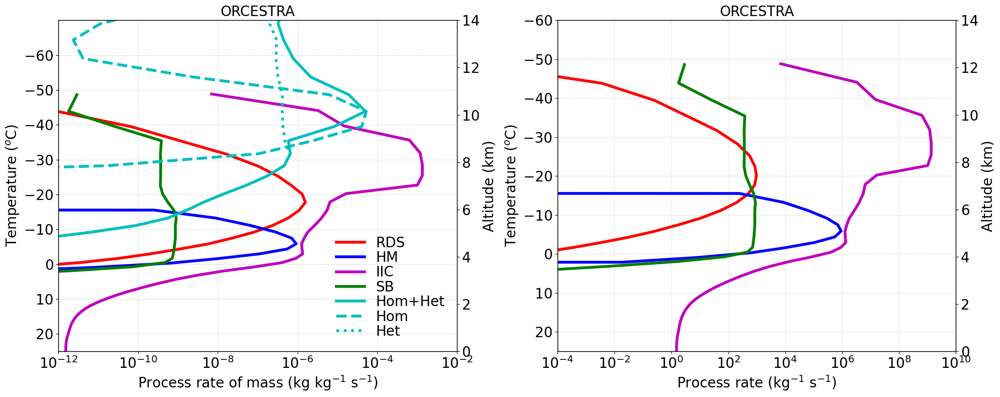

In [112]:


fontsize=20;
lnwdth=4;
alpha=0.6;

plt.figure(figsize=(20, 8))

plt.subplot(1,2,1)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qi_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qi_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qi_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qi_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qi_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')


plt1.plot(mean_qi_homhet_4sip*fact, mean_tempc_4sip, 'c-', linewidth=lnwdth, label='Hom+Het')
plt1.plot(mean_qi_hom_4sip*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')
plt1.plot(mean_qi_het_4sip*fact, mean_tempc_4sip, 'c:', linewidth=lnwdth, label='Het')
#plt1.plot(mean_qi_hom*fact, mean_tempc_4sip, 'c--', linewidth=lnwdth, label='Hom')

plt2.plot(mean_qi_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)#, label='No SB')

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-12, 1.e-2)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate of mass (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower right')

plt.title('ORCESTRA', fontsize=fontsize)


plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)


plt.subplot(1,2,2)

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.

plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_qni_rf_4sip*fact, mean_tempc_norf, 'r-', linewidth=lnwdth, label='RDS')
plt1.plot(mean_qni_hm_4sip*fact, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='HM')
plt1.plot(mean_qni_br_4sip*fact, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='IIC')
plt1.plot(mean_qni_sb_4sip*fact, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='SB')
#plt1.plot(mean_qni_tot_sec_4sip*fact, mean_tempc_4sip, 'k-', linewidth=lnwdth, label='4-SIP')

plt2.plot(mean_qni_tot_sec_4sip*fact, mean_ht_nosb, '-', color='none', linewidth=lnwdth)


plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-4, 1.e10)
plt1.set_ylim(25, -60)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Process rate (kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

#plt1.legend()
#plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')

plt.title('ORCESTRA', fontsize=fontsize)

plt1.spines['top'].set_linewidth(1)
plt1.spines['right'].set_linewidth(1)
plt1.spines['left'].set_linewidth(1)
plt1.spines['bottom'].set_linewidth(1)

plt.tight_layout()
plt.show()


## Process rates of riming, deposition, nucleation, freezing

In [13]:

thres_q = 1.e-8

# Riming
mean_dq_tot_rime_4sip = xr.where(ds_4sip.d_qx_riming > thres_q, ds_4sip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosip = xr.where(ds_nosip.d_qx_riming > thres_q, ds_nosip.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_norf = xr.where(ds_norf.d_qx_riming > thres_q, ds_norf.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nohm = xr.where(ds_nohm.d_qx_riming > thres_q, ds_nohm.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nobr = xr.where(ds_nobr.d_qx_riming > thres_q, ds_nobr.d_qx_riming, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_rime_nosb = xr.where(ds_nosb.d_qx_riming > thres_q, ds_nosb.d_qx_riming, np.nan).mean(dim=('time','ncells'))

# Deposition
mean_dq_tot_dep_4sip = ds_4sip.d_qi_dep+ds_4sip.d_qs_dep+ds_4sip.d_qg_dep+ds_4sip.d_qh_dep
mean_dq_tot_dep_nosip = ds_nosip.d_qi_dep+ds_nosip.d_qs_dep+ds_nosip.d_qg_dep+ds_nosip.d_qh_dep
mean_dq_tot_dep_norf = ds_norf.d_qi_dep+ds_norf.d_qs_dep+ds_norf.d_qg_dep+ds_norf.d_qh_dep
mean_dq_tot_dep_nohm = ds_nohm.d_qi_dep+ds_nohm.d_qs_dep+ds_nohm.d_qg_dep+ds_nohm.d_qh_dep
mean_dq_tot_dep_nobr = ds_nobr.d_qi_dep+ds_nobr.d_qs_dep+ds_nobr.d_qg_dep+ds_nobr.d_qh_dep
mean_dq_tot_dep_nosb = ds_nosb.d_qi_dep+ds_nosb.d_qs_dep+ds_nosb.d_qg_dep+ds_nosb.d_qh_dep

mean_dq_tot_dep_4sip = xr.where(mean_dq_tot_dep_4sip > thres_q, mean_dq_tot_dep_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosip = xr.where(mean_dq_tot_dep_nosip > thres_q, mean_dq_tot_dep_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_norf = xr.where(mean_dq_tot_dep_norf > thres_q, mean_dq_tot_dep_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nohm = xr.where(mean_dq_tot_dep_nohm > thres_q, mean_dq_tot_dep_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nobr = xr.where(mean_dq_tot_dep_nobr > thres_q, mean_dq_tot_dep_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_tot_dep_nosb = xr.where(mean_dq_tot_dep_nosb > thres_q, mean_dq_tot_dep_nosb, np.nan).mean(dim=('time','ncells'))

# Saturation adjustment
mean_dq_satad1_4sip = xr.where(ds_4sip.d_satad > thres_q, ds_4sip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosip = xr.where(ds_nosip.d_satad > thres_q, ds_nosip.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_norf = xr.where(ds_norf.d_satad > thres_q, ds_norf.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nohm = xr.where(ds_nohm.d_satad > thres_q, ds_nohm.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nobr = xr.where(ds_nobr.d_satad > thres_q, ds_nobr.d_satad, np.nan).mean(dim=('time','ncells'))
mean_dq_satad1_nosb = xr.where(ds_nosb.d_satad > thres_q, ds_nosb.d_satad, np.nan).mean(dim=('time','ncells'))

mean_dq_satad2_4sip = xr.where(ds_4sip.d_satad2 > thres_q, ds_4sip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosip = xr.where(ds_nosip.d_satad2 > thres_q, ds_nosip.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_norf = xr.where(ds_norf.d_satad2 > thres_q, ds_norf.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nohm = xr.where(ds_nohm.d_satad2 > thres_q, ds_nohm.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nobr = xr.where(ds_nobr.d_satad2 > thres_q, ds_nobr.d_satad2, np.nan).mean(dim=('time','ncells'))
mean_dq_satad2_nosb = xr.where(ds_nosb.d_satad2 > thres_q, ds_nosb.d_satad2, np.nan).mean(dim=('time','ncells'))

# Hom+het ice nucleation
mean_dq_homhet_4sip = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosip = xr.where(ds_nosip.d_qi_homhet > thres_q, ds_nosip.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_norf = xr.where(ds_norf.d_qi_homhet > thres_q, ds_norf.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nohm = xr.where(ds_nohm.d_qi_homhet > thres_q, ds_nohm.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nobr = xr.where(ds_nobr.d_qi_homhet > thres_q, ds_nobr.d_qi_homhet, np.nan).mean(dim=('time','ncells'))
mean_dq_homhet_nosb = xr.where(ds_nosb.d_qi_homhet > thres_q, ds_nosb.d_qi_homhet, np.nan).mean(dim=('time','ncells'))

# Hom ice nucleation
mean_dq_hom_4sip = xr.where(ds_4sip.d_qi_hom > thres_q, ds_4sip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosip = xr.where(ds_nosip.d_qi_hom > thres_q, ds_nosip.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_norf = xr.where(ds_norf.d_qi_hom > thres_q, ds_norf.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nohm = xr.where(ds_nohm.d_qi_hom > thres_q, ds_nohm.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nobr = xr.where(ds_nobr.d_qi_hom > thres_q, ds_nobr.d_qi_hom, np.nan).mean(dim=('time','ncells'))
mean_dq_hom_nosb = xr.where(ds_nosb.d_qi_hom > thres_q, ds_nosb.d_qi_hom, np.nan).mean(dim=('time','ncells'))

# het ice nucleation
mean_dq_het_4sip = xr.where(ds_4sip.d_qi_het > thres_q, ds_4sip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosip = xr.where(ds_nosip.d_qi_het > thres_q, ds_nosip.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_norf = xr.where(ds_norf.d_qi_het > thres_q, ds_norf.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nohm = xr.where(ds_nohm.d_qi_het > thres_q, ds_nohm.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nobr = xr.where(ds_nobr.d_qi_het > thres_q, ds_nobr.d_qi_het, np.nan).mean(dim=('time','ncells'))
mean_dq_het_nosb = xr.where(ds_nosb.d_qi_het > thres_q, ds_nosb.d_qi_het, np.nan).mean(dim=('time','ncells'))

# Rain freezing
mean_dq_rainfreez_4sip = ds_4sip.d_qr_rf+ds_4sip.d_qs_rf+ds_4sip.d_qg_rf+ds_4sip.d_qh_rf
mean_dq_rainfreez_nosip = ds_nosip.d_qr_rf+ds_nosip.d_qs_rf+ds_nosip.d_qg_rf+ds_nosip.d_qh_rf
mean_dq_rainfreez_norf = ds_norf.d_qr_rf+ds_norf.d_qs_rf+ds_norf.d_qg_rf+ds_norf.d_qh_rf
mean_dq_rainfreez_nohm = ds_nohm.d_qr_rf+ds_nohm.d_qs_rf+ds_nohm.d_qg_rf+ds_nohm.d_qh_rf
mean_dq_rainfreez_nobr = ds_nobr.d_qr_rf+ds_nobr.d_qs_rf+ds_nobr.d_qg_rf+ds_nobr.d_qh_rf
mean_dq_rainfreez_nosb = ds_nosb.d_qr_rf+ds_nosb.d_qs_rf+ds_nosb.d_qg_rf+ds_nosb.d_qh_rf

mean_dq_rainfreez_4sip = xr.where(mean_dq_rainfreez_4sip > thres_q, mean_dq_rainfreez_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosip = xr.where(mean_dq_rainfreez_nosip > thres_q, mean_dq_rainfreez_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_norf = xr.where(mean_dq_rainfreez_norf > thres_q, mean_dq_rainfreez_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nohm = xr.where(mean_dq_rainfreez_nohm > thres_q, mean_dq_rainfreez_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nobr = xr.where(mean_dq_rainfreez_nobr > thres_q, mean_dq_rainfreez_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_rainfreez_nosb = xr.where(mean_dq_rainfreez_nosb > thres_q, mean_dq_rainfreez_nosb, np.nan).mean(dim=('time','ncells'))

# Evaporation
mean_dq_evap_4sip = ds_4sip.d_qr_evap+ds_4sip.d_qsgh_evap
mean_dq_evap_nosip = ds_nosip.d_qr_evap+ds_nosip.d_qsgh_evap
mean_dq_evap_norf = ds_norf.d_qr_evap+ds_norf.d_qsgh_evap
mean_dq_evap_nohm = ds_nohm.d_qr_evap+ds_nohm.d_qsgh_evap
mean_dq_evap_nobr = ds_nobr.d_qr_evap+ds_nobr.d_qsgh_evap
mean_dq_evap_nosb = ds_nosb.d_qr_evap+ds_nosb.d_qsgh_evap

mean_dq_evap_4sip = xr.where(mean_dq_evap_4sip > thres_q, mean_dq_evap_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosip = xr.where(mean_dq_evap_nosip > thres_q, mean_dq_evap_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_norf = xr.where(mean_dq_evap_norf > thres_q, mean_dq_evap_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nohm = xr.where(mean_dq_evap_nohm > thres_q, mean_dq_evap_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nobr = xr.where(mean_dq_evap_nobr > thres_q, mean_dq_evap_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_evap_nosb = xr.where(mean_dq_evap_nosb > thres_q, mean_dq_evap_nosb, np.nan).mean(dim=('time','ncells'))

# Melting
mean_dq_melt_4sip = ds_4sip.d_qc_melt+ds_4sip.d_qr_melt
mean_dq_melt_nosip = ds_nosip.d_qc_melt+ds_nosip.d_qr_melt
mean_dq_melt_norf = ds_norf.d_qc_melt+ds_norf.d_qr_melt
mean_dq_melt_nohm = ds_nohm.d_qc_melt+ds_nohm.d_qr_melt
mean_dq_melt_nobr = ds_nobr.d_qc_melt+ds_nobr.d_qr_melt
mean_dq_melt_nosb = ds_nosb.d_qc_melt+ds_nosb.d_qr_melt

mean_dq_melt_4sip = xr.where(mean_dq_melt_4sip > thres_q, mean_dq_melt_4sip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosip = xr.where(mean_dq_melt_nosip > thres_q, mean_dq_melt_nosip, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_norf = xr.where(mean_dq_melt_norf > thres_q, mean_dq_melt_norf, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nohm = xr.where(mean_dq_melt_nohm > thres_q, mean_dq_melt_nohm, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nobr = xr.where(mean_dq_melt_nobr > thres_q, mean_dq_melt_nobr, np.nan).mean(dim=('time','ncells'))
mean_dq_melt_nosb = xr.where(mean_dq_melt_nosb > thres_q, mean_dq_melt_nosb, np.nan).mean(dim=('time','ncells'))

# Nucleation

mean_dq_nuc_4sip = xr.where(ds_4sip.d_qc_nuc > thres_q, ds_4sip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosip = xr.where(ds_nosip.d_qc_nuc > thres_q, ds_nosip.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_norf = xr.where(ds_norf.d_qc_nuc > thres_q, ds_norf.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nohm = xr.where(ds_nohm.d_qc_nuc > thres_q, ds_nohm.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nobr = xr.where(ds_nobr.d_qc_nuc > thres_q, ds_nobr.d_qc_nuc, np.nan).mean(dim=('time','ncells'))
mean_dq_nuc_nosb = xr.where(ds_nosb.d_qc_nuc > thres_q, ds_nosb.d_qc_nuc, np.nan).mean(dim=('time','ncells'))


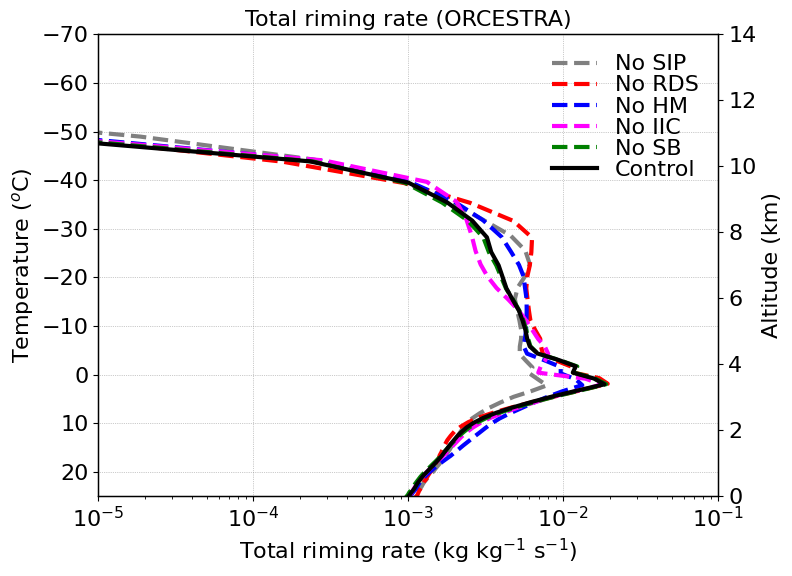

In [14]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_rime_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_rime_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_rime_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_rime_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_rime_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_rime_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_rime_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control') 

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total riming rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total riming rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

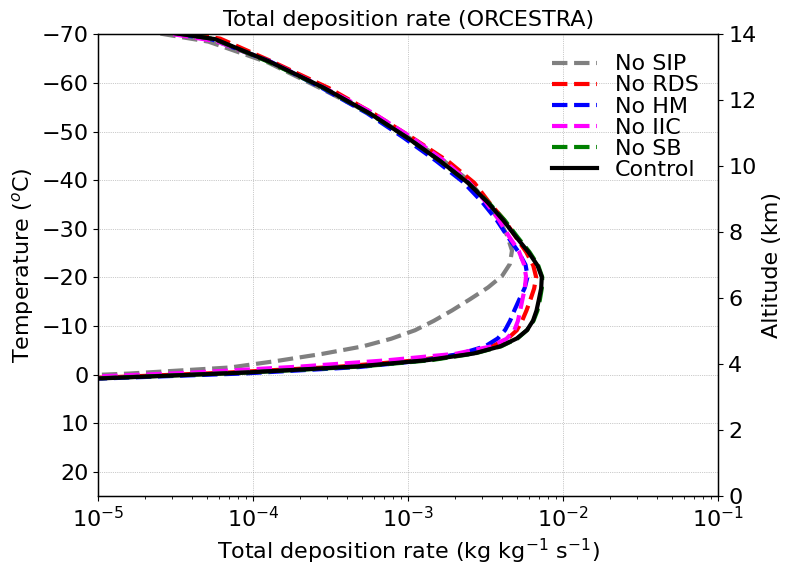

In [16]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_tot_dep_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_tot_dep_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_tot_dep_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_tot_dep_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_tot_dep_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_tot_dep_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_tot_dep_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total deposition rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total deposition rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

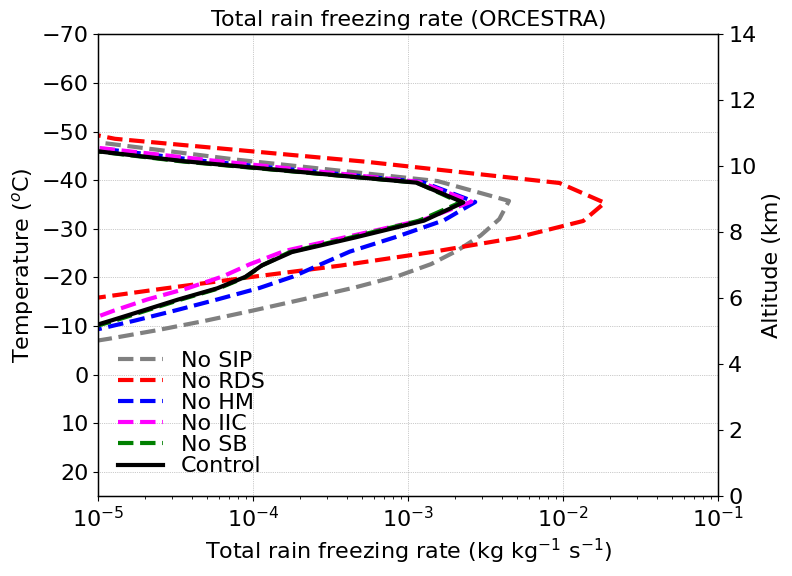

In [17]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_rainfreez_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_rainfreez_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_rainfreez_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_rainfreez_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_rainfreez_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_rainfreez_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_rainfreez_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total rain freezing rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total rain freezing rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

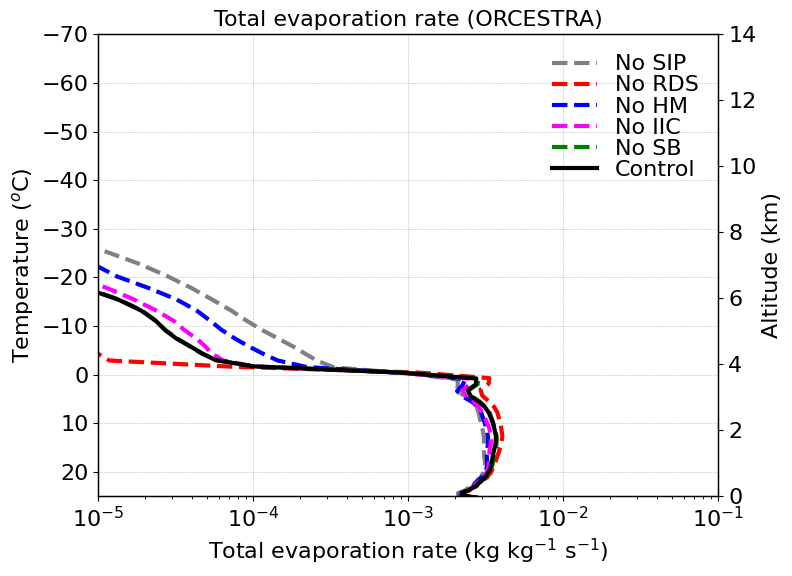

In [18]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_evap_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_evap_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_evap_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_evap_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_evap_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_evap_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_evap_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total evaporation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total evaporation rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

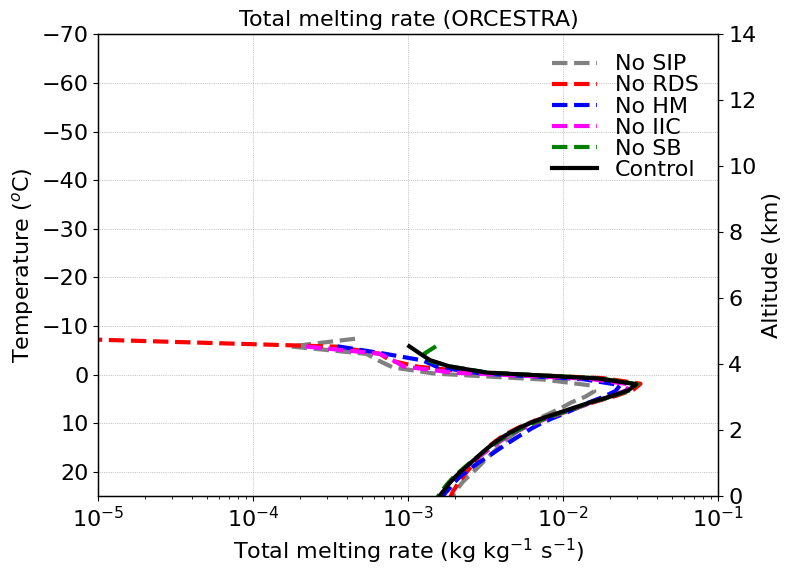

In [19]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_melt_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_melt_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_melt_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_melt_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_melt_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_melt_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_melt_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt1.set_xscale('log')
plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Total melting rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Total melting rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

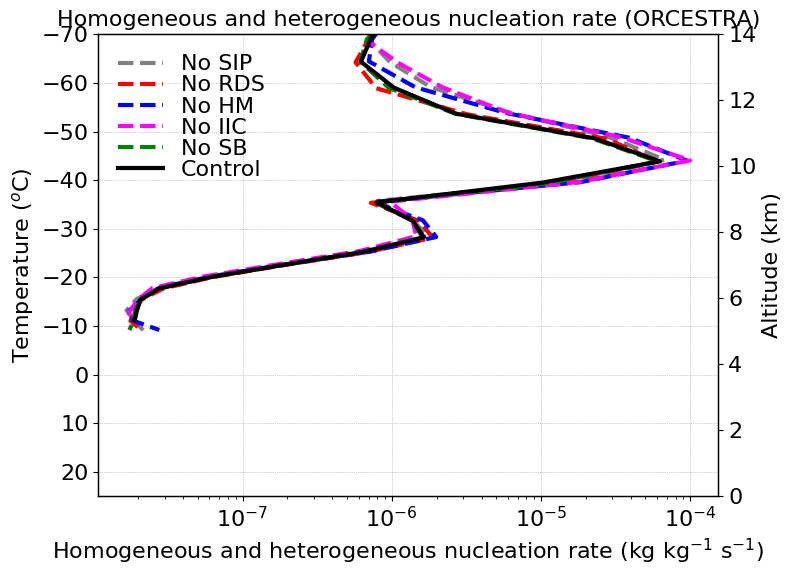

In [21]:

#mean_lhr_kperd_4sip_mc3e[mean_tempc_4sip_mc3e > 18.] = np.nan

fontsize=16;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.style.use('default')

plt1=plt.gca()
plt2=plt1.twinx()

fact = 1.
plt1.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt1.plot(mean_dq_homhet_nosip*fact, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt1.plot(mean_dq_homhet_norf*fact, mean_tempc_norf, '--', color='red', linewidth=lnwdth, label='No RDS')
plt1.plot(mean_dq_homhet_nohm*fact, mean_tempc_nohm, '--', color='blue', linewidth=lnwdth, label='No HM')
plt1.plot(mean_dq_homhet_nobr*fact, mean_tempc_nobr, '--', color='magenta', linewidth=lnwdth, label='No IIC')
plt1.plot(mean_dq_homhet_nosb*fact, mean_tempc_nosb, '--', color='green', linewidth=lnwdth, label='No SB')
plt1.plot(mean_dq_homhet_4sip*fact, mean_tempc_4sip, '-', color='black', linewidth=lnwdth, label='Control')

plt2.plot(mean_dq_homhet_4sip*fact, mean_ht_4sip, '-', color='none', linewidth=lnwdth)#, label='Control')

#plt2.plot(mean_tot_inc_up_caipeex*fact, mean_ht_4sip_caipeex, '-', color='none', linewidth=lnwdth)#, label='No SB')
#plt2.plot(mean_tot_inc_up_dcmex*fact, mean_ht_4sip_dcmex, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_mc3e*fact, mean_ht_4sip_mc3e, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_orcestra*fact, mean_ht_4sip_orcestra, '-', color='none', linewidth=lnwdth)
#plt2.plot(mean_tot_inc_up_steps*fact, mean_ht_4sip_steps, '-', color='none', linewidth=lnwdth)

plt1.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
#plt2.grid(True, linestyle='-', linewidth=0., color='grey', alpha=0.8)

plt1.set_xscale('log')
#plt1.set_xlim(1.e-5, 1.e-1)
plt1.set_ylim(25, -70)
plt2.set_ylim(0, 14)

#plt1.set_xticks([1.e-4, 1.e-2, 1.e0, 1.e2, 1.e4, 1.e6])
plt1.set_yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70])
plt2.set_yticks([0, 2, 4, 6, 8, 10, 12, 14])

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)

plt1.set_xlabel('Homogeneous and heterogeneous nucleation rate (kg kg$^{-1}$ s$^{-1}$)', fontsize=fontsize)
plt1.set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt2.set_ylabel('Altitude (km)', fontsize=fontsize)

plt1.tick_params(axis='x', labelsize=fontsize)
plt1.tick_params(axis='y', labelsize=fontsize)
plt2.tick_params(axis='y', labelsize=fontsize)


plt1.legend()
plt1.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')

plt.title('Homogeneous and heterogeneous nucleation rate (ORCESTRA)', fontsize=fontsize)

for spine in ['top', 'bottom', 'left', 'right']:
    plt.gca().spines[spine].set_visible(True)
    plt.gca().spines[spine].set_linewidth(1)
    plt.gca().spines[spine].set_color('black')

plt.show()

In [7]:

def calc_dewpoint(tempc, rh):
    dewpoint = tempc - ((100. - rh)/5.)
    return dewpoint


def calc_tdew(t, rh):        # Magnus-Tetens approximation
    a = 17.27; b = 237.7;
    alpha = (a*t/(b+t)) + np.log(rh/100)
    td = b*alpha/(a-alpha)
    return td
    
def calc_vir_temp(tc, q):
    #virt_tempk_wk = t/(1. - (ev/p)*(1-0.622))
    temp = tc + (1-0.622*q)
    return temp
    
def calculate_lcl(pressure, temperature, dewpoint):
    l = np.argmin(np.abs(temperature - dewpoint))
    return pressure[l], temperature[l]

def calc_lcl(t, td):
    lcl = td + 125.*(t-td)
    return lcl
    
def e_sat_hpa(tc):
    e_sat_pa = 6.112*np.exp((17.67*tc)/(tc+243.5))
    return e_sat_pa

def calc_parcel_temp(pres, ht, q_sat, tk_lcl):
    grav = 9.8  # acceleration due to gravity [m/s^2]
    eps = 0.622  # ratio of the gas constants for water vapor and dry air
    Rd = 287.  # specific gas constant for dry air [J/(kg*K)]
    cp = 1005.  # specific heat capacity at constant pressure for dry air [J/(kg*K)]
    lv = 2.5e6  # latent heat of vaporization [J/kg]
    Rv = 461.  # specific gas constant for water vapor [J/(kg*K)]

    tk_parcel = np.zeros(len(ht))  
    del_t_par = np.zeros(len(ht))  

    tk_parcel[0] = tk_lcl + 273.15 
    
    for i in range(1, len(ht)):
        dht = ht[i] - ht[i - 1]  
        qs = q_sat[i]  
        term_a = 1. + lv * qs / (Rd * tk_parcel[i - 1])
        term_b = (lv ** 2.) * eps * qs
        term_c = Rd * (tk_parcel[i - 1]) ** 2.
        
        del_t_par[i] = grav * term_a / (cp + (term_b / term_c))

        tk_parcel[i] = tk_parcel[i - 1] - del_t_par[i] * dht
        
    tempc = tk_parcel - 273.15
    return tempc

import numpy as np



def calc_cape(pres, t_env, t_par, tv_env, tv_par):
    """
    Calculate Convective Available Potential Energy (CAPE).
    
    Parameters:
        pres (array): Pressure levels (hPa or Pa).
        t_env (array): Environmental temperature (°C).
        t_par (array): Parcel temperature (°C).
        tv_env (array): Environmental virtual temperature (°C).
        tv_par (array): Parcel virtual temperature (°C).
    
    Returns:
        cape (float): CAPE value (J/kg).
    """
    Rd = 287.0  # gas constant for dry air (J/kg/K)
    
    # Convert temperatures to Kelvin
    tk_env = t_env + 273.15
    tk_v_env = tv_env + 273.15
    tk_par = t_par + 273.15
    tk_v_par = tv_par + 273.15
    
    cape = 0.0
    
    # Loop through pressure levels
    for i in range(1, len(pres)):
        # Check if parcel is warmer than the environment
        if tk_v_par[i] > tk_v_env[i]:
            # Calculate logarithmic pressure difference
            dlnp = np.log(pres[i-1] / pres[i])
            cape = cape + Rd * (tk_v_par[i] - tk_v_env[i]) * dlnp
    return cape
        

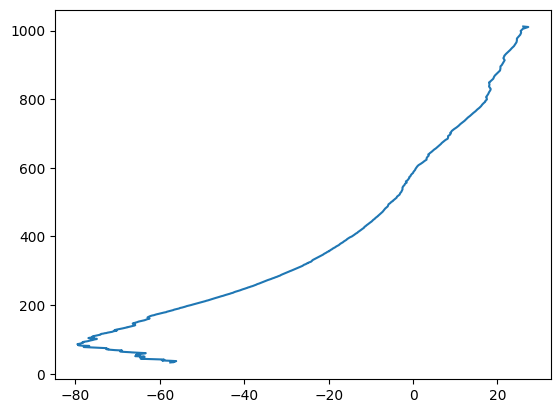

In [20]:
file_path = '/work/bk1415/b382718/output/orcestra/observations/wyoming_sonde/sonde_orcestra_20240903_1200UTC'
column_names = ['pres', 'height', 'temp', 'Tdew', 'relhum', 'qv', 'w_dir', 'w_wind', 'theta', 'theta_e', 'theta_v']


# Specify invalid values (strings or other markers for missing data)
invalid_values = ['-----------------------------------------------------------------------------', '9999.0', '999.0']

# Read the data and replace invalid values with NaN
ds_sonde = pd.read_csv(file_path, sep='\s+', skiprows=6, names=column_names, na_values=invalid_values)

# drop rows with NaN values if needed
ds_sonde.dropna(inplace=True)


temp_sonde = ds_sonde.temp.values
pres_sonde = ds_sonde.pres.values
tdew_sonde = ds_sonde.Tdew.values
rh_sonde = ds_sonde.relhum.values
qv_sonde = ds_sonde.qv.values
w_sonde = ds_sonde.w_wind.values
ht_sonde = ds_sonde.height.values

plt.plot(temp_sonde, pres_sonde)

In [12]:
ds_4sip.time[24]

<xarray.DataArray 'time' ()>
array('2024-09-03T12:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2024-09-03T12:00:00
Attributes:
    standard_name:  time
    axis:           T

Tenv    ::  [ 25.472301   25.102497   24.697054   24.264956   23.847887   23.441639
  23.044283   22.65701    22.262733   21.851585   21.42618    20.985214
  20.5164     20.013956   19.469633   18.894772   18.294472   17.667616
  17.003273   16.33308    15.616732   14.869071   14.097094   13.298925
  12.463171   11.583893   10.66444     9.718272    8.737001    7.729309
   6.6857643   5.6324406   4.5390754   3.3691444   2.157193    0.9753825
  -0.1675019  -1.4445887  -2.7727835  -4.1448     -5.607413   -7.155437
  -8.803791  -10.689388  -12.701304  -14.897587  -17.16448   -19.48239
 -21.997797  -24.785824  -27.889805  -31.305443  -34.981346  -38.979004
 -43.344913  -48.040936  -53.05474   -58.342712  -63.43048   -67.92141
 -72.30739   -76.134026  -78.61002   -70.58618   -63.699135 ]
Tparcel ::  [ 2.34416389e+01  2.33515918e+01  2.32197732e+01  2.30573637e+01
  2.28685845e+01  2.26558342e+01  2.24206675e+01  2.21641810e+01
  2.18870746e+01  2.15897641e+01  2.12725122e+01  2.09354437e+01


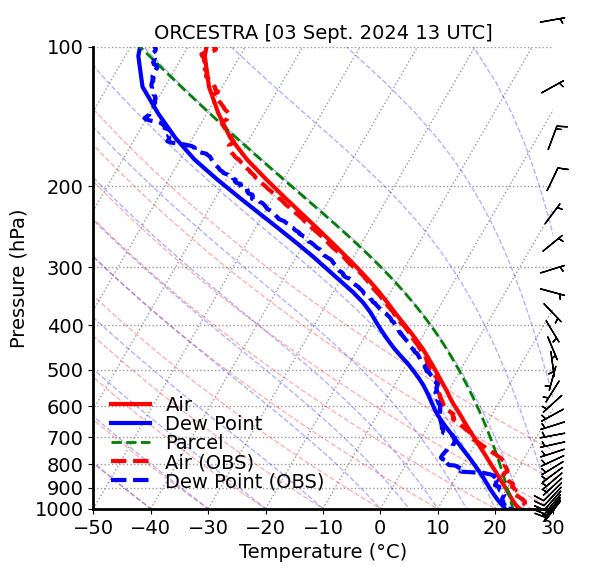

In [22]:

ds_skewt = ds_4sip.sel(time=ds_4sip.time[24])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

#----- Calculate parcel properties
e_sat = e_sat_hpa(avg_tempc)
q_sat = 0.622*e_sat/(avg_pres-e_sat)

lcl_pressure, lcl_temp = calculate_lcl(avg_pres, avg_tempc, avg_dewtempc)
#lcl_temp = calc_lcl(avg_tempc[0], avg_dewtempc)
parcel_temp = calc_parcel_temp(avg_pres, avg_ht, 1.5*q_sat, lcl_temp)
Tv_env = calc_vir_temp(avg_tempc, avg_qv)
Tv_parcel = calc_vir_temp(parcel_temp, 1.5*q_sat)
parcel_cape = calc_cape(avg_pres, avg_tempc, parcel_temp, Tv_env, Tv_parcel)
print('Tenv    :: ', avg_tempc)
print('Tparcel :: ', parcel_temp)
print('LCL :: ', lcl_temp)
print('CAPE :: ',parcel_cape)
#------

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(8, 6))
skew = SkewT(fig)

# Plot temperature and dew point on the Skew-T
skew.plot(avg_pres, avg_tempc, 'r-', label='Air', linewidth=lnwdth)
#skew.plot(avg_pres, calc_dewpoint(avg_tempc, avg_rh), 'b-.', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)
skew.plot(avg_pres, parcel_temp, 'g--', label='Parcel', linewidth=lnwdth-1)

skew.plot(pres_sonde* units.hPa, temp_sonde* units.degC, 'r--', label='Air (OBS)', linewidth=lnwdth)
skew.plot(pres_sonde* units.hPa, tdew_sonde* units.degC, 'b--', label='Dew Point (OBS)', linewidth=lnwdth)

# Add wind barbs 
if 'u' in ds_skewt and 'v' in ds_skewt:
    u_wind = avg_u  # Zonal wind component
    v_wind = avg_v  # Meridional wind component
    skew.plot_barbs(avg_pres[::2], u_wind[::2], v_wind[::2], length=6, color='black', pivot='middle')

# Add the dry and moist adiabats to the plot
skew.plot_dry_adiabats(linewidth=1, alpha=alpha)
skew.plot_moist_adiabats(linewidth=1, alpha=alpha)

ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-50, 30)
ax.set_ylim(1000., 100)
ax.tick_params(axis='x', labelsize=fontsize)
ax.tick_params(axis='y', labelsize=fontsize)
plt.title('ORCESTRA [03 Sept. 2024 13 UTC]', fontsize=fontsize)

plt.legend(frameon=False, handlelength=2, labelspacing=0.01, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=1., color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()

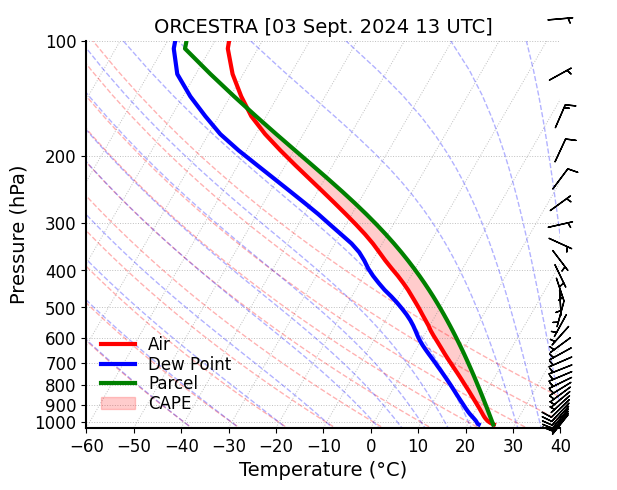

In [87]:
ds_skewt = ds_4sip.sel(time=ds_4sip.time[26])

tempc = ds_skewt.temp-273.15 #.values
pres_pa = ds_skewt.pres #.values
ht_m = ds_skewt.z_mc
rel_hum = ds_skewt.rh #.values
u_wind = ds_skewt.u
v_wind = ds_skewt.v
q_vap = ds_skewt.qv

   
temp_dew = calc_dewpoint(tempc, rel_hum)
#temp_dew = calc_tdew(tempc, rel_hum)

avg_tempc = tempc.mean(dim=('ncells')).values
avg_dewtempc = temp_dew.mean(dim=('ncells')).values
avg_pres = 0.01*pres_pa.mean(dim=('ncells')).values
avg_ht = ht_m.mean(dim=('ncells')).values
avg_rh = rel_hum.mean(dim=('ncells')).values
avg_qv = q_vap.mean(dim=('ncells')).values

avg_u = u_wind.mean(dim=('ncells')).values
avg_v = v_wind.mean(dim=('ncells')).values

avg_tempc = avg_tempc[::-1]
avg_dewtempc = avg_dewtempc[::-1]
avg_pres = avg_pres[::-1]
avg_ht = avg_ht[::-1]
avg_rh = avg_rh[::-1]
avg_u = avg_u[::-1]
avg_v = avg_v[::-1]
avg_qv = avg_qv[::-1]

# Create the Skew-T plot
fontsize=14;
lnwdth=3;
alpha=0.3;

fig = plt.figure(figsize=(8, 5))
skew = SkewT(fig)

skew.plot(avg_pres, avg_tempc, 'r-', label='Air', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)

skew.plot_dry_adiabats(linewidth=1, alpha=alpha, linestyle='--')
skew.plot_moist_adiabats(linewidth=1, alpha=alpha, linestyle='--')

moist_adiabats = skew.moist_adiabats

# Now, we'll plot parcel path (that follows moist adiabatic line between LFC and LNB)
# We basically skip calculation of parcel temperature and CAPE and make use of the SKEWT plot itself

adiabat_profiles = []
for path in moist_adiabats.get_paths():
    temp_pres = path.vertices
    # We now interpolate temp_pres on available pressure levels
    adiabat_temp = np.interp(avg_pres, 
                           temp_pres[:,1][::-1],  # Pressure values
                           temp_pres[:,0][::-1])  # Temperature values
    adiabat_profiles.append(adiabat_temp)

# Find intersections between environmental temp and moist adiabats (these intersection points are LFC and LNB)
crossing_points = []
for i in range(len(avg_pres)-1):
    for j, adiabat in enumerate(adiabat_profiles):
        if ((avg_tempc[i] > adiabat[i] and avg_tempc[i+1] <= adiabat[i+1]) or 
            (avg_tempc[i] < adiabat[i] and avg_tempc[i+1] >= adiabat[i+1])):
            crossing_points.append((i, j))

# Process crossing points to find LFC and LNB
if len(crossing_points) >= 2:
    # Sort by pressure (descending)
    crossing_points.sort(key=lambda x: avg_pres[x[0]], reverse=True)
    
    lfc_idx, lfc_adiabat_idx = crossing_points[0]
    lnb_idx, lnb_adiabat_idx = crossing_points[-1]
    
    # Create parcel temperature line
    parcel_temp = np.full_like(avg_tempc, np.nan)
    parcel_temp[lfc_idx:lnb_idx+1] = adiabat_profiles[lfc_adiabat_idx][lfc_idx:lnb_idx+1]
    
    # Plot parcel path
    skew.plot(avg_pres, parcel_temp, 'g-', linewidth=lnwdth, label='Parcel')
    
    # Shade CAPE area
    skew.ax.fill_betweenx(avg_pres[lfc_idx:lnb_idx+1],
                        avg_tempc[lfc_idx:lnb_idx+1],
                        parcel_temp[lfc_idx:lnb_idx+1],
                        where=parcel_temp[lfc_idx:lnb_idx+1] > avg_tempc[lfc_idx:lnb_idx+1],
                        color='red', alpha=0.2, label='CAPE')

    # Mark LFC and LNB
    skew.plot(avg_pres[lfc_idx], avg_tempc[lfc_idx], 'k', markersize=10, markeredgewidth=2)#, label='LFC')
    skew.plot(avg_pres[lnb_idx], avg_tempc[lnb_idx], 'k', markersize=10, markeredgewidth=2)#, label='LNB')
    
    # Add text labels
    #plt.text(avg_tempc[lfc_idx]-2, avg_pres[lfc_idx]-10, 'LFC', 
    #        fontsize=fontsize-2, ha='right', va='top')
    #plt.text(avg_tempc[lnb_idx]+2, avg_pres[lnb_idx]+10, 'LNB', 
    #        fontsize=fontsize-2, ha='left', va='bottom')

# Add wind barbs if available
if 'u' in ds_skewt and 'v' in ds_skewt:
    u_wind = avg_u  # Zonal wind component
    v_wind = avg_v  # Meridional wind component
    skew.plot_barbs(avg_pres[::2], u_wind[::2], v_wind[::2], length=6, color='black', pivot='middle')

# Configure plot appearance
ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-60, 40)
ax.set_ylim(avg_pres[0]+20, 100)
ax.tick_params(axis='both', labelsize=fontsize-2)

plt.title('ORCESTRA [03 Sept. 2024 13 UTC]', fontsize=fontsize)#, pad=20)

plt.legend(frameon=False, handlelength=2, labelspacing=0.1, fontsize=fontsize-2, loc='lower left')#, bbox_to_anchor=(0.7, 0.95))

plt.grid(True, linestyle=':', linewidth=0.7, color='grey', alpha=0.5)

# Clean up borders
for spine in ax.spines.values():
    spine.set_linewidth(1.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


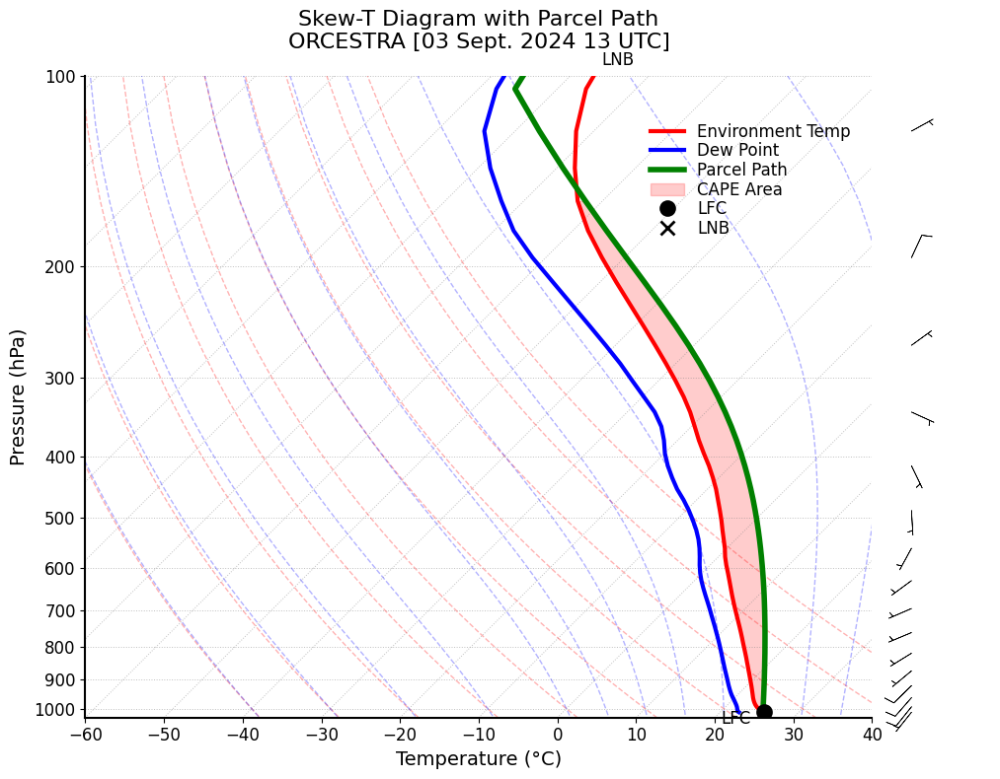

In [77]:
import numpy as np
import matplotlib.pyplot as plt
from metpy.plots import SkewT

# Assuming you've already calculated these arrays from your dataset:
# avg_pres, avg_tempc, avg_dewtempc, etc.

# Create the Skew-T plot
fontsize = 14
lnwdth = 3
alpha = 0.3

fig = plt.figure(figsize=(10, 8))
skew = SkewT(fig, rotation=45)

# Plot environmental temperature and dew point
skew.plot(avg_pres, avg_tempc, 'r-', label='Environment Temp', linewidth=lnwdth)
skew.plot(avg_pres, avg_dewtempc, 'b-', label='Dew Point', linewidth=lnwdth)

# Add adiabats (must plot them first to access later)
skew.plot_dry_adiabats(linewidth=1, alpha=alpha, linestyle='--')
skew.plot_moist_adiabats(linewidth=1, alpha=alpha, linestyle='--')

# Get moist adiabats from the plot
moist_adiabats = skew.moist_adiabats

# Extract temperature values from adiabat paths
adiabat_profiles = []
for path in moist_adiabats.get_paths():
    temp_pres = path.vertices
    # Interpolate to our pressure levels (pressure is y-axis)
    adiabat_temp = np.interp(avg_pres, 
                           temp_pres[:,1][::-1],  # Pressure values
                           temp_pres[:,0][::-1])  # Temperature values
    adiabat_profiles.append(adiabat_temp)

# Find intersections between environmental temp and moist adiabats
crossing_points = []
for i in range(len(avg_pres)-1):
    for j, adiabat in enumerate(adiabat_profiles):
        if ((avg_tempc[i] > adiabat[i] and avg_tempc[i+1] <= adiabat[i+1]) or 
            (avg_tempc[i] < adiabat[i] and avg_tempc[i+1] >= adiabat[i+1])):
            crossing_points.append((i, j))

# Process crossing points to find LFC and LNB
if len(crossing_points) >= 2:
    # Sort by pressure (descending)
    crossing_points.sort(key=lambda x: avg_pres[x[0]], reverse=True)
    
    lfc_idx, lfc_adiabat_idx = crossing_points[0]
    lnb_idx, lnb_adiabat_idx = crossing_points[-1]
    
    # Create parcel temperature line
    parcel_temp = np.full_like(avg_tempc, np.nan)
    parcel_temp[lfc_idx:lnb_idx+1] = adiabat_profiles[lfc_adiabat_idx][lfc_idx:lnb_idx+1]
    
    # Plot parcel path
    skew.plot(avg_pres, parcel_temp, 'g-', linewidth=lnwdth+1, label='Parcel Path')
    
    # Shade CAPE area
    skew.ax.fill_betweenx(avg_pres[lfc_idx:lnb_idx+1],
                        avg_tempc[lfc_idx:lnb_idx+1],
                        parcel_temp[lfc_idx:lnb_idx+1],
                        where=parcel_temp[lfc_idx:lnb_idx+1] > avg_tempc[lfc_idx:lnb_idx+1],
                        color='red', alpha=0.2, label='CAPE Area')
    
    # Mark LFC and LNB
    skew.plot(avg_pres[lfc_idx], avg_tempc[lfc_idx], 'ko', 
             markersize=10, markeredgewidth=2, label='LFC')
    skew.plot(avg_pres[lnb_idx], avg_tempc[lnb_idx], 'kx', 
             markersize=10, markeredgewidth=2, label='LNB')
    
    # Add text labels
    plt.text(avg_tempc[lfc_idx]-2, avg_pres[lfc_idx]-10, 'LFC', 
            fontsize=fontsize-2, ha='right', va='top')
    plt.text(avg_tempc[lnb_idx]+2, avg_pres[lnb_idx]+10, 'LNB', 
            fontsize=fontsize-2, ha='left', va='bottom')

# Add wind barbs if available
if 'avg_u' in locals() and 'avg_v' in locals():
    n = max(1, len(avg_pres)//15)  # Plot every nth level
    skew.plot_barbs(avg_pres[::n], avg_u[::n], avg_v[::n], 
                   xloc=1.05, length=6, linewidth=0.5)

# Configure plot appearance
ax = skew.ax
ax.set_xlabel('Temperature (°C)', fontsize=fontsize)
ax.set_ylabel('Pressure (hPa)', fontsize=fontsize)
ax.set_xlim(-60, 40)
ax.set_ylim(avg_pres[0]+20, 100)
ax.tick_params(axis='both', labelsize=fontsize-2)

plt.title('Skew-T Diagram with Parcel Path\nORCESTRA [03 Sept. 2024 13 UTC]', 
         fontsize=fontsize+2, pad=20)

plt.legend(frameon=False, handlelength=2, labelspacing=0.1, 
          fontsize=fontsize-2, loc='upper left', bbox_to_anchor=(0.7, 0.95))

plt.grid(True, linestyle=':', linewidth=0.7, color='grey', alpha=0.5)

# Clean up borders
for spine in ax.spines.values():
    spine.set_linewidth(1.5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()


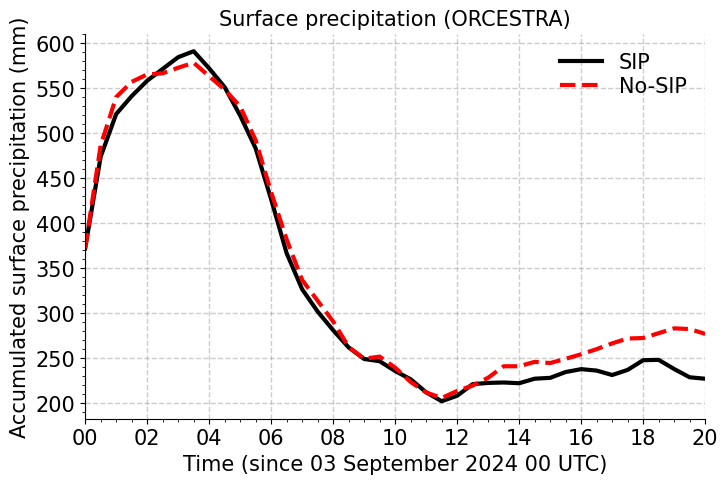

In [21]:

filt_cape = xr.where(ds_nosip_effrad_new.cape_ml > 0., ds_nosip_effrad_new.cape_ml, np.nan)
cape_nosip = filt_cape.mean('ncells')

filt_cape = xr.where(ds_sip_effrad_new.cape_ml > 0., ds_sip_effrad_new.cape_ml, np.nan)
cape_sip = filt_cape.mean('ncells')

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 5))

plt.plot(ds_sip_new.time, cape_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time, cape_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
#plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper right')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()

In [100]:

mean_ht_nosip = ds_nosip.z_mc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

mean_ht_4sip = ds_4sip.z_mc.mean(dim=('time','ncells'))
mean_tempc_4sip = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_ht_norf = ds_norf.z_mc.mean(dim=('time','ncells'))
mean_tempc_norf = ds_norf.tempc.mean(dim=('time','ncells'))

mean_ht_nohm = ds_nohm.z_mc.mean(dim=('time','ncells'))
mean_tempc_nohm = ds_nohm.tempc.mean(dim=('time','ncells'))

mean_ht_nobr = ds_nobr.z_mc.mean(dim=('time','ncells'))
mean_tempc_nobr = ds_nobr.tempc.mean(dim=('time','ncells'))

#mean_ht_nosb = ds_nosb.z_mc.mean(dim=('time','ncells'))
#mean_tempc_nosb = ds_nosb.tempc.mean(dim=('time','ncells'))

# Latent heating rate with No SIP
filt_lhr = xr.where((ds_nosip.tq > 1.e-6) & (ds_nosip.w_vel > w_thres), ds_nosip.d_lhr, np.nan)
lhr_kpers_nosip = (1./1800.) * np.gradient(ds_nosip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nosip = lhr_kpers_nosip * 86400.
mean_lhr_kperd_nosip = np.mean(lhr_kperd_nosip, axis=(0,2))

# Latent heating rate with 4-SIP
filt_lhr = xr.where((ds_4sip.tq > 1.e-6) & (ds_4sip.w_vel > w_thres), ds_4sip.d_lhr, np.nan)
lhr_kpers_4sip = (1./1800.) * np.gradient(ds_4sip.d_lhr, axis=0) # w.r.t. time
lhr_kperd_4sip = lhr_kpers_4sip * 86400.
mean_lhr_kperd_4sip = np.mean(lhr_kperd_4sip, axis=(0,2))

# Latent heating rate with No Raindrop Shattering (RF)
filt_lhr = xr.where((ds_norf.tq > 1.e-6) & (ds_norf.w_vel > w_thres), ds_norf.d_lhr, np.nan)
lhr_kpers_norf = (1./1800.) * np.gradient(ds_norf.d_lhr, axis=0) # w.r.t. time
lhr_kperd_norf = lhr_kpers_norf * 86400.
mean_lhr_kperd_norf = np.mean(lhr_kperd_norf, axis=(0,2))

# Latent heating rate with No Hallett-Mossop (HM)
filt_lhr = xr.where((ds_nohm.tq > 1.e-6) & (ds_nohm.w_vel > w_thres), ds_nohm.d_lhr, np.nan)
lhr_kpers_nohm = (1./1800.) * np.gradient(ds_nohm.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nohm = lhr_kpers_nohm * 86400.
mean_lhr_kperd_nohm = np.mean(lhr_kperd_nohm, axis=(0,2))

# Latent heating rate with No ice-ice collision breakup (BR)
filt_lhr = xr.where((ds_nobr.tq > 1.e-6) & (ds_nobr.w_vel > w_thres), ds_nobr.d_lhr, np.nan)
lhr_kpers_nobr = (1./1800.) * np.gradient(ds_nobr.d_lhr, axis=0) # w.r.t. time
lhr_kperd_nobr = lhr_kpers_nobr * 86400.
mean_lhr_kperd_nobr = np.mean(lhr_kperd_nobr, axis=(0,2))
#
## Latent heating rate with No Sublimation (SB)
#filt_lhr = xr.where((ds_nosb.tq > 1.e-6) & (ds_nosb.w_vel > w_thres), ds_nosb.d_lhr, np.nan)
#lhr_kpers_nosb = (1./1800.) * np.gradient(ds_nosb.d_lhr, axis=0) # w.r.t. time
#lhr_kperd_nosb = lhr_kpers_nosb * 86400.
#mean_lhr_kperd_nosb = np.mean(lhr_kperd_nosb, axis=(0,2))


# Change in lhr w.r.t. control
del_lhr_kperd_nosip = mean_lhr_kperd_4sip-mean_lhr_kperd_nosip
del_lhr_kperd_norf = mean_lhr_kperd_4sip-mean_lhr_kperd_norf
del_lhr_kperd_nohm = mean_lhr_kperd_4sip-mean_lhr_kperd_nohm
del_lhr_kperd_nobr = mean_lhr_kperd_4sip-mean_lhr_kperd_nobr
#del_lhr_kperd_nosb = mean_lhr_kperd_4sip-mean_lhr_kperd_nosb


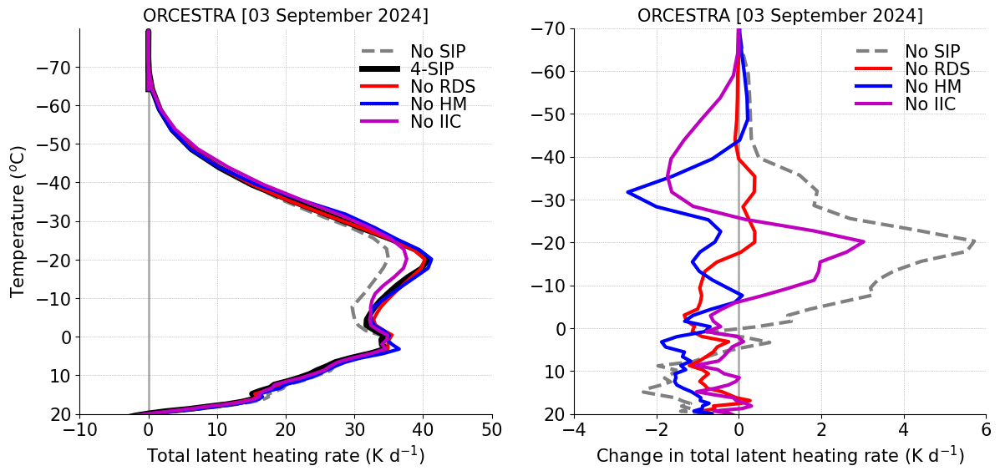

In [101]:

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))

plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(mean_lhr_kperd_4sip, mean_tempc_4sip, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(mean_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
#plt.plot(mean_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-10, 50)
plt.ylim(20, -80)
plt.xticks([-10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 September 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)


plt.subplot(1,2,2)
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(del_lhr_kperd_nosip, mean_tempc_nosip, '--', color='grey', linewidth=lnwdth, label='No SIP')
plt.plot(del_lhr_kperd_norf, mean_tempc_norf, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(del_lhr_kperd_nohm, mean_tempc_nohm, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(del_lhr_kperd_nobr, mean_tempc_nobr, 'm-', linewidth=lnwdth, label='No IIC')
#plt.plot(del_lhr_kperd_nosb, mean_tempc_nosb, 'g-', linewidth=lnwdth, label='No SB')

plt.xlim(-4, 6)
plt.ylim(20, -70)
plt.xticks([-4, -2, 0, 2, 4, 6], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Change in total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 September 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()

plt.show()


In [10]:
ds_4sip

<xarray.Dataset>
Dimensions:         (time: 41, ncells: 73960, vertices: 3, height: 65, bnds: 2,
                     height_2: 66, plev: 1, plev_2: 1, plev_3: 1)
Coordinates:
  * time            (time) datetime64[ns] 2024-09-03 ... 2024-09-03T20:00:00
    clon            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
    clat            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
  * height          (height) float64 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
  * height_2        (height_2) float64 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
  * plev            (plev) float64 800.0
  * plev_2          (plev_2) float64 400.0
  * plev_3          (plev_3) float64 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/100)
    clon_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds     (time, height, bnds) float64 dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds       (time, plev, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds     (time, plev_2, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds     (time, plev_3, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...              ...
    tqi             (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tq              (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    ciwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: 2a8abec3cefd1c9db62f378...
    history:              /home/b/b382718/icon_orcestra_4sip/icon-oct2024/bin...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l30683 (Linux 4.18.0-513....

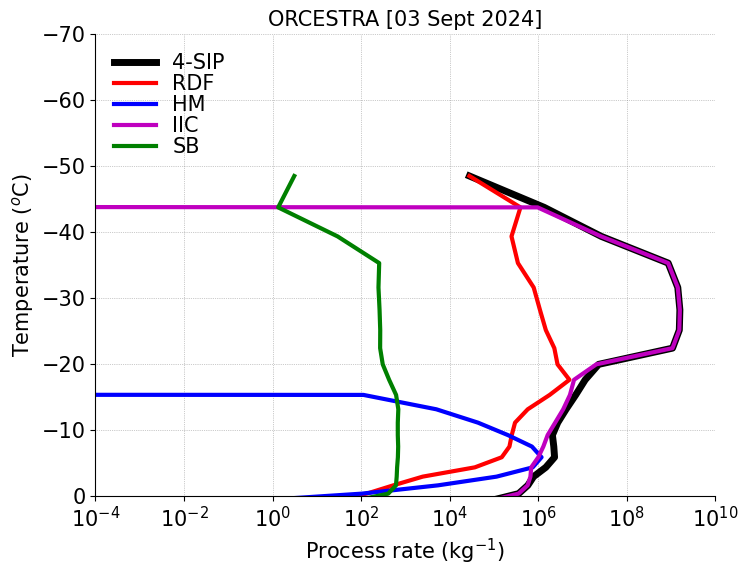

In [22]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))




dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


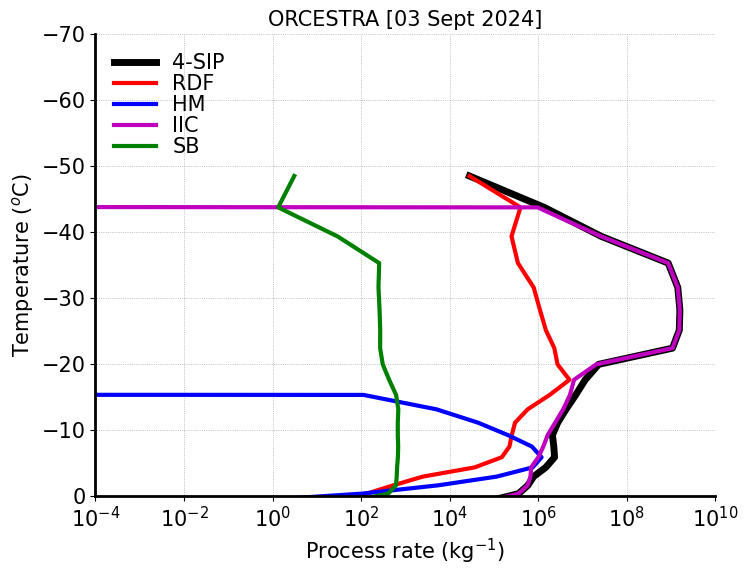

In [26]:

thres_q = 1.e-12
qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_sec, np.nan)
dqi_sec_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_ds, np.nan)
dqi_rf_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_rs, np.nan)
dqi_hm_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_br, np.nan)
dqi_br_tot = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_snow_sbf, np.nan)
dqi_snow_sb = qi_filt.mean(dim=('time','ncells'))

qi_filt = xr.where(ds_4sip.dqi_sec > thres_q, ds_4sip.dqni_graup_sbf, np.nan)
dqi_graup_sb = qi_filt.mean(dim=('time','ncells'))

dqi_tot_sb = dqi_snow_sb + dqi_graup_sb

qi_filt = xr.where(ds_4sip.d_qi_homhet > thres_q, ds_4sip.d_qi_homhet, np.nan)
dqi_homhet_tot = qi_filt.mean(dim=('time', 'ncells'))


avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))


dqi_sec_tot = dqi_sec_tot.where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.where(avg_tempc > -50)

dqi_sec_tot = dqi_sec_tot.values #where(avg_tempc > -50)
dqi_rf_tot = dqi_rf_tot.values   #where(avg_tempc > -50)
dqi_hm_tot = dqi_hm_tot.values   #where(avg_tempc > -50)
dqi_br_tot = dqi_br_tot.values   #where(avg_tempc > -50)
dqi_tot_sb = dqi_tot_sb.values   #where(avg_tempc > -50)
dqi_homhet_tot = dqi_homhet_tot.values
avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;
st = 3
plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(dqi_sec_tot, avg_tempc, 'k-', linewidth=lnwdth+2, label='4-SIP')
plt.plot(dqi_rf_tot, avg_tempc, 'r-', linewidth=lnwdth, label='RDF')
plt.plot(dqi_hm_tot, avg_tempc, 'b-', linewidth=lnwdth, label='HM')
plt.plot(dqi_br_tot, avg_tempc, 'm-', linewidth=lnwdth, label='IIC')
plt.plot(dqi_tot_sb, avg_tempc, 'g-', linewidth=lnwdth, label='SB')
#plt.plot(dqi_homhet_tot, avg_tempc, 'c-', linewidth=lnwdth, label='Hom-Het')

plt.xscale('log')
plt.xlim(1.e-4, 1.e10)
plt.ylim(0, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()


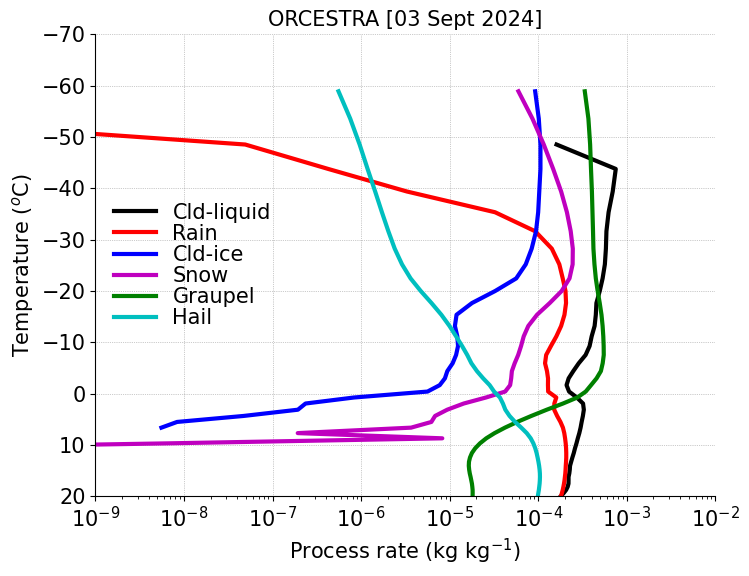

In [25]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qr, np.nan)
avg_qr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qc, np.nan)
avg_qc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qi, np.nan)
avg_qi = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qs, np.nan)
avg_qs = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qg > thres_q, ds_4sip.qg, np.nan)
avg_qg = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qh, np.nan)
avg_qh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qr = avg_qr.where(avg_tempc > -60)
avg_qc = avg_qc.where(avg_tempc > -60)
avg_qi = avg_qi.where(avg_tempc > -60)
avg_qs = avg_qs.where(avg_tempc > -60)
avg_qg = avg_qg.where(avg_tempc > -60)
avg_qh = avg_qh.where(avg_tempc > -60)

avg_qr = avg_qr.values
avg_qc = avg_qc.values
avg_qi = avg_qi.values
avg_qs = avg_qs.values
avg_qg = avg_qg.values
avg_qh = avg_qh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qi, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qs, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qg, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-9, 1.e-2)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


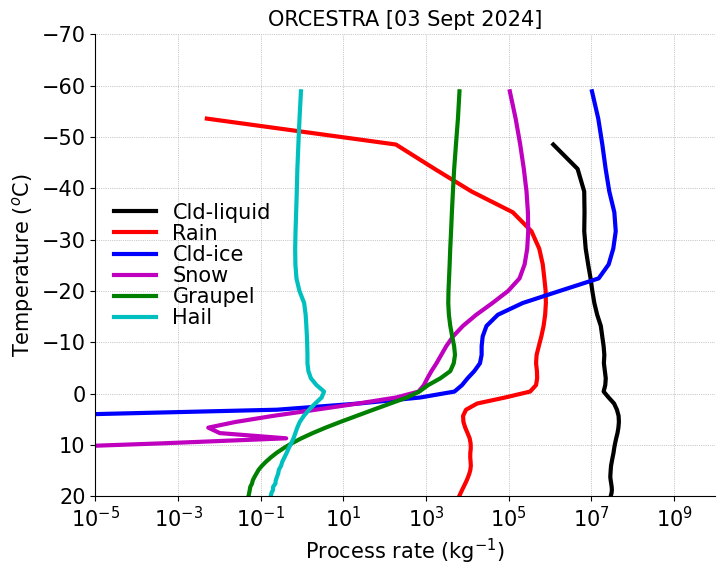

In [24]:

thres_q = 1.e-12
filt_q = xr.where(ds_4sip.qr > thres_q, ds_4sip.qnr, np.nan)
avg_qnr = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qc > thres_q, ds_4sip.qnc, np.nan)
avg_qnc = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qi > thres_q, ds_4sip.qni, np.nan)
avg_qni = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qs > thres_q, ds_4sip.qns, np.nan)
avg_qns = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qg > thres_q, ds_4sip.qng, np.nan)
avg_qng = filt_q.mean(dim=('time','ncells'))

filt_q = xr.where(ds_4sip.qh > thres_q, ds_4sip.qnh, np.nan)
avg_qnh = filt_q.mean(dim=('time','ncells'))

avg_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

avg_qnr = avg_qnr.where(avg_tempc > -60)
avg_qnc = avg_qnc.where(avg_tempc > -60)
avg_qni = avg_qni.where(avg_tempc > -60)
avg_qns = avg_qns.where(avg_tempc > -60)
avg_qng = avg_qng.where(avg_tempc > -60)
avg_qnh = avg_qnh.where(avg_tempc > -60)

avg_qnr = avg_qnr.values
avg_qnc = avg_qnc.values
avg_qni = avg_qni.values
avg_qns = avg_qns.values
avg_qng = avg_qng.values
avg_qnh = avg_qnh.values

avg_tempc = avg_tempc.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(avg_qnc, avg_tempc, 'k-', linewidth=lnwdth, label='Cld-liquid')
plt.plot(avg_qnr, avg_tempc, 'r-', linewidth=lnwdth, label='Rain')
plt.plot(avg_qni, avg_tempc, 'b-', linewidth=lnwdth, label='Cld-ice')
plt.plot(avg_qns, avg_tempc, 'm-', linewidth=lnwdth, label='Snow')
plt.plot(avg_qng, avg_tempc, 'g-', linewidth=lnwdth, label='Graupel')
plt.plot(avg_qnh, avg_tempc, 'c-', linewidth=lnwdth, label='Hail')

plt.xscale('log')
plt.xlim(1.e-5, 1.e10)
plt.ylim(20, -70)
#plt.xticks([-4, -2, 0, 2, 4, 6, 8, 10], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Process rate (kg$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='best')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['right'].set_linewidth(3)
plt.gca().spines['right'].set_linewidth(3)
plt.show()


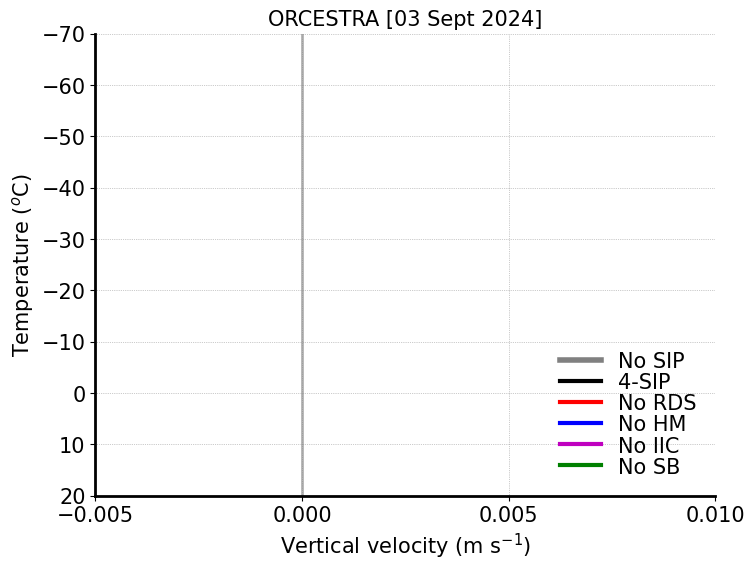

In [27]:

mean_w_up_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_norf = ds_norf.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))
mean_w_up_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel > 0.).mean(dim=('time','ncells'))

mean_w_dn_nosip = ds_nosip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_4sip = ds_4sip.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_norf = ds_norf.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nohm = ds_nohm.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nobr = ds_nobr.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))
mean_w_dn_nosb = ds_nosb.w_vel.where(ds_nosip.w_vel < 0.).mean(dim=('time','ncells'))

mean_w_net_nosip = ds_nosip.w_vel.mean(dim=('time','ncells'))
mean_w_net_4sip = ds_4sip.w_vel.mean(dim=('time','ncells'))
mean_w_net_norf = ds_norf.w_vel.mean(dim=('time','ncells'))
mean_w_net_nohm = ds_nohm.w_vel.mean(dim=('time','ncells'))
mean_w_net_nobr = ds_nobr.w_vel.mean(dim=('time','ncells'))
mean_w_net_nosb = ds_nosb.w_vel.mean(dim=('time','ncells'))

mean_tempc = ds_4sip.tempc.mean(dim=('time','ncells'))

mean_w_net_nosip = mean_w_net_nosip.where(mean_tempc > -60)
mean_w_net_4sip = mean_w_net_4sip.where(mean_tempc > -60)
mean_w_net_norf = mean_w_net_norf.where(mean_tempc > -60)
mean_w_net_nohm = mean_w_net_nohm.where(mean_tempc > -60)
mean_w_net_nobr = mean_w_net_nobr.where(mean_tempc > -60)
mean_w_net_nosb = mean_w_net_nosb.where(mean_tempc > -60)

mean_w_up_nosip = mean_w_up_nosip.where(mean_tempc > -60)
mean_w_up_4sip = mean_w_up_4sip.where(mean_tempc > -60)
mean_w_up_norf = mean_w_up_norf.where(mean_tempc > -60)
mean_w_up_nohm = mean_w_up_nohm.where(mean_tempc > -60)
mean_w_up_nobr = mean_w_up_nobr.where(mean_tempc > -60)
mean_w_up_nosb = mean_w_up_nosb.where(mean_tempc > -60)

mean_w_dn_nosip = mean_w_dn_nosip.where(mean_tempc > -60)
mean_w_dn_4sip = mean_w_dn_4sip.where(mean_tempc > -60)
mean_w_dn_norf = mean_w_dn_norf.where(mean_tempc > -60)
mean_w_dn_nohm = mean_w_dn_nohm.where(mean_tempc > -60)
mean_w_dn_nobr = mean_w_dn_nobr.where(mean_tempc > -60)
mean_w_dn_nosb = mean_w_dn_nosb.where(mean_tempc > -60)

mean_w_net_nosip = mean_w_net_nosip.values
mean_w_net_4sip = mean_w_net_4sip.values
mean_w_net_norf = mean_w_net_norf.values
mean_w_net_nohm = mean_w_net_nohm.values
mean_w_net_nobr = mean_w_net_nobr.values
mean_w_net_nosb = mean_w_net_nosb.values

mean_w_up_nosip = mean_w_up_nosip.values
mean_w_up_4sip = mean_w_up_4sip.values
mean_w_up_norf = mean_w_up_norf.values
mean_w_up_nohm = mean_w_up_nohm.values
mean_w_up_nobr = mean_w_up_nobr.values
mean_w_up_nosb = mean_w_up_nosb.values

mean_w_dn_nosip = mean_w_dn_nosip.values
mean_w_dn_4sip = mean_w_dn_4sip.values
mean_w_dn_norf = mean_w_dn_norf.values
mean_w_dn_nohm = mean_w_dn_nohm.values
mean_w_dn_nobr = mean_w_dn_nobr.values
mean_w_dn_nosb = mean_w_dn_nosb.values

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(16, 5))
#plt.subplot(1,2,1)
#plt.axvline(x=0, color='grey', linestyle='-', linewidth=2, alpha=0.6)
plt.plot(mean_w_net_nosip, mean_tempc, '-', color='grey', linewidth=lnwdth+1, label='No SIP')
plt.plot(mean_w_net_4sip, mean_tempc, 'k-', linewidth=lnwdth, label='4-SIP')
plt.plot(mean_w_net_norf, mean_tempc, 'r-', linewidth=lnwdth, label='No RDS')
plt.plot(mean_w_net_nohm, mean_tempc, 'b-', linewidth=lnwdth, label='No HM')
plt.plot(mean_w_net_nobr, mean_tempc, 'm-', linewidth=lnwdth, label='No IIC')
plt.plot(mean_w_net_nosb, mean_tempc, 'g-', linewidth=lnwdth, label='No SB')

#plt.xlim(-0.005, 0.01)
plt.ylim(20, -70)
plt.xticks(fontsize=fontsize)
#plt.xticks([-0.005, 0., 0.005, 0.01], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('ORCESTRA [03 Sept 2024]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(2)
plt.gca().spines['bottom'].set_linewidth(2)
plt.show()



In [49]:

acc_precip_sip = ds_sip_new.tot_prec.mean('ncells')
acc_precip_nosip = ds_nosip_new.tot_prec.mean('ncells')

filt_cond = (ds_sip_new.tq > 1.e-6) & (ds_sip_new.w_vel > 0.)
filt_wvel = xr.where(filt_cond, ds_sip_new.w_vel, np.nan)
avg_wvel_up_sip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_sip_new.tq > 1.e-6) & (ds_sip_new.w_vel < 0.)
filt_wvel = xr.where(filt_cond, ds_sip_new.w_vel, np.nan)
avg_wvel_dn_sip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_nosip_new.tq > 1.e-6) & (ds_nosip_new.w_vel > 0.)
filt_wvel = xr.where(filt_cond, ds_nosip_new.w_vel, np.nan)
avg_wvel_up_nosip = filt_wvel.mean(dim=('time','ncells'))

filt_cond = (ds_nosip_new.tq > 1.e-6) & (ds_nosip_new.w_vel < 0.)
filt_wvel = xr.where(filt_cond, ds_nosip_new.w_vel, np.nan)
avg_wvel_dn_nosip = filt_wvel.mean(dim=('time','ncells'))

del_prec_sip = ds_sip_new.tot_prec.diff('time')
del_prec_nosip = ds_nosip_new.tot_prec.diff('time')
precip_rate_sip = del_prec_sip/0.5            # output is over 30 min
precip_rate_nosip = del_prec_nosip/0.5

precip_rate_sip = precip_rate_sip.mean('ncells')
precip_rate_nosip = precip_rate_nosip.mean('ncells')
#print(acc_precip_sip.max().values)
#print(acc_precip_nosip.max().values)

#print(ds_sip_new.w_vel.max().values)
#print(ds_nosip_new.w_vel.max().values)

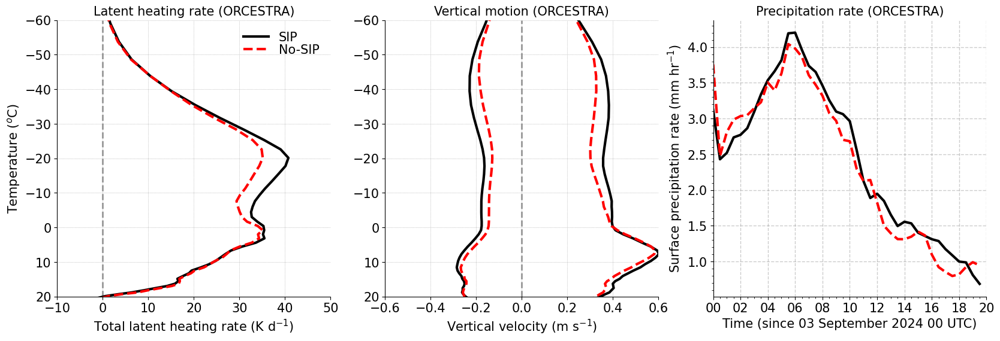

In [50]:
import matplotlib.pyplot as plt
from datetime import datetime
import matplotlib.dates as mdates

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(20, 6))

plt.subplot(1, 3, 1)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)
plt.plot(mean_lhr_kperday_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(mean_lhr_kperday_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')

plt.xlim(-10, 50)
plt.ylim(20, -60)
plt.xticks([-10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Latent heating rate (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1, 3, 2)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)

plt.plot(avg_wvel_up_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(avg_wvel_up_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')
plt.plot(avg_wvel_dn_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth)
plt.plot(avg_wvel_dn_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth)

plt.xlim(-0.6, 0.6)
plt.ylim(20, -60)
plt.xticks([-0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6], fontsize=fontsize)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Vertical motion (ORCESTRA)', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

#precip_rate_sip
plt.subplot(1, 3, 3)
plt.plot(ds_sip_new.time[:-1], precip_rate_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time[:-1], precip_rate_nosip, "r--", label="No-SIP", linewidth = lnwdth)

#plt.plot(ds_sip_new.time, acc_precip_sip, "k-", label="SIP", linewidth = lnwdth)
#plt.plot(ds_nosip_new.time, acc_precip_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Surface precipitation rate (mm hr$^{-1}$)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
#plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Precipitation rate (ORCESTRA)', fontsize=fontsize)
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout to ensure there is no overlap between subplots
#plt.tight_layout()

plt.show()


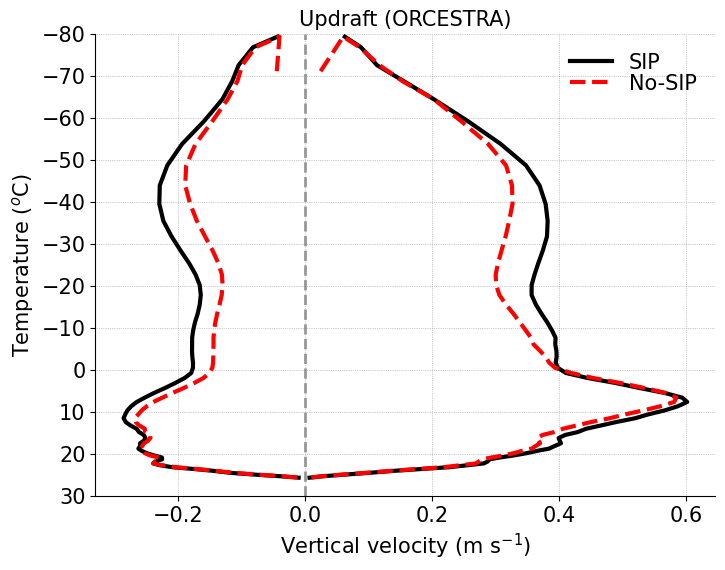

In [73]:
fontsize=15;
lnwdth=3;
alpha=0.6;


plt.figure(figsize=(8, 6))
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)

plt.plot(avg_wvel_up_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(avg_wvel_up_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')
plt.plot(avg_wvel_dn_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth)#, label='SIP')
plt.plot(avg_wvel_dn_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth)#, label='No-SIP')
#plt.xlim(-20, 50)
plt.ylim(30,-80)
#plt.xticks([-20, -10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Updraft (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

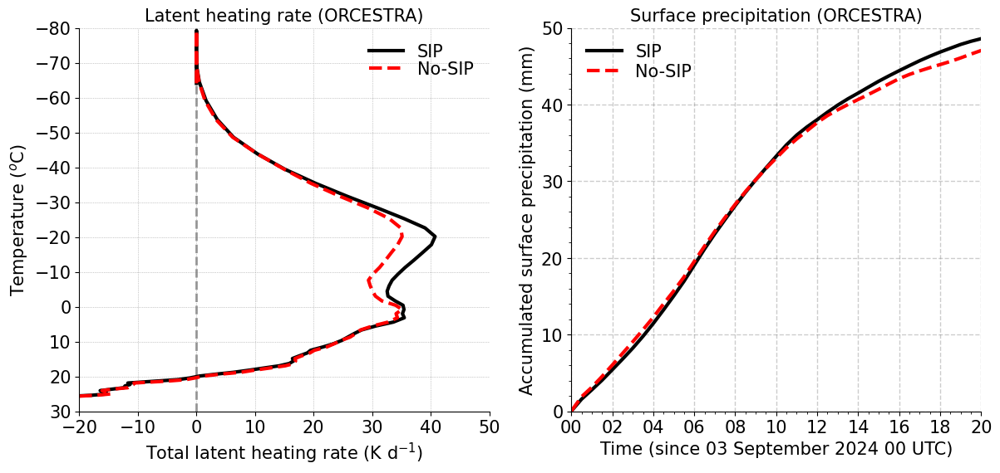

In [60]:

fontsize=15;
lnwdth=3;
alpha=0.6;

plt.figure(figsize=(14, 6))

plt.subplot(1,2,1)
plt.axvline(x=0, color='grey', linestyle='--', linewidth=2, alpha=0.8)
#plt.text(45., 20, "(a)", fontsize=22, ha='center', color='k')#, fontweight='bold')

plt.plot(mean_lhr_kperday_sip, mean_temp-273.15, '-', color='black', linewidth=lnwdth, label='SIP')
plt.plot(mean_lhr_kperday_nosip, mean_temp-273.15, '--', color='red', linewidth=lnwdth, label='No-SIP')

plt.xlim(-20, 50)
plt.ylim(30,-80)
plt.xticks([-20, -10, 0, 10, 20, 30, 40, 50], fontsize=fontsize)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
#plt.yscale('log')
plt.xlabel('Total latent heating rate (K d$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Latent heating rate (ORCESTRA)', fontsize=fontsize)
plt.legend()
# Increase the length of dashes in the legend
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))

plt.grid(True, linestyle=':', linewidth=0.5, color='grey', alpha=0.8)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
#plt.savefig('/work/bb1163/b382718/ICON_ANALYSIS/dcmex/plots/dcmex_inp_teflon.jpg', dpi=600, bbox_inches='tight')

plt.subplot(1,2,2)
#plt.text(1., 1, "(b)", fontsize=22, ha='center', color='k')#, fontweight='bold')

plt.plot(ds_sip_new.time, acc_precip_sip, "k-", label="SIP", linewidth = lnwdth)
plt.plot(ds_nosip_new.time, acc_precip_nosip, "r--", label="No-SIP", linewidth = lnwdth)

plt.grid(True, linestyle='--', color='grey', linewidth=1, alpha=0.4)
plt.minorticks_on()
plt.xlabel('Time (since 03 September 2024 00 UTC)', fontsize=fontsize)
plt.ylabel('Accumulated surface precipitation (mm)', fontsize=fontsize)
start_date = datetime(2024, 9, 3, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 3, 20, 0)
plt.xlim(start_date, end_date)
plt.ylim(0, 50)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)
plt.title('Surface precipitation (ORCESTRA)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.2, fontsize=fontsize, loc='upper left')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.show()

In [25]:

#### No SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_nosip = ds_nosip_effrad_new.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip_effrad_new.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip_effrad_new.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip_effrad_new.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip_effrad_new.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip_effrad_new.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip_effrad_new.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip_effrad_new.lwflx_dn_clr[:,0,:]

#### SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_sip = ds_sip_effrad_new.swflx_up[:,0,:]
toa_sw_up_clr_sip = ds_sip_effrad_new.swflx_up_clr[:,0,:]
toa_lw_up_sip = ds_sip_effrad_new.lwflx_up[:,0,:]
toa_lw_up_clr_sip = ds_sip_effrad_new.lwflx_up_clr[:,0,:]

toa_sw_dn_sip = ds_sip_effrad_new.swflx_dn[:,0,:]
toa_sw_dn_clr_sip = ds_sip_effrad_new.swflx_dn_clr[:,0,:]
toa_lw_dn_sip = ds_sip_effrad_new.lwflx_dn[:,0,:]
toa_lw_dn_clr_sip = ds_sip_effrad_new.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

#toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_sip = (toa_sw_dn_sip-toa_sw_up_sip) - (toa_sw_dn_clr_sip-toa_sw_up_clr_sip)

#toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_sip = (toa_sw_dn_sip-toa_lw_up_sip) - (toa_sw_dn_clr_sip-toa_lw_up_clr_sip)

#toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_sip = toa_cre_sw_sip+toa_cre_lw_sip

#del_toa_sw_cre_efrad = toa_cre_sw_nosip_efrad-toa_cre_sw_nosip
#del_toa_lw_cre_efrad = toa_cre_lw_nosip_efrad-toa_cre_lw_nosip



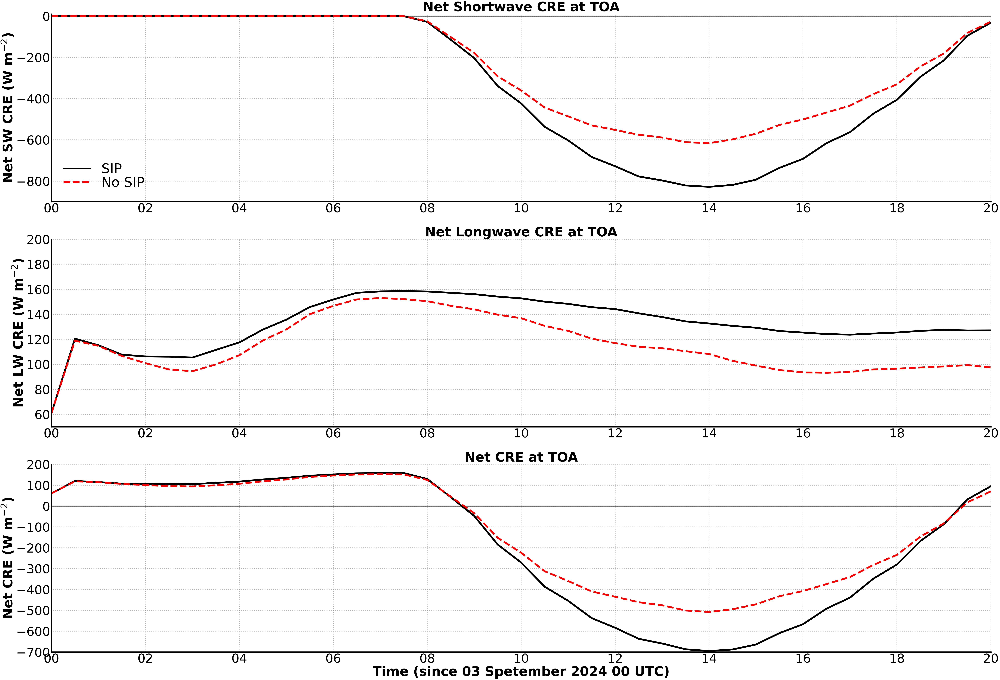

In [45]:

#plt.figure(figsize=(16, 5))
plt.figure(figsize=(95, 65))

lnwdth=10
fontsize=70
plt.subplot(3,1,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=6, alpha=0.5)

plt.plot(ds_sip_effrad_new.time, toa_cre_sw_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_cre_sw_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
#plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-900,10)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net SW CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net Shortwave CRE at TOA', fontsize=fontsize+4, fontweight='bold')
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize+6, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)

plt.subplot(3,1,2)
#plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_sip_effrad_new.time, toa_cre_lw_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_cre_lw_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
#plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize+4)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(50,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net LW CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net Longwave CRE at TOA', fontsize=fontsize+4, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)

plt.subplot(3,1,3)
plt.axhline(y=0, color='k', linestyle='-', linewidth=6, alpha=0.5)

#plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'r-', linewidth=linewidth, label='1-moment')
plt.plot(ds_sip_effrad_new.time, toa_net_cre_sip.mean('ncells'), 'k-', linewidth=lnwdth, label='SIP')
plt.plot(ds_nosip_effrad_new.time, toa_net_cre_nosip.mean('ncells'), 'r--', linewidth=lnwdth, label='No SIP')
plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize+4, fontweight='bold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-700,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fontsize+4, fontweight='bold')
plt.title('Net CRE at TOA', fontsize=fontsize+4, fontweight='bold')
#plt.legend()
#plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', linewidth=4, color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_linewidth(7)
plt.gca().spines['bottom'].set_linewidth(7)
#plt.tight_layout()
plt.show()

In [5]:


#### 1-moment
toa_sw_up_1mom = ds_1mom.swflx_up[:,0,:]
toa_sw_up_clr_1mom = ds_1mom.swflx_up_clr[:,0,:]
toa_lw_up_1mom = ds_1mom.lwflx_up[:,0,:]
toa_lw_up_clr_1mom = ds_1mom.lwflx_up_clr[:,0,:]

toa_sw_dn_1mom = ds_1mom.swflx_dn[:,0,:]
toa_sw_dn_clr_1mom = ds_1mom.swflx_dn_clr[:,0,:]
toa_lw_dn_1mom = ds_1mom.lwflx_dn[:,0,:]
toa_lw_dn_clr_1mom = ds_1mom.lwflx_dn_clr[:,0,:]

#### No SIP (Generalized estimation for effective particle size, not dependent on number conc.)
toa_sw_up_nosip = ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr[:,0,:]

#### No SIP (Effective particle size is being estimated from number conc.)
toa_sw_up_nosip_efrad = ds_nosip_effrad.swflx_up[:,0,:]
toa_sw_up_clr_nosip_efrad = ds_nosip_effrad.swflx_up_clr[:,0,:]
toa_lw_up_nosip_efrad = ds_nosip_effrad.lwflx_up[:,0,:]
toa_lw_up_clr_nosip_efrad = ds_nosip_effrad.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip_efrad = ds_nosip_effrad.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip_efrad = ds_nosip_effrad.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip_efrad = ds_nosip_effrad.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip_efrad = ds_nosip_effrad.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_nosip_efrad = (toa_sw_dn_nosip_efrad-toa_sw_up_nosip_efrad) - (toa_sw_dn_clr_nosip_efrad-toa_sw_up_clr_nosip_efrad)

toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_nosip_efrad = (toa_lw_dn_nosip_efrad-toa_lw_up_nosip_efrad) - (toa_lw_dn_clr_nosip_efrad-toa_lw_up_clr_nosip_efrad)

toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_nosip_efrad = toa_cre_sw_nosip_efrad+toa_cre_lw_nosip_efrad

del_toa_sw_cre_efrad = toa_cre_sw_nosip_efrad-toa_cre_sw_nosip
del_toa_lw_cre_efrad = toa_cre_lw_nosip_efrad-toa_cre_lw_nosip
del_toa_net_cre_efrad = toa_net_cre_nosip_efrad-toa_net_cre_nosip



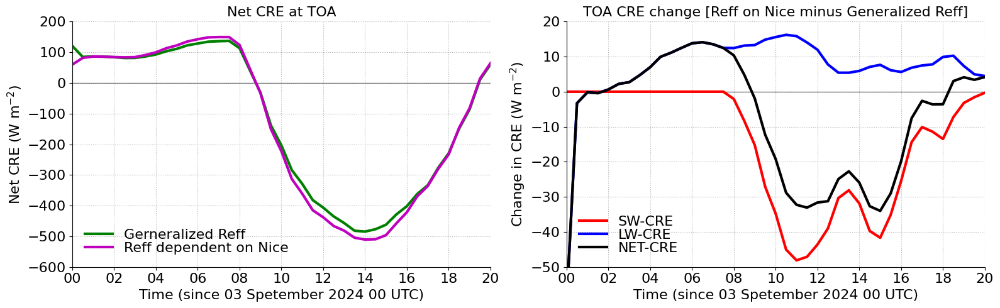

In [6]:

plt.figure(figsize=(16, 5))
linewidth=3
fontsize=16
plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

#plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'r-', linewidth=linewidth, label='1-moment')
plt.plot(ds_nosip.time, toa_net_cre_nosip.mean('ncells'), 'g-', linewidth=linewidth, label='Gerneralized Reff')
plt.plot(ds_nosip_effrad.time, toa_net_cre_nosip_efrad.mean('ncells'), 'm-', linewidth=linewidth, label='Reff dependent on Nice')
plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-600,200)
plt.yticks(fontsize=fontsize)
plt.ylabel('Net CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('Net CRE at TOA', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle=':', color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_nosip_effrad.time, del_toa_sw_cre_efrad.mean('ncells'), 'r-', linewidth=linewidth, label='SW-CRE')
plt.plot(ds_nosip_effrad.time, del_toa_lw_cre_efrad.mean('ncells'), 'b-', linewidth=linewidth, label='LW-CRE')
plt.plot(ds_nosip_effrad.time, del_toa_net_cre_efrad.mean('ncells'), 'k-', linewidth=linewidth, label='NET-CRE')

plt.xlabel('Time (since 03 Spetember 2024 00 UTC)', fontsize=fontsize)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)  
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-50,20)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('TOA CRE change [Reff on Nice minus Generalized Reff]', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, ncols=1, loc='lower left')
plt.grid(True, linestyle=':', color='grey',alpha=0.6)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

In [45]:
print(ds_sip.ddt_temp_radsw.min().values)
print(ds_sip.ddt_temp_radsw.max().values)

0.0
0.0012396787


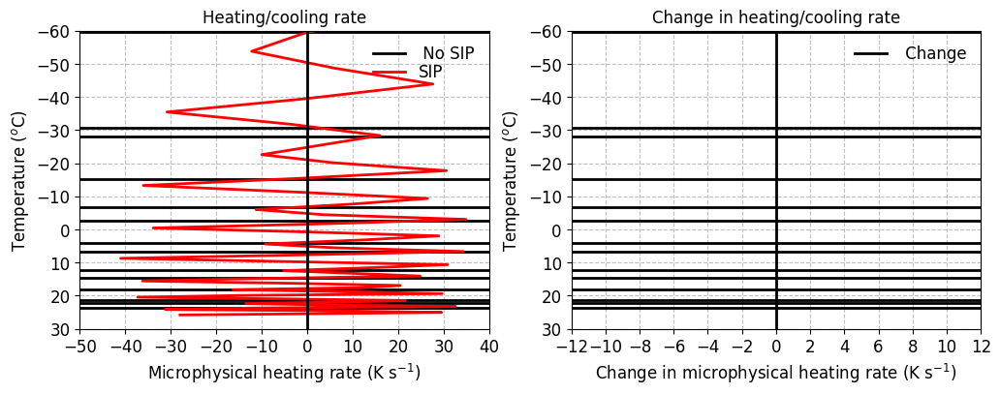

In [6]:


filt_ddt_gscp = xr.where(ds_nosip.tot_qcld > 1.e-5, ds_nosip.d_lhr, np.nan)
mean_microph_ddt_nosip = filt_ddt_gscp.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))

filt_ddt_gscp = xr.where(ds_sip.tot_qcld > 1.e-5, ds_sip.ddt_temp_gscp, np.nan)
mean_microph_ddt_sip = filt_ddt_gscp.mean(dim=('time','ncells'))
mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))

del_microph_ddt = mean_microph_ddt_sip-mean_microph_ddt_nosip

# Plotting
plt.figure(figsize=(12, 4))
deg_faint_errbar = 0.6
lnwdth=2
fontsize=12
plt.subplot(1,2,1)
plt.plot(mean_microph_ddt_nosip,mean_tempc_nosip, 'k-', label=' No SIP', linewidth = lnwdth)
plt.plot(mean_microph_ddt_sip,mean_tempc_sip, 'r-', label='SIP', linewidth = lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2)

plt.xlim(-50, 40)
plt.xticks([-50, -40, -30, -20, -10, 0, 10, 20, 30, 40], fontsize=fontsize)
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Heating/cooling rate', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.grid(True, linestyle='--', alpha=0.5, color='grey')

plt.subplot(1,2,2)

plt.plot(del_microph_ddt,mean_tempc_nosip, 'k-', label=' Change', linewidth = lnwdth)
plt.axvline(x=0, color='k', linestyle='-', linewidth=2)

plt.xlim(-12, 12)
plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12], fontsize=fontsize)
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60], fontsize=fontsize)
plt.xlabel('Change in microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Change in heating/cooling rate', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')#, ncol = 1, fontsize='16', bbox_to_anchor=(1.02, 1.02))
plt.grid(True, linestyle='--', alpha=0.5, color='grey')

plt.show()


In [48]:
ds_sip

<xarray.Dataset>
Dimensions:         (time: 41, ncells: 73960, vertices: 3, height: 65, bnds: 2,
                     height_2: 66, plev: 1, plev_2: 1, plev_3: 1)
Coordinates:
  * time            (time) datetime64[ns] 2024-09-03 ... 2024-09-03T20:00:00
    clon            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
    clat            (ncells) float64 dask.array<chunksize=(73960,), meta=np.ndarray>
  * height          (height) float64 1.0 2.0 3.0 4.0 5.0 ... 62.0 63.0 64.0 65.0
  * height_2        (height_2) float64 1.0 2.0 3.0 4.0 ... 63.0 64.0 65.0 66.0
  * plev            (plev) float64 800.0
  * plev_2          (plev_2) float64 400.0
  * plev_3          (plev_3) float64 0.0
Dimensions without coordinates: ncells, vertices, bnds
Data variables: (12/85)
    clon_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    clat_bnds       (time, ncells, vertices) float64 dask.array<chunksize=(1, 73960, 3), meta=np.ndarray>
    height_bnds     (time, height, bnds) float64 dask.array<chunksize=(1, 65, 2), meta=np.ndarray>
    plev_bnds       (time, plev, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_2_bnds     (time, plev_2, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    plev_3_bnds     (time, plev_3, bnds) float64 dask.array<chunksize=(1, 1, 2), meta=np.ndarray>
    ...              ...
    tot_qcld        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    lwc_gperm3      (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    ciwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    tiwc_gperm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    cdnc_percm3     (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
    inc_perl        (time, height, ncells) float32 dask.array<chunksize=(1, 65, 73960), meta=np.ndarray>
Attributes:
    CDI:                  Climate Data Interface version 2.4.0 (https://mpime...
    Conventions:          CF-1.6
    number_of_grid_used:  99
    uuidOfHGrid:          572c63b4-5951-d138-93bd-61b05c102860
    uuidOfVGrid:          567425a0-32bf-151c-3811-4389b7cd21e0
    institution:          Max Planck Institute for Meteorology/Deutscher Wett...
    title:                ICON simulation
    source:               version: 2024.10; revision: 885c4646a69d44aa9e9fdf4...
    history:              /home/b/b382718/tdf_sip_lfr/icon-oct2024/bin/icon a...
    references:           see MPIM/DWD publications
    comment:              Deepak Waman (b382718) on l40493 (Linux 4.18.0-513....

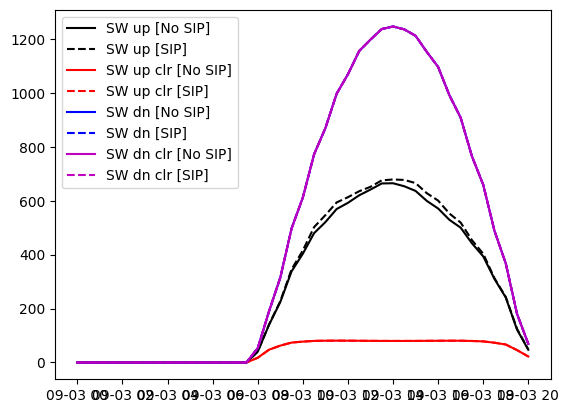

In [7]:

#### 1-moment
toa_sw_up_1mom = ds_1mom.swflx_up[:,0,:]
toa_sw_up_clr_1mom = ds_1mom.swflx_up_clr[:,0,:]
toa_lw_up_1mom = ds_1mom.lwflx_up[:,0,:]
toa_lw_up_clr_1mom = ds_1mom.lwflx_up_clr[:,0,:]

toa_sw_dn_1mom = ds_1mom.swflx_dn[:,0,:]
toa_sw_dn_clr_1mom = ds_1mom.swflx_dn_clr[:,0,:]
toa_lw_dn_1mom = ds_1mom.lwflx_dn[:,0,:]
toa_lw_dn_clr_1mom = ds_1mom.lwflx_dn_clr[:,0,:]

#### SIP
toa_sw_up_sip = ds_sip.swflx_up[:,0,:]
toa_sw_up_clr_sip = ds_sip.swflx_up_clr[:,0,:]
toa_lw_up_sip = ds_sip.lwflx_up[:,0,:]
toa_lw_up_clr_sip = ds_sip.lwflx_up_clr[:,0,:]

toa_sw_dn_sip = ds_sip.swflx_dn[:,0,:]
toa_sw_dn_clr_sip = ds_sip.swflx_dn_clr[:,0,:]
toa_lw_dn_sip = ds_sip.lwflx_dn[:,0,:]
toa_lw_dn_clr_sip = ds_sip.lwflx_dn_clr[:,0,:]

#### No SIP
toa_sw_up_nosip = ds_nosip.swflx_up[:,0,:]
toa_sw_up_clr_nosip = ds_nosip.swflx_up_clr[:,0,:]
toa_lw_up_nosip = ds_nosip.lwflx_up[:,0,:]
toa_lw_up_clr_nosip = ds_nosip.lwflx_up_clr[:,0,:]

toa_sw_dn_nosip = ds_nosip.swflx_dn[:,0,:]
toa_sw_dn_clr_nosip = ds_nosip.swflx_dn_clr[:,0,:]
toa_lw_dn_nosip = ds_nosip.lwflx_dn[:,0,:]
toa_lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr[:,0,:]

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

toa_cre_sw_1mom = (toa_sw_dn_1mom-toa_sw_up_1mom) - (toa_sw_dn_clr_1mom-toa_sw_up_clr_1mom)
toa_cre_sw_nosip = (toa_sw_dn_nosip-toa_sw_up_nosip) - (toa_sw_dn_clr_nosip-toa_sw_up_clr_nosip)
toa_cre_sw_sip = (toa_sw_dn_sip-toa_sw_up_sip) - (toa_sw_dn_clr_sip-toa_sw_up_clr_sip)

toa_cre_lw_1mom = (toa_lw_dn_1mom-toa_lw_up_1mom) - (toa_lw_dn_clr_1mom-toa_lw_up_clr_1mom)
toa_cre_lw_nosip = (toa_sw_dn_nosip-toa_lw_up_nosip) - (toa_sw_dn_clr_nosip-toa_lw_up_clr_nosip)
toa_cre_lw_sip = (toa_lw_dn_sip-toa_lw_up_sip) - (toa_lw_dn_clr_sip-toa_lw_up_clr_sip)

toa_net_cre_1mom = toa_cre_sw_1mom+toa_cre_lw_1mom
toa_net_cre_nosip = toa_cre_sw_nosip+toa_cre_lw_nosip
toa_net_cre_sip = toa_cre_sw_sip+toa_cre_lw_sip

del_toa_sw_cre = toa_cre_sw_sip-toa_cre_sw_nosip
del_toa_lw_cre = toa_cre_lw_sip-toa_cre_lw_nosip
del_toa_net_cre = toa_net_cre_sip-toa_net_cre_nosip

plt.plot(ds_nosip.time,toa_sw_up_nosip.mean('ncells'), 'k-', label='SW up [No SIP]')
plt.plot(ds_sip.time,toa_sw_up_sip.mean('ncells'), 'k--', label='SW up [SIP]')
plt.plot(ds_nosip.time,toa_sw_up_clr_nosip.mean('ncells'), 'r-', label='SW up clr [No SIP]')
plt.plot(ds_sip.time,toa_sw_up_clr_sip.mean('ncells'), 'r--', label='SW up clr [SIP]')
plt.plot(ds_nosip.time,toa_sw_dn_nosip.mean('ncells'), 'b-', label='SW dn [No SIP]')
plt.plot(ds_sip.time,toa_sw_dn_sip.mean('ncells'), 'b--', label='SW dn [SIP]')
plt.plot(ds_nosip.time,toa_sw_dn_clr_nosip.mean('ncells'), 'm-', label='SW dn clr [No SIP]')
plt.plot(ds_sip.time,toa_sw_dn_clr_sip.mean('ncells'), 'm--', label='SW dn clr [SIP]')
plt.legend()
#plt.plot(ds_sip.time,toa_cre_sw_sip.mean('ncells')-toa_cre_sw_nosip.mean('ncells'), 'k-', label='SW-CRE @ TOA')
#plt.plot(ds_sip.time,toa_cre_lw_sip.mean('ncells')-toa_cre_lw_nosip.mean('ncells'), 'r-', label='LW-CRE @ TOA')

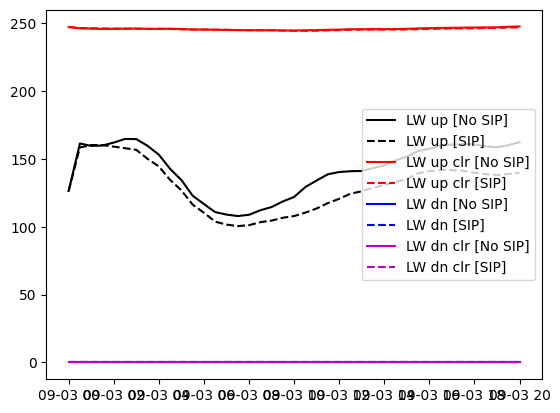

In [69]:
plt.plot(ds_nosip.time,toa_lw_up_nosip.mean('ncells'), 'k-', label='LW up [No SIP]')
plt.plot(ds_sip.time,toa_lw_up_sip.mean('ncells'), 'k--', label='LW up [SIP]')
plt.plot(ds_nosip.time,toa_lw_up_clr_nosip.mean('ncells'), 'r-', label='LW up clr [No SIP]')
plt.plot(ds_sip.time,toa_lw_up_clr_sip.mean('ncells'), 'r--', label='LW up clr [SIP]')
plt.plot(ds_nosip.time,toa_lw_dn_nosip.mean('ncells'), 'b-', label='LW dn [No SIP]')
plt.plot(ds_sip.time,toa_lw_dn_sip.mean('ncells'), 'b--', label='LW dn [SIP]')
plt.plot(ds_nosip.time,toa_lw_dn_clr_nosip.mean('ncells'), 'm-', label='LW dn clr [No SIP]')
plt.plot(ds_sip.time,toa_lw_dn_clr_sip.mean('ncells'), 'm--', label='LW dn clr [SIP]')
plt.legend()

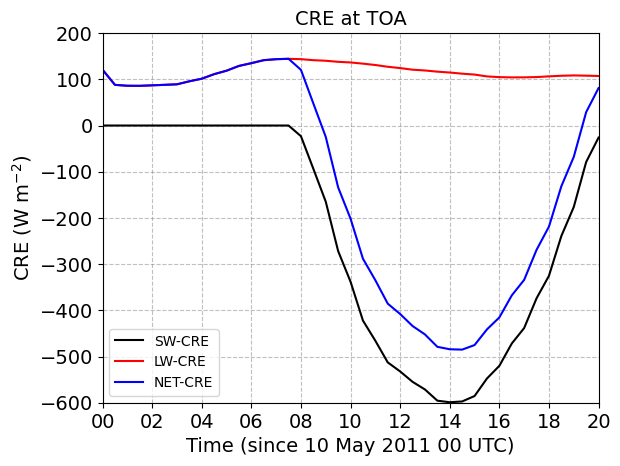

In [82]:
plt.plot(ds_sip.time, toa_cre_sw_sip.mean('ncells'), 'k-', label='SW-CRE')
plt.plot(ds_sip.time, toa_cre_lw_sip.mean('ncells'), 'r-', label='LW-CRE')
plt.plot(ds_sip.time, toa_net_cre_sip.mean('ncells'), 'b-', label='NET-CRE')
plt.xlabel('Time (since 10 May 2011 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0)  # Start at 00 UTC on 10 May 2011
end_date = datetime(2024, 9, 3, 20, 0)   # End at 12 UTC on 12 May 2011
plt.xlim(start_date, end_date)
plt.xticks(fontsize=14)
plt.ylim(-600,200)
plt.yticks(fontsize=14)
plt.ylabel('CRE (W m$^{-2}$)', fontsize=14)
plt.title('CRE at TOA', fontsize=14)
plt.legend()
plt.grid(True, linestyle='--', color='grey',alpha=0.5)

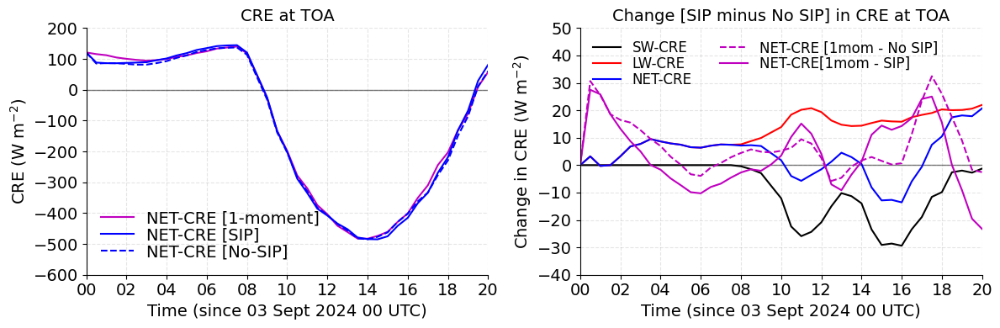

In [9]:

plt.figure(figsize=(12, 4))
linewidth=2
fontsize=14
plt.subplot(1,2,1)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_1mom.time, toa_net_cre_1mom.mean('ncells'), 'm-', label='NET-CRE [1-moment]')
#plt.plot(ds_sip.time, toa_cre_sw_sip.mean('ncells'), 'k-', label='SW-CRE [SIP]')
#plt.plot(ds_sip.time, toa_cre_lw_sip.mean('ncells'), 'r-', label='LW-CRE [SIP]')
plt.plot(ds_sip.time, toa_net_cre_sip.mean('ncells'), 'b-', label='NET-CRE [SIP]')
#plt.plot(ds_sip.time, toa_cre_sw_nosip.mean('ncells'), 'k--', label='SW-CRE [No-SIP]')
#plt.plot(ds_sip.time, toa_cre_lw_nosip.mean('ncells'), 'r--', label='LW-CRE [No-SIP]')
plt.plot(ds_sip.time, toa_net_cre_nosip.mean('ncells'), 'b--', label='NET-CRE [No-SIP]')
plt.xlabel('Time (since 03 Sept 2024 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)   
plt.xlim(start_date, end_date)
plt.xticks(fontsize=14)
plt.ylim(-600,200)
plt.yticks(fontsize=14)
plt.ylabel('CRE (W m$^{-2}$)', fontsize=14)
plt.title('CRE at TOA', fontsize=14)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle='--', color='grey',alpha=0.2)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)

plt.axhline(y=0, color='k', linestyle='-', linewidth=1, alpha=0.5)

plt.plot(ds_sip.time, del_toa_sw_cre.mean('ncells'), 'k-', label='SW-CRE')
plt.plot(ds_sip.time, del_toa_lw_cre.mean('ncells'), 'r-', label='LW-CRE')
plt.plot(ds_sip.time, del_toa_net_cre.mean('ncells'), 'b-', label='NET-CRE')
plt.plot(ds_sip.time, toa_net_cre_1mom.mean('ncells')-toa_net_cre_nosip.mean('ncells'), 'm--', label='NET-CRE [1mom - No SIP]')
plt.plot(ds_sip.time, toa_net_cre_1mom.mean('ncells')-toa_net_cre_sip.mean('ncells'), 'm-', label='NET-CRE[1mom - SIP]')



plt.xlabel('Time (since 03 Sept 2024 00 UTC)', fontsize=14)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%H'))
start_date = datetime(2024, 9, 3, 0, 0) 
end_date = datetime(2024, 9, 3, 20, 0)  
plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.ylim(-40,50)
plt.yticks(fontsize=fontsize)
plt.ylabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.title('Change [SIP minus No SIP] in CRE at TOA', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, ncols=2, loc='upper left')
plt.grid(True, linestyle='--', color='grey',alpha=0.2)

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

In [88]:

sw_up_sip = ds_sip.swflx_up
sw_up_clr_sip = ds_sip.swflx_up_clr
lw_up_sip = ds_sip.lwflx_up
lw_up_clr_sip = ds_sip.lwflx_up_clr

sw_dn_sip = ds_sip.swflx_dn
sw_dn_clr_sip = ds_sip.swflx_dn_clr
lw_dn_sip = ds_sip.lwflx_dn
lw_dn_clr_sip = ds_sip.lwflx_dn_clr

sw_up_nosip = ds_nosip.swflx_up
sw_up_clr_nosip = ds_nosip.swflx_up_clr
lw_up_nosip = ds_nosip.lwflx_up
lw_up_clr_nosip = ds_nosip.lwflx_up_clr

sw_dn_nosip = ds_nosip.swflx_dn
sw_dn_clr_nosip = ds_nosip.swflx_dn_clr
lw_dn_nosip = ds_nosip.lwflx_dn
lw_dn_clr_nosip = ds_nosip.lwflx_dn_clr

#CRE_sw = (Qcld_sw_dn - Qcld_sw_up) - (Qclear_sw_dn - Qclear_sw_up)

cre_sw_nosip = (sw_dn_nosip-sw_up_nosip) - (sw_dn_clr_nosip-sw_up_clr_nosip)
cre_sw_sip = (sw_dn_sip-sw_up_sip) - (sw_dn_clr_sip-sw_up_clr_sip)

cre_lw_nosip = (sw_dn_nosip-lw_up_nosip) - (sw_dn_clr_nosip-lw_up_clr_nosip)
cre_lw_sip = (lw_dn_sip-lw_up_sip) - (lw_dn_clr_sip-lw_up_clr_sip)

net_cre_nosip = cre_sw_nosip+cre_lw_nosip
net_cre_sip = cre_sw_sip+cre_lw_sip

del_sw_cre = cre_sw_sip-cre_sw_nosip
del_lw_cre = cre_lw_sip-cre_lw_nosip
del_net_cre = net_cre_sip-net_cre_nosip


In [ ]:

mean_cre_sw_sip = cre_sw_sip.mean(dim=('time','ncells'))
mean_cre_lw_sip = cre_lw_sip.mean(dim=('time','ncells'))
mean_cre_net_sip = net_cre_sip.mean(dim=('time','ncells'))

mean_cre_sw_nosip = cre_sw_nosip.mean(dim=('time','ncells'))
mean_cre_lw_nosip = cre_lw_nosip.mean(dim=('time','ncells'))
mean_cre_net_nosip = net_cre_nosip.mean(dim=('time','ncells'))

mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))


mean_del_sw_cre = mean_cre_sw_sip-mean_cre_sw_nosip
mean_del_lw_cre = mean_cre_lw_sip-mean_cre_lw_nosip
mean_del_net_cre = mean_cre_net_sip-mean_cre_net_nosip

plt.figure(figsize=(12, 4))
linewidth=2
fontsize=14
plt.subplot(1,2,1)
plt.plot(mean_cre_sw_sip[:-1], mean_tempc_sip, 'k-', label='SW-CRE  [SIP]')
plt.plot(mean_cre_lw_sip[:-1], mean_tempc_sip, 'r-', label='LW-CRE [SIP]')
plt.plot(mean_cre_net_sip[:-1], mean_tempc_sip, 'b-', label='NET-CRE [SIP]')
plt.plot(mean_cre_sw_nosip[:-1], mean_tempc_sip, 'k--', label='SW-CRE  [No-SIP]')
plt.plot(mean_cre_lw_nosip[:-1], mean_tempc_sip, 'r--', label='LW-CRE [No-SIP]')
plt.plot(mean_cre_net_nosip[:-1],mean_tempc_sip, 'b--', label='NET-CRE [No-SIP]')

plt.xticks(fontsize=fontsize)
plt.xlim(-500,200)
plt.ylim(30,-60)
plt.yticks(fontsize=14)
plt.xlabel('CRE (W m$^{-2}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
plt.grid(True, linestyle='--', color='grey',alpha=0.5)

plt.subplot(1,2,2)
plt.plot(mean_del_sw_cre[:-1], mean_tempc_sip, 'k-', label='SW-CRE')
plt.plot(mean_del_lw_cre[:-1], mean_tempc_sip, 'r-', label='LW-CRE')
plt.plot(mean_del_net_cre[:-1], mean_tempc_sip, 'b-', label='NET-CRE')

#plt.xlim(start_date, end_date)
plt.xticks(fontsize=fontsize)
plt.xlim(-50,300)
plt.ylim(30,-60)
plt.yticks(fontsize=fontsize)
plt.xlabel('Change in CRE (W m$^{-2}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Change [SIP minus No SIP] in CRE', fontsize=fontsize)
plt.legend()
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper left')
plt.grid(True, linestyle='--', color='grey',alpha=0.5)
plt.tight_layout()
plt.show()

/tmp/ipykernel_3863367/1962754006.py:46: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')


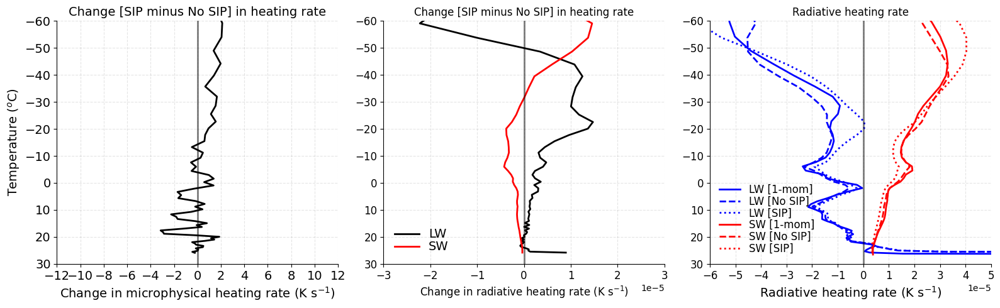

In [143]:
### Microphysical temperature tendency
mean_microph_ddt_1mom = ds_1mom.ddt_temp_gscp.mean(dim=('time','ncells'))
mean_microph_ddt_nosip = ds_nosip.ddt_temp_gscp.mean(dim=('time','ncells'))
mean_microph_ddt_sip = ds_sip.ddt_temp_gscp.mean(dim=('time','ncells'))

del_microph_ddt = mean_microph_ddt_sip-mean_microph_ddt_nosip

mean_tempc_1mom = ds_1mom.tempc.mean(dim=('time','ncells'))
mean_tempc_nosip = ds_nosip.tempc.mean(dim=('time','ncells'))
mean_tempc_sip = ds_sip.tempc.mean(dim=('time','ncells'))

### LW temperature tendency
mean_lw_ddt_1mom = ds_1mom.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_lw_ddt_nosip = ds_nosip.ddt_temp_radlw.mean(dim=('time','ncells'))
mean_lw_ddt_sip = ds_sip.ddt_temp_radlw.mean(dim=('time','ncells'))

del_lw_ddt = mean_lw_ddt_sip-mean_lw_ddt_nosip

### SW temperature tendency
mean_sw_ddt_1mom = ds_1mom.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_sw_ddt_nosip = ds_nosip.ddt_temp_radsw.mean(dim=('time','ncells'))
mean_sw_ddt_sip = ds_sip.ddt_temp_radsw.mean(dim=('time','ncells'))

del_sw_ddt = mean_sw_ddt_sip-mean_sw_ddt_nosip


fig, axes = plt.subplots(1, 3, figsize=(16, 5))

deg_faint_errbar = 0.6
lnwdth = 2
fontsize = 14

# Subplot 1: Change in microphysical heating/cooling rate
axes[0].plot(del_microph_ddt, mean_tempc_nosip, 'k-', label='', linewidth=lnwdth)

axes[0].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[0].set_xlim(-12, 12)
axes[0].set_xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
axes[0].tick_params(axis='both', labelsize=fontsize)
axes[0].set_ylim(30, -60)
axes[0].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[0].set_xlabel('Change in microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
axes[0].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[0].set_title('Change [SIP minus No SIP] in heating rate', fontsize=fontsize)
axes[0].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
axes[0].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[0].spines['top'].set_visible(False)
axes[0].spines['right'].set_visible(False)

# Subplot 2: Change in radiative heating/cooling rate
axes[1].plot(del_lw_ddt, mean_tempc_sip, 'k-', label='LW', linewidth=lnwdth)
axes[1].plot(del_sw_ddt, mean_tempc_sip, 'r-', label='SW', linewidth=lnwdth)
axes[1].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[1].set_xlim(-3.e-5, 3.e-5)
axes[1].set_xticks([-3.e-5, -2.e-5, -1.e-5, 0, 1.e-5, 2.e-5, 3.e-5])
axes[1].set_ylim(30, -60)
#axes[1].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[1].tick_params(axis='both', labelsize=fontsize-2)
axes[1].set_xlabel('Change in radiative heating rate (K s$^{-1}$)', fontsize=fontsize-2)
#axes[1].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[1].set_title('Change [SIP minus No SIP] in heating rate', fontsize=fontsize-2)
axes[1].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='lower left')
axes[1].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[1].spines['top'].set_visible(False)
axes[1].spines['right'].set_visible(False)

# Subplot 3: Change in radiative heating/cooling rate
axes[2].plot(mean_lw_ddt_1mom, mean_tempc_1mom, 'b-', label='LW [1-mom]', linewidth=lnwdth)
axes[2].plot(mean_lw_ddt_nosip, mean_tempc_sip, 'b--', label='LW [No SIP]', linewidth=lnwdth)
axes[2].plot(mean_lw_ddt_sip, mean_tempc_sip, 'b:', label='LW [SIP]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_1mom, mean_tempc_1mom, 'r-', label='SW [1-mom]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_nosip, mean_tempc_sip, 'r--', label='SW [No SIP]', linewidth=lnwdth)
axes[2].plot(mean_sw_ddt_sip, mean_tempc_sip, 'r:', label='SW [SIP]', linewidth=lnwdth)
axes[2].axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

axes[2].set_xlim(-6.e-5, 5.e-5)
axes[2].set_xticks([-6.e-5, -5.e-5, -4.e-5, -3.e-5, -2.e-5, -1.e-5, 0, 1.e-5, 2.e-5, 3.e-5, 4.e-5, 5.e-5])
axes[2].set_ylim(30, -60)
#axes[2].set_yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
axes[2].tick_params(axis='both', labelsize=fontsize-2)
axes[2].set_xlabel('Radiative heating rate (K s$^{-1}$)', fontsize=fontsize)
#axes[2].set_ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
axes[2].set_title('Radiative heating rate', fontsize=fontsize-2)
axes[2].legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize-2, loc='lower left')
axes[2].grid(True, linestyle='--', alpha=0.2, color='grey')

axes[2].spines['top'].set_visible(False)
axes[2].spines['right'].set_visible(False)

plt.tight_layout()

plt.show()


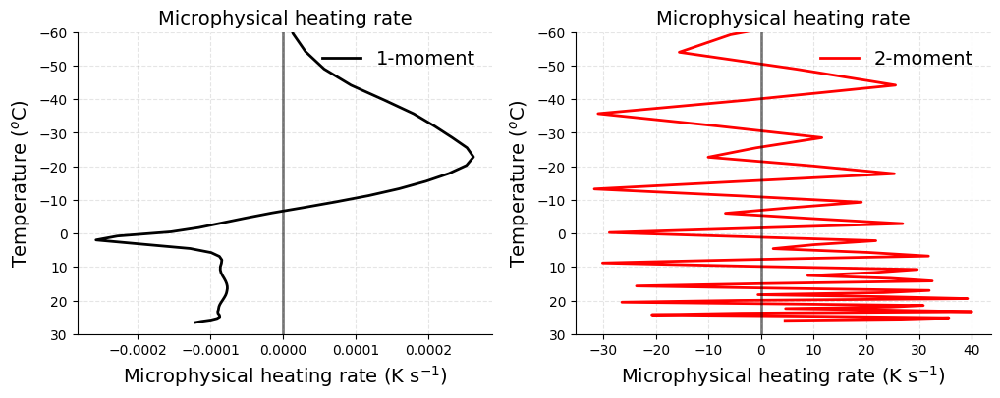

In [149]:

deg_faint_errbar = 0.6
lnwdth = 2
fontsize = 14


plt.figure(figsize=(12, 4))

plt.subplot(1,2,1)
plt.plot(ds_1mom.ddt_temp_gscp.mean(dim=('time','ncells')), ds_1mom.tempc.mean(dim=('time','ncells')), 'k-', label='1-moment', linewidth=lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

#plt.xlim(-12, 12)
#plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Microphysical heating rate', fontsize=fontsize)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.2, color='grey')

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.subplot(1,2,2)
plt.plot(ds_nosip.ddt_temp_gscp.mean(dim=('time','ncells')), ds_nosip.tempc.mean(dim=('time','ncells')), 'r-', label='2-moment', linewidth=lnwdth)

plt.axvline(x=0, color='k', linestyle='-', linewidth=2, alpha=0.5)

#plt.xlim(-12, 12)
#plt.xticks([-12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12])
plt.ylim(30, -60)
plt.yticks([30, 20, 10, 0, -10, -20, -30, -40, -50, -60])
plt.xlabel('Microphysical heating rate (K s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature ($^{o}$C)', fontsize=fontsize)
plt.title('Microphysical heating rate', fontsize=fontsize)
plt.legend(frameon=False, handlelength=2, labelspacing=0.05, fontsize=fontsize, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.2, color='grey')

plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)


In [14]:

#######
min_tempc_sip = ds_sip.tempc.min().values
max_tempc_sip = ds_sip.tempc.max().values

min_wvel_sip = ds_sip.w_vel.min().values
max_wvel_sip = ds_sip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_bin = np.linspace(min_tempc_sip, max_tempc_sip, num_temp_bin+1)
wvel_bin = np.linspace(min_wvel_sip, max_wvel_sip, num_w_bin+1)
#######

#######
tempc_sip_flat = ds_sip.tempc.values.flatten()
wvel_sip_flat = ds_sip.w_vel.values.flatten()

qc_sip_flat = ds_sip.qc.values.flatten()
qi_sip_flat = ds_sip.qi.values.flatten()
qs_sip_flat = ds_sip.qs.values.flatten()
qg_sip_flat = ds_sip.qg.values.flatten()
qh_sip_flat = ds_sip.qh.values.flatten()
qr_sip_flat = ds_sip.qr.values.flatten()
tqi_sip_flat = ds_sip.tqi.values.flatten()
#######

hist_sip, temp_edges_sip, wvel_edges_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin))

#######
qc_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qc_sip_flat)[0]
qi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qi_sip_flat)[0]
qs_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qs_sip_flat)[0]
qg_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qg_sip_flat)[0]
qh_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qh_sip_flat)[0]
qr_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = qr_sip_flat)[0]
tqi_sum_sip = np.histogram2d(tempc_sip_flat, wvel_sip_flat, bins=(temp_bin, wvel_bin), weights = tqi_sip_flat)[0]
#######

#######
avg_qc_temp_w_sip = qc_sum_sip/hist_sip
avg_qc_temp_w_sip[avg_qc_temp_w_sip < 1.e-9] = np.nan

avg_qi_temp_w_sip = qi_sum_sip/hist_sip
avg_qi_temp_w_sip[avg_qi_temp_w_sip < 1.e-9] = np.nan

avg_qs_temp_w_sip = qs_sum_sip/hist_sip
avg_qs_temp_w_sip[avg_qs_temp_w_sip < 1.e-9] = np.nan

avg_qg_temp_w_sip = qg_sum_sip/hist_sip
avg_qg_temp_w_sip[avg_qg_temp_w_sip < 1.e-9] = np.nan

avg_qh_temp_w_sip = qh_sum_sip/hist_sip
avg_qh_temp_w_sip[avg_qh_temp_w_sip < 1.e-9] = np.nan

avg_qr_temp_w_sip = qr_sum_sip/hist_sip
avg_qr_temp_w_sip[avg_qr_temp_w_sip < 1.e-9] = np.nan

avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip
avg_tqi_temp_w_sip[avg_tqi_temp_w_sip < 1.e-9] = np.nan
#######


/tmp/ipykernel_758819/3716124162.py:40: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_sip = qc_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:43: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_sip = qi_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:46: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_sip = qs_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:49: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_sip = qg_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:52: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_sip = qh_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:55: RuntimeWarning: invalid value encountered in divide
  avg_qr_temp_w_sip = qr_sum_sip/hist_sip
/tmp/ipykernel_758819/3716124162.py:58: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_sip = tqi_sum_sip/hist_sip


In [13]:

#######
min_tempc_nosip = ds_nosip.tempc.min().values
max_tempc_nosip = ds_nosip.tempc.max().values

min_wvel_nosip = ds_nosip.w_vel.min().values
max_wvel_nosip = ds_nosip.w_vel.max().values

num_temp_bin = 20; num_w_bin = 20;

temp_nosip_bin = np.linspace(min_tempc_nosip, max_tempc_nosip, num_temp_bin+1)
wvel_nosip_bin = np.linspace(min_wvel_nosip, max_wvel_nosip, num_w_bin+1)
#######

#######
tempc_nosip_flat = ds_nosip.tempc.values.flatten()
wvel_nosip_flat = ds_nosip.w_vel.values.flatten()

qc_nosip_flat = ds_nosip.qc.values.flatten()
qi_nosip_flat = ds_nosip.qi.values.flatten()
qs_nosip_flat = ds_nosip.qs.values.flatten()
qg_nosip_flat = ds_nosip.qg.values.flatten()
qh_nosip_flat = ds_nosip.qh.values.flatten()
qr_nosip_flat = ds_nosip.qr.values.flatten()
tqi_nosip_flat = ds_nosip.tqi.values.flatten()
#######

hist_nosip, temp_edges_nosip, wvel_edges_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin))

#######
qc_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qc_nosip_flat)[0]
qi_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qi_nosip_flat)[0]
qs_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qs_nosip_flat)[0]
qg_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qg_nosip_flat)[0]
qh_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qh_nosip_flat)[0]
qr_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = qr_nosip_flat)[0]
tqi_sum_nosip = np.histogram2d(tempc_nosip_flat, wvel_nosip_flat, bins=(temp_nosip_bin, wvel_nosip_bin), weights = tqi_nosip_flat)[0]
#######

#######
avg_qc_temp_w_nosip = qc_sum_nosip/hist_nosip
avg_qc_temp_w_nosip[avg_qc_temp_w_nosip < 1.e-9] = np.nan

avg_qi_temp_w_nosip = qi_sum_nosip/hist_nosip
avg_qi_temp_w_nosip[avg_qi_temp_w_nosip < 1.e-9] = np.nan

avg_qs_temp_w_nosip = qs_sum_nosip/hist_nosip
avg_qs_temp_w_nosip[avg_qs_temp_w_nosip < 1.e-9] = np.nan

avg_qg_temp_w_nosip = qg_sum_nosip/hist_nosip
avg_qg_temp_w_nosip[avg_qg_temp_w_nosip < 1.e-9] = np.nan

avg_qh_temp_w_nosip = qh_sum_nosip/hist_nosip
avg_qh_temp_w_nosip[avg_qh_temp_w_nosip < 1.e-9] = np.nan

avg_qr_temp_w_nosip = qr_sum_nosip/hist_nosip
avg_qr_temp_w_nosip[avg_qr_temp_w_nosip < 1.e-9] = np.nan

avg_tqi_temp_w_nosip = tqi_sum_nosip/hist_nosip
avg_tqi_temp_w_nosip[avg_tqi_temp_w_nosip < 1.e-9] = np.nan
#######


/tmp/ipykernel_758819/67448993.py:40: RuntimeWarning: invalid value encountered in divide
  avg_qc_temp_w_nosip = qc_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:43: RuntimeWarning: invalid value encountered in divide
  avg_qi_temp_w_nosip = qi_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:46: RuntimeWarning: invalid value encountered in divide
  avg_qs_temp_w_nosip = qs_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:49: RuntimeWarning: invalid value encountered in divide
  avg_qg_temp_w_nosip = qg_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:52: RuntimeWarning: invalid value encountered in divide
  avg_qh_temp_w_nosip = qh_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:55: RuntimeWarning: invalid value encountered in divide
  avg_qr_temp_w_nosip = qr_sum_nosip/hist_nosip
/tmp/ipykernel_758819/67448993.py:58: RuntimeWarning: invalid value encountered in divide
  avg_tqi_temp_w_nosip = tqi_sum_nosip/hist_nosip


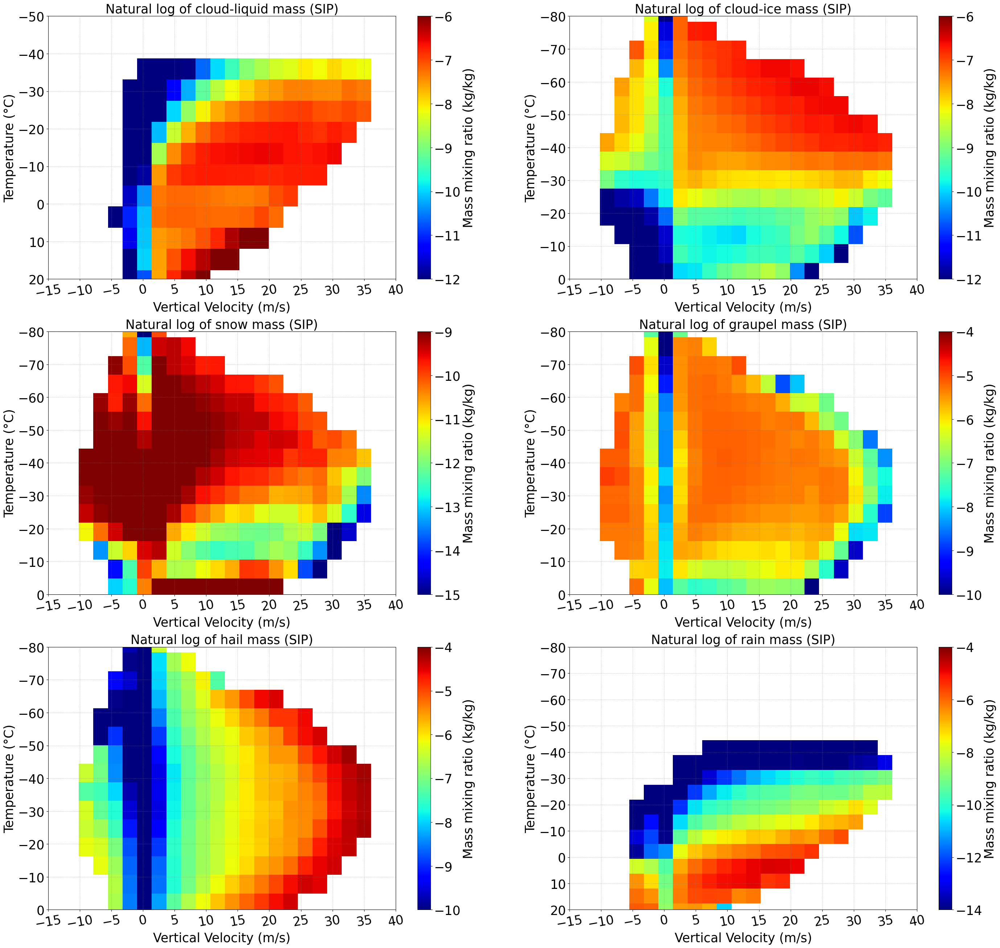

In [20]:


fontsize = 25;
rotation=10

plt.figure(figsize=(34, 32))
plt.subplot(3,2,1)
contour=plt.imshow(np.log(avg_qc_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-liquid mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(np.log(avg_qi_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-ice mass (SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(np.log(avg_qs_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-15, vmax=-9, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of snow mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(np.log(avg_qg_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of graupel mass (SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(np.log(avg_qh_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of hail mass (SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(np.log(avg_qr_temp_w_sip), extent=[wvel_bin[0], wvel_bin[-1],temp_bin[0], temp_bin[-1]], 
                   vmin=-14, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -80)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of rain mass (SIP)', fontsize=fontsize)

plt.show()


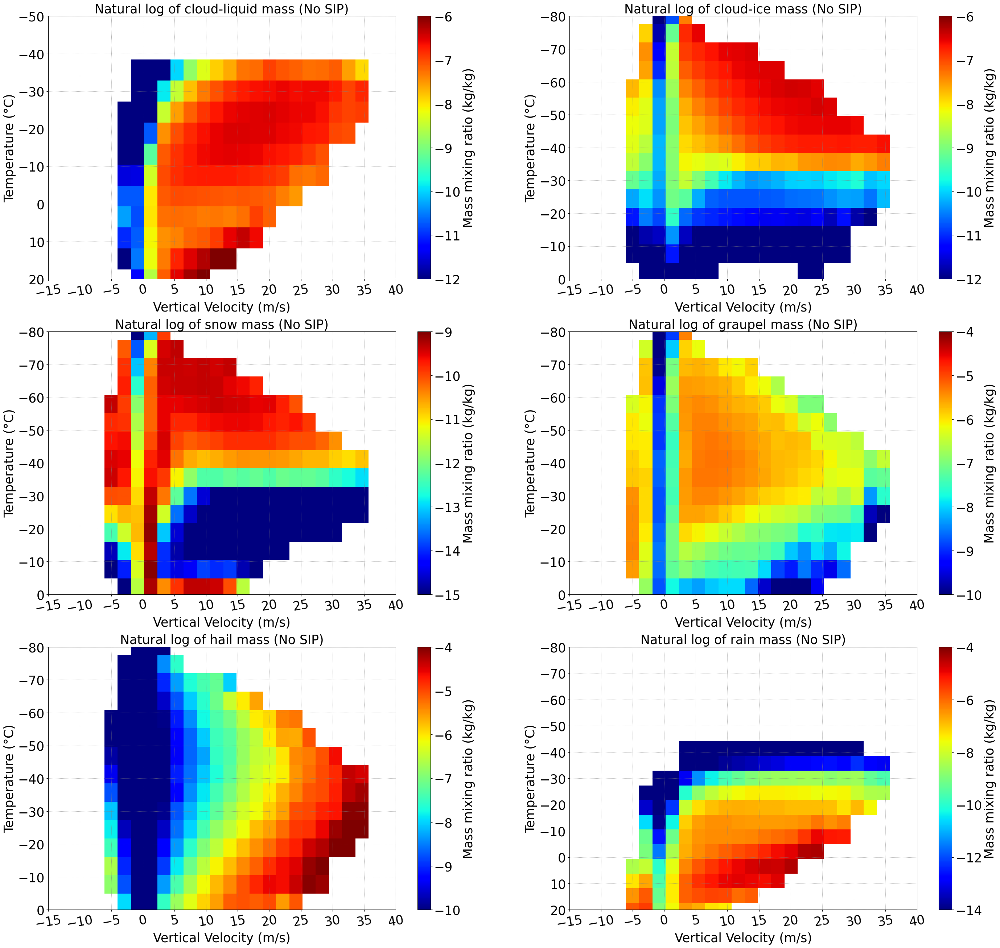

In [22]:


fontsize = 25;
rotation=10

plt.figure(figsize=(34, 32))
plt.subplot(3,2,1)
contour=plt.imshow(np.log(avg_qc_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -50)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-liquid mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,2)
contour=plt.imshow(np.log(avg_qi_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-12, vmax=-6, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of cloud-ice mass (No SIP)', fontsize=fontsize)
#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,3)
contour=plt.imshow(np.log(avg_qs_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-15, vmax=-9, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of snow mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,4)
contour=plt.imshow(np.log(avg_qg_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of graupel mass (No SIP)', fontsize=fontsize)

#plt.show()


#fontsize = 20;

#plt.figure(figsize=(25, 7))
plt.subplot(3,2,5)
contour=plt.imshow(np.log(avg_qh_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-10, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(0, -80)
plt.yticks([0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of hail mass (No SIP)', fontsize=fontsize)

plt.subplot(3,2,6)
contour=plt.imshow(np.log(avg_qr_temp_w_nosip), extent=[wvel_nosip_bin[0], wvel_nosip_bin[-1],temp_nosip_bin[0], temp_nosip_bin[-1]], 
                   vmin=-14, vmax=-4, aspect='auto', origin='lower',cmap='jet')

plt.grid(True, linestyle=':', color='grey',alpha=0.6)
plt.xlim(-15, 40)
plt.xticks([-15, -10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40], fontsize=fontsize, rotation=rotation)
plt.ylim(20, -80)
plt.yticks([20, 10, 0, -10, -20, -30, -40, -50, -60, -70, -80], fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
plt.xlabel('Vertical Velocity (m/s)', fontsize=fontsize)

colorbar=plt.colorbar(label='Average mass (kg/kg)')
colorbar.ax.tick_params(labelsize=fontsize)
colorbar.set_label(label='Mass mixing ratio (kg/kg)', size=fontsize)

plt.title('Natural log of rain mass (No SIP)', fontsize=fontsize)

plt.show()


In [315]:
#### CFAD plots


tempc = ds_sip['tempc'];
ht_km = 1.e-3 * ds_sip['z_mc'];
tempc_avg = tempc.mean(dim=('time', 'ncells'));
ht_avg = ht_km.mean(dim=('time','ncells'));

lwc_sip = ds_sip['lwc_gperm3'];
lwc_sip_filt = xr.where(ds_sip.lwc_gperm3 > 0., ds_sip.lwc_gperm3, np.nan);

lwc_sip_bins = np.linspace(lwc_sip_filt.min().values, lwc_sip_filt.max().values, 20);
cfad_lwc_sip = np.zeros((len(lwc_sip_bins) - 1, len(ht_avg)));
lwc_sip_values = lwc_sip_filt.values;

for i in range(len(lwc_sip_bins) - 1):
    mask = (lwc_sip_values >= lwc_sip_bins[i]) & (lwc_sip_values < lwc_sip_bins[i + 1])    
    cfad_lwc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)


In [316]:

tiwc_sip = ds_sip['tiwc_gperm3'];
tiwc_sip_filt = xr.where(ds_sip.tiwc_gperm3 > 0., ds_sip.tiwc_gperm3, np.nan);

tiwc_sip_bins = np.linspace(tiwc_sip_filt.min().values, tiwc_sip_filt.max().values, 20);
cfad_tiwc_sip = np.zeros((len(tiwc_sip_bins) - 1, len(ht_avg)));
tiwc_sip_values = tiwc_sip_filt.values;

for i in range(len(tiwc_sip_bins) - 1):
    mask = (tiwc_sip_values >= tiwc_sip_bins[i]) & (tiwc_sip_values < tiwc_sip_bins[i + 1])    
    cfad_tiwc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)



In [331]:
print(ds_sip.cdnc_percm3.min().values)
print(ds_sip.cdnc_percm3.max().values)

0.0
269.1216


In [336]:
print(cdnc_sip_bins)

[  0.          14.1642954   28.32859079  42.49288619  56.65718159
  70.82147699  84.98577238  99.15006778 113.31436318 127.47865858
 141.64295397 155.80724937 169.97154477 184.13584016 198.30013556
 212.46443096 226.62872636 240.79302175 254.95731715 269.12161255]


In [350]:

tempc = ds_sip['tempc'];
ht_km = 1.e-3 * ds_sip['z_mc'];
tempc_avg = tempc.mean(dim=('time', 'ncells'));
ht_avg = ht_km.mean(dim=('time','ncells'));

cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(cdnc_sip_filt.min().values, cdnc_sip_filt.max().values, 20);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = cdnc_sip_filt.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)

(30.0, -60.0)

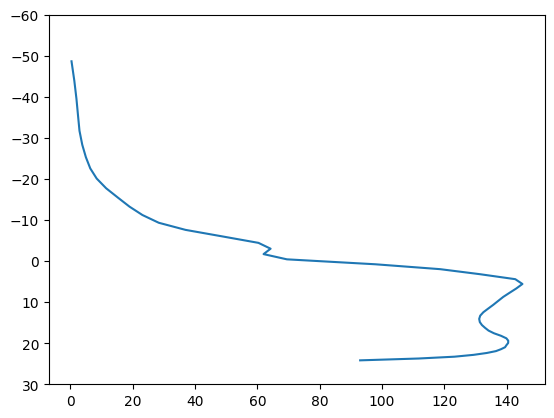

In [374]:

filt_qnc = xr.where((ds_sip.cdnc_percm3 > 0.) & (ds_sip.w_vel > 1.), ds_sip.cdnc_percm3, np.nan)

plt.plot(filt_qnc.mean(dim=('time','ncells')), ds_sip.tempc.mean(dim=('time','ncells')))
plt.ylim(30,-60)

In [352]:

cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(ds_sip.cdnc_percm3.min().values, ds_sip.cdnc_percm3.max().values, 50);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = ds_sip.cdnc_percm3.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)
    

In [361]:

tinc_sip = ds_sip.inc_perl;
tinc_sip_filt = xr.where(ds_sip.inc_perl > 0., ds_sip.inc_perl, np.nan);
tinc_sip_bins = np.linspace(tinc_sip_filt.min().values, tinc_sip_filt.max().values, 40)

cfad_tinc_sip = np.zeros((len(tinc_sip_bins) - 1, len(ht_avg)))

tinc_sip_values = tinc_sip_filt.values  # shape (time, height, ncells)

# Loop through the tinc bins
for i in range(len(tinc_sip_bins) - 1):
    # Create a mask that selects the values within the current bin range
    mask = (tinc_sip_values >= tinc_sip_bins[i]) & (tinc_sip_values < tinc_sip_bins[i + 1])
    
    # Sum the mask along the 'time' (axis=0) and 'ncells' (axis=2) dimensions, keeping the height (axis=1)
    cfad_tinc_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)

In [290]:

refl_sip = ds_sip['dbz'];
refl_sip_filt = xr.where(ds_sip.dbz > -50., ds_sip.dbz, np.nan);
refl_sip_filt_avg = refl_sip_filt.mean(dim='time');

refl_sip_bins = np.linspace(refl_sip_filt.min().values, refl_sip_filt.max().values, 50);
cfad_refl_sip = np.zeros((len(refl_sip_bins) - 1, len(ht_avg)));
refl_sip_values = refl_sip_filt.values;

for i in range(len(refl_sip_bins) - 1):
    mask = (refl_sip_values >= refl_sip_bins[i]) & (refl_sip_values < refl_sip_bins[i + 1])    
    cfad_refl_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)



In [309]:

wvel_sip = ds_sip['w_vel'];
wvel_sip_filt = xr.where(np.abs(ds_sip.w_vel) < 60., ds_sip.w_vel, np.nan);

wvel_sip_bins = np.linspace(wvel_sip_filt.min().values, wvel_sip_filt.max().values, 10);
cfad_wvel_sip = np.zeros((len(wvel_sip_bins) - 1, len(ht_avg)));
wvel_sip_values = wvel_sip_filt.values;

for i in range(len(wvel_sip_bins) - 1):
    mask = (wvel_sip_values >= wvel_sip_bins[i]) & (wvel_sip_values <= wvel_sip_bins[i + 1])    
    cfad_wvel_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)



In [305]:
print(wvel_sip_bins)

[-10.18049526  -5.0421185    0.09625827   5.23463504  10.3730118
  15.51138857  20.64976533  25.7881421   30.92651886  36.06489563]


In [302]:
print(wvel_sip_bins)

[-10.18049526  -5.55595617  -0.93141708   3.69312201   8.31766109
  12.94220018  17.56673927  22.19127836  26.81581745  31.44035654
  36.06489563]


In [379]:
print(ht_avg.values)

[2.0700926e+01 1.8707630e+01 1.7459837e+01 1.6432219e+01 1.5538088e+01
 1.4738070e+01 1.4009794e+01 1.3338899e+01 1.2715508e+01 1.2132399e+01
 1.1584106e+01 1.1066360e+01 1.0575746e+01 1.0109476e+01 9.6652365e+00
 9.2410746e+00 8.8353434e+00 8.4466105e+00 8.0736399e+00 7.7153478e+00
 7.3707871e+00 7.0391073e+00 6.7195578e+00 6.4114618e+00 6.1142201e+00
 5.8272796e+00 5.5501485e+00 5.2823749e+00 5.0235476e+00 4.7732930e+00
 4.5312686e+00 4.2971573e+00 4.0706716e+00 3.8515470e+00 3.6395345e+00
 3.4344137e+00 3.2359767e+00 3.0440290e+00 2.8583987e+00 2.6789262e+00
 2.5054605e+00 2.3378699e+00 2.1760328e+00 2.0198364e+00 1.8691847e+00
 1.7239914e+00 1.5841790e+00 1.4496853e+00 1.3204583e+00 1.1964580e+00
 1.0776585e+00 9.6404749e-01 8.5562992e-01 7.5242615e-01 6.5447932e-01
 5.6185573e-01 4.7465226e-01 3.9300293e-01 3.1709218e-01 2.4717167e-01
 1.8359199e-01 1.2685774e-01 7.7744730e-02 3.7606236e-02 1.0000001e-02]


In [384]:


cdnc_sip = ds_sip['cdnc_percm3'];
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan);

cdnc_sip_bins = np.linspace(cdnc_sip.min().values, cdnc_sip.max().values, 5);
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)));
cdnc_sip_values = cdnc_sip.values;

for i in range(len(cdnc_sip_bins) - 1):
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])    
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0,2)) / len(ds_sip.time)
    

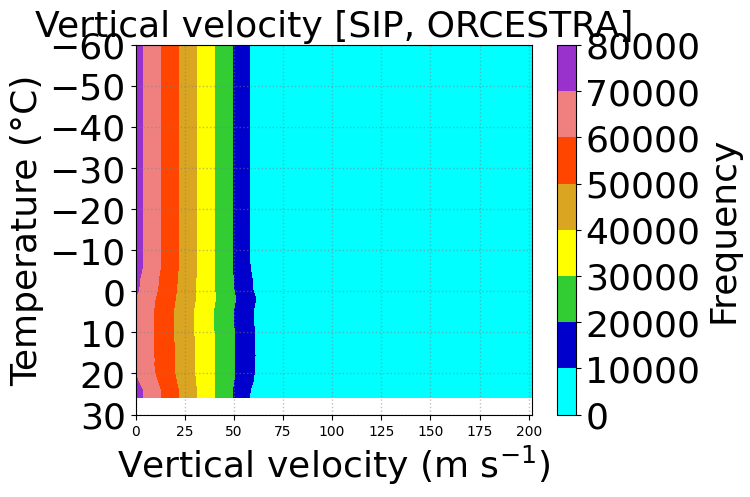

In [386]:

contour = plt.contourf(cdnc_sip_bins[:-1], tempc_avg, cfad_cdnc_sip.T,  cmap=cmap)  
#plt.xlim(-10, 5)
#plt.xticks([-3, -2, -1, 0., 1, 2, 3], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


In [ ]:

plt.plot(ds_nosip.cdnc_percm3.mean(dim=('time','ncells')), ds_nosip.tempc.mean(dim=('time','ncells')))
plt.ylim(30,-60)

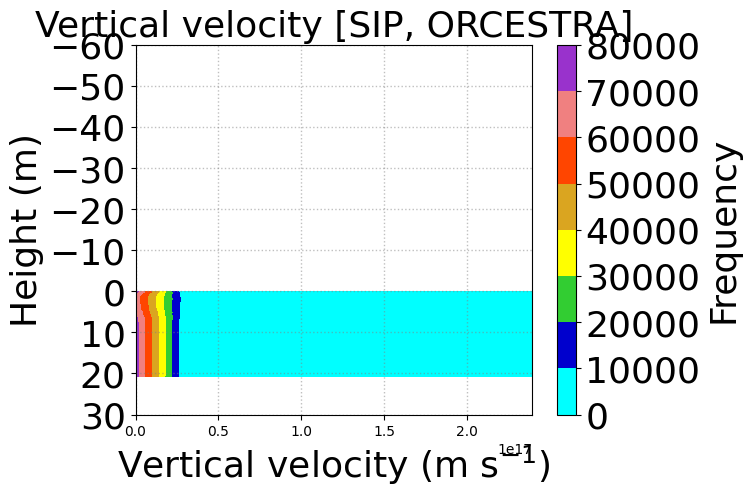

In [370]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

cdnc_sip = ds_sip['cdnc_percm3']
cdnc_sip_filt = xr.where(ds_sip.cdnc_percm3 > 0., ds_sip.cdnc_percm3, np.nan)

# Create bins for cdnc_sip
cdnc_sip_bins = np.linspace(ds_sip.cdnc_percm3.min().values, ds_sip.cdnc_percm3.max().values, 10)
cfad_cdnc_sip = np.zeros((len(cdnc_sip_bins) - 1, len(ht_avg)))

# Convert to numpy for easier manipulation
cdnc_sip_values = ds_sip.cdnc_percm3.values

# Loop through each bin of CDNC
for i in range(len(cdnc_sip_bins) - 1):
    # Create a mask for CDNC values within the current bin
    mask = (cdnc_sip_values >= cdnc_sip_bins[i]) & (cdnc_sip_values < cdnc_sip_bins[i + 1])
    
    # Sum over the time and ncells axes for each height, and normalize by time length
    cfad_cdnc_sip[i, :] = np.sum(mask, axis=(0, 2)) / len(ds_sip.time)

# Create the plot
contour = plt.contourf(cdnc_sip_bins[:-1], ht_avg, cfad_cdnc_sip.T, cmap=cmap)
plt.ylim(30, -60.)  # adjust y-axis limits
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Height (m)', fontsize=fontsize)  # Assuming you want 'Height' on the y-axis
cbar = plt.colorbar(contour, label='Frequency', orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

# Show the plot
plt.show()


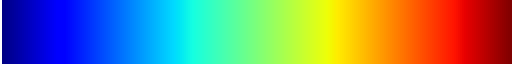

In [123]:
cmap_new

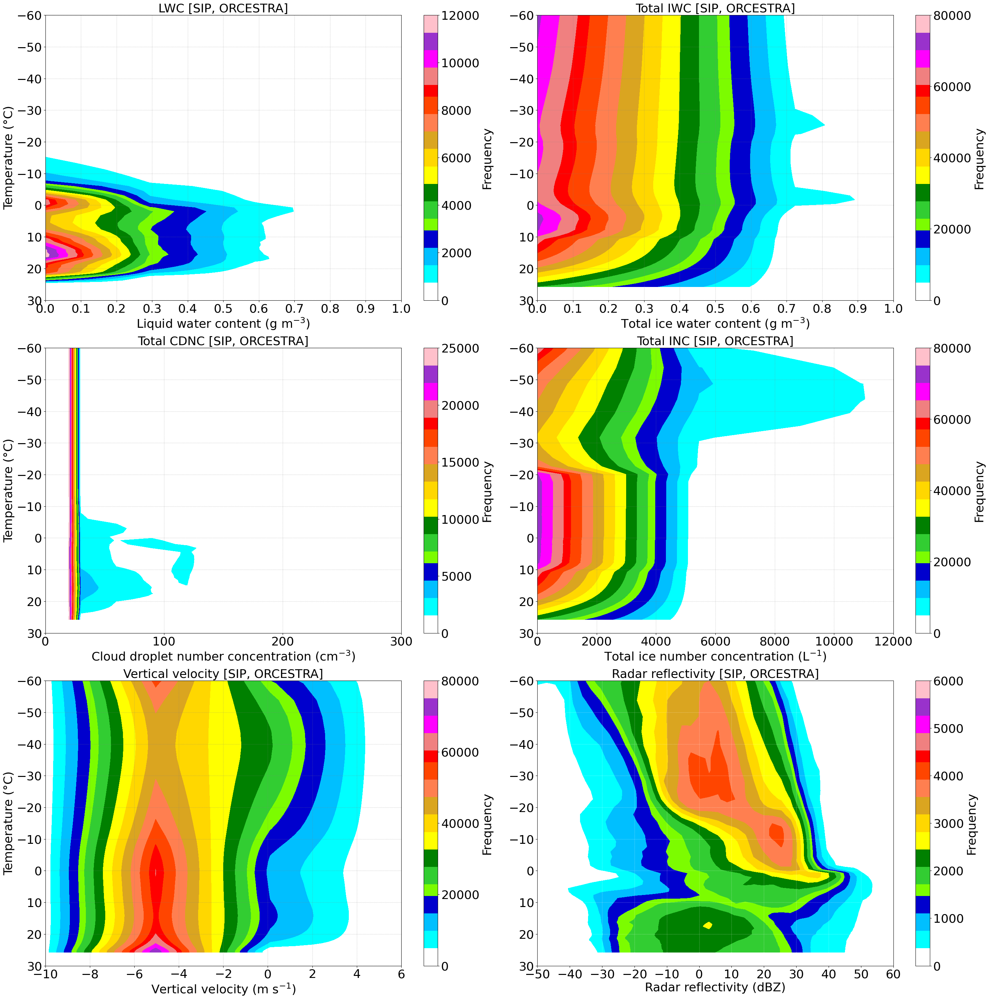

In [364]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

#cmap = plt.cm.jet
#cmap_new = mcolors.ListedColormap(['white'] + [cmap(i) for i in range(1, cmap.N)])

fontsize = 26.;
linewidth = 1.
rotation=0
#cmap = mcolors.ListedColormap(['white', 'blue', 'green', 'yellow', 'red', 'purple'])
lev_lwc = np.linspace(0., 12000, 50)
lev_tiwc = np.linspace(0., 80000, 50)
lev_cdnc = np.linspace(0., 25000, 50)
lev_tinc = np.linspace(0., 80000, 50)
lev_wvel = np.linspace(0., 80000, 50)
lev_refl = np.linspace(0., 6000, 50)

#cfad[cfad < 0.0005]=np.nan

colors = ['white', 'cyan', 'deepskyblue', 'mediumblue', 'lawngreen', 'limegreen', 'green', 'yellow', 'gold', 'goldenrod', 
          'coral', 'orangered', 'red', 'lightcoral', 'magenta', 'darkorchid', 'pink']

cmap = ListedColormap(colors)

plt.figure(figsize=(30, 30))
plt.subplot(3, 2, 1)
contour = plt.contourf(lwc_sip_bins[:-1], tempc_avg, cfad_lwc_sip.T, vmin=0, vmax=12000, levels=lev_lwc, cmap=cmap)  
#plt.xscale('log')
#plt.xlim(1.e-3, 1.e0)
#plt.xticks([1.e-3, 1.e-2, 1.e-1, 1.e0], fontsize=fontsize)
plt.xlim(0, 1.)
plt.xticks([0., 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], fontsize=fontsize)

plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Liquid water content (g m$^{-3}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 2000, 4000, 6000, 8000, 10000, 12000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('LWC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 2)
contour = plt.contourf(tiwc_sip_bins[:-1], tempc_avg, cfad_tiwc_sip.T, vmin=0, vmax=80000, levels=lev_tiwc, cmap=cmap)  
plt.xlim(0, 1.)
plt.xticks([0., 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Total ice water content (g m$^{-3}$)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total IWC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 3)
contour = plt.contourf(cdnc_sip_bins[:-1], tempc_avg, cfad_cdnc_sip.T, vmin=0, vmax=25000, levels=lev_cdnc, cmap=cmap)  
#plt.xscale('log')
plt.xlim(0., 300)
plt.xticks([0, 100, 200, 300], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Cloud droplet number concentration (cm$^{-3}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 5000, 10000, 15000, 20000, 25000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total CDNC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


plt.subplot(3, 2, 4)
contour = plt.contourf(tinc_sip_bins[:-1], tempc_avg, cfad_tinc_sip.T, vmin=0, vmax=80000, levels=lev_tinc, cmap=cmap)  
#plt.xscale('log')
#plt.xlim(1.e-12, 1.e4)
plt.xlim(0., 12000)
plt.xticks([0, 2.e3, 4.e3, 6.e3, 8.e3, 1.e4, 1.2e4], fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Total ice number concentration (L$^{-1}$)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Total INC [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)


plt.subplot(3, 2, 5)
contour = plt.contourf(wvel_sip_bins[:-1], tempc_avg, cfad_wvel_sip.T, vmin=0., vmax=80000, levels=lev_wvel, cmap=cmap)  
plt.xlim(-10, 6)
plt.xticks([-10, -8, -6, -4, -2, 0., 2, 4, 6], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Vertical velocity (m s$^{-1}$)', fontsize=fontsize)
plt.ylabel('Temperature (°C)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 20000, 40000, 60000, 80000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Vertical velocity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='grey', linewidth=linewidth, alpha=0.5)

plt.subplot(3, 2, 6)
contour = plt.contourf(refl_sip_bins[:-1], tempc_avg, cfad_refl_sip.T, vmin=0, vmax=6000, levels=lev_refl, cmap=cmap)  
plt.xlim(-50, 60)
plt.xticks([-50, -40, -30, -20, -10, 0, 10, 20, 30, 40, 50, 60], rotation=rotation, fontsize=fontsize)
plt.ylim(30, -60.)
plt.yticks([30., 20., 10., 0., -10., -20., -30., -40., -50., -60.], fontsize=fontsize)
#plt.ylim(0, 16.)
#plt.yticks([0., 2., 4., 6., 8., 10., 12., 14., 16.], fontsize=fontsize)
plt.xlabel('Radar reflectivity (dBZ)', fontsize=fontsize)
#plt.ylabel('Height (km)', fontsize=fontsize)
cbar = plt.colorbar(contour, label='Frequency', ticks=[0., 1000, 2000, 3000, 4000, 5000, 6000], orientation='vertical')
cbar.set_label('Frequency', fontsize=fontsize)
cbar.ax.tick_params(labelsize=fontsize)
plt.title('Radar reflectivity [SIP, ORCESTRA]', fontsize=fontsize)
plt.grid(True, linestyle=':', color='white', linewidth=linewidth, alpha=0.5)
plt.tight_layout()
plt.show()

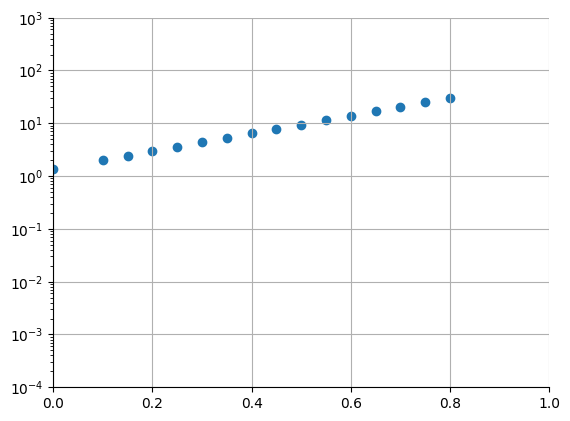

In [4]:
def inp_demott_2003(ss_i):
    inp_demott_2003 = (12.96*(ss_i-0.1))
    #inp_demott_2003 = (1.*2./0.76)* (np.exp(inp_demott_2003))**0.3
    inp_demott_2003 = (1.*2.)* (np.exp(inp_demott_2003))**0.3
    return inp_demott_2003

#ss_i = [-0.25, -0.2, -0.15, -0.1, -0.05, 0., 0.05, 0.1, 0.15, 0.2]
ss_i = [0., 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]
#ss_i = [-25., -20., -15., -10., -5., 0., 5., 10., 15., 20.]
ss_i = np.array(ss_i)

plt.scatter(ss_i, inp_demott_2003(ss_i))
plt.yscale('log')
plt.ylim(0.0001, 1000)
plt.xlim(0.,1.0)
plt.grid(True)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)